/var/folders/rm/clp89v210v32vh5vjt2kx7b80000gr/T/ipykernel_65174/3826768406.py:140: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


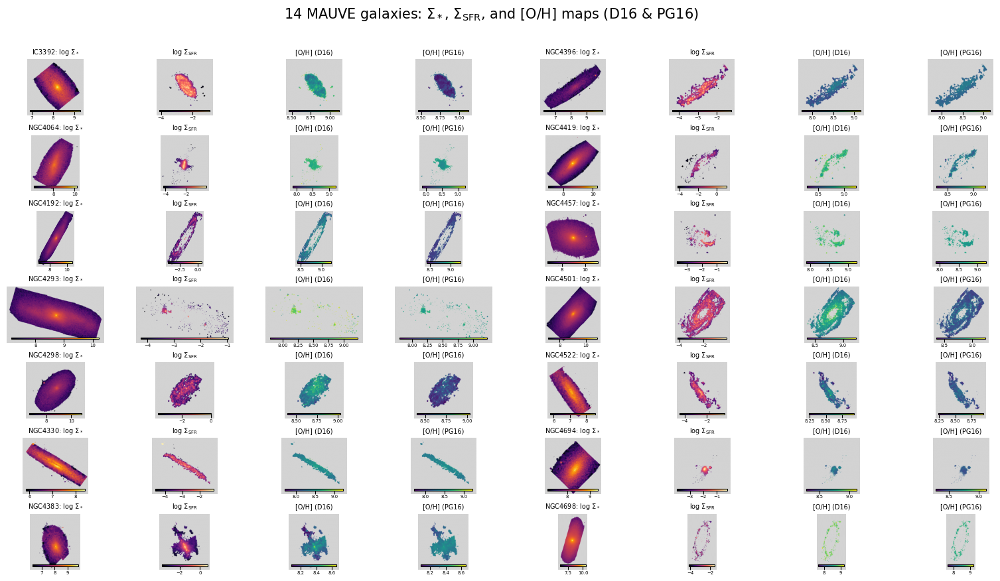

In [1]:
# --------------------------------------------------------------
# Maps: Σ* map, Σ_SFR map, and [O/H] maps (D16 & PG16) for each galaxy
# --------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from pathlib import Path
from astropy.io import fits
import re

# Extraction functions for log files (kept in case titles/annotations later use them)
def extract_total_stellar_mass(galaxy_name):
    """Extract total stellar mass from mass log file. Returns log10(M☉) value or None if not found."""
    log_file = Path(f'mass_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total stellar mass \(R\)\s*:\s*([\d.-]+)\s*log10\(M☉\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading mass log for {galaxy_name}: {e}")
        return None

def extract_total_sfr(galaxy_name):
    """Extract total SFR from SFR log file. Returns log10(M☉/yr) value or None if not found."""
    log_file = Path(f'sfr_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total Halpha SFR from SF region:.*?in log10 scale:\s*([\d.-]+)\s*log\(M☉/yr\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading SFR log for {galaxy_name}: {e}")
        return None

# 0 · discover galaxies & colour palette
bins      = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies  = [f.name.split('_')[0] for f in bins]          # 14 expected
ngal      = len(galaxies)
assert ngal <= 14, "This layout assumes ≤ 14 galaxies."

cmap   = plt.get_cmap('tab20').colors
colour = {g: cmap[i % len(cmap)] for i, g in enumerate(galaxies)}

# Load maps helper (Σ*, Σ_SFR, [O/H] D16, [O/H] PG16)
def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR_SF = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_d16 = h['O_H_D16_SF'].data
        oh_pg16 = h['O_H_PG16_SF'].data
    return sigM, sigSFR_SF, oh_d16, oh_pg16

# 1 · figure & GridSpec  (rows=7, cols=8 → two 4-column blocks per row)
fig = plt.figure(figsize=(20, 10))
gs  = GridSpec(
        nrows=7, ncols=8, figure=fig,
        width_ratios=[1, 1, 1, 1, 1, 1, 1, 1],            # Σ*, Σ_SFR, [O/H] D16, [O/H] PG16
        wspace=0.05, hspace=0.35
)

for idx, gal in enumerate(galaxies):
    row  = idx % 7                      # 0–6
    blk  = idx // 7                     # 0 or 1   (left / right big column)
    col0 = blk * 4                      # 0 or 4   (start col of that block)

    sigM, sigSFR_SF, oh_d16, oh_pg16 = load_maps(gal)

    # Compute common [O/H] range per galaxy for consistent scaling between D16 and PG16
    finite_d16 = np.isfinite(oh_d16)
    finite_pg16 = np.isfinite(oh_pg16)
    if np.any(finite_d16) and np.any(finite_pg16):
        oh_vmin = min(np.nanmin(oh_d16[finite_d16]), np.nanmin(oh_pg16[finite_pg16]))
        oh_vmax = max(np.nanmax(oh_d16[finite_d16]), np.nanmax(oh_pg16[finite_pg16]))
    elif np.any(finite_d16):
        oh_vmin, oh_vmax = np.nanmin(oh_d16[finite_d16]), np.nanmax(oh_d16[finite_d16])
    elif np.any(finite_pg16):
        oh_vmin, oh_vmax = np.nanmin(oh_pg16[finite_pg16]), np.nanmax(oh_pg16[finite_pg16])
    else:
        oh_vmin, oh_vmax = None, None

    # Σ* map with NaN shown as light gray
    axM = fig.add_subplot(gs[row, col0])
    cmap_M = plt.cm.inferno.copy(); cmap_M.set_bad('lightgray')
    imM = axM.imshow(sigM, origin='lower', cmap=cmap_M)
    axM.set_title(rf'{gal}: $\log\,\Sigma_*$', fontsize=7)
    axM.axis('off')
    cax = inset_axes(axM, width='90%', height='3%', loc='lower center', borderpad=0.4)
    fig.colorbar(imM, cax=cax, orientation='horizontal')
    cax.tick_params(labelsize=5, pad=1)

    # Σ_SFR map with NaN shown as light gray
    axS = fig.add_subplot(gs[row, col0+1])
    cmap_S = plt.cm.magma.copy(); cmap_S.set_bad('lightgray')
    imS = axS.imshow(sigSFR_SF, origin='lower', cmap=cmap_S)
    axS.set_title(r'$\log\,\Sigma_{\mathrm{SFR}}$', fontsize=7)
    axS.axis('off')
    cax2 = inset_axes(axS, width='90%', height='3%', loc='lower center', borderpad=0.4)
    fig.colorbar(imS, cax=cax2, orientation='horizontal')
    cax2.tick_params(labelsize=5, pad=1)

    # [O/H] D16 map with NaN shown as light gray
    axD16 = fig.add_subplot(gs[row, col0+2])
    cmap_OH = plt.cm.viridis.copy(); cmap_OH.set_bad('lightgray')
    if oh_vmin is not None:
        imD16 = axD16.imshow(oh_d16, origin='lower', cmap=cmap_OH, vmin=oh_vmin, vmax=oh_vmax)
    else:
        imD16 = axD16.imshow(oh_d16, origin='lower', cmap=cmap_OH)
    axD16.set_title(r'[O/H] (D16)', fontsize=7)
    axD16.axis('off')
    cax3 = inset_axes(axD16, width='90%', height='3%', loc='lower center', borderpad=0.4)
    fig.colorbar(imD16, cax=cax3, orientation='horizontal')
    cax3.tick_params(labelsize=5, pad=1)

    # [O/H] PG16 map with NaN shown as light gray
    axPG16 = fig.add_subplot(gs[row, col0+3])
    if oh_vmin is not None:
        imPG16 = axPG16.imshow(oh_pg16, origin='lower', cmap=cmap_OH, vmin=oh_vmin, vmax=oh_vmax)
    else:
        imPG16 = axPG16.imshow(oh_pg16, origin='lower', cmap=cmap_OH)
    axPG16.set_title(r'[O/H] (PG16)', fontsize=7)
    axPG16.axis('off')
    cax4 = inset_axes(axPG16, width='90%', height='3%', loc='lower center', borderpad=0.4)
    fig.colorbar(imPG16, cax=cax4, orientation='horizontal')
    cax4.tick_params(labelsize=5, pad=1)

# 2 · global title
fig.suptitle(
    fr'{ngal} MAUVE galaxies: $\Sigma_*$, $\Sigma_{{\mathrm{{SFR}}}}$, and [O/H] maps (D16 & PG16)',
    fontsize=15, y=0.96
)
plt.tight_layout()

# Save figure in both PNG and PDF formats
plt.savefig('mauve_14galaxies_4maps.png', dpi=600, bbox_inches='tight')
plt.savefig('mauve_14galaxies_4maps.pdf', pad_inches=0.1)

plt.show()

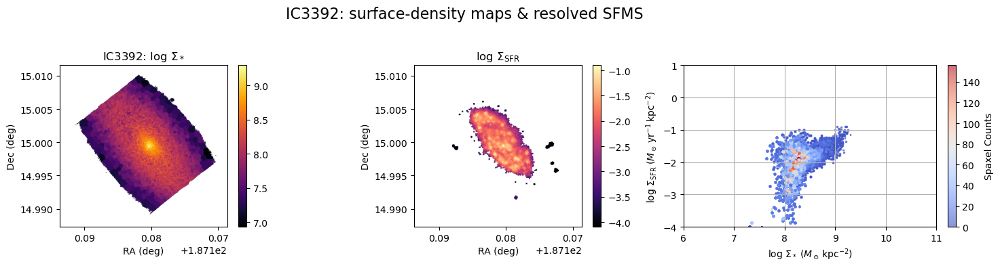

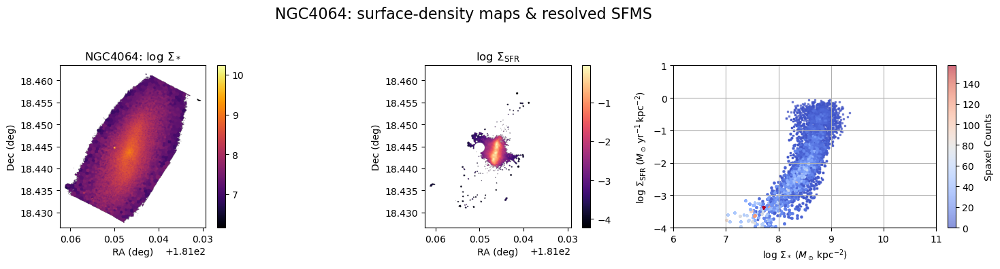

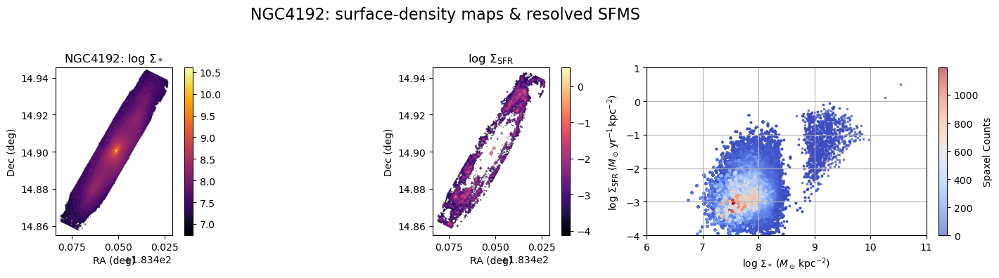

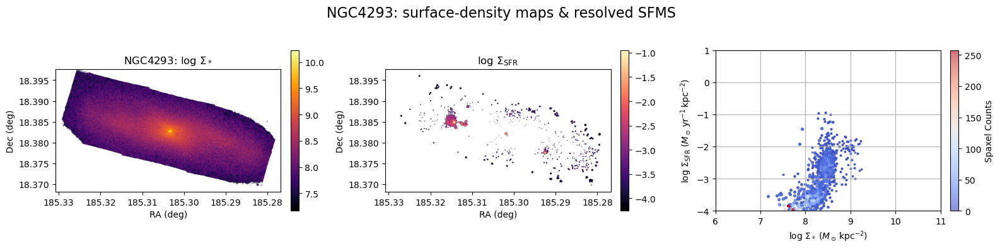

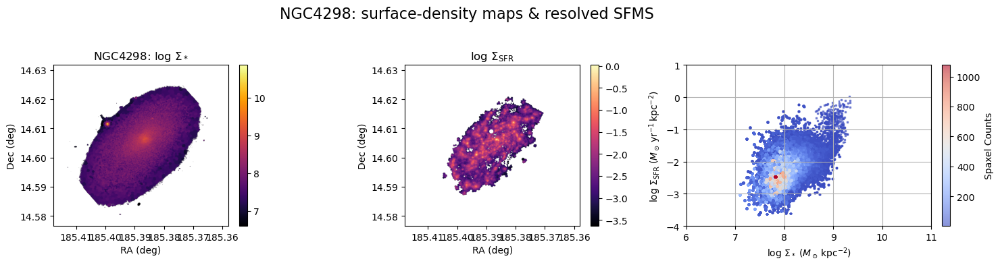

...

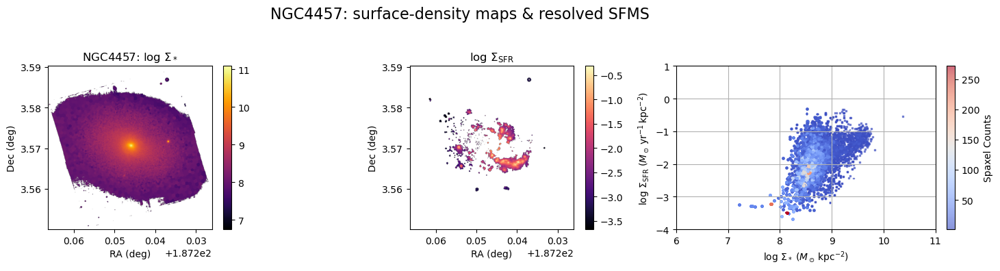

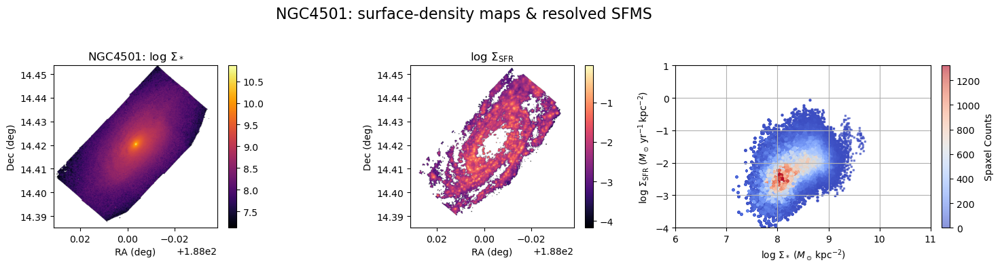

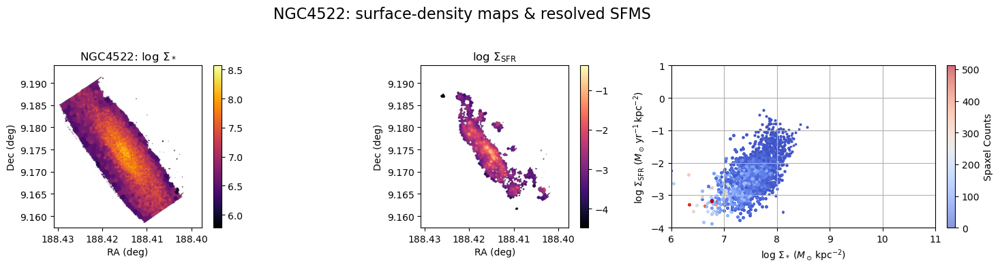

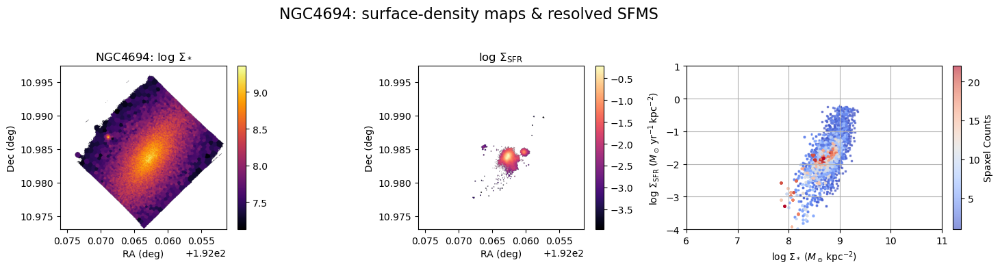

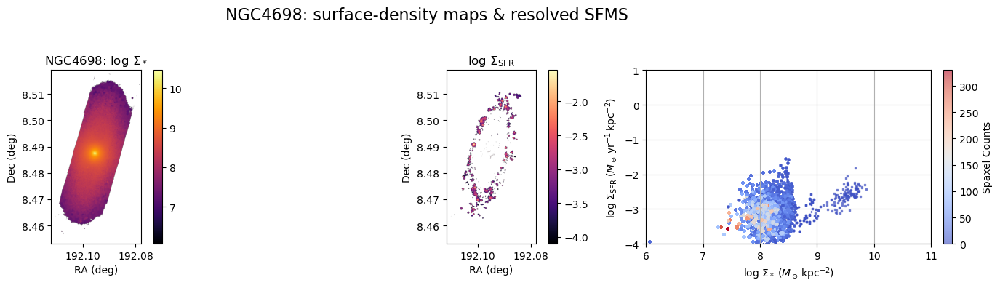

In [2]:
import itertools
import matplotlib.pyplot as plt
from pathlib import Path
import numpy as np
from astropy.io import fits
from astropy.wcs import WCS
from matplotlib.gridspec import GridSpec

# ------------------------------------------------------------------
# 0.  List galaxies and pin one colour to each
# ------------------------------------------------------------------
bin_maps = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bin_maps]        # auto-detect
cmap   = plt.get_cmap('tab20').colors                      # 20 hues
colour = {g: cmap[i % len(cmap)] for i, g in enumerate(galaxies)}

# ------------------------------------------------------------------
# 1.  Helper: read the two maps
# ------------------------------------------------------------------
def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
        wcs = WCS(h['LOGMASS_SURFACE_DENSITY'].header)
        mass_header = h['LOGMASS_SURFACE_DENSITY'].header
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        gas_header = h['LOGSFR_SURFACE_DENSITY_SF'].header
    return sigM, sigSFR, wcs, mass_header, gas_header

# ------------------------------------------------------------------
# 2.  One figure (3 panels) per galaxy
# ------------------------------------------------------------------
for gal in galaxies:
    sigM, sigSFR, wcs, mass_header, gas_header = load_maps(gal)
    good = np.isfinite(sigM) & np.isfinite(sigSFR)
    x, y = sigM[good], sigSFR[good]

    # Convert pixel area to physical area in pc²
    legacy_wcs2 = WCS(gas_header).celestial  # strip spectral axis
    
    # Get the extent from WCS for proper coordinate axes
    y_size, x_size = sigM.shape
    x_coords = np.arange(x_size)
    y_coords = np.arange(y_size)
    xx, yy = np.meshgrid(x_coords, y_coords)
    # Convert pixel coordinates to world coordinates
    ra, dec = legacy_wcs2.pixel_to_world_values(xx, yy)
    extent = [ra.max(), ra.min(), dec.min(), dec.max()]  # [left, right, bottom, top]

    fig = plt.figure(figsize=(16, 4))

    # --- Σ* map ---------------------------------------------------
    axM = fig.add_subplot(1, 3, 1)
    im1 = axM.imshow(sigM, origin='lower', cmap='inferno', extent=extent)
    axM.set_title(rf'{gal}: $\log\,\Sigma_*$')
    axM.set_xlabel('RA (deg)')
    axM.set_ylabel('Dec (deg)')
    fig.colorbar(im1, ax=axM, fraction=0.046, pad=0.04)

    # --- Σ_SFR map -----------------------------------------------
    axSFR = fig.add_subplot(1, 3, 2)
    im2 = axSFR.imshow(sigSFR, origin='lower', cmap='magma', extent=extent)
    axSFR.set_title(r'$\log\,\Sigma_{\mathrm{SFR}}$')
    axSFR.set_xlabel('RA (deg)')
    axSFR.set_ylabel('Dec (deg)')
    fig.colorbar(im2, ax=axSFR, fraction=0.046, pad=0.04)

    # --- SFMS scatter with density color coding ------------------
    axSc = fig.add_subplot(1, 3, 3)  # No WCS projection for scatter plot
    
    # Create 2D histogram for density calculation
    H, xedges, yedges = np.histogram2d(x, y, bins=100, range=[[6, 11], [-4, 1]])
    
    # Find bin indices for each point
    x_idx = np.digitize(x, xedges) - 1
    y_idx = np.digitize(y, yedges) - 1
    
    # Clip indices to valid range
    x_idx = np.clip(x_idx, 0, H.shape[0] - 1)
    y_idx = np.clip(y_idx, 0, H.shape[1] - 1)
    
    # Get density for each point
    density = H[x_idx, y_idx]
    
    # Create scatter plot colored by density
    scatter = axSc.scatter(x, y, c=density, s=2, alpha=0.6, marker=',', cmap='coolwarm')
    axSc.set_xlabel(r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$')
    axSc.set_ylabel(r'$\log\,\Sigma_{\mathrm{SFR}}\; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$')
    axSc.set_xlim(6, 11)
    axSc.set_ylim(-4, 1)
    axSc.grid(True)
    
    # Add colorbar for density
    fig.colorbar(scatter, ax=axSc, fraction=0.046, pad=0.04, label='Spaxel Counts')

    fig.suptitle(f'{gal}: surface-density maps & resolved SFMS', fontsize=16)
    fig.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

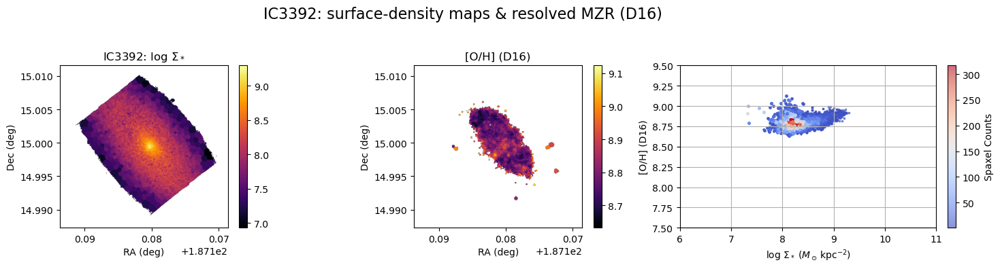

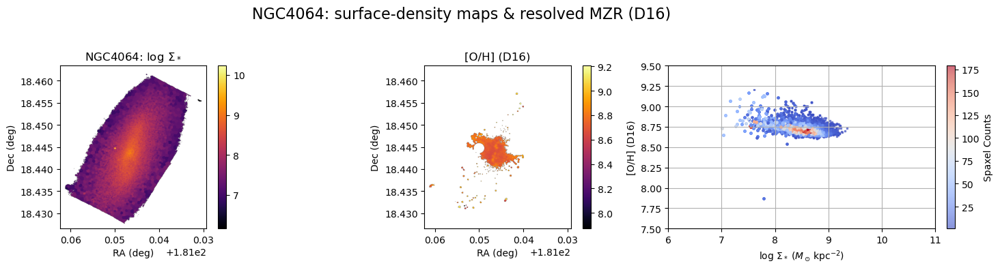

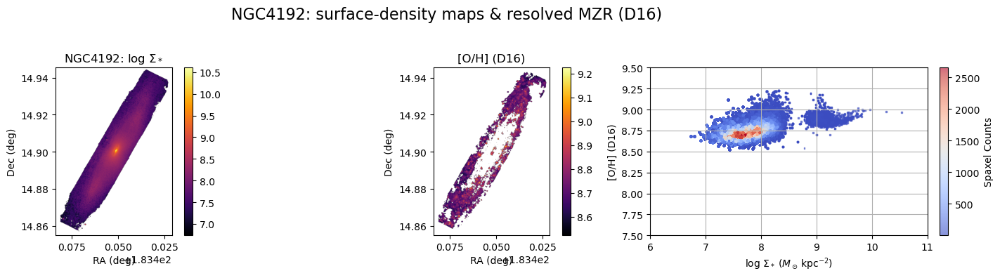

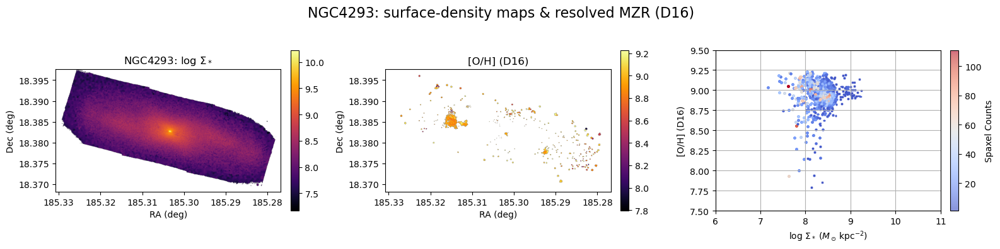

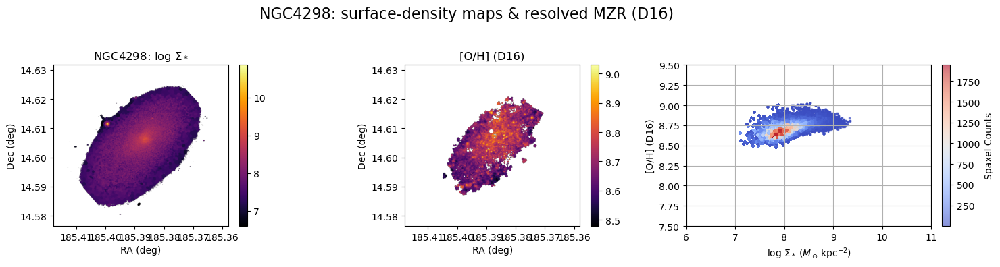

...

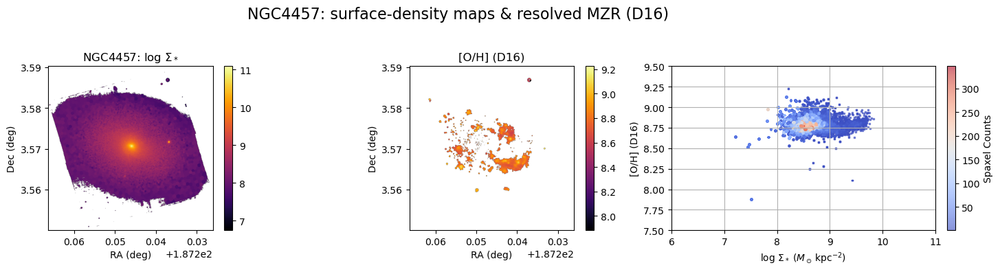

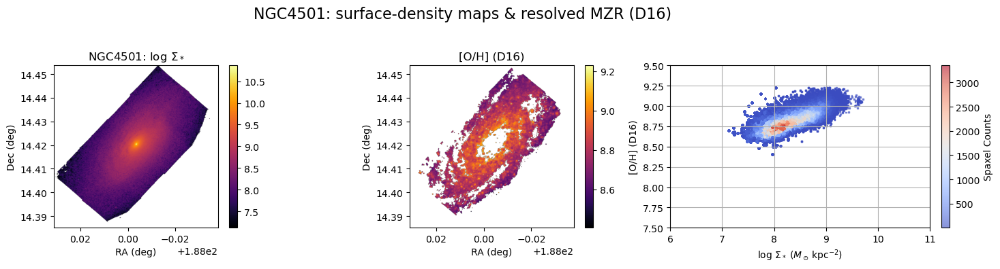

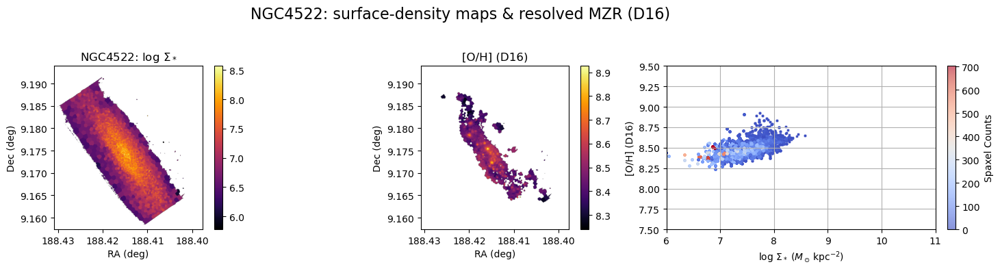

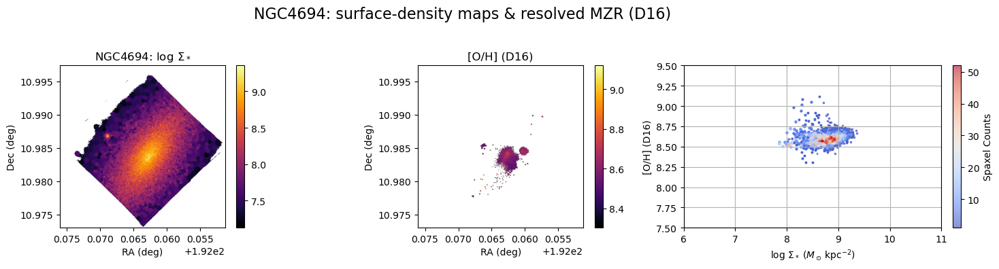

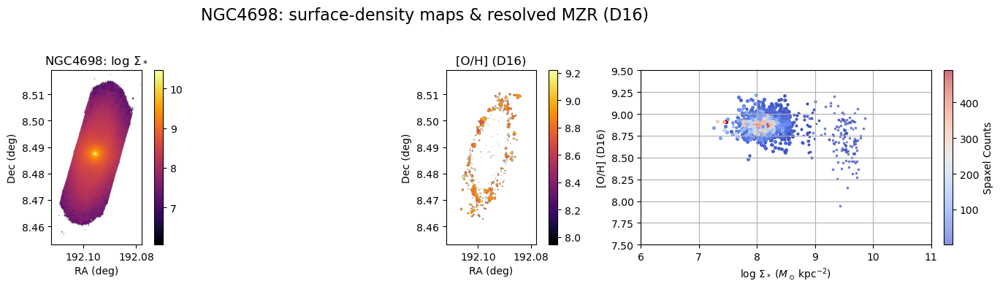

In [3]:
import itertools
import matplotlib.pyplot as plt
from pathlib import Path
import numpy as np
from astropy.io import fits
from astropy.wcs import WCS
from matplotlib.gridspec import GridSpec
import astropy.units as u

# ------------------------------------------------------------------
# 0.  List galaxies and pin one colour to each
# ------------------------------------------------------------------
bin_maps = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bin_maps]        # auto-detect
cmap   = plt.get_cmap('tab20').colors                      # 20 hues
colour = {g: cmap[i % len(cmap)] for i, g in enumerate(galaxies)}

# ------------------------------------------------------------------
# 1.  Helper: read the two maps
# ------------------------------------------------------------------
def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
        wcs = WCS(h['LOGMASS_SURFACE_DENSITY'].header)
        mass_header = h['LOGMASS_SURFACE_DENSITY'].header
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        gas_header = h['LOGSFR_SURFACE_DENSITY_SF'].header
        oh_d16 = h['O_H_D16_SF'].data
    return sigM, sigSFR, wcs, mass_header, gas_header, oh_d16

# ------------------------------------------------------------------
# 2.  One figure (3 panels) per galaxy - MZR version
# ------------------------------------------------------------------
for gal in galaxies:
    sigM, sigSFR, wcs, mass_header, gas_header, oh_d16 = load_maps(gal)
    good = np.isfinite(sigM) & np.isfinite(oh_d16)
    x, y = sigM[good], oh_d16[good]

    # Convert pixel area to physical area in pc²
    legacy_wcs2 = WCS(gas_header).celestial  # strip spectral axis
    
    # Get the extent from WCS for proper coordinate axes
    y_size, x_size = sigM.shape
    x_coords = np.arange(x_size)
    y_coords = np.arange(y_size)
    xx, yy = np.meshgrid(x_coords, y_coords)
    # Convert pixel coordinates to world coordinates
    ra, dec = legacy_wcs2.pixel_to_world_values(xx, yy)
    extent = [ra.max(), ra.min(), dec.min(), dec.max()]  # [left, right, bottom, top]

    fig = plt.figure(figsize=(16, 4))

    # --- Σ* map ---------------------------------------------------
    axM = fig.add_subplot(1, 3, 1)
    im1 = axM.imshow(sigM, origin='lower', cmap='inferno', extent=extent)
    axM.set_title(rf'{gal}: $\log\,\Sigma_*$')
    axM.set_xlabel('RA (deg)')
    axM.set_ylabel('Dec (deg)')
    fig.colorbar(im1, ax=axM, fraction=0.046, pad=0.04)

    # --- [O/H] D16 map --------------------------------------------
    axOH = fig.add_subplot(1, 3, 2)
    im2 = axOH.imshow(oh_d16, origin='lower', cmap='inferno', extent=extent)
    axOH.set_title(r'[O/H] (D16)')
    axOH.set_xlabel('RA (deg)')
    axOH.set_ylabel('Dec (deg)')
    fig.colorbar(im2, ax=axOH, fraction=0.046, pad=0.04)

    # --- rMZR scatter with density color coding ------------------
    axMZR = fig.add_subplot(1, 3, 3)  # No WCS projection for scatter plot
    
    # Create 2D histogram for density calculation
    H, xedges, yedges = np.histogram2d(x, y, bins=100, range=[[6, 11], [7.5, 9.5]])
    
    # Find bin indices for each point
    x_idx = np.digitize(x, xedges) - 1
    y_idx = np.digitize(y, yedges) - 1
    
    # Clip indices to valid range
    x_idx = np.clip(x_idx, 0, H.shape[0] - 1)
    y_idx = np.clip(y_idx, 0, H.shape[1] - 1)
    
    # Get density for each point
    density = H[x_idx, y_idx]
    
    # Create scatter plot colored by density
    scatter = axMZR.scatter(x, y, c=density, s=2, alpha=0.6, marker=',', cmap='coolwarm')
    axMZR.set_xlabel(r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$')
    axMZR.set_ylabel(r'[O/H] (D16)')
    axMZR.set_xlim(6, 11)
    axMZR.set_ylim(7.5, 9.5)
    axMZR.grid(True)
    
    # Add colorbar for density
    fig.colorbar(scatter, ax=axMZR, fraction=0.046, pad=0.04, label='Spaxel Counts')

    fig.suptitle(f'{gal}: surface-density maps & resolved MZR (D16)', fontsize=16)
    fig.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

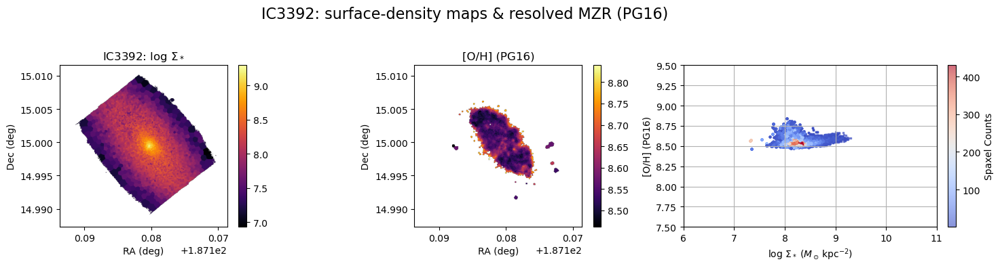

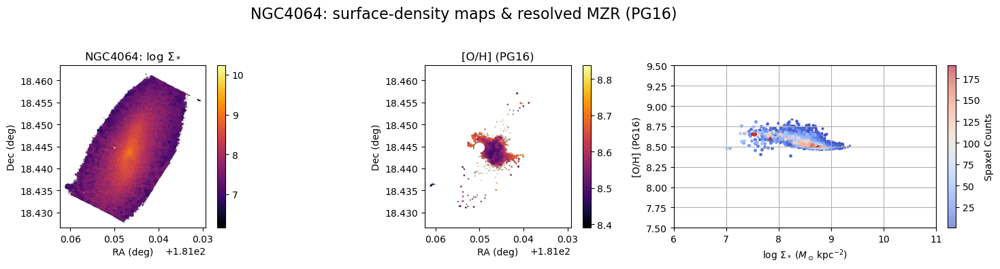

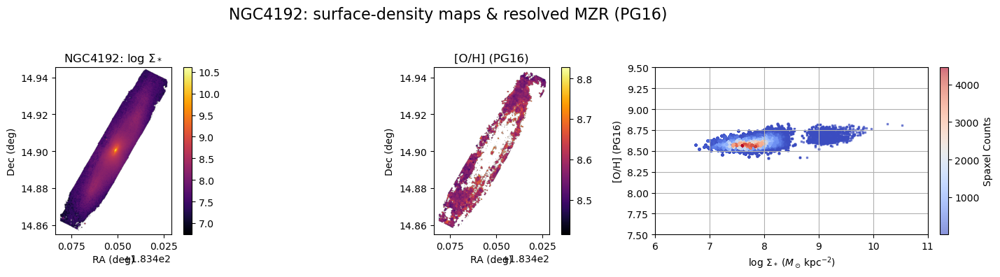

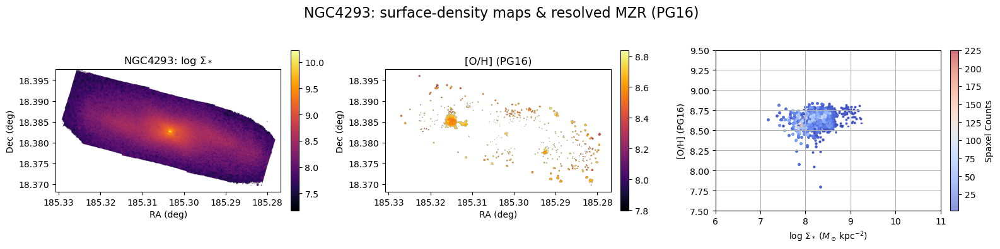

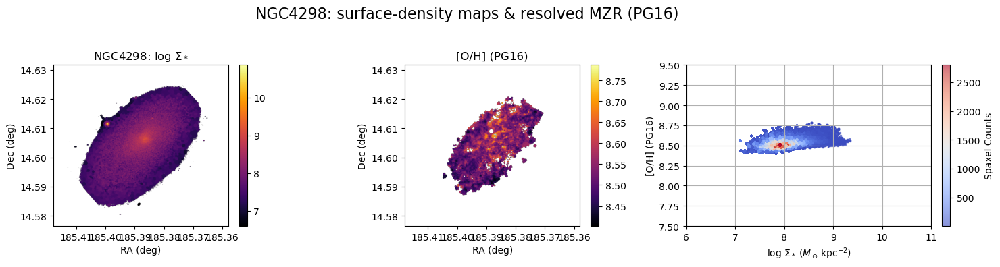

...

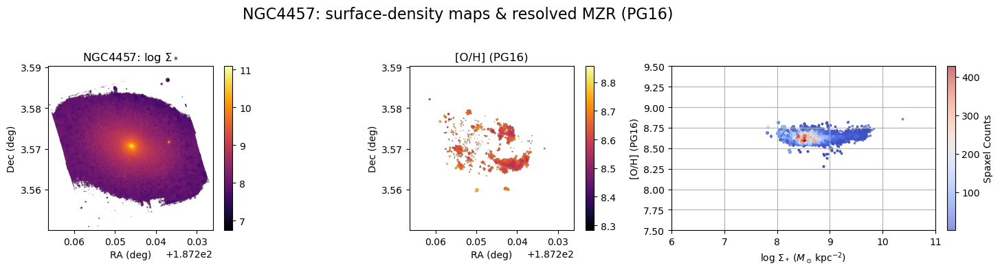

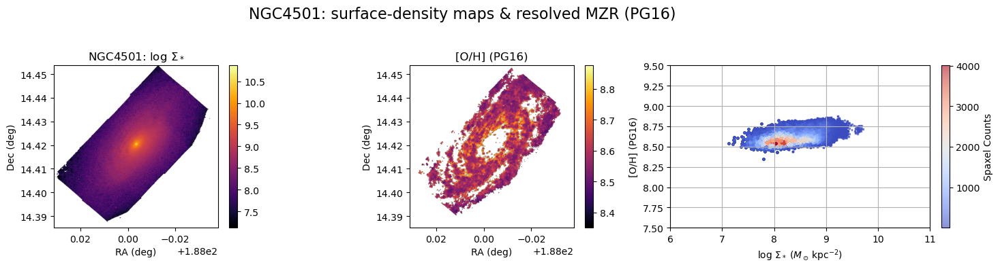

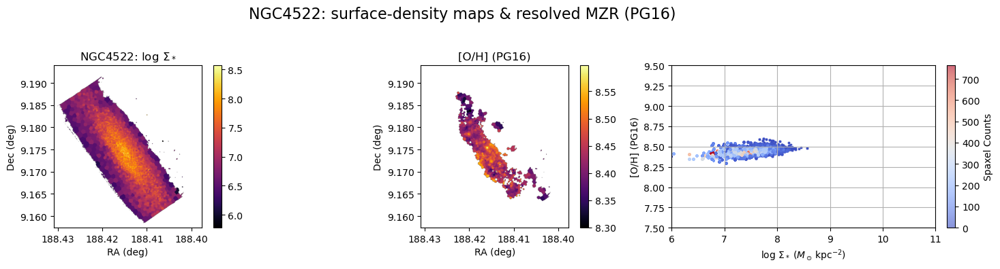

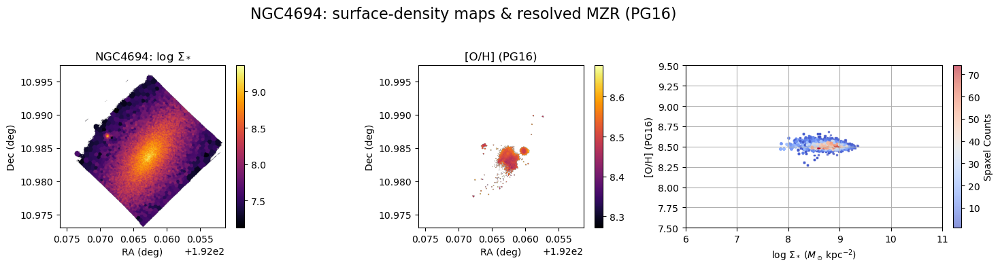

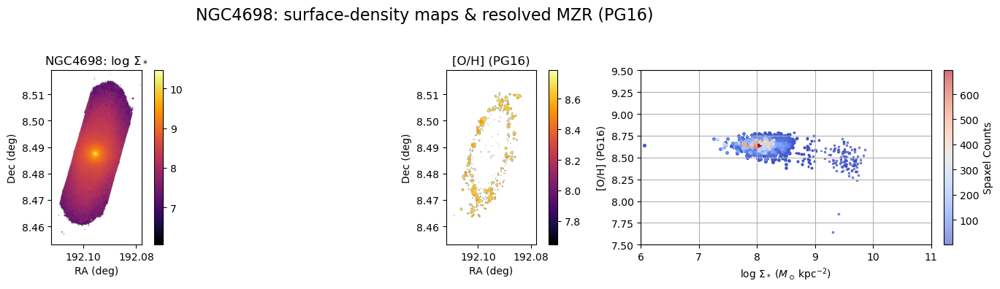

In [4]:
import itertools
import matplotlib.pyplot as plt
from pathlib import Path
import numpy as np
from astropy.io import fits
from astropy.wcs import WCS
from matplotlib.gridspec import GridSpec
import astropy.units as u

# ------------------------------------------------------------------
# 0.  List galaxies and pin one colour to each
# ------------------------------------------------------------------
bin_maps = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bin_maps]        # auto-detect
cmap   = plt.get_cmap('tab20').colors                      # 20 hues
colour = {g: cmap[i % len(cmap)] for i, g in enumerate(galaxies)}

# ------------------------------------------------------------------
# 1.  Helper: read the two maps
# ------------------------------------------------------------------
def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
        wcs = WCS(h['LOGMASS_SURFACE_DENSITY'].header)
        mass_header = h['LOGMASS_SURFACE_DENSITY'].header
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        gas_header = h['LOGSFR_SURFACE_DENSITY_SF'].header
        oh_pg16 = h['O_H_PG16_SF'].data
    return sigM, sigSFR, wcs, mass_header, gas_header, oh_pg16

# ------------------------------------------------------------------
# 2.  One figure (3 panels) per galaxy - MZR version
# ------------------------------------------------------------------
for gal in galaxies:
    sigM, sigSFR, wcs, mass_header, gas_header, oh_pg16 = load_maps(gal)
    good = np.isfinite(sigM) & np.isfinite(oh_pg16)
    x, y = sigM[good], oh_pg16[good]

    # Convert pixel area to physical area in pc²
    legacy_wcs2 = WCS(gas_header).celestial  # strip spectral axis
    
    # Get the extent from WCS for proper coordinate axes
    y_size, x_size = sigM.shape
    x_coords = np.arange(x_size)
    y_coords = np.arange(y_size)
    xx, yy = np.meshgrid(x_coords, y_coords)
    # Convert pixel coordinates to world coordinates
    ra, dec = legacy_wcs2.pixel_to_world_values(xx, yy)
    extent = [ra.max(), ra.min(), dec.min(), dec.max()]  # [left, right, bottom, top]

    fig = plt.figure(figsize=(16, 4))

    # --- Σ* map ---------------------------------------------------
    axM = fig.add_subplot(1, 3, 1)
    im1 = axM.imshow(sigM, origin='lower', cmap='inferno', extent=extent)
    axM.set_title(rf'{gal}: $\log\,\Sigma_*$')
    axM.set_xlabel('RA (deg)')
    axM.set_ylabel('Dec (deg)')
    fig.colorbar(im1, ax=axM, fraction=0.046, pad=0.04)

    # --- [O/H] PG16 map --------------------------------------------
    axOH = fig.add_subplot(1, 3, 2)
    im2 = axOH.imshow(oh_pg16, origin='lower', cmap='inferno', extent=extent)
    axOH.set_title(r'[O/H] (PG16)')
    axOH.set_xlabel('RA (deg)')
    axOH.set_ylabel('Dec (deg)')
    fig.colorbar(im2, ax=axOH, fraction=0.046, pad=0.04)

    # --- rMZR scatter with density color coding ------------------
    axMZR = fig.add_subplot(1, 3, 3)  # No WCS projection for scatter plot
    
    # Create 2D histogram for density calculation
    H, xedges, yedges = np.histogram2d(x, y, bins=100, range=[[6, 11], [7.5, 9.5]])
    
    # Find bin indices for each point
    x_idx = np.digitize(x, xedges) - 1
    y_idx = np.digitize(y, yedges) - 1
    
    # Clip indices to valid range
    x_idx = np.clip(x_idx, 0, H.shape[0] - 1)
    y_idx = np.clip(y_idx, 0, H.shape[1] - 1)
    
    # Get density for each point
    density = H[x_idx, y_idx]
    
    # Create scatter plot colored by density
    scatter = axMZR.scatter(x, y, c=density, s=2, alpha=0.6, marker=',', cmap='coolwarm')
    axMZR.set_xlabel(r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$')
    axMZR.set_ylabel(r'[O/H] (PG16)')
    axMZR.set_xlim(6, 11)
    axMZR.set_ylim(7.5, 9.5)
    axMZR.grid(True)
    
    # Add colorbar for density
    fig.colorbar(scatter, ax=axMZR, fraction=0.046, pad=0.04, label='Spaxel Counts')

    fig.suptitle(f'{gal}: surface-density maps & resolved MZR (PG16)', fontsize=16)
    fig.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

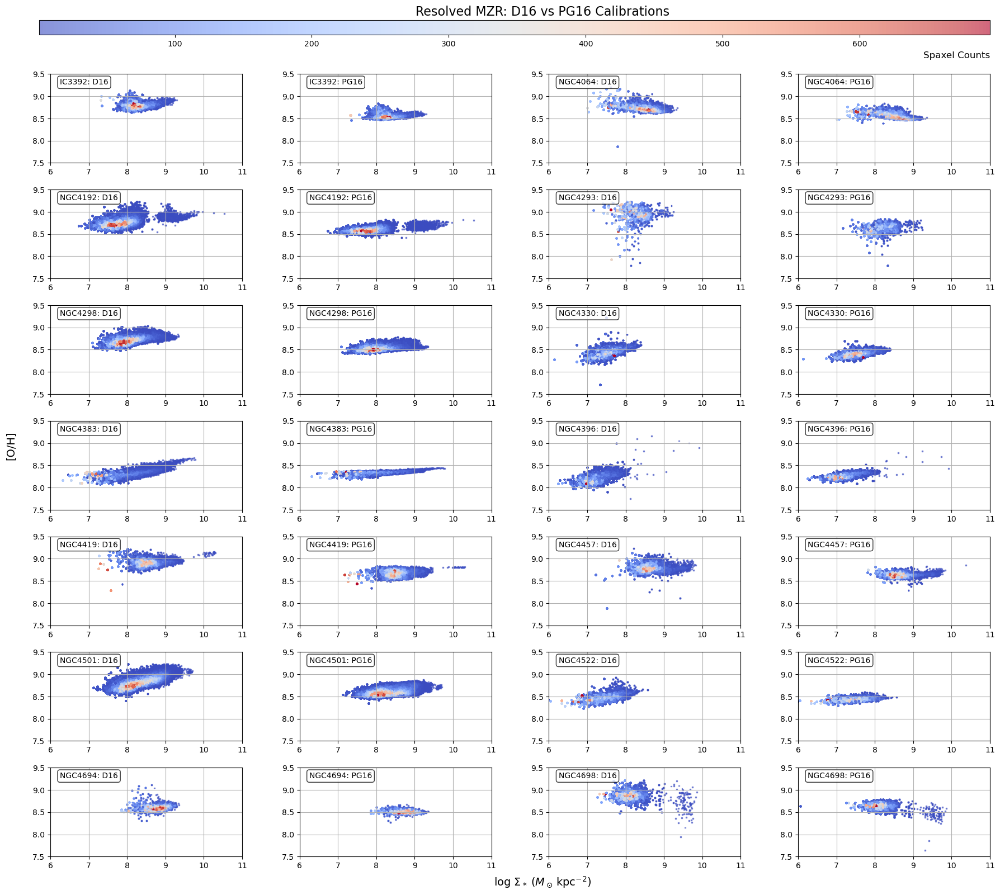

In [5]:
# ------------------------------------------------------------------
import matplotlib.pyplot as plt
from pathlib import Path
import numpy as np
from astropy.io import fits
from astropy.wcs import WCS
from matplotlib.gridspec import GridSpec
import astropy.units as u

# ------------------------------------------------------------------
# 0.  List galaxies and pin one colour to each
# ------------------------------------------------------------------
bin_maps = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bin_maps]        # auto-detect
cmap   = plt.get_cmap('tab20').colors                      # 20 hues
colour = {g: cmap[i % len(cmap)] for i, g in enumerate(galaxies)}

# ------------------------------------------------------------------
# 1.  Helper: read the two maps
# ------------------------------------------------------------------
def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
        wcs = WCS(h['LOGMASS_SURFACE_DENSITY'].header)
        mass_header = h['LOGMASS_SURFACE_DENSITY'].header
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        gas_header = h['LOGSFR_SURFACE_DENSITY_SF'].header
        oh_pg16 = h['O_H_PG16_SF'].data
    return sigM, sigSFR, wcs, mass_header, gas_header, oh_pg16

# ------------------------------------------------------------------
# 3.  Compare D16 vs PG16 rMZR - 4 columns layout (2 galaxies per row)
# ------------------------------------------------------------------

# Calculate number of rows needed for 4 columns (2 galaxies per row)
n_galaxies = len(galaxies)
n_rows = (n_galaxies + 1) // 2  # Two galaxies per row
fig, axes = plt.subplots(n_rows, 4, figsize=(20, 2.5*n_rows))  # 4 columns

# Handle case where there's only one galaxy
if n_rows == 1:
    axes = axes.reshape(1, -1)

scatter_for_cbar = None  # To store scatter plot for colorbar

for i, gal in enumerate(galaxies):
    # Calculate row and column positions
    row = i // 2  # Which row this galaxy goes in
    col_start = (i % 2) * 2  # Starting column: 0 for first galaxy in row, 2 for second
    
    # Load data for both calibrations
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        oh_d16 = h['O_H_D16_SF'].data
        oh_pg16 = h['O_H_PG16_SF'].data
    
    # D16 data
    good_d16 = np.isfinite(sigM) & np.isfinite(oh_d16)
    x_d16, y_d16 = sigM[good_d16], oh_d16[good_d16]
    
    # PG16 data
    good_pg16 = np.isfinite(sigM) & np.isfinite(oh_pg16)
    x_pg16, y_pg16 = sigM[good_pg16], oh_pg16[good_pg16]
    
    # D16 scatter plot
    H_d16, xedges_d16, yedges_d16 = np.histogram2d(x_d16, y_d16, bins=100, range=[[6, 11], [7.5, 9.5]])
    x_idx_d16 = np.clip(np.digitize(x_d16, xedges_d16) - 1, 0, H_d16.shape[0] - 1)
    y_idx_d16 = np.clip(np.digitize(y_d16, yedges_d16) - 1, 0, H_d16.shape[1] - 1)
    density_d16 = H_d16[x_idx_d16, y_idx_d16]
    
    scatter_d16 = axes[row, col_start].scatter(x_d16, y_d16, c=density_d16, s=2, alpha=0.6, marker=',', cmap='coolwarm')
    axes[row, col_start].set_xlim(6, 11)
    axes[row, col_start].set_ylim(7.5, 9.5)
    axes[row, col_start].grid(True)
    axes[row, col_start].text(0.05, 0.95, f'{gal}: D16', transform=axes[row, col_start].transAxes, 
                    bbox=dict(boxstyle='round', facecolor='white', alpha=0.8), 
                    verticalalignment='top', fontsize=10)
    
    # PG16 scatter plot
    H_pg16, xedges_pg16, yedges_pg16 = np.histogram2d(x_pg16, y_pg16, bins=100, range=[[6, 11], [7.5, 9.5]])
    x_idx_pg16 = np.clip(np.digitize(x_pg16, xedges_pg16) - 1, 0, H_pg16.shape[0] - 1)
    y_idx_pg16 = np.clip(np.digitize(y_pg16, yedges_pg16) - 1, 0, H_pg16.shape[1] - 1)
    density_pg16 = H_pg16[x_idx_pg16, y_idx_pg16]
    
    scatter_pg16 = axes[row, col_start+1].scatter(x_pg16, y_pg16, c=density_pg16, s=2, alpha=0.6, marker=',', cmap='coolwarm')
    axes[row, col_start+1].set_xlim(6, 11)
    axes[row, col_start+1].set_ylim(7.5, 9.5)
    axes[row, col_start+1].grid(True)
    axes[row, col_start+1].text(0.05, 0.95, f'{gal}: PG16', transform=axes[row, col_start+1].transAxes, 
                    bbox=dict(boxstyle='round', facecolor='white', alpha=0.8), 
                    verticalalignment='top', fontsize=10)
    
    # Store scatter plot for colorbar (use the last one created)
    scatter_for_cbar = scatter_pg16

# Hide unused subplots if odd number of galaxies
if n_galaxies % 2 == 1:
    last_row = (n_galaxies - 1) // 2
    for j in range(2, 4):
        axes[last_row, j].set_visible(False)

# Add horizontal colorbar at the top
if scatter_for_cbar is not None:
    cbar_ax = fig.add_axes([0.05, 0.92, 0.85, 0.015])
    cbar = plt.colorbar(scatter_for_cbar, cax=cbar_ax, orientation='horizontal')
    cbar.set_label('Spaxel Counts', fontsize=12, loc='right')

# Add shared x and y labels
fig.text(0.5, 0.05, r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', ha='center', fontsize=14)
fig.text(0.02, 0.5, r'[O/H]', va='center', rotation='vertical', fontsize=14)

fig.suptitle('Resolved MZR: D16 vs PG16 Calibrations', fontsize=16, y=0.95)
plt.subplots_adjust(hspace=0.3, wspace=0.3, top=0.88, bottom=0.08, left=0.06)  # Adjusted top margin for colorbar
plt.show()

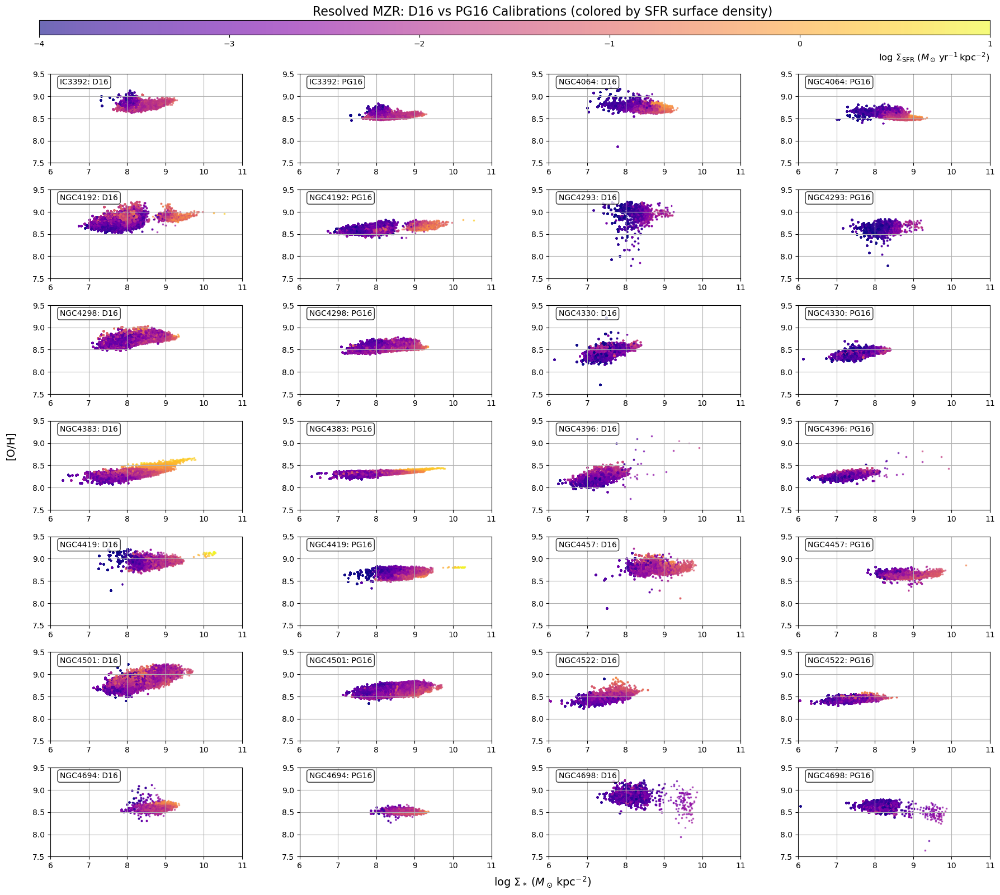

In [6]:
# ------------------------------------------------------------------
import matplotlib.pyplot as plt
from pathlib import Path
import numpy as np
from astropy.io import fits
from astropy.wcs import WCS
from matplotlib.gridspec import GridSpec
import astropy.units as u

# ------------------------------------------------------------------
# 0.  List galaxies and pin one colour to each
# ------------------------------------------------------------------
bin_maps = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bin_maps]        # auto-detect
cmap   = plt.get_cmap('tab20').colors                      # 20 hues
colour = {g: cmap[i % len(cmap)] for i, g in enumerate(galaxies)}

# ------------------------------------------------------------------
# 1.  Helper: read the two maps
# ------------------------------------------------------------------
def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
        wcs = WCS(h['LOGMASS_SURFACE_DENSITY'].header)
        mass_header = h['LOGMASS_SURFACE_DENSITY'].header
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        gas_header = h['LOGSFR_SURFACE_DENSITY_SF'].header
        oh_d16 = h['O_H_D16_SF'].data
        oh_pg16 = h['O_H_PG16_SF'].data
    return sigM, sigSFR, wcs, mass_header, gas_header, oh_d16, oh_pg16

# ------------------------------------------------------------------
# 4.  Compare D16 vs PG16 rMZR - 4 columns layout (colored by SFR surface density)
# ------------------------------------------------------------------

# Calculate number of rows needed for 4 columns (2 galaxies per row)
n_galaxies = len(galaxies)
n_rows = (n_galaxies + 1) // 2  # Two galaxies per row
fig, axes = plt.subplots(n_rows, 4, figsize=(20, 2.5*n_rows))  # 4 columns

# Handle case where there's only one galaxy
if n_rows == 1:
    axes = axes.reshape(1, -1)

scatter_for_cbar = None  # To store scatter plot for colorbar

for i, gal in enumerate(galaxies):
    # Calculate row and column positions
    row = i // 2  # Which row this galaxy goes in
    col_start = (i % 2) * 2  # Starting column: 0 for first galaxy in row, 2 for second
    
    # Load data for both calibrations including SFR
    sigM, sigSFR, wcs, mass_header, gas_header, oh_d16, oh_pg16 = load_maps(gal)
    
    # D16 data
    good_d16 = np.isfinite(sigM) & np.isfinite(oh_d16) & np.isfinite(sigSFR)
    x_d16, y_d16, sfr_d16 = sigM[good_d16], oh_d16[good_d16], sigSFR[good_d16]
    
    # PG16 data
    good_pg16 = np.isfinite(sigM) & np.isfinite(oh_pg16) & np.isfinite(sigSFR)
    x_pg16, y_pg16, sfr_pg16 = sigM[good_pg16], oh_pg16[good_pg16], sigSFR[good_pg16]
    
    # D16 scatter plot colored by SFR surface density
    scatter_d16 = axes[row, col_start].scatter(x_d16, y_d16, c=sfr_d16, s=2, alpha=0.6, marker=',', 
                                               cmap='plasma', vmin=-4, vmax=1)
    axes[row, col_start].set_xlim(6, 11)
    axes[row, col_start].set_ylim(7.5, 9.5)
    axes[row, col_start].grid(True)
    axes[row, col_start].text(0.05, 0.95, f'{gal}: D16', transform=axes[row, col_start].transAxes, 
                    bbox=dict(boxstyle='round', facecolor='white', alpha=0.8), 
                    verticalalignment='top', fontsize=10)
    
    # PG16 scatter plot colored by SFR surface density
    scatter_pg16 = axes[row, col_start+1].scatter(x_pg16, y_pg16, c=sfr_pg16, s=2, alpha=0.6, marker=',', 
                                                  cmap='plasma', vmin=-4, vmax=1)
    axes[row, col_start+1].set_xlim(6, 11)
    axes[row, col_start+1].set_ylim(7.5, 9.5)
    axes[row, col_start+1].grid(True)
    axes[row, col_start+1].text(0.05, 0.95, f'{gal}: PG16', transform=axes[row, col_start+1].transAxes, 
                    bbox=dict(boxstyle='round', facecolor='white', alpha=0.8), 
                    verticalalignment='top', fontsize=10)
    
    # Store scatter plot for colorbar (use the last one created)
    scatter_for_cbar = scatter_pg16

# Hide unused subplots if odd number of galaxies
if n_galaxies % 2 == 1:
    last_row = (n_galaxies - 1) // 2
    for j in range(2, 4):
        axes[last_row, j].set_visible(False)

# Add horizontal colorbar at the top
if scatter_for_cbar is not None:
    cbar_ax = fig.add_axes([0.05, 0.92, 0.85, 0.015])
    cbar = plt.colorbar(scatter_for_cbar, cax=cbar_ax, orientation='horizontal')
    cbar.set_label(r'$\log\,\Sigma_{\mathrm{SFR}} \; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', fontsize=12, loc='right')

# Add shared x and y labels
fig.text(0.5, 0.05, r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', ha='center', fontsize=14)
fig.text(0.02, 0.5, r'[O/H]', va='center', rotation='vertical', fontsize=14)

fig.suptitle('Resolved MZR: D16 vs PG16 Calibrations (colored by SFR surface density)', fontsize=16, y=0.95)
plt.subplots_adjust(hspace=0.3, wspace=0.3, top=0.88, bottom=0.08, left=0.06)  # Adjusted top margin for colorbar
plt.show()

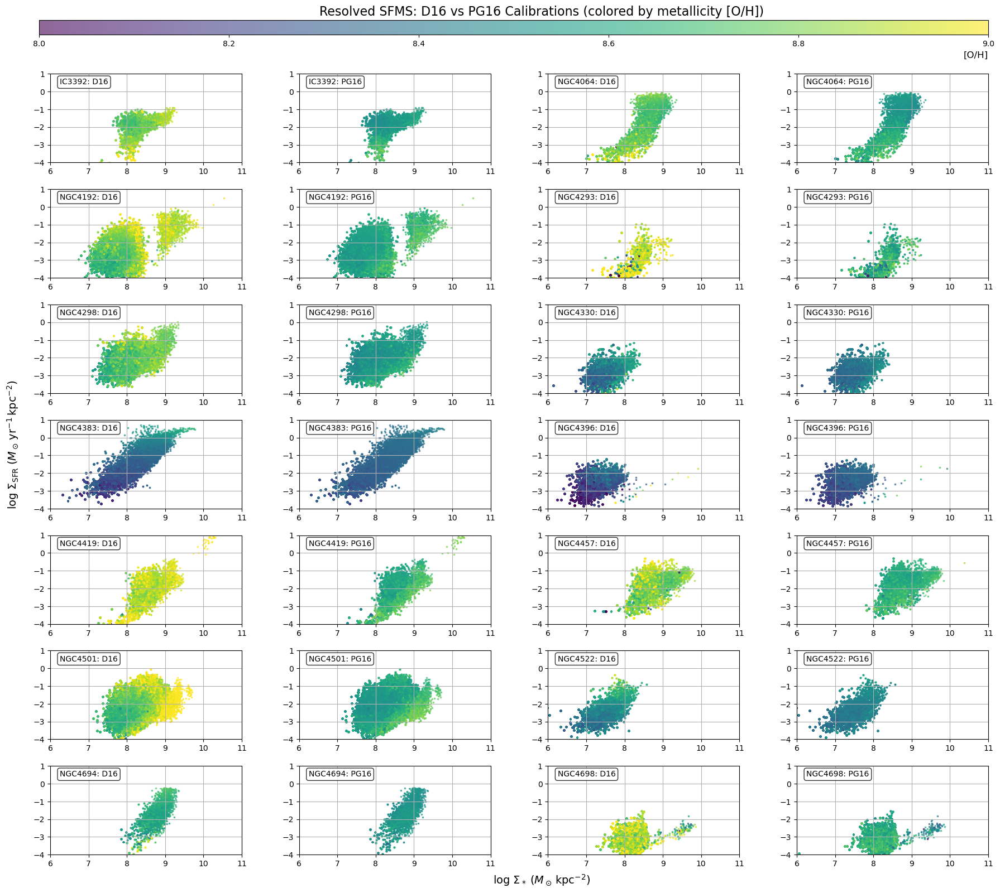

In [7]:
# ------------------------------------------------------------------
import matplotlib.pyplot as plt
from pathlib import Path
import numpy as np
from astropy.io import fits
from astropy.wcs import WCS
from matplotlib.gridspec import GridSpec
import astropy.units as u

# ------------------------------------------------------------------
# 0.  List galaxies and pin one colour to each
# ------------------------------------------------------------------
bin_maps = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bin_maps]        # auto-detect
cmap   = plt.get_cmap('tab20').colors                      # 20 hues
colour = {g: cmap[i % len(cmap)] for i, g in enumerate(galaxies)}

# ------------------------------------------------------------------
# 1.  Helper: read the two maps
# ------------------------------------------------------------------
def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
        wcs = WCS(h['LOGMASS_SURFACE_DENSITY'].header)
        mass_header = h['LOGMASS_SURFACE_DENSITY'].header
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        gas_header = h['LOGSFR_SURFACE_DENSITY_SF'].header
        oh_d16 = h['O_H_D16_SF'].data
        oh_pg16 = h['O_H_PG16_SF'].data
    return sigM, sigSFR, wcs, mass_header, gas_header, oh_d16, oh_pg16

# ------------------------------------------------------------------
# 5.  Compare D16 vs PG16 rSFMS - 4 columns layout (colored by metallicity [O/H])
# ------------------------------------------------------------------

# Calculate number of rows needed for 4 columns (2 galaxies per row)
n_galaxies = len(galaxies)
n_rows = (n_galaxies + 1) // 2  # Two galaxies per row
fig, axes = plt.subplots(n_rows, 4, figsize=(20, 2.5*n_rows))  # 4 columns

# Handle case where there's only one galaxy
if n_rows == 1:
    axes = axes.reshape(1, -1)

scatter_for_cbar = None  # To store scatter plot for colorbar

for i, gal in enumerate(galaxies):
    # Calculate row and column positions
    row = i // 2  # Which row this galaxy goes in
    col_start = (i % 2) * 2  # Starting column: 0 for first galaxy in row, 2 for second
    
    # Load data for both calibrations including metallicity
    sigM, sigSFR, wcs, mass_header, gas_header, oh_d16, oh_pg16 = load_maps(gal)
    
    # D16 data (rSFMS colored by D16 metallicity)
    good_d16 = np.isfinite(sigM) & np.isfinite(sigSFR) & np.isfinite(oh_d16)
    x_d16, y_d16, met_d16 = sigM[good_d16], sigSFR[good_d16], oh_d16[good_d16]
    
    # PG16 data (rSFMS colored by PG16 metallicity)
    good_pg16 = np.isfinite(sigM) & np.isfinite(sigSFR) & np.isfinite(oh_pg16)
    x_pg16, y_pg16, met_pg16 = sigM[good_pg16], sigSFR[good_pg16], oh_pg16[good_pg16]
    
    # D16 scatter plot colored by D16 metallicity
    scatter_d16 = axes[row, col_start].scatter(x_d16, y_d16, c=met_d16, s=2, alpha=0.6, marker=',', 
                                               cmap='viridis', vmin=8.0, vmax=9.0)
    axes[row, col_start].set_xlim(6, 11)
    axes[row, col_start].set_ylim(-4, 1)
    axes[row, col_start].grid(True)
    axes[row, col_start].text(0.05, 0.95, f'{gal}: D16', transform=axes[row, col_start].transAxes, 
                    bbox=dict(boxstyle='round', facecolor='white', alpha=0.8), 
                    verticalalignment='top', fontsize=10)
    
    # PG16 scatter plot colored by PG16 metallicity
    scatter_pg16 = axes[row, col_start+1].scatter(x_pg16, y_pg16, c=met_pg16, s=2, alpha=0.6, marker=',', 
                                                  cmap='viridis', vmin=8.0, vmax=9.0)
    axes[row, col_start+1].set_xlim(6, 11)
    axes[row, col_start+1].set_ylim(-4, 1)
    axes[row, col_start+1].grid(True)
    axes[row, col_start+1].text(0.05, 0.95, f'{gal}: PG16', transform=axes[row, col_start+1].transAxes, 
                    bbox=dict(boxstyle='round', facecolor='white', alpha=0.8), 
                    verticalalignment='top', fontsize=10)
    
    # Store scatter plot for colorbar (use the last one created)
    scatter_for_cbar = scatter_pg16

# Hide unused subplots if odd number of galaxies
if n_galaxies % 2 == 1:
    last_row = (n_galaxies - 1) // 2
    for j in range(2, 4):
        axes[last_row, j].set_visible(False)

# Add horizontal colorbar at the top
if scatter_for_cbar is not None:
    cbar_ax = fig.add_axes([0.05, 0.92, 0.85, 0.015])
    cbar = plt.colorbar(scatter_for_cbar, cax=cbar_ax, orientation='horizontal')
    cbar.set_label(r'[O/H]', fontsize=12, loc='right')

# Add shared x and y labels
fig.text(0.5, 0.05, r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', ha='center', fontsize=14)
fig.text(0.02, 0.5, r'$\log\,\Sigma_{\mathrm{SFR}} \; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', va='center', rotation='vertical', fontsize=14)

fig.suptitle('Resolved SFMS: D16 vs PG16 Calibrations (colored by metallicity [O/H])', fontsize=16, y=0.95)
plt.subplots_adjust(hspace=0.3, wspace=0.3, top=0.88, bottom=0.08, left=0.06)  # Adjusted top margin for colorbar
plt.show()

## 20250731

This is very interesting! A lot to digest . A couple of quick suggestions: 
1) consider what it means an increase metallicity with increasing mass - interesting your expectation was different ; 
2) in a few galaxies, this is not always the case, making things even more intriguing. Can you convince yourself these are real difference?; 
3) when you compare the 2 indicators make sure you are plotting the same spaxels (it is possible that you may have more points in one version due to S/N of the line). 
4) consider reducing the range of y-axis to see more structure. 
5) as for the rSFR, keep an eye on the comparison with the literature. Will try to find some time to think about all this... there is a lot to unpack.   

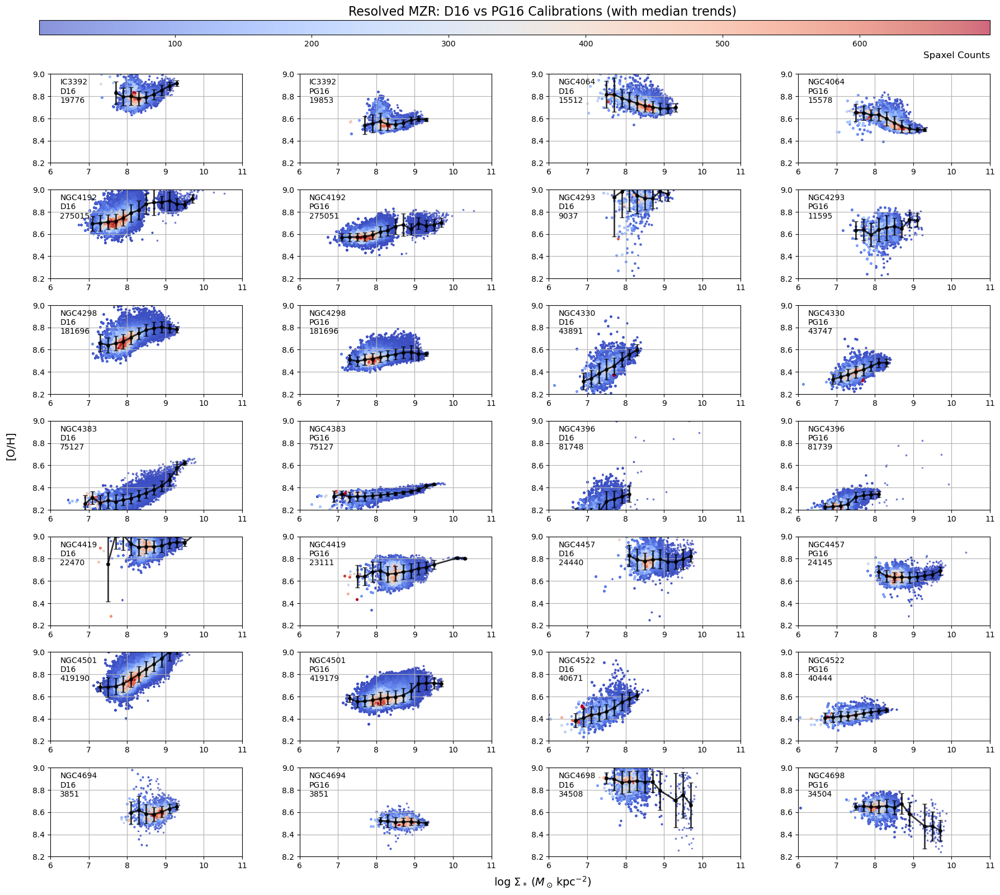

In [8]:
# ------------------------------------------------------------------
import matplotlib.pyplot as plt
from pathlib import Path
import numpy as np 
from astropy.io import fits
from astropy.wcs import WCS
from matplotlib.gridspec import GridSpec
import astropy.units as u
from scipy import stats

# ------------------------------------------------------------------
# Helper function to calculate binned median and std
# ------------------------------------------------------------------
def calculate_binned_median(x_data, y_data, bin_width=0.2, x_range=(6, 11)):
    """Calculate binned median and standard deviation for y-data"""
    # Create bin edges
    bin_edges = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    bin_centers = bin_edges[:-1] + bin_width / 2
    
    medians = []
    stds = []
    counts = []
    
    for i in range(len(bin_edges) - 1):
        mask = (x_data >= bin_edges[i]) & (x_data < bin_edges[i + 1])
        if np.sum(mask) > 0:
            y_bin = y_data[mask]
            unique_points = len(np.unique(y_bin))
            if unique_points >= 10:  # Need at least 100 unique points for meaningful stats
                medians.append(np.median(y_bin))
                stds.append(np.std(y_bin))
                counts.append(len(y_bin))
            else:
                medians.append(np.nan)
                stds.append(np.nan)
                counts.append(len(y_bin))
        else:
            medians.append(np.nan)
            stds.append(np.nan)
            counts.append(0)
    
    return bin_centers, np.array(medians), np.array(stds), np.array(counts)

# ------------------------------------------------------------------
# 0.  List galaxies and pin one colour to each
# ------------------------------------------------------------------
bin_maps = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bin_maps]        # auto-detect
cmap   = plt.get_cmap('tab20').colors                      # 20 hues
colour = {g: cmap[i % len(cmap)] for i, g in enumerate(galaxies)}

# ------------------------------------------------------------------
# 1.  Helper: read the two maps
# ------------------------------------------------------------------
def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
        wcs = WCS(h['LOGMASS_SURFACE_DENSITY'].header)
        mass_header = h['LOGMASS_SURFACE_DENSITY'].header
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        gas_header = h['LOGSFR_SURFACE_DENSITY_SF'].header
        oh_pg16 = h['O_H_PG16_SF'].data
    return sigM, sigSFR, wcs, mass_header, gas_header, oh_pg16

# ------------------------------------------------------------------
# 3.  Compare D16 vs PG16 rMZR - 4 columns layout (2 galaxies per row)
# ------------------------------------------------------------------

# Calculate number of rows needed for 4 columns (2 galaxies per row)
n_galaxies = len(galaxies)
n_rows = (n_galaxies + 1) // 2  # Two galaxies per row
fig, axes = plt.subplots(n_rows, 4, figsize=(20, 2.5*n_rows))  # 4 columns

# Handle case where there's only one galaxy
if n_rows == 1:
    axes = axes.reshape(1, -1)

scatter_for_cbar = None  # To store scatter plot for colorbar

for i, gal in enumerate(galaxies):
    # Calculate row and column positions
    row = i // 2  # Which row this galaxy goes in
    col_start = (i % 2) * 2  # Starting column: 0 for first galaxy in row, 2 for second
    
    # Load data for both calibrations
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        oh_d16 = h['O_H_D16_SF'].data
        oh_pg16 = h['O_H_PG16_SF'].data
    
    # D16 data
    good_d16 = np.isfinite(sigM) & np.isfinite(oh_d16)
    x_d16, y_d16 = sigM[good_d16], oh_d16[good_d16]
    
    # PG16 data
    good_pg16 = np.isfinite(sigM) & np.isfinite(oh_pg16)
    x_pg16, y_pg16 = sigM[good_pg16], oh_pg16[good_pg16]
    
    # D16 scatter plot
    H_d16, xedges_d16, yedges_d16 = np.histogram2d(x_d16, y_d16, bins=100, range=[[6, 11], [7.5, 9.5]])
    x_idx_d16 = np.clip(np.digitize(x_d16, xedges_d16) - 1, 0, H_d16.shape[0] - 1)
    y_idx_d16 = np.clip(np.digitize(y_d16, yedges_d16) - 1, 0, H_d16.shape[1] - 1)
    density_d16 = H_d16[x_idx_d16, y_idx_d16]
    
    scatter_d16 = axes[row, col_start].scatter(x_d16, y_d16, c=density_d16, s=2, alpha=0.6, marker=',', cmap='coolwarm')
    
    # Calculate and plot median trend for D16
    bin_centers_d16, medians_d16, stds_d16, counts_d16 = calculate_binned_median(x_d16, y_d16, bin_width=0.2)
    valid_bins_d16 = ~np.isnan(medians_d16)
    if np.sum(valid_bins_d16) > 0:
        axes[row, col_start].errorbar(bin_centers_d16[valid_bins_d16], medians_d16[valid_bins_d16], 
                                      yerr=stds_d16[valid_bins_d16], 
                                      fmt='o-', color='black', linewidth=2, markersize=4, 
                                      capsize=3, capthick=1, alpha=0.8, zorder=10)
    
    axes[row, col_start].set_xlim(6, 11)
    axes[row, col_start].set_ylim(8.2, 9.0)
    axes[row, col_start].grid(True)
    axes[row, col_start].text(0.05, 0.95, f'{gal}\nD16\n{len(x_d16)}', transform=axes[row, col_start].transAxes, 
                    bbox=dict(boxstyle='round', facecolor='none', alpha=0.8, edgecolor='none'),
                    verticalalignment='top', fontsize=10)
    
    # PG16 scatter plot
    H_pg16, xedges_pg16, yedges_pg16 = np.histogram2d(x_pg16, y_pg16, bins=100, range=[[6, 11], [7.5, 9.5]])
    x_idx_pg16 = np.clip(np.digitize(x_pg16, xedges_pg16) - 1, 0, H_pg16.shape[0] - 1)
    y_idx_pg16 = np.clip(np.digitize(y_pg16, yedges_pg16) - 1, 0, H_pg16.shape[1] - 1)
    density_pg16 = H_pg16[x_idx_pg16, y_idx_pg16]
    
    scatter_pg16 = axes[row, col_start+1].scatter(x_pg16, y_pg16, c=density_pg16, s=2, alpha=0.6, marker=',', cmap='coolwarm')
    
    # Calculate and plot median trend for PG16
    bin_centers_pg16, medians_pg16, stds_pg16, counts_pg16 = calculate_binned_median(x_pg16, y_pg16, bin_width=0.2)
    valid_bins_pg16 = ~np.isnan(medians_pg16)
    if np.sum(valid_bins_pg16) > 0:
        axes[row, col_start+1].errorbar(bin_centers_pg16[valid_bins_pg16], medians_pg16[valid_bins_pg16], 
                                        yerr=stds_pg16[valid_bins_pg16], 
                                        fmt='o-', color='black', linewidth=2, markersize=4, 
                                        capsize=3, capthick=1, alpha=0.8, zorder=10)
    
    axes[row, col_start+1].set_xlim(6, 11)
    axes[row, col_start+1].set_ylim(8.2, 9.0)
    axes[row, col_start+1].grid(True)
    axes[row, col_start+1].text(0.05, 0.95, f'{gal}\nPG16\n{len(x_pg16)}', transform=axes[row, col_start+1].transAxes, 
                        bbox=dict(boxstyle='round', facecolor='none', alpha=0.8, edgecolor='none'),
                    verticalalignment='top', fontsize=10)
    
    # Store scatter plot for colorbar (use the last one created)
    scatter_for_cbar = scatter_pg16

# Hide unused subplots if odd number of galaxies
if n_galaxies % 2 == 1:
    last_row = (n_galaxies - 1) // 2
    for j in range(2, 4):
        axes[last_row, j].set_visible(False)

# Add horizontal colorbar at the top
if scatter_for_cbar is not None:
    cbar_ax = fig.add_axes([0.05, 0.92, 0.85, 0.015])
    cbar = plt.colorbar(scatter_for_cbar, cax=cbar_ax, orientation='horizontal')
    cbar.set_label('Spaxel Counts', fontsize=12, loc='right')

# Add shared x and y labels
fig.text(0.5, 0.05, r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', ha='center', fontsize=14)
fig.text(0.02, 0.5, r'[O/H]', va='center', rotation='vertical', fontsize=14)

fig.suptitle('Resolved MZR: D16 vs PG16 Calibrations (with median trends)', fontsize=16, y=0.95)
plt.subplots_adjust(hspace=0.3, wspace=0.3, top=0.88, bottom=0.08, left=0.06)  # Adjusted top margin for colorbar
plt.show()

/var/folders/rm/clp89v210v32vh5vjt2kx7b80000gr/T/ipykernel_65174/98378448.py:287: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])


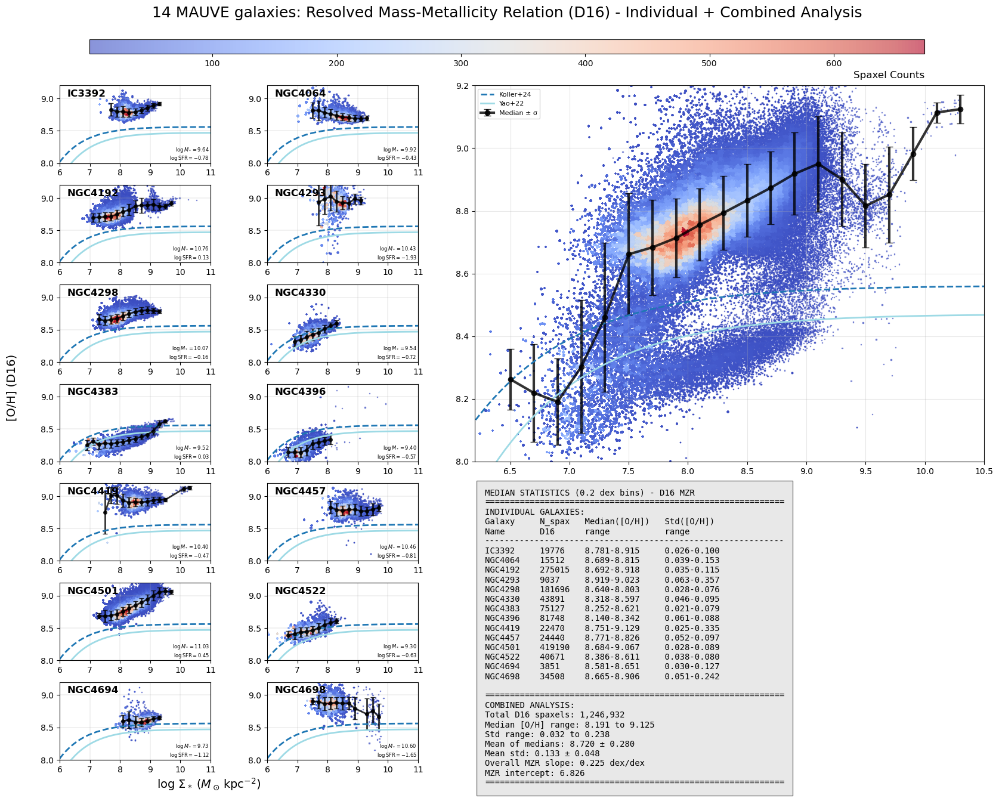

In [9]:
# ------------------------------------------------------------------
# COMPREHENSIVE LAYOUT: Individual galaxies + Combined plot + Statistics (D16 MZR)
# 4-column layout: Cols 1-2 = Individual galaxies, Col 3 = Combined plot, Col 4 = Statistics
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from pathlib import Path
from astropy.io import fits
import itertools
import re  # Add this import for regex

# 0 · discover galaxies & colour palette
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)
assert ngal <= 14, "This layout assumes ≤ 14 galaxies."

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        oh_d16 = h['O_H_D16_SF'].data
    return sigM, oh_d16

# Extraction functions for log files
def extract_total_stellar_mass(galaxy_name):
    """Extract total stellar mass from mass log file. Returns log10(M☉) value or None if not found."""
    log_file = Path(f'mass_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total stellar mass \(R\)\s*:\s*([\d.-]+)\s*log10\(M☉\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading mass log for {galaxy_name}: {e}")
        return None

def extract_total_sfr(galaxy_name):
    """Extract total SFR from SFR log file. Returns log10(M☉/yr) value or None if not found."""
    log_file = Path(f'sfr_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total Halpha SFR from SF region:.*?in log10 scale:\s*([\d.-]+)\s*log\(M☉/yr\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading SFR log for {galaxy_name}: {e}")
        return None

def calculate_median_statistics(x, y, x_range=(6, 11), bin_width=0.2):
    """Calculate median and std in binned intervals"""
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    
    medians = []
    stds = []
    x_valid = []
    
    for i in range(len(x_bins) - 1):
        mask = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if len(np.unique(x[mask])) >= 10:  # Need at least 10 distinct x values
            y_bin = y[mask]
            medians.append(np.median(y_bin))
            stds.append(np.std(y_bin))
            x_valid.append(x_centers[i])
    
    return np.array(x_valid), np.array(medians), np.array(stds)

def plot_literature_mzr_fits(ax, show_legend=False):
    """Plot literature MZR fits on the given axis"""
    # Define x range for plotting literature fits
    x = np.linspace(6, 11, 100)
    
    # Yao+22
    # 12 + log(O/H) = a + b(log Σ* - c)e^(-(x-c))
    # Coefficients: a = 8.47, b = 0.0002, c = 12.36
    a1, b1, c1 = 8.47, 0.0002, 12.36
    y_yao22 = a1 + b1 * (x - c1) * np.exp(-(x - c1))

    # Koller+24
    # 12 + log(O/H) = a + b(log Σ* - c)exp(-(log Σ* - c))
    # Coefficients: a = 8.561, b = 0.0001, c = 12.7
    a2, b2, c2 = 8.561, 0.0001, 12.7
    y_koller24 = a2 + b2 * (x - c2) * np.exp(-(x - c2))

    # MZR literature data
    plot_data = [
        (y_koller24, 'Koller+24', '--'),
        (y_yao22, 'Yao+22', '-'),
    ]
    
    # Plot all literature fits
    colors = plt.cm.tab20(np.linspace(0, 1, len(plot_data)))
    for i, (y, label, linestyle) in enumerate(plot_data):
        if show_legend:
            ax.plot(x, y, label=label, linewidth=2, linestyle=linestyle, color=colors[i])
        else:
            ax.plot(x, y, linewidth=2, linestyle=linestyle, color=colors[i])

# 1 · Create comprehensive figure with 4-column layout
fig = plt.figure(figsize=(20, 16))
gs = GridSpec(nrows=8, ncols=4, figure=fig,
              width_ratios=[1, 1, 1.5, 1.5],  # Cols 3&4 slightly wider
              height_ratios=[0.5, 1, 1, 1, 1, 1, 1, 1],  # Row 0 for colorbar
              wspace=0.3, hspace=0.3)

plot_idx = 0
scatter_for_cbar = None
individual_stats = []

# COLUMNS 1-2: Individual galaxy plots
for idx, gal in enumerate(galaxies):
    sigM, oh_d16 = load_maps(gal)
    
    good_d16 = np.isfinite(sigM) & np.isfinite(oh_d16)
    
    if not np.any(good_d16):
        print(f"Skipping {gal}: no valid data points")
        continue
    
    row = (plot_idx // 2) + 1  # Start from row 1 (row 0 for colorbar)
    col = plot_idx % 2
    plot_idx += 1

    axP = fig.add_subplot(gs[row, col])
    
    x_d16, y_d16 = sigM[good_d16], oh_d16[good_d16]
    
    # Calculate median statistics
    x_median, y_median, y_std = calculate_median_statistics(x_d16, y_d16)
    individual_stats.append((gal, x_median, y_median, y_std, len(x_d16)))
    
    # Density-based scatter
    H, xedges, yedges = np.histogram2d(x_d16, y_d16, bins=50, range=[[6, 11], [8.0, 9.2]])
    x_idx = np.clip(np.digitize(x_d16, xedges) - 1, 0, H.shape[0] - 1)
    y_idx = np.clip(np.digitize(y_d16, yedges) - 1, 0, H.shape[1] - 1)
    density = H[x_idx, y_idx]
    
    scatter = axP.scatter(x_d16, y_d16, c=density, s=1, alpha=0.6, marker=',', 
                         cmap='coolwarm')
    
    # Plot median with error bars
    if len(x_median) > 0:
        axP.errorbar(x_median, y_median, yerr=y_std, fmt='ko-', linewidth=2, 
                    markersize=4, capsize=3, alpha=0.8)
    
    if scatter_for_cbar is None:
        scatter_for_cbar = scatter
    
    # Add literature fits to individual panels (no legend)
    plot_literature_mzr_fits(axP, show_legend=False)
    
    # Add galaxy name in top left corner
    axP.text(0.05, 0.95, gal, transform=axP.transAxes, fontsize=12, fontweight='bold',
             va='top', ha='left', bbox=dict(boxstyle='round,pad=0.3', facecolor='none', alpha=0.8, edgecolor='none'))
    
    # Bottom right: total stellar mass and SFR from log files
    total_mass = extract_total_stellar_mass(gal)
    total_sfr = extract_total_sfr(gal)
    
    if total_mass is not None and total_sfr is not None:
        log_text = fr'$\log M_* = {total_mass:.2f}$' '\n' fr'$\log \mathrm{{SFR}} = {total_sfr:.2f}$'
        axP.text(0.99, 0.01, log_text,
                 transform=axP.transAxes, va='bottom', ha='right', fontsize=6,
                 bbox=dict(facecolor='none', alpha=0.8, edgecolor='none', pad=2))
    
    axP.set_xlim(6, 11)
    axP.set_ylim(8.0, 9.2)
    axP.grid(True, lw=0.25)

# COLUMNS 3-4: Combined plot - Upper panel
ax_combined = fig.add_subplot(gs[1:5, 2:4])  # Spans rows 1-4, columns 2-3

# Collect all data for combined analysis
all_x, all_y = [], []
galaxy_counts = {}

for gal in galaxies:
    sigM, oh_d16 = load_maps(gal)
    good_d16 = np.isfinite(sigM) & np.isfinite(oh_d16)
    
    if np.any(good_d16):
        x_d16, y_d16 = sigM[good_d16], oh_d16[good_d16]
        all_x.extend(x_d16)
        all_y.extend(y_d16)
        galaxy_counts[gal] = len(x_d16)
    else:
        galaxy_counts[gal] = 0

all_x, all_y = np.array(all_x), np.array(all_y)

# Calculate combined median statistics
x_median_combined, y_median_combined, y_std_combined = calculate_median_statistics(all_x, all_y)

# Density-based scatter for combined data
H, xedges, yedges = np.histogram2d(all_x, all_y, bins=100, range=[[6, 11], [8.0, 9.2]])
x_idx = np.clip(np.digitize(all_x, xedges) - 1, 0, H.shape[0] - 1)
y_idx = np.clip(np.digitize(all_y, yedges) - 1, 0, H.shape[1] - 1)
density = H[x_idx, y_idx]

scatter_combined = ax_combined.scatter(all_x, all_y, c=density, s=1, alpha=0.6, marker=',', 
                                      cmap='coolwarm')

# Plot combined median with error bars
if len(x_median_combined) > 0:
    ax_combined.errorbar(x_median_combined, y_median_combined, yerr=y_std_combined, 
                        fmt='ko-', linewidth=3, markersize=6, capsize=4, alpha=0.8, label='Median ± σ')

# Add literature fits to combined panel (with legend)
plot_literature_mzr_fits(ax_combined, show_legend=True)

# Add legend with small font
ax_combined.legend(fontsize=8, ncol=1, loc='upper left')

ax_combined.set_xlim(6.2, 10.5)
ax_combined.set_ylim(8.0, 9.2)
ax_combined.grid(True, alpha=0.3)

# COLUMNS 3-4: Statistics table - Lower panel
ax_stats = fig.add_subplot(gs[5:8, 2:4])  # Spans rows 5-7, columns 2-3
ax_stats.axis('off')

# Create comprehensive statistics text
stats_table = "MEDIAN STATISTICS (0.2 dex bins) - D16 MZR\n"
stats_table += "="*60 + "\n"
stats_table += "INDIVIDUAL GALAXIES:\n"
stats_table += f"{'Galaxy':<10} {'N_spax':<8} {'Median([O/H])':<15} {'Std([O/H])':<15}\n"
stats_table += f"{'Name':<10} {'D16':<8} {'range':<15} {'range':<15}\n"
stats_table += "-"*60 + "\n"

for gal, x_median, y_median, y_std, n_spax in individual_stats:
    if len(y_median) > 0:
        median_range = f"{y_median.min():.3f}-{y_median.max():.3f}"
        std_range = f"{y_std.min():.3f}-{y_std.max():.3f}"
    else:
        median_range = "N/A"
        std_range = "N/A"
    
    stats_table += f"{gal:<10} {n_spax:<8} {median_range:<15} {std_range:<15}\n"

stats_table += "\n" + "="*60 + "\n"
stats_table += "COMBINED ANALYSIS:\n"
stats_table += f"Total D16 spaxels: {len(all_x):,}\n"
if len(y_median_combined) > 0:
    stats_table += f"Median [O/H] range: {y_median_combined.min():.3f} to {y_median_combined.max():.3f}\n"
    stats_table += f"Std range: {y_std_combined.min():.3f} to {y_std_combined.max():.3f}\n"
    stats_table += f"Mean of medians: {np.mean(y_median_combined):.3f} ± {np.std(y_median_combined):.3f}\n"
    stats_table += f"Mean std: {np.mean(y_std_combined):.3f} ± {np.std(y_std_combined):.3f}\n"
    
    # Calculate overall metallicity gradient (slope)
    if len(x_median_combined) > 3:
        slope, intercept = np.polyfit(x_median_combined, y_median_combined, 1)
        stats_table += f"Overall MZR slope: {slope:.3f} dex/dex\n"
        stats_table += f"MZR intercept: {intercept:.3f}\n"
        
stats_table += "="*60

ax_stats.text(0.02, 0.98, stats_table, transform=ax_stats.transAxes, va='top', ha='left',
              fontsize=10, family='monospace',
              bbox=dict(facecolor='lightgray', alpha=0.5, edgecolor='black', pad=10))

# Add horizontal colorbar at the top
if scatter_for_cbar is not None:
    cbar_ax = fig.add_axes([0.15, 0.85, 0.7, 0.015])
    cbar = plt.colorbar(scatter_for_cbar, cax=cbar_ax, orientation='horizontal')
    cbar.set_label('Spaxel Counts', fontsize=12, loc='right')

# Global title and labels
fig.suptitle(fr'{ngal} MAUVE galaxies: Resolved Mass-Metallicity Relation (D16) - Individual + Combined Analysis', 
             fontsize=18, y=0.90)

# Shared axis labels
fig.text(0.25, 0.08, r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', 
         ha='center', fontsize=14)
fig.text(0.08, 0.5, r'[O/H] (D16)', 
         va='center', rotation='vertical', fontsize=14)

plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])
plt.show()

/var/folders/rm/clp89v210v32vh5vjt2kx7b80000gr/T/ipykernel_65174/1436883403.py:287: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])


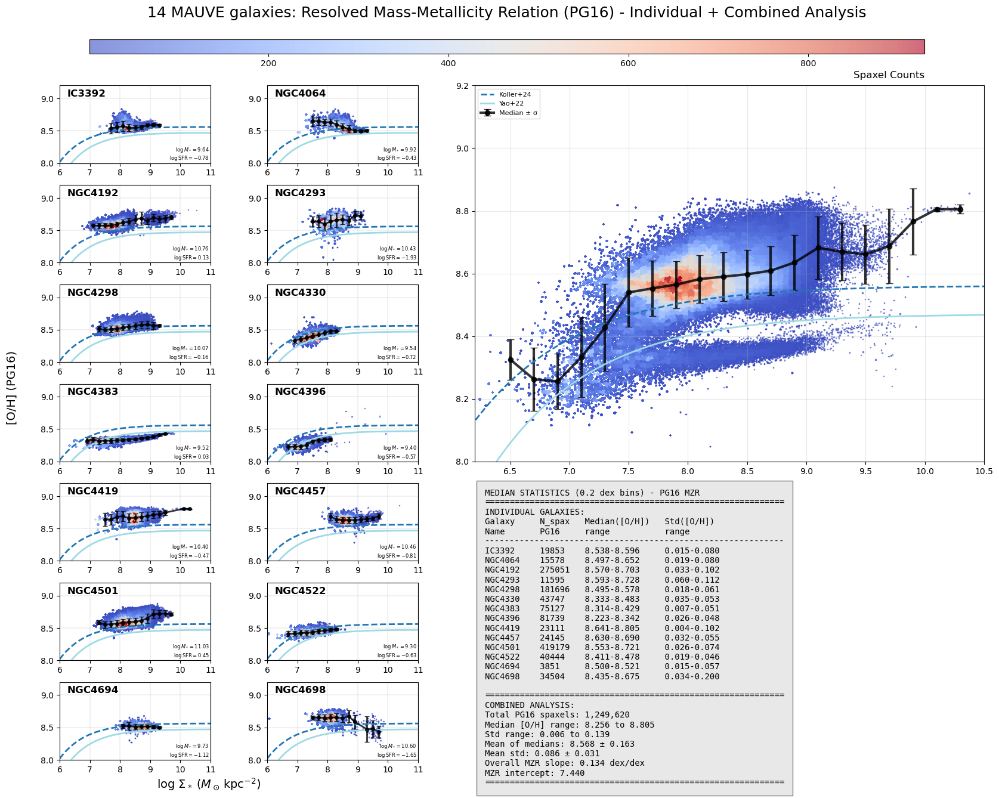

In [10]:
# ------------------------------------------------------------------
# COMPREHENSIVE LAYOUT: Individual galaxies + Combined plot + Statistics (PG16 MZR)
# 4-column layout: Cols 1-2 = Individual galaxies, Col 3 = Combined plot, Col 4 = Statistics
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from pathlib import Path
from astropy.io import fits
import itertools
import re  # Add this import for regex

# 0 · discover galaxies & colour palette
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)
assert ngal <= 14, "This layout assumes ≤ 14 galaxies."

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        oh_pg16 = h['O_H_PG16_SF'].data
    return sigM, oh_pg16

# Extraction functions for log files
def extract_total_stellar_mass(galaxy_name):
    """Extract total stellar mass from mass log file. Returns log10(M☉) value or None if not found."""
    log_file = Path(f'mass_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total stellar mass \(R\)\s*:\s*([\d.-]+)\s*log10\(M☉\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading mass log for {galaxy_name}: {e}")
        return None

def extract_total_sfr(galaxy_name):
    """Extract total SFR from SFR log file. Returns log10(M☉/yr) value or None if not found."""
    log_file = Path(f'sfr_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total Halpha SFR from SF region:.*?in log10 scale:\s*([\d.-]+)\s*log\(M☉/yr\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading SFR log for {galaxy_name}: {e}")
        return None

def calculate_median_statistics(x, y, x_range=(6, 11), bin_width=0.2):
    """Calculate median and std in binned intervals"""
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    
    medians = []
    stds = []
    x_valid = []
    
    for i in range(len(x_bins) - 1):
        mask = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if len(np.unique(x[mask])) >= 10:  # Need at least 10 distinct x values
            y_bin = y[mask]
            medians.append(np.median(y_bin))
            stds.append(np.std(y_bin))
            x_valid.append(x_centers[i])
    
    return np.array(x_valid), np.array(medians), np.array(stds)

def plot_literature_mzr_fits(ax, show_legend=False):
    """Plot literature MZR fits on the given axis"""
    # Define x range for plotting literature fits
    x = np.linspace(6, 11, 100)
    
    # Yao+22
    # 12 + log(O/H) = a + b(log Σ* - c)e^(-(x-c))
    # Coefficients: a = 8.47, b = 0.0002, c = 12.36
    a1, b1, c1 = 8.47, 0.0002, 12.36
    y_yao22 = a1 + b1 * (x - c1) * np.exp(-(x - c1))

    # Koller+24
    # 12 + log(O/H) = a + b(log Σ* - c)exp(-(log Σ* - c))
    # Coefficients: a = 8.561, b = 0.0001, c = 12.7
    a2, b2, c2 = 8.561, 0.0001, 12.7
    y_koller24 = a2 + b2 * (x - c2) * np.exp(-(x - c2))

    # MZR literature data
    plot_data = [
        (y_koller24, 'Koller+24', '--'),
        (y_yao22, 'Yao+22', '-'),
    ]
    
    # Plot all literature fits
    colors = plt.cm.tab20(np.linspace(0, 1, len(plot_data)))
    for i, (y, label, linestyle) in enumerate(plot_data):
        if show_legend:
            ax.plot(x, y, label=label, linewidth=2, linestyle=linestyle, color=colors[i])
        else:
            ax.plot(x, y, linewidth=2, linestyle=linestyle, color=colors[i])

# 1 · Create comprehensive figure with 4-column layout
fig = plt.figure(figsize=(20, 16))
gs = GridSpec(nrows=8, ncols=4, figure=fig,
              width_ratios=[1, 1, 1.5, 1.5],  # Cols 3&4 slightly wider
              height_ratios=[0.5, 1, 1, 1, 1, 1, 1, 1],  # Row 0 for colorbar
              wspace=0.3, hspace=0.3)

plot_idx = 0
scatter_for_cbar = None
individual_stats = []

# COLUMNS 1-2: Individual galaxy plots
for idx, gal in enumerate(galaxies):
    sigM, oh_pg16 = load_maps(gal)
    
    good_pg16 = np.isfinite(sigM) & np.isfinite(oh_pg16)
    
    if not np.any(good_pg16):
        print(f"Skipping {gal}: no valid data points")
        continue
    
    row = (plot_idx // 2) + 1  # Start from row 1 (row 0 for colorbar)
    col = plot_idx % 2
    plot_idx += 1

    axP = fig.add_subplot(gs[row, col])
    
    x_pg16, y_pg16 = sigM[good_pg16], oh_pg16[good_pg16]
    
    # Calculate median statistics
    x_median, y_median, y_std = calculate_median_statistics(x_pg16, y_pg16)
    individual_stats.append((gal, x_median, y_median, y_std, len(x_pg16)))
    
    # Density-based scatter
    H, xedges, yedges = np.histogram2d(x_pg16, y_pg16, bins=50, range=[[6, 11], [8.0, 9.2]])
    x_idx = np.clip(np.digitize(x_pg16, xedges) - 1, 0, H.shape[0] - 1)
    y_idx = np.clip(np.digitize(y_pg16, yedges) - 1, 0, H.shape[1] - 1)
    density = H[x_idx, y_idx]
    
    scatter = axP.scatter(x_pg16, y_pg16, c=density, s=1, alpha=0.6, marker=',', 
                         cmap='coolwarm')
    
    # Plot median with error bars
    if len(x_median) > 0:
        axP.errorbar(x_median, y_median, yerr=y_std, fmt='ko-', linewidth=2, 
                    markersize=4, capsize=3, alpha=0.8)
    
    if scatter_for_cbar is None:
        scatter_for_cbar = scatter
    
    # Add literature fits to individual panels (no legend)
    plot_literature_mzr_fits(axP, show_legend=False)
    
    # Add galaxy name in top left corner
    axP.text(0.05, 0.95, gal, transform=axP.transAxes, fontsize=12, fontweight='bold',
             va='top', ha='left', bbox=dict(boxstyle='round,pad=0.3', facecolor='none', alpha=0.8, edgecolor='none'))
    
    # Bottom right: total stellar mass and SFR from log files
    total_mass = extract_total_stellar_mass(gal)
    total_sfr = extract_total_sfr(gal)
    
    if total_mass is not None and total_sfr is not None:
        log_text = fr'$\log M_* = {total_mass:.2f}$' '\n' fr'$\log \mathrm{{SFR}} = {total_sfr:.2f}$'
        axP.text(0.99, 0.01, log_text,
                 transform=axP.transAxes, va='bottom', ha='right', fontsize=6,
                 bbox=dict(facecolor='none', alpha=0.8, edgecolor='none', pad=2))
    
    axP.set_xlim(6, 11)
    axP.set_ylim(8.0, 9.2)
    axP.grid(True, lw=0.25)

# COLUMNS 3-4: Combined plot - Upper panel
ax_combined = fig.add_subplot(gs[1:5, 2:4])  # Spans rows 1-4, columns 2-3

# Collect all data for combined analysis
all_x, all_y = [], []
galaxy_counts = {}

for gal in galaxies:
    sigM, oh_pg16 = load_maps(gal)
    good_pg16 = np.isfinite(sigM) & np.isfinite(oh_pg16)
    
    if np.any(good_pg16):
        x_pg16, y_pg16 = sigM[good_pg16], oh_pg16[good_pg16]
        all_x.extend(x_pg16)
        all_y.extend(y_pg16)
        galaxy_counts[gal] = len(x_pg16)
    else:
        galaxy_counts[gal] = 0

all_x, all_y = np.array(all_x), np.array(all_y)

# Calculate combined median statistics
x_median_combined, y_median_combined, y_std_combined = calculate_median_statistics(all_x, all_y)

# Density-based scatter for combined data
H, xedges, yedges = np.histogram2d(all_x, all_y, bins=100, range=[[6, 11], [8.0, 9.2]])
x_idx = np.clip(np.digitize(all_x, xedges) - 1, 0, H.shape[0] - 1)
y_idx = np.clip(np.digitize(all_y, yedges) - 1, 0, H.shape[1] - 1)
density = H[x_idx, y_idx]

scatter_combined = ax_combined.scatter(all_x, all_y, c=density, s=1, alpha=0.6, marker=',', 
                                      cmap='coolwarm')

# Plot combined median with error bars
if len(x_median_combined) > 0:
    ax_combined.errorbar(x_median_combined, y_median_combined, yerr=y_std_combined, 
                        fmt='ko-', linewidth=3, markersize=6, capsize=4, alpha=0.8, label='Median ± σ')

# Add literature fits to combined panel (with legend)
plot_literature_mzr_fits(ax_combined, show_legend=True)

# Add legend with small font
ax_combined.legend(fontsize=8, ncol=1, loc='upper left')

ax_combined.set_xlim(6.2, 10.5)
ax_combined.set_ylim(8.0, 9.2)
ax_combined.grid(True, alpha=0.3)

# COLUMNS 3-4: Statistics table - Lower panel
ax_stats = fig.add_subplot(gs[5:8, 2:4])  # Spans rows 5-7, columns 2-3
ax_stats.axis('off')

# Create comprehensive statistics text
stats_table = "MEDIAN STATISTICS (0.2 dex bins) - PG16 MZR\n"
stats_table += "="*60 + "\n"
stats_table += "INDIVIDUAL GALAXIES:\n"
stats_table += f"{'Galaxy':<10} {'N_spax':<8} {'Median([O/H])':<15} {'Std([O/H])':<15}\n"
stats_table += f"{'Name':<10} {'PG16':<8} {'range':<15} {'range':<15}\n"
stats_table += "-"*60 + "\n"

for gal, x_median, y_median, y_std, n_spax in individual_stats:
    if len(y_median) > 0:
        median_range = f"{y_median.min():.3f}-{y_median.max():.3f}"
        std_range = f"{y_std.min():.3f}-{y_std.max():.3f}"
    else:
        median_range = "N/A"
        std_range = "N/A"
    
    stats_table += f"{gal:<10} {n_spax:<8} {median_range:<15} {std_range:<15}\n"

stats_table += "\n" + "="*60 + "\n"
stats_table += "COMBINED ANALYSIS:\n"
stats_table += f"Total PG16 spaxels: {len(all_x):,}\n"
if len(y_median_combined) > 0:
    stats_table += f"Median [O/H] range: {y_median_combined.min():.3f} to {y_median_combined.max():.3f}\n"
    stats_table += f"Std range: {y_std_combined.min():.3f} to {y_std_combined.max():.3f}\n"
    stats_table += f"Mean of medians: {np.mean(y_median_combined):.3f} ± {np.std(y_median_combined):.3f}\n"
    stats_table += f"Mean std: {np.mean(y_std_combined):.3f} ± {np.std(y_std_combined):.3f}\n"
    
    # Calculate overall metallicity gradient (slope)
    if len(x_median_combined) > 3:
        slope, intercept = np.polyfit(x_median_combined, y_median_combined, 1)
        stats_table += f"Overall MZR slope: {slope:.3f} dex/dex\n"
        stats_table += f"MZR intercept: {intercept:.3f}\n"
        
stats_table += "="*60

ax_stats.text(0.02, 0.98, stats_table, transform=ax_stats.transAxes, va='top', ha='left',
              fontsize=10, family='monospace',
              bbox=dict(facecolor='lightgray', alpha=0.5, edgecolor='black', pad=10))

# Add horizontal colorbar at the top
if scatter_for_cbar is not None:
    cbar_ax = fig.add_axes([0.15, 0.85, 0.7, 0.015])
    cbar = plt.colorbar(scatter_for_cbar, cax=cbar_ax, orientation='horizontal')
    cbar.set_label('Spaxel Counts', fontsize=12, loc='right')

# Global title and labels
fig.suptitle(fr'{ngal} MAUVE galaxies: Resolved Mass-Metallicity Relation (PG16) - Individual + Combined Analysis', 
             fontsize=18, y=0.90)

# Shared axis labels
fig.text(0.25, 0.08, r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', 
         ha='center', fontsize=14)
fig.text(0.08, 0.5, r'[O/H] (PG16)', 
         va='center', rotation='vertical', fontsize=14)

plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])
plt.show()

/var/folders/rm/clp89v210v32vh5vjt2kx7b80000gr/T/ipykernel_65174/2569045770.py:284: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])


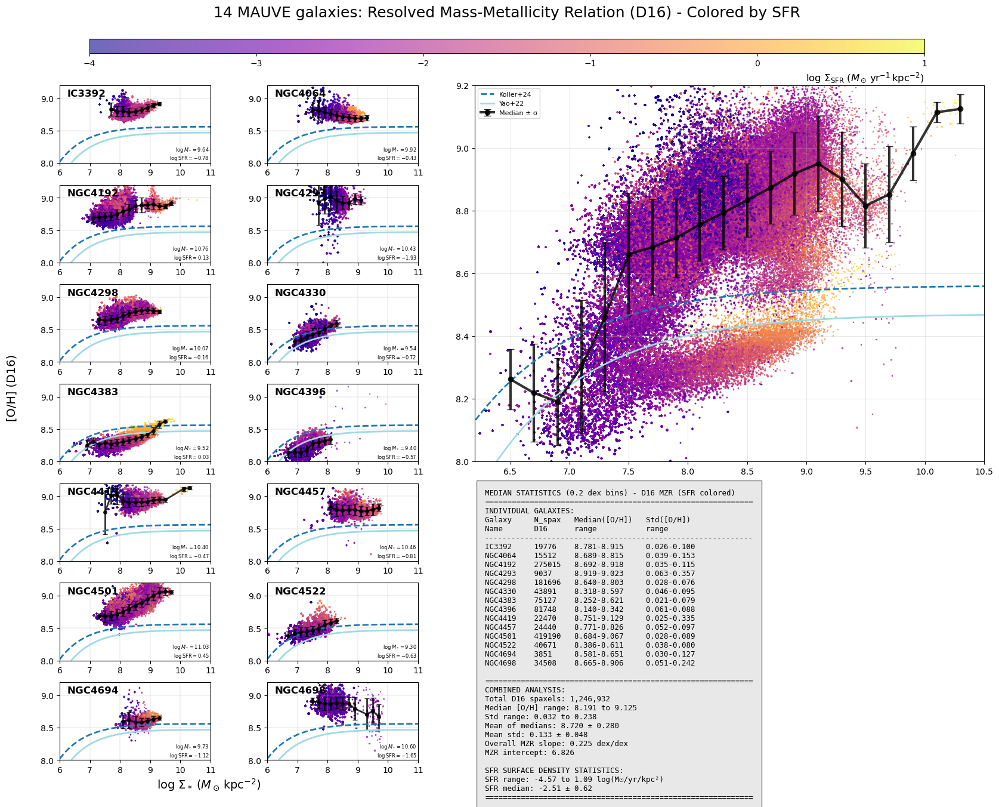

In [11]:
# ------------------------------------------------------------------
# COMPREHENSIVE LAYOUT: Individual galaxies + Combined plot + Statistics (D16 MZR - SFR colored)
# 4-column layout: Cols 1-2 = Individual galaxies, Col 3 = Combined plot, Col 4 = Statistics
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from pathlib import Path
from astropy.io import fits
import itertools
import re  # Add this import for regex

# 0 · discover galaxies & colour palette
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)
assert ngal <= 14, "This layout assumes ≤ 14 galaxies."

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_d16 = h['O_H_D16_SF'].data
    return sigM, sigSFR, oh_d16

# Extraction functions for log files
def extract_total_stellar_mass(galaxy_name):
    """Extract total stellar mass from mass log file. Returns log10(M☉) value or None if not found."""
    log_file = Path(f'mass_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total stellar mass \(R\)\s*:\s*([\d.-]+)\s*log10\(M☉\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading mass log for {galaxy_name}: {e}")
        return None

def extract_total_sfr(galaxy_name):
    """Extract total SFR from SFR log file. Returns log10(M☉/yr) value or None if not found."""
    log_file = Path(f'sfr_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total Halpha SFR from SF region:.*?in log10 scale:\s*([\d.-]+)\s*log\(M☉/yr\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading SFR log for {galaxy_name}: {e}")
        return None

def calculate_median_statistics(x, y, x_range=(6, 11), bin_width=0.2):
    """Calculate median and std in binned intervals"""
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    
    medians = []
    stds = []
    x_valid = []
    
    for i in range(len(x_bins) - 1):
        mask = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if len(np.unique(x[mask])) >= 10:  # Need at least 10 distinct x values
            y_bin = y[mask]
            medians.append(np.median(y_bin))
            stds.append(np.std(y_bin))
            x_valid.append(x_centers[i])
    
    return np.array(x_valid), np.array(medians), np.array(stds)

def plot_literature_mzr_fits(ax, show_legend=False):
    """Plot literature MZR fits on the given axis"""
    # Define x range for plotting literature fits
    x = np.linspace(6, 11, 100)
    
    # Yao+22
    # 12 + log(O/H) = a + b(log Σ* - c)e^(-(x-c))
    # Coefficients: a = 8.47, b = 0.0002, c = 12.36
    a1, b1, c1 = 8.47, 0.0002, 12.36
    y_yao22 = a1 + b1 * (x - c1) * np.exp(-(x - c1))

    # Koller+24
    # 12 + log(O/H) = a + b(log Σ* - c)exp(-(log Σ* - c))
    # Coefficients: a = 8.561, b = 0.0001, c = 12.7
    a2, b2, c2 = 8.561, 0.0001, 12.7
    y_koller24 = a2 + b2 * (x - c2) * np.exp(-(x - c2))

    # MZR literature data
    plot_data = [
        (y_koller24, 'Koller+24', '--'),
        (y_yao22, 'Yao+22', '-'),
    ]
    
    # Plot all literature fits
    colors = plt.cm.tab20(np.linspace(0, 1, len(plot_data)))
    for i, (y, label, linestyle) in enumerate(plot_data):
        if show_legend:
            ax.plot(x, y, label=label, linewidth=2, linestyle=linestyle, color=colors[i])
        else:
            ax.plot(x, y, linewidth=2, linestyle=linestyle, color=colors[i])

# 1 · Create comprehensive figure with 4-column layout
fig = plt.figure(figsize=(20, 16))
gs = GridSpec(nrows=8, ncols=4, figure=fig,
              width_ratios=[1, 1, 1.5, 1.5],  # Cols 3&4 slightly wider
              height_ratios=[0.5, 1, 1, 1, 1, 1, 1, 1],  # Row 0 for colorbar
              wspace=0.3, hspace=0.3)

plot_idx = 0
scatter_for_cbar = None
individual_stats = []

# COLUMNS 1-2: Individual galaxy plots
for idx, gal in enumerate(galaxies):
    sigM, sigSFR, oh_d16 = load_maps(gal)
    
    good_d16 = np.isfinite(sigM) & np.isfinite(oh_d16) & np.isfinite(sigSFR)
    
    if not np.any(good_d16):
        print(f"Skipping {gal}: no valid data points")
        continue
    
    row = (plot_idx // 2) + 1  # Start from row 1 (row 0 for colorbar)
    col = plot_idx % 2
    plot_idx += 1

    axP = fig.add_subplot(gs[row, col])
    
    x_d16, y_d16, sfr_d16 = sigM[good_d16], oh_d16[good_d16], sigSFR[good_d16]
    
    # Calculate median statistics
    x_median, y_median, y_std = calculate_median_statistics(x_d16, y_d16)
    individual_stats.append((gal, x_median, y_median, y_std, len(x_d16)))
    
    # Scatter plot colored by SFR surface density
    scatter = axP.scatter(x_d16, y_d16, c=sfr_d16, s=1, alpha=0.6, marker=',', 
                         cmap='plasma', vmin=-4, vmax=1)
    
    # Plot median with error bars
    if len(x_median) > 0:
        axP.errorbar(x_median, y_median, yerr=y_std, fmt='ko-', linewidth=2, 
                    markersize=4, capsize=3, alpha=0.8)
    
    if scatter_for_cbar is None:
        scatter_for_cbar = scatter
    
    # Add literature fits to individual panels (no legend)
    plot_literature_mzr_fits(axP, show_legend=False)
    
    # Add galaxy name in top left corner
    axP.text(0.05, 0.95, gal, transform=axP.transAxes, fontsize=12, fontweight='bold',
             va='top', ha='left', bbox=dict(boxstyle='round,pad=0.3', facecolor='none', alpha=0.8, edgecolor='none'))
    
    # Bottom right: total stellar mass and SFR from log files
    total_mass = extract_total_stellar_mass(gal)
    total_sfr = extract_total_sfr(gal)
    
    if total_mass is not None and total_sfr is not None:
        log_text = fr'$\log M_* = {total_mass:.2f}$' '\n' fr'$\log \mathrm{{SFR}} = {total_sfr:.2f}$'
        axP.text(0.99, 0.01, log_text,
                 transform=axP.transAxes, va='bottom', ha='right', fontsize=6,
                 bbox=dict(facecolor='none', alpha=0.8, edgecolor='none', pad=2))
    
    axP.set_xlim(6, 11)
    axP.set_ylim(8.0, 9.2)
    axP.grid(True, lw=0.25)

# COLUMNS 3-4: Combined plot - Upper panel
ax_combined = fig.add_subplot(gs[1:5, 2:4])  # Spans rows 1-4, columns 2-3

# Collect all data for combined analysis
all_x, all_y, all_sfr = [], [], []
galaxy_counts = {}

for gal in galaxies:
    sigM, sigSFR, oh_d16 = load_maps(gal)
    good_d16 = np.isfinite(sigM) & np.isfinite(oh_d16) & np.isfinite(sigSFR)
    
    if np.any(good_d16):
        x_d16, y_d16, sfr_d16 = sigM[good_d16], oh_d16[good_d16], sigSFR[good_d16]
        all_x.extend(x_d16)
        all_y.extend(y_d16)
        all_sfr.extend(sfr_d16)
        galaxy_counts[gal] = len(x_d16)
    else:
        galaxy_counts[gal] = 0

all_x, all_y, all_sfr = np.array(all_x), np.array(all_y), np.array(all_sfr)

# Calculate combined median statistics
x_median_combined, y_median_combined, y_std_combined = calculate_median_statistics(all_x, all_y)

# Scatter plot colored by SFR surface density for combined data
scatter_combined = ax_combined.scatter(all_x, all_y, c=all_sfr, s=1, alpha=0.6, marker=',', 
                                      cmap='plasma', vmin=-4, vmax=1)

# Plot combined median with error bars
if len(x_median_combined) > 0:
    ax_combined.errorbar(x_median_combined, y_median_combined, yerr=y_std_combined, 
                        fmt='ko-', linewidth=3, markersize=6, capsize=4, alpha=0.8, label='Median ± σ')

# Add literature fits to combined panel (with legend)
plot_literature_mzr_fits(ax_combined, show_legend=True)

# Add legend with small font
ax_combined.legend(fontsize=8, ncol=1, loc='upper left')

ax_combined.set_xlim(6.2, 10.5)
ax_combined.set_ylim(8.0, 9.2)
ax_combined.grid(True, alpha=0.3)

# COLUMNS 3-4: Statistics table - Lower panel
ax_stats = fig.add_subplot(gs[5:8, 2:4])  # Spans rows 5-7, columns 2-3
ax_stats.axis('off')

# Create comprehensive statistics text
stats_table = "MEDIAN STATISTICS (0.2 dex bins) - D16 MZR (SFR colored)\n"
stats_table += "="*60 + "\n"
stats_table += "INDIVIDUAL GALAXIES:\n"
stats_table += f"{'Galaxy':<10} {'N_spax':<8} {'Median([O/H])':<15} {'Std([O/H])':<15}\n"
stats_table += f"{'Name':<10} {'D16':<8} {'range':<15} {'range':<15}\n"
stats_table += "-"*60 + "\n"

for gal, x_median, y_median, y_std, n_spax in individual_stats:
    if len(y_median) > 0:
        median_range = f"{y_median.min():.3f}-{y_median.max():.3f}"
        std_range = f"{y_std.min():.3f}-{y_std.max():.3f}"
    else:
        median_range = "N/A"
        std_range = "N/A"
    
    stats_table += f"{gal:<10} {n_spax:<8} {median_range:<15} {std_range:<15}\n"

stats_table += "\n" + "="*60 + "\n"
stats_table += "COMBINED ANALYSIS:\n"
stats_table += f"Total D16 spaxels: {len(all_x):,}\n"
if len(y_median_combined) > 0:
    stats_table += f"Median [O/H] range: {y_median_combined.min():.3f} to {y_median_combined.max():.3f}\n"
    stats_table += f"Std range: {y_std_combined.min():.3f} to {y_std_combined.max():.3f}\n"
    stats_table += f"Mean of medians: {np.mean(y_median_combined):.3f} ± {np.std(y_median_combined):.3f}\n"
    stats_table += f"Mean std: {np.mean(y_std_combined):.3f} ± {np.std(y_std_combined):.3f}\n"
    
    # Calculate overall metallicity gradient (slope)
    if len(x_median_combined) > 3:
        slope, intercept = np.polyfit(x_median_combined, y_median_combined, 1)
        stats_table += f"Overall MZR slope: {slope:.3f} dex/dex\n"
        stats_table += f"MZR intercept: {intercept:.3f}\n"

# Add SFR statistics
stats_table += f"\nSFR SURFACE DENSITY STATISTICS:\n"
stats_table += f"SFR range: {all_sfr.min():.2f} to {all_sfr.max():.2f} log(M☉/yr/kpc²)\n"
stats_table += f"SFR median: {np.median(all_sfr):.2f} ± {np.std(all_sfr):.2f}\n"
        
stats_table += "="*60

ax_stats.text(0.02, 0.98, stats_table, transform=ax_stats.transAxes, va='top', ha='left',
              fontsize=9, family='monospace',
              bbox=dict(facecolor='lightgray', alpha=0.5, edgecolor='black', pad=10))

# Add horizontal colorbar at the top
if scatter_for_cbar is not None:
    cbar_ax = fig.add_axes([0.15, 0.85, 0.7, 0.015])
    cbar = plt.colorbar(scatter_for_cbar, cax=cbar_ax, orientation='horizontal')
    cbar.set_label(r'$\log\,\Sigma_{\mathrm{SFR}} \; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', fontsize=12, loc='right')

# Global title and labels
fig.suptitle(fr'{ngal} MAUVE galaxies: Resolved Mass-Metallicity Relation (D16) - Colored by SFR', 
             fontsize=18, y=0.90)

# Shared axis labels
fig.text(0.25, 0.08, r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', 
         ha='center', fontsize=14)
fig.text(0.08, 0.5, r'[O/H] (D16)', 
         va='center', rotation='vertical', fontsize=14)

plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])
plt.savefig('mauve_14galaxies_rMZR_D16.png', dpi=600, bbox_inches='tight')
plt.savefig('mauve_14galaxies_rMZR_D16.pdf')
plt.show()

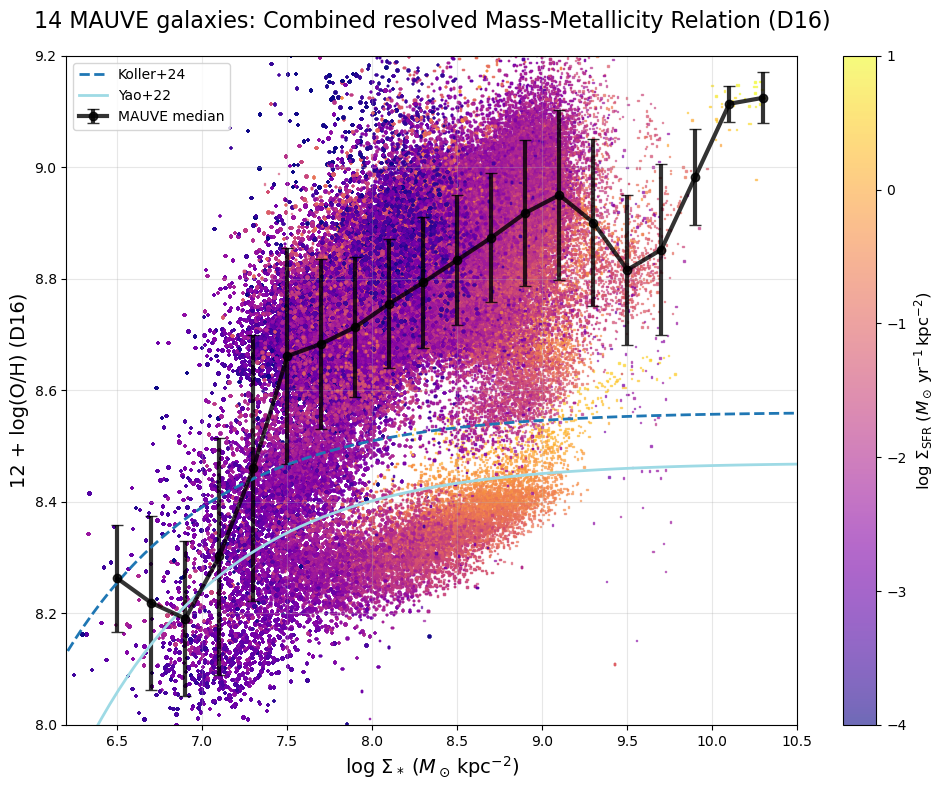

In [12]:
# ------------------------------------------------------------------
# COMBINED PLOT ONLY: All galaxies combined analysis (D16 MZR - SFR colored)
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from astropy.io import fits
import re

# 0 · discover galaxies & colour palette
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_d16 = h['O_H_D16_SF'].data
    return sigM, sigSFR, oh_d16

def calculate_median_statistics(x, y, x_range=(6, 11), bin_width=0.2):
    """Calculate median and std in binned intervals"""
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    
    medians = []
    stds = []
    x_valid = []
    
    for i in range(len(x_bins) - 1):
        mask = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if len(np.unique(x[mask])) >= 10:  # Need at least 10 distinct x values
            y_bin = y[mask]
            medians.append(np.median(y_bin))
            stds.append(np.std(y_bin))
            x_valid.append(x_centers[i])
    
    return np.array(x_valid), np.array(medians), np.array(stds)

def plot_literature_mzr_fits(ax, show_legend=True):
    """Plot literature MZR fits on the given axis"""
    # Define x range for plotting literature fits
    x = np.linspace(6, 11, 100)
    
    # Yao+22
    # 12 + log(O/H) = a + b(log Σ* - c)e^(-(x-c))
    # Coefficients: a = 8.47, b = 0.0002, c = 12.36
    a1, b1, c1 = 8.47, 0.0002, 12.36
    y_yao22 = a1 + b1 * (x - c1) * np.exp(-(x - c1))

    # Koller+24
    # 12 + log(O/H) = a + b(log Σ* - c)exp(-(log Σ* - c))
    # Coefficients: a = 8.561, b = 0.0001, c = 12.7
    a2, b2, c2 = 8.561, 0.0001, 12.7
    y_koller24 = a2 + b2 * (x - c2) * np.exp(-(x - c2))

    # MZR literature data
    plot_data = [
        (y_koller24, 'Koller+24', '--'),
        (y_yao22, 'Yao+22', '-'),
    ]
    
    # Plot all literature fits
    colors = plt.cm.tab20(np.linspace(0, 1, len(plot_data)))
    for i, (y, label, linestyle) in enumerate(plot_data):
        if show_legend:
            ax.plot(x, y, label=label, linewidth=2, linestyle=linestyle, color=colors[i])
        else:
            ax.plot(x, y, linewidth=2, linestyle=linestyle, color=colors[i])

# Create single figure for combined plot
fig, ax_combined = plt.subplots(1, 1, figsize=(10, 8))

# Collect all data for combined analysis
all_x, all_y, all_sfr = [], [], []
galaxy_counts = {}

for gal in galaxies:
    sigM, sigSFR, oh_d16 = load_maps(gal)
    good_d16 = np.isfinite(sigM) & np.isfinite(oh_d16) & np.isfinite(sigSFR)
    
    if np.any(good_d16):
        x_d16, y_d16, sfr_d16 = sigM[good_d16], oh_d16[good_d16], sigSFR[good_d16]
        all_x.extend(x_d16)
        all_y.extend(y_d16)
        all_sfr.extend(sfr_d16)
        galaxy_counts[gal] = len(x_d16)
    else:
        galaxy_counts[gal] = 0

all_x, all_y, all_sfr = np.array(all_x), np.array(all_y), np.array(all_sfr)

# Calculate combined median statistics
x_median_combined, y_median_combined, y_std_combined = calculate_median_statistics(all_x, all_y)

# Scatter plot colored by SFR surface density for combined data
scatter_combined = ax_combined.scatter(all_x, all_y, c=all_sfr, s=1, alpha=0.6, marker=',', 
                                      cmap='plasma', vmin=-4, vmax=1)

# Plot combined median with error bars
if len(x_median_combined) > 0:
    ax_combined.errorbar(x_median_combined, y_median_combined, yerr=y_std_combined, 
                        fmt='ko-', linewidth=3, markersize=6, capsize=4, alpha=0.8, 
                        label='MAUVE median')

# Add literature fits to combined panel (with legend)
plot_literature_mzr_fits(ax_combined, show_legend=True)

# Add legend
ax_combined.legend(fontsize=10, loc='upper left')

# Add colorbar
cbar = plt.colorbar(scatter_combined, ax=ax_combined)
cbar.set_label(r'$\log\,\Sigma_{\mathrm{SFR}} \; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', fontsize=12)

# Set axis properties
ax_combined.set_xlim(6.2, 10.5)
ax_combined.set_ylim(8.0, 9.2)
ax_combined.grid(True, alpha=0.3)
ax_combined.set_xlabel(r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', fontsize=14)
ax_combined.set_ylabel(r'12 + log(O/H) (D16)', fontsize=14)

# Global title
plt.title(fr'{ngal} MAUVE galaxies: Combined resolved Mass-Metallicity Relation (D16)', 
          fontsize=16, pad=20)

plt.tight_layout()

# Save figures with updated filename
plt.savefig('mauve_14galaxies_rMZR_D16_combined.png', dpi=600, bbox_inches='tight')
plt.savefig('mauve_14galaxies_rMZR_D16_combined.pdf', bbox_inches='tight')

plt.show()

/var/folders/rm/clp89v210v32vh5vjt2kx7b80000gr/T/ipykernel_65174/2765597890.py:284: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])


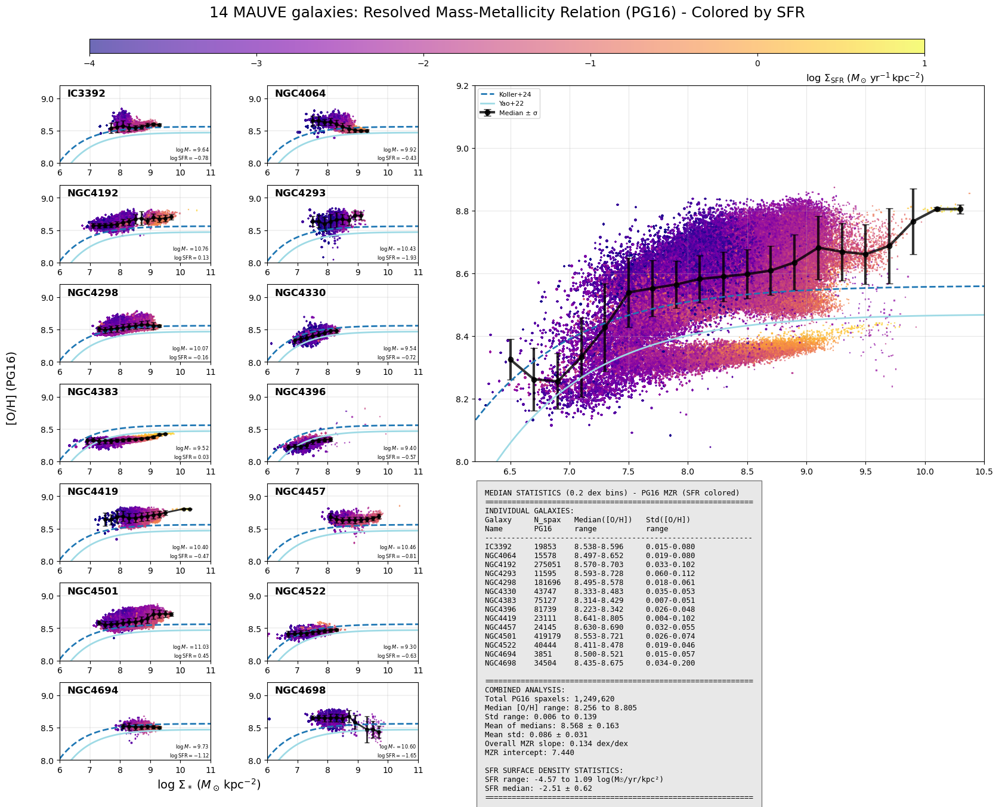

In [13]:
# ------------------------------------------------------------------
# COMPREHENSIVE LAYOUT: Individual galaxies + Combined plot + Statistics (PG16 MZR - SFR colored)
# 4-column layout: Cols 1-2 = Individual galaxies, Col 3 = Combined plot, Col 4 = Statistics
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from pathlib import Path
from astropy.io import fits
import itertools
import re  # Add this import for regex

# 0 · discover galaxies & colour palette
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)
assert ngal <= 14, "This layout assumes ≤ 14 galaxies."

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_pg16 = h['O_H_PG16_SF'].data
    return sigM, sigSFR, oh_pg16

# Extraction functions for log files
def extract_total_stellar_mass(galaxy_name):
    """Extract total stellar mass from mass log file. Returns log10(M☉) value or None if not found."""
    log_file = Path(f'mass_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total stellar mass \(R\)\s*:\s*([\d.-]+)\s*log10\(M☉\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading mass log for {galaxy_name}: {e}")
        return None

def extract_total_sfr(galaxy_name):
    """Extract total SFR from SFR log file. Returns log10(M☉/yr) value or None if not found."""
    log_file = Path(f'sfr_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total Halpha SFR from SF region:.*?in log10 scale:\s*([\d.-]+)\s*log\(M☉/yr\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading SFR log for {galaxy_name}: {e}")
        return None

def calculate_median_statistics(x, y, x_range=(6, 11), bin_width=0.2):
    """Calculate median and std in binned intervals"""
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    
    medians = []
    stds = []
    x_valid = []
    
    for i in range(len(x_bins) - 1):
        mask = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if len(np.unique(x[mask])) >= 10:  # Need at least 10 distinct x values
            y_bin = y[mask]
            medians.append(np.median(y_bin))
            stds.append(np.std(y_bin))
            x_valid.append(x_centers[i])
    
    return np.array(x_valid), np.array(medians), np.array(stds)

def plot_literature_mzr_fits(ax, show_legend=False):
    """Plot literature MZR fits on the given axis"""
    # Define x range for plotting literature fits
    x = np.linspace(6, 11, 100)
    
    # Yao+22
    # 12 + log(O/H) = a + b(log Σ* - c)e^(-(x-c))
    # Coefficients: a = 8.47, b = 0.0002, c = 12.36
    a1, b1, c1 = 8.47, 0.0002, 12.36
    y_yao22 = a1 + b1 * (x - c1) * np.exp(-(x - c1))

    # Koller+24
    # 12 + log(O/H) = a + b(log Σ* - c)exp(-(log Σ* - c))
    # Coefficients: a = 8.561, b = 0.0001, c = 12.7
    a2, b2, c2 = 8.561, 0.0001, 12.7
    y_koller24 = a2 + b2 * (x - c2) * np.exp(-(x - c2))

    # MZR literature data
    plot_data = [
        (y_koller24, 'Koller+24', '--'),
        (y_yao22, 'Yao+22', '-'),
    ]
    
    # Plot all literature fits
    colors = plt.cm.tab20(np.linspace(0, 1, len(plot_data)))
    for i, (y, label, linestyle) in enumerate(plot_data):
        if show_legend:
            ax.plot(x, y, label=label, linewidth=2, linestyle=linestyle, color=colors[i])
        else:
            ax.plot(x, y, linewidth=2, linestyle=linestyle, color=colors[i])

# 1 · Create comprehensive figure with 4-column layout
fig = plt.figure(figsize=(20, 16))
gs = GridSpec(nrows=8, ncols=4, figure=fig,
              width_ratios=[1, 1, 1.5, 1.5],  # Cols 3&4 slightly wider
              height_ratios=[0.5, 1, 1, 1, 1, 1, 1, 1],  # Row 0 for colorbar
              wspace=0.3, hspace=0.3)

plot_idx = 0
scatter_for_cbar = None
individual_stats = []

# COLUMNS 1-2: Individual galaxy plots
for idx, gal in enumerate(galaxies):
    sigM, sigSFR, oh_pg16 = load_maps(gal)
    
    good_pg16 = np.isfinite(sigM) & np.isfinite(oh_pg16) & np.isfinite(sigSFR)
    
    if not np.any(good_pg16):
        print(f"Skipping {gal}: no valid data points")
        continue
    
    row = (plot_idx // 2) + 1  # Start from row 1 (row 0 for colorbar)
    col = plot_idx % 2
    plot_idx += 1

    axP = fig.add_subplot(gs[row, col])
    
    x_pg16, y_pg16, sfr_pg16 = sigM[good_pg16], oh_pg16[good_pg16], sigSFR[good_pg16]
    
    # Calculate median statistics
    x_median, y_median, y_std = calculate_median_statistics(x_pg16, y_pg16)
    individual_stats.append((gal, x_median, y_median, y_std, len(x_pg16)))
    
    # Scatter plot colored by SFR surface density
    scatter = axP.scatter(x_pg16, y_pg16, c=sfr_pg16, s=1, alpha=0.6, marker=',', 
                         cmap='plasma', vmin=-4, vmax=1)
    
    # Plot median with error bars
    if len(x_median) > 0:
        axP.errorbar(x_median, y_median, yerr=y_std, fmt='ko-', linewidth=2, 
                    markersize=4, capsize=3, alpha=0.8)
    
    if scatter_for_cbar is None:
        scatter_for_cbar = scatter
    
    # Add literature fits to individual panels (no legend)
    plot_literature_mzr_fits(axP, show_legend=False)
    
    # Add galaxy name in top left corner
    axP.text(0.05, 0.95, gal, transform=axP.transAxes, fontsize=12, fontweight='bold',
             va='top', ha='left', bbox=dict(boxstyle='round,pad=0.3', facecolor='none', alpha=0.8, edgecolor='none'))
    
    # Bottom right: total stellar mass and SFR from log files
    total_mass = extract_total_stellar_mass(gal)
    total_sfr = extract_total_sfr(gal)
    
    if total_mass is not None and total_sfr is not None:
        log_text = fr'$\log M_* = {total_mass:.2f}$' '\n' fr'$\log \mathrm{{SFR}} = {total_sfr:.2f}$'
        axP.text(0.99, 0.01, log_text,
                 transform=axP.transAxes, va='bottom', ha='right', fontsize=6,
                 bbox=dict(facecolor='none', alpha=0.8, edgecolor='none', pad=2))
    
    axP.set_xlim(6, 11)
    axP.set_ylim(8.0, 9.2)
    axP.grid(True, lw=0.25)

# COLUMNS 3-4: Combined plot - Upper panel
ax_combined = fig.add_subplot(gs[1:5, 2:4])  # Spans rows 1-4, columns 2-3

# Collect all data for combined analysis
all_x, all_y, all_sfr = [], [], []
galaxy_counts = {}

for gal in galaxies:
    sigM, sigSFR, oh_pg16 = load_maps(gal)
    good_pg16 = np.isfinite(sigM) & np.isfinite(oh_pg16) & np.isfinite(sigSFR)
    
    if np.any(good_pg16):
        x_pg16, y_pg16, sfr_pg16 = sigM[good_pg16], oh_pg16[good_pg16], sigSFR[good_pg16]
        all_x.extend(x_pg16)
        all_y.extend(y_pg16)
        all_sfr.extend(sfr_pg16)
        galaxy_counts[gal] = len(x_pg16)
    else:
        galaxy_counts[gal] = 0

all_x, all_y, all_sfr = np.array(all_x), np.array(all_y), np.array(all_sfr)

# Calculate combined median statistics
x_median_combined, y_median_combined, y_std_combined = calculate_median_statistics(all_x, all_y)

# Scatter plot colored by SFR surface density for combined data
scatter_combined = ax_combined.scatter(all_x, all_y, c=all_sfr, s=1, alpha=0.6, marker=',', 
                                      cmap='plasma', vmin=-4, vmax=1)

# Plot combined median with error bars
if len(x_median_combined) > 0:
    ax_combined.errorbar(x_median_combined, y_median_combined, yerr=y_std_combined, 
                        fmt='ko-', linewidth=3, markersize=6, capsize=4, alpha=0.8, label='Median ± σ')

# Add literature fits to combined panel (with legend)
plot_literature_mzr_fits(ax_combined, show_legend=True)

# Add legend with small font
ax_combined.legend(fontsize=8, ncol=1, loc='upper left')

ax_combined.set_xlim(6.2, 10.5)
ax_combined.set_ylim(8.0, 9.2)
ax_combined.grid(True, alpha=0.3)

# COLUMNS 3-4: Statistics table - Lower panel
ax_stats = fig.add_subplot(gs[5:8, 2:4])  # Spans rows 5-7, columns 2-3
ax_stats.axis('off')

# Create comprehensive statistics text
stats_table = "MEDIAN STATISTICS (0.2 dex bins) - PG16 MZR (SFR colored)\n"
stats_table += "="*60 + "\n"
stats_table += "INDIVIDUAL GALAXIES:\n"
stats_table += f"{'Galaxy':<10} {'N_spax':<8} {'Median([O/H])':<15} {'Std([O/H])':<15}\n"
stats_table += f"{'Name':<10} {'PG16':<8} {'range':<15} {'range':<15}\n"
stats_table += "-"*60 + "\n"

for gal, x_median, y_median, y_std, n_spax in individual_stats:
    if len(y_median) > 0:
        median_range = f"{y_median.min():.3f}-{y_median.max():.3f}"
        std_range = f"{y_std.min():.3f}-{y_std.max():.3f}"
    else:
        median_range = "N/A"
        std_range = "N/A"
    
    stats_table += f"{gal:<10} {n_spax:<8} {median_range:<15} {std_range:<15}\n"

stats_table += "\n" + "="*60 + "\n"
stats_table += "COMBINED ANALYSIS:\n"
stats_table += f"Total PG16 spaxels: {len(all_x):,}\n"
if len(y_median_combined) > 0:
    stats_table += f"Median [O/H] range: {y_median_combined.min():.3f} to {y_median_combined.max():.3f}\n"
    stats_table += f"Std range: {y_std_combined.min():.3f} to {y_std_combined.max():.3f}\n"
    stats_table += f"Mean of medians: {np.mean(y_median_combined):.3f} ± {np.std(y_median_combined):.3f}\n"
    stats_table += f"Mean std: {np.mean(y_std_combined):.3f} ± {np.std(y_std_combined):.3f}\n"
    
    # Calculate overall metallicity gradient (slope)
    if len(x_median_combined) > 3:
        slope, intercept = np.polyfit(x_median_combined, y_median_combined, 1)
        stats_table += f"Overall MZR slope: {slope:.3f} dex/dex\n"
        stats_table += f"MZR intercept: {intercept:.3f}\n"

# Add SFR statistics
stats_table += f"\nSFR SURFACE DENSITY STATISTICS:\n"
stats_table += f"SFR range: {all_sfr.min():.2f} to {all_sfr.max():.2f} log(M☉/yr/kpc²)\n"
stats_table += f"SFR median: {np.median(all_sfr):.2f} ± {np.std(all_sfr):.2f}\n"
        
stats_table += "="*60

ax_stats.text(0.02, 0.98, stats_table, transform=ax_stats.transAxes, va='top', ha='left',
              fontsize=9, family='monospace',
              bbox=dict(facecolor='lightgray', alpha=0.5, edgecolor='black', pad=10))

# Add horizontal colorbar at the top
if scatter_for_cbar is not None:
    cbar_ax = fig.add_axes([0.15, 0.85, 0.7, 0.015])
    cbar = plt.colorbar(scatter_for_cbar, cax=cbar_ax, orientation='horizontal')
    cbar.set_label(r'$\log\,\Sigma_{\mathrm{SFR}} \; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', fontsize=12, loc='right')

# Global title and labels
fig.suptitle(fr'{ngal} MAUVE galaxies: Resolved Mass-Metallicity Relation (PG16) - Colored by SFR', 
             fontsize=18, y=0.90)

# Shared axis labels
fig.text(0.25, 0.08, r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', 
         ha='center', fontsize=14)
fig.text(0.08, 0.5, r'[O/H] (PG16)', 
         va='center', rotation='vertical', fontsize=14)

plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])
plt.show()

/var/folders/rm/clp89v210v32vh5vjt2kx7b80000gr/T/ipykernel_65174/3566010163.py:313: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])


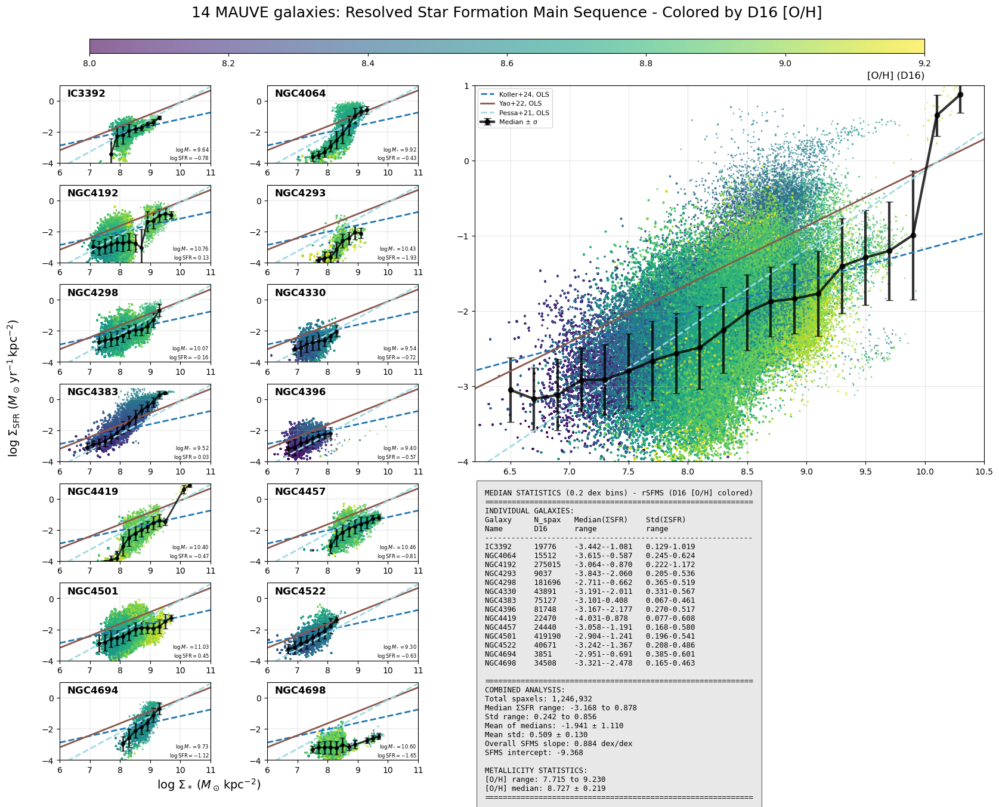

In [14]:
# ------------------------------------------------------------------
# COMPREHENSIVE LAYOUT: Individual galaxies + Combined plot + Statistics (rSFMS - [O/H] colored)
# 4-column layout: Cols 1-2 = Individual galaxies, Col 3 = Combined plot, Col 4 = Statistics
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from pathlib import Path
from astropy.io import fits
import itertools
import re  # Add this import for regex

# 0 · discover galaxies & colour palette
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)
assert ngal <= 14, "This layout assumes ≤ 14 galaxies."

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_d16 = h['O_H_D16_SF'].data
    return sigM, sigSFR, oh_d16

# Extraction functions for log files
def extract_total_stellar_mass(galaxy_name):
    """Extract total stellar mass from mass log file. Returns log10(M☉) value or None if not found."""
    log_file = Path(f'mass_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total stellar mass \(R\)\s*:\s*([\d.-]+)\s*log10\(M☉\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading mass log for {galaxy_name}: {e}")
        return None

def extract_total_sfr(galaxy_name):
    """Extract total SFR from SFR log file. Returns log10(M☉/yr) value or None if not found."""
    log_file = Path(f'sfr_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total Halpha SFR from SF region:.*?in log10 scale:\s*([\d.-]+)\s*log\(M☉/yr\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading SFR log for {galaxy_name}: {e}")
        return None

def calculate_median_statistics(x, y, x_range=(6, 11), bin_width=0.2):
    """Calculate median and std in binned intervals"""
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    
    medians = []
    stds = []
    x_valid = []
    
    for i in range(len(x_bins) - 1):
        mask = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if len(np.unique(x[mask])) >= 10:  # Need at least 10 distinct x values
            y_bin = y[mask]
            medians.append(np.median(y_bin))
            stds.append(np.std(y_bin))
            x_valid.append(x_centers[i])
    
    return np.array(x_valid), np.array(medians), np.array(stds)

def plot_literature_sfms_fits(ax, show_legend=False):
    """Plot literature Star Formation Main Sequence fits on the given axis"""
    # Define x range for plotting literature fits
    x = np.linspace(6, 11, 100)
    
    # Kennicutt-Schmidt relation for resolved studies
    # log ΣSFR = α × log Σ* + β
    
    # Literature SFMS fits with slope and intercept parameters
    plot_data = [
        # Reference 1: This work (SF-spaxels), OLS
        (0.425, -5.428, 'Koller+24, OLS', '--'),
        # # Reference 1: This work (SF-spaxels), ODR  
        # (1.162, -11.014, 'Koller+24, ODR', '--'),
        # # # Reference 2: This work (spectral decomposition), OLS
        # # (0.401, -5.615, 'Koller+24, OLS (spectral)', '--'),
        # # # Reference 2: This work (spectral decomposition), ODR
        # # (2.562, -22.248, 'Koller+24, ODR (spectral)', '--'),
        # # Reference 3: Cano-Díaz et al. (2016)
        # (0.72, -7.95, 'Cano-Díaz+16', '-'),
        # # Reference 4: Hsieh et al. (2017), OLS
        # (0.715, -8.056, 'Hsieh+17, OLS', '-'),
        # # Reference 4: Hsieh et al. (2017), ODR
        # (1.005, -10.338, 'Hsieh+17, ODR', '-'),
        # Reference 5: Yao et al. (2022), OLS
        (0.771, -7.812, 'Yao+22, OLS', '-'),
        # # Reference 6: Mun et al. (2024), LTS
        # (0.918, -9.196, 'Mun+24, LTS', '--'),
        # # Reference 7: Jafariyazani et al. (2019), OLS
        # (0.43, -5.66, 'Jafariyazani+19, OLS', '-'),
        # # Reference 8: Wuyts et al. (2013)
        # (0.95, -8.4, 'Wuyts+13', '-'), 
        # # Vulcani et al. (2020) - stripping sample
        # (1.641, -14.79, 'Vulcani+20, PyStan (stripping)', '--'),
        # # Vulcani et al. (2020) - control sample
        # (1.659, -15.28, 'Vulcani+20, PyStan (control)', '--'),
        # Pessa et al. (2021) - OLS
        (1.05, -10.63, 'Pessa+21, OLS', '--'),
        # # Ellison et al. (2021) - OLS
        # (0.68, -7.38, 'Ellison+21, OLS', '--'),
        # # Ellison et al. (2021) - ODR
        # (1.37, -13.12, 'Ellison+21, ODR', '--')
    ]
    
    # Generate literature fits using the new format (slope, intercept, label, linestyle)
    literature_fits = []
    for slope, intercept, label, linestyle in plot_data:
        y_lit = slope * x + intercept
        literature_fits.append((y_lit, label, linestyle))
    
    plot_data = literature_fits
    
    # Plot all literature fits
    colors = plt.cm.tab20(np.linspace(0, 1, len(plot_data)))
    for i, (y, label, linestyle) in enumerate(plot_data):
        if show_legend:
            ax.plot(x, y, label=label, linewidth=2, linestyle=linestyle, color=colors[i])
        else:
            ax.plot(x, y, linewidth=2, linestyle=linestyle, color=colors[i])

# 1 · Create comprehensive figure with 4-column layout
fig = plt.figure(figsize=(20, 16))
gs = GridSpec(nrows=8, ncols=4, figure=fig,
              width_ratios=[1, 1, 1.5, 1.5],  # Cols 3&4 slightly wider
              height_ratios=[0.5, 1, 1, 1, 1, 1, 1, 1],  # Row 0 for colorbar
              wspace=0.3, hspace=0.3)

plot_idx = 0
scatter_for_cbar = None
individual_stats = []

# COLUMNS 1-2: Individual galaxy plots
for idx, gal in enumerate(galaxies):
    sigM, sigSFR, oh_d16 = load_maps(gal)
    
    good_d16 = np.isfinite(sigM) & np.isfinite(sigSFR) & np.isfinite(oh_d16)
    
    if not np.any(good_d16):
        print(f"Skipping {gal}: no valid data points")
        continue
    
    row = (plot_idx // 2) + 1  # Start from row 1 (row 0 for colorbar)
    col = plot_idx % 2
    plot_idx += 1

    axP = fig.add_subplot(gs[row, col])
    
    x_d16, y_d16, oh_d16_vals = sigM[good_d16], sigSFR[good_d16], oh_d16[good_d16]
    
    # Calculate median statistics
    x_median, y_median, y_std = calculate_median_statistics(x_d16, y_d16)
    individual_stats.append((gal, x_median, y_median, y_std, len(x_d16)))
    
    # Scatter plot colored by metallicity [O/H]
    scatter = axP.scatter(x_d16, y_d16, c=oh_d16_vals, s=1, alpha=0.6, marker=',', 
                         cmap='viridis', vmin=8.0, vmax=9.2)
    
    # Plot median with error bars
    if len(x_median) > 0:
        axP.errorbar(x_median, y_median, yerr=y_std, fmt='ko-', linewidth=2, 
                    markersize=4, capsize=3, alpha=0.8)
    
    if scatter_for_cbar is None:
        scatter_for_cbar = scatter
    
    # Add literature fits to individual panels (no legend)
    plot_literature_sfms_fits(axP, show_legend=False)
    
    # Add galaxy name in top left corner
    axP.text(0.05, 0.95, gal, transform=axP.transAxes, fontsize=12, fontweight='bold',
             va='top', ha='left', bbox=dict(boxstyle='round,pad=0.3', facecolor='none', alpha=0.8, edgecolor='none'))
    
    # Bottom right: total stellar mass and SFR from log files
    total_mass = extract_total_stellar_mass(gal)
    total_sfr = extract_total_sfr(gal)
    
    if total_mass is not None and total_sfr is not None:
        log_text = fr'$\log M_* = {total_mass:.2f}$' '\n' fr'$\log \mathrm{{SFR}} = {total_sfr:.2f}$'
        axP.text(0.99, 0.01, log_text,
                 transform=axP.transAxes, va='bottom', ha='right', fontsize=6,
                 bbox=dict(facecolor='none', alpha=0.8, edgecolor='none', pad=2))
    
    axP.set_xlim(6, 11)
    axP.set_ylim(-4, 1)
    axP.grid(True, lw=0.25)

# COLUMNS 3-4: Combined plot - Upper panel
ax_combined = fig.add_subplot(gs[1:5, 2:4])  # Spans rows 1-4, columns 2-3

# Collect all data for combined analysis
all_x, all_y, all_oh = [], [], []
galaxy_counts = {}

for gal in galaxies:
    sigM, sigSFR, oh_d16 = load_maps(gal)
    good_d16 = np.isfinite(sigM) & np.isfinite(sigSFR) & np.isfinite(oh_d16)
    
    if np.any(good_d16):
        x_d16, y_d16, oh_d16_vals = sigM[good_d16], sigSFR[good_d16], oh_d16[good_d16]
        all_x.extend(x_d16)
        all_y.extend(y_d16)
        all_oh.extend(oh_d16_vals)
        galaxy_counts[gal] = len(x_d16)
    else:
        galaxy_counts[gal] = 0

all_x, all_y, all_oh = np.array(all_x), np.array(all_y), np.array(all_oh)

# Calculate combined median statistics
x_median_combined, y_median_combined, y_std_combined = calculate_median_statistics(all_x, all_y)

# Scatter plot colored by metallicity for combined data
scatter_combined = ax_combined.scatter(all_x, all_y, c=all_oh, s=1, alpha=0.6, marker=',', 
                                      cmap='viridis', vmin=8.0, vmax=9.2)

# Plot combined median with error bars
if len(x_median_combined) > 0:
    ax_combined.errorbar(x_median_combined, y_median_combined, yerr=y_std_combined, 
                        fmt='ko-', linewidth=3, markersize=6, capsize=4, alpha=0.8, label='Median ± σ')

# Add literature fits to combined panel (with legend)
plot_literature_sfms_fits(ax_combined, show_legend=True)

# Add legend with small font
ax_combined.legend(fontsize=8, ncol=1, loc='upper left')

ax_combined.set_xlim(6.2, 10.5)
ax_combined.set_ylim(-4, 1)
ax_combined.grid(True, alpha=0.3)

# COLUMNS 3-4: Statistics table - Lower panel
ax_stats = fig.add_subplot(gs[5:8, 2:4])  # Spans rows 5-7, columns 2-3
ax_stats.axis('off')

# Create comprehensive statistics text
stats_table = "MEDIAN STATISTICS (0.2 dex bins) - rSFMS (D16 [O/H] colored)\n"
stats_table += "="*60 + "\n"
stats_table += "INDIVIDUAL GALAXIES:\n"
stats_table += f"{'Galaxy':<10} {'N_spax':<8} {'Median(ΣSFR)':<15} {'Std(ΣSFR)':<15}\n"
stats_table += f"{'Name':<10} {'D16':<8} {'range':<15} {'range':<15}\n"
stats_table += "-"*60 + "\n"

for gal, x_median, y_median, y_std, n_spax in individual_stats:
    if len(y_median) > 0:
        median_range = f"{y_median.min():.3f}-{y_median.max():.3f}"
        std_range = f"{y_std.min():.3f}-{y_std.max():.3f}"
    else:
        median_range = "N/A"
        std_range = "N/A"
    
    stats_table += f"{gal:<10} {n_spax:<8} {median_range:<15} {std_range:<15}\n"

stats_table += "\n" + "="*60 + "\n"
stats_table += "COMBINED ANALYSIS:\n"
stats_table += f"Total spaxels: {len(all_x):,}\n"
if len(y_median_combined) > 0:
    stats_table += f"Median ΣSFR range: {y_median_combined.min():.3f} to {y_median_combined.max():.3f}\n"
    stats_table += f"Std range: {y_std_combined.min():.3f} to {y_std_combined.max():.3f}\n"
    stats_table += f"Mean of medians: {np.mean(y_median_combined):.3f} ± {np.std(y_median_combined):.3f}\n"
    stats_table += f"Mean std: {np.mean(y_std_combined):.3f} ± {np.std(y_std_combined):.3f}\n"
    
    # Calculate overall SFMS slope
    if len(x_median_combined) > 3:
        slope, intercept = np.polyfit(x_median_combined, y_median_combined, 1)
        stats_table += f"Overall SFMS slope: {slope:.3f} dex/dex\n"
        stats_table += f"SFMS intercept: {intercept:.3f}\n"

# Add metallicity statistics
stats_table += f"\nMETALLICITY STATISTICS:\n"
stats_table += f"[O/H] range: {all_oh.min():.3f} to {all_oh.max():.3f}\n"
stats_table += f"[O/H] median: {np.median(all_oh):.3f} ± {np.std(all_oh):.3f}\n"
        
stats_table += "="*60

ax_stats.text(0.02, 0.98, stats_table, transform=ax_stats.transAxes, va='top', ha='left',
              fontsize=9, family='monospace',
              bbox=dict(facecolor='lightgray', alpha=0.5, edgecolor='black', pad=10))

# Add horizontal colorbar at the top
if scatter_for_cbar is not None:
    cbar_ax = fig.add_axes([0.15, 0.85, 0.7, 0.015])
    cbar = plt.colorbar(scatter_for_cbar, cax=cbar_ax, orientation='horizontal')
    cbar.set_label(r'[O/H] (D16)', fontsize=12, loc='right')

# Global title and labels
fig.suptitle(fr'{ngal} MAUVE galaxies: Resolved Star Formation Main Sequence - Colored by D16 [O/H]', 
             fontsize=18, y=0.90)

# Shared axis labels
fig.text(0.25, 0.08, r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', 
         ha='center', fontsize=14)
fig.text(0.08, 0.5, r'$\log\,\Sigma_{\mathrm{SFR}} \; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', 
         va='center', rotation='vertical', fontsize=14)

plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])
plt.savefig('mauve_14galaxies_rSFMS_D16.png', dpi=600, bbox_inches='tight')
plt.savefig('mauve_14galaxies_rSFMS_D16.pdf', bbox_inches='tight')
plt.show()

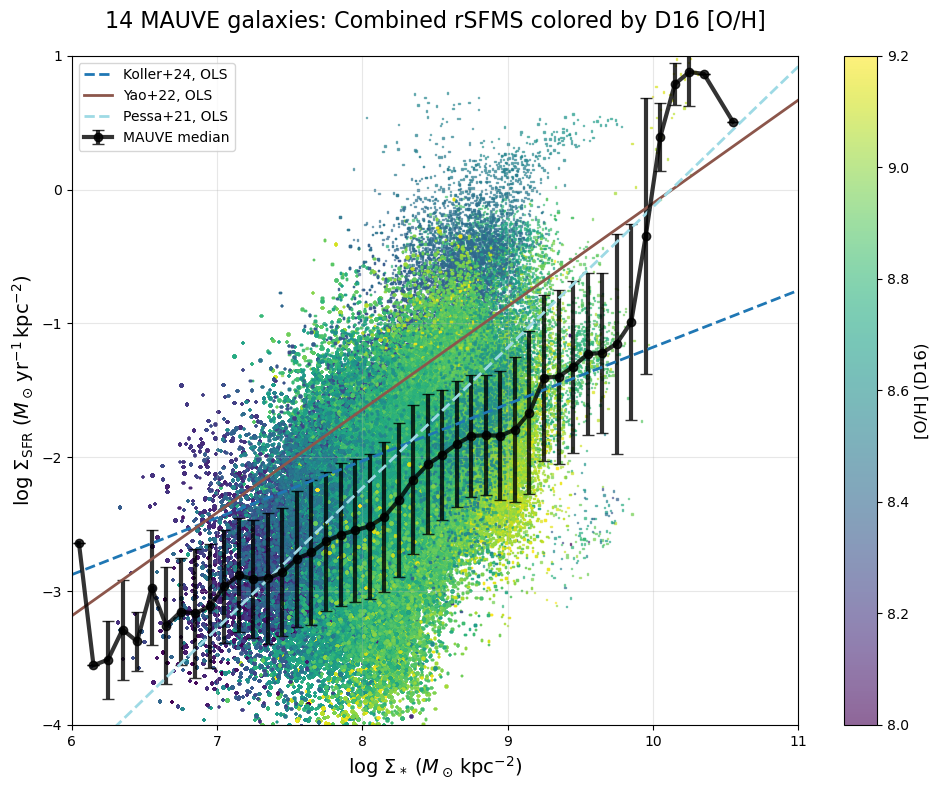

In [15]:
#
# COMBINED PLOT ONLY: rSFMS (Σ* vs ΣSFR) color-coded by [O/H] (D16)
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from pathlib import Path
from astropy.io import fits
import itertools
import re  # Add this import for regex

# 0 · discover galaxies
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR_SF = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_d16 = h['O_H_D16_SF'].data
    return sigM, sigSFR_SF, oh_d16

def _calc_median_stats(x, y, x_range=(6, 11), bin_width=0.1):
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    med, std, xc = [], [], []
    for i in range(len(x_bins) - 1):
        m = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if np.any(m):
            yb = y[m]
            med.append(np.median(yb))
            std.append(np.std(yb))
            xc.append(x_centers[i])
    return np.array(xc), np.array(med), np.array(std)

def plot_literature_sfms_fits(ax, show_legend=False):
    """Plot literature Star Formation Main Sequence fits on the given axis"""
    # Define x range for plotting literature fits
    x = np.linspace(6, 11, 100)
    
    # Kennicutt-Schmidt relation for resolved studies
    # log ΣSFR = α × log Σ* + β
    
    # Literature SFMS fits with slope and intercept parameters
    plot_data = [
        # Reference 1: This work (SF-spaxels), OLS
        (0.425, -5.428, 'Koller+24, OLS', '--'),
        # # Reference 1: This work (SF-spaxels), ODR  
        # (1.162, -11.014, 'Koller+24, ODR', '--'),
        # # # Reference 2: This work (spectral decomposition), OLS
        # # (0.401, -5.615, 'Koller+24, OLS (spectral)', '--'),
        # # # Reference 2: This work (spectral decomposition), ODR
        # # (2.562, -22.248, 'Koller+24, ODR (spectral)', '--'),
        # # Reference 3: Cano-Díaz et al. (2016)
        # (0.72, -7.95, 'Cano-Díaz+16', '-'),
        # # Reference 4: Hsieh et al. (2017), OLS
        # (0.715, -8.056, 'Hsieh+17, OLS', '-'),
        # # Reference 4: Hsieh et al. (2017), ODR
        # (1.005, -10.338, 'Hsieh+17, ODR', '-'),
        # Reference 5: Yao et al. (2022), OLS
        (0.771, -7.812, 'Yao+22, OLS', '-'),
        # # Reference 6: Mun et al. (2024), LTS
        # (0.918, -9.196, 'Mun+24, LTS', '--'),
        # # Reference 7: Jafariyazani et al. (2019), OLS
        # (0.43, -5.66, 'Jafariyazani+19, OLS', '-'),
        # # Reference 8: Wuyts et al. (2013)
        # (0.95, -8.4, 'Wuyts+13', '-'), 
        # # Vulcani et al. (2020) - stripping sample
        # (1.641, -14.79, 'Vulcani+20, PyStan (stripping)', '--'),
        # # Vulcani et al. (2020) - control sample
        # (1.659, -15.28, 'Vulcani+20, PyStan (control)', '--'),
        # Pessa et al. (2021) - OLS
        (1.05, -10.63, 'Pessa+21, OLS', '--'),
        # # Ellison et al. (2021) - OLS
        # (0.68, -7.38, 'Ellison+21, OLS', '--'),
        # # Ellison et al. (2021) - ODR
        # (1.37, -13.12, 'Ellison+21, ODR', '--')
    ]
    
    # Generate literature fits using the new format (slope, intercept, label, linestyle)
    literature_fits = []
    for slope, intercept, label, linestyle in plot_data:
        y_lit = slope * x + intercept
        literature_fits.append((y_lit, label, linestyle))
    
    plot_data = literature_fits
    
    # Plot all literature fits
    colors = plt.cm.tab20(np.linspace(0, 1, len(plot_data)))
    for i, (y, label, linestyle) in enumerate(plot_data):
        if show_legend:
            ax.plot(x, y, label=label, linewidth=2, linestyle=linestyle, color=colors[i])
        else:
            ax.plot(x, y, linewidth=2, linestyle=linestyle, color=colors[i])

# Create figure
fig, ax = plt.subplots(1, 1, figsize=(10, 8))

# Collect all SF spaxels across galaxies
all_x, all_y, all_oh = [], [], []
for gal in galaxies:
    sigM, sigSFR_SF, oh = load_maps(gal)
    good = np.isfinite(sigM) & np.isfinite(sigSFR_SF) & np.isfinite(oh)
    if np.any(good):
        all_x.extend(sigM[good])
        all_y.extend(sigSFR_SF[good])
        all_oh.extend(oh[good])

all_x, all_y, all_oh = np.array(all_x), np.array(all_y), np.array(all_oh)

# Median trend
x_median, y_median, y_std = _calc_median_stats(all_x, all_y, x_range=(6, 11), bin_width=0.1)

# Scatter color-coded by [O/H] (D16)
sc = ax.scatter(all_x, all_y, c=all_oh, s=1, alpha=0.6, marker=',',
                cmap='viridis', vmin=8.0, vmax=9.2)

# Plot median with error bars
ax.errorbar(x_median, y_median, yerr=y_std,
            fmt='ko-', linewidth=3, markersize=6, capsize=4, alpha=0.8,
            label='MAUVE median')

# Literature rSFMS fits (use existing helper if available)
try:
    plot_literature_sfms_fits(ax, show_legend=True)
except NameError:
    pass

# Legend and colorbar
ax.legend(fontsize=10, loc='upper left')
cbar = plt.colorbar(sc, ax=ax)
cbar.set_label('[O/H] (D16)', fontsize=12)

# Axes
ax.set_xlim(6, 11)
ax.set_ylim(-4, 1)
ax.grid(True, alpha=0.3)
ax.set_xlabel(r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', fontsize=14)
ax.set_ylabel(r'$\log\,\Sigma_{\mathrm{SFR}}\; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', fontsize=14)

# Title
plt.title(fr'{ngal} MAUVE galaxies: Combined rSFMS colored by D16 [O/H]', fontsize=16, pad=20)

plt.tight_layout()
plt.savefig('mauve_14galaxies_rSFMS_D16_combined.png', dpi=600, bbox_inches='tight')
plt.savefig('mauve_14galaxies_rSFMS_D16_combined.pdf', bbox_inches='tight')
plt.show()


/var/folders/rm/clp89v210v32vh5vjt2kx7b80000gr/T/ipykernel_65174/3031371670.py:313: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])


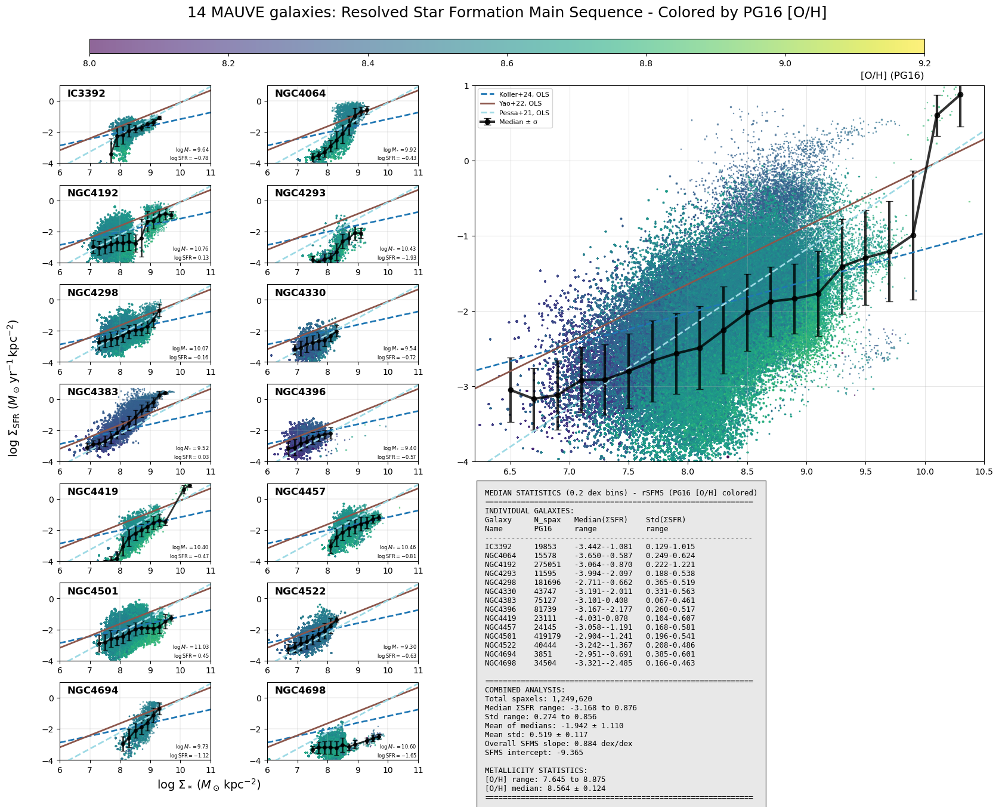

In [16]:
# ------------------------------------------------------------------
# COMPREHENSIVE LAYOUT: Individual galaxies + Combined plot + Statistics (rSFMS - [O/H] colored)
# 4-column layout: Cols 1-2 = Individual galaxies, Col 3 = Combined plot, Col 4 = Statistics
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from pathlib import Path
from astropy.io import fits
import itertools
import re  # Add this import for regex

# 0 · discover galaxies & colour palette
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)
assert ngal <= 14, "This layout assumes ≤ 14 galaxies."

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_pg16 = h['O_H_PG16_SF'].data
    return sigM, sigSFR, oh_pg16

# Extraction functions for log files
def extract_total_stellar_mass(galaxy_name):
    """Extract total stellar mass from mass log file. Returns log10(M☉) value or None if not found."""
    log_file = Path(f'mass_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total stellar mass \(R\)\s*:\s*([\d.-]+)\s*log10\(M☉\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading mass log for {galaxy_name}: {e}")
        return None

def extract_total_sfr(galaxy_name):
    """Extract total SFR from SFR log file. Returns log10(M☉/yr) value or None if not found."""
    log_file = Path(f'sfr_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total Halpha SFR from SF region:.*?in log10 scale:\s*([\d.-]+)\s*log\(M☉/yr\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading SFR log for {galaxy_name}: {e}")
        return None

def calculate_median_statistics(x, y, x_range=(6, 11), bin_width=0.2):
    """Calculate median and std in binned intervals"""
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    
    medians = []
    stds = []
    x_valid = []
    
    for i in range(len(x_bins) - 1):
        mask = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if len(np.unique(x[mask])) >= 10:  # Need at least 10 distinct x values
            y_bin = y[mask]
            medians.append(np.median(y_bin))
            stds.append(np.std(y_bin))
            x_valid.append(x_centers[i])
    
    return np.array(x_valid), np.array(medians), np.array(stds)

def plot_literature_sfms_fits(ax, show_legend=False):
    """Plot literature Star Formation Main Sequence fits on the given axis"""
    # Define x range for plotting literature fits
    x = np.linspace(6, 11, 100)
    
    # Kennicutt-Schmidt relation for resolved studies
    # log ΣSFR = α × log Σ* + β
    
    # Literature SFMS fits with slope and intercept parameters
    plot_data = [
        # Reference 1: This work (SF-spaxels), OLS
        (0.425, -5.428, 'Koller+24, OLS', '--'),
        # # Reference 1: This work (SF-spaxels), ODR  
        # (1.162, -11.014, 'Koller+24, ODR', '--'),
        # # # Reference 2: This work (spectral decomposition), OLS
        # # (0.401, -5.615, 'Koller+24, OLS (spectral)', '--'),
        # # # Reference 2: This work (spectral decomposition), ODR
        # # (2.562, -22.248, 'Koller+24, ODR (spectral)', '--'),
        # # Reference 3: Cano-Díaz et al. (2016)
        # (0.72, -7.95, 'Cano-Díaz+16', '-'),
        # # Reference 4: Hsieh et al. (2017), OLS
        # (0.715, -8.056, 'Hsieh+17, OLS', '-'),
        # # Reference 4: Hsieh et al. (2017), ODR
        # (1.005, -10.338, 'Hsieh+17, ODR', '-'),
        # Reference 5: Yao et al. (2022), OLS
        (0.771, -7.812, 'Yao+22, OLS', '-'),
        # # Reference 6: Mun et al. (2024), LTS
        # (0.918, -9.196, 'Mun+24, LTS', '--'),
        # # Reference 7: Jafariyazani et al. (2019), OLS
        # (0.43, -5.66, 'Jafariyazani+19, OLS', '-'),
        # # Reference 8: Wuyts et al. (2013)
        # (0.95, -8.4, 'Wuyts+13', '-'), 
        # # Vulcani et al. (2020) - stripping sample
        # (1.641, -14.79, 'Vulcani+20, PyStan (stripping)', '--'),
        # # Vulcani et al. (2020) - control sample
        # (1.659, -15.28, 'Vulcani+20, PyStan (control)', '--'),
        # Pessa et al. (2021) - OLS
        (1.05, -10.63, 'Pessa+21, OLS', '--'),
        # # Ellison et al. (2021) - OLS
        # (0.68, -7.38, 'Ellison+21, OLS', '--'),
        # # Ellison et al. (2021) - ODR
        # (1.37, -13.12, 'Ellison+21, ODR', '--')
    ]
    
    # Generate literature fits using the new format (slope, intercept, label, linestyle)
    literature_fits = []
    for slope, intercept, label, linestyle in plot_data:
        y_lit = slope * x + intercept
        literature_fits.append((y_lit, label, linestyle))
    
    plot_data = literature_fits
    
    # Plot all literature fits
    colors = plt.cm.tab20(np.linspace(0, 1, len(plot_data)))
    for i, (y, label, linestyle) in enumerate(plot_data):
        if show_legend:
            ax.plot(x, y, label=label, linewidth=2, linestyle=linestyle, color=colors[i])
        else:
            ax.plot(x, y, linewidth=2, linestyle=linestyle, color=colors[i])

# 1 · Create comprehensive figure with 4-column layout
fig = plt.figure(figsize=(20, 16))
gs = GridSpec(nrows=8, ncols=4, figure=fig,
              width_ratios=[1, 1, 1.5, 1.5],  # Cols 3&4 slightly wider
              height_ratios=[0.5, 1, 1, 1, 1, 1, 1, 1],  # Row 0 for colorbar
              wspace=0.3, hspace=0.3)

plot_idx = 0
scatter_for_cbar = None
individual_stats = []

# COLUMNS 1-2: Individual galaxy plots
for idx, gal in enumerate(galaxies):
    sigM, sigSFR, oh_pg16 = load_maps(gal)
    
    good_pg16 = np.isfinite(sigM) & np.isfinite(sigSFR) & np.isfinite(oh_pg16)
    
    if not np.any(good_pg16):
        print(f"Skipping {gal}: no valid data points")
        continue
    
    row = (plot_idx // 2) + 1  # Start from row 1 (row 0 for colorbar)
    col = plot_idx % 2
    plot_idx += 1

    axP = fig.add_subplot(gs[row, col])
    
    x_pg16, y_pg16, oh_pg16_vals = sigM[good_pg16], sigSFR[good_pg16], oh_pg16[good_pg16]
    
    # Calculate median statistics
    x_median, y_median, y_std = calculate_median_statistics(x_pg16, y_pg16)
    individual_stats.append((gal, x_median, y_median, y_std, len(x_pg16)))
    
    # Scatter plot colored by metallicity [O/H]
    scatter = axP.scatter(x_pg16, y_pg16, c=oh_pg16_vals, s=1, alpha=0.6, marker=',', 
                         cmap='viridis', vmin=8.0, vmax=9.2)
    
    # Plot median with error bars
    if len(x_median) > 0:
        axP.errorbar(x_median, y_median, yerr=y_std, fmt='ko-', linewidth=2, 
                    markersize=4, capsize=3, alpha=0.8)
    
    if scatter_for_cbar is None:
        scatter_for_cbar = scatter
    
    # Add literature fits to individual panels (no legend)
    plot_literature_sfms_fits(axP, show_legend=False)
    
    # Add galaxy name in top left corner
    axP.text(0.05, 0.95, gal, transform=axP.transAxes, fontsize=12, fontweight='bold',
             va='top', ha='left', bbox=dict(boxstyle='round,pad=0.3', facecolor='none', alpha=0.8, edgecolor='none'))
    
    # Bottom right: total stellar mass and SFR from log files
    total_mass = extract_total_stellar_mass(gal)
    total_sfr = extract_total_sfr(gal)
    
    if total_mass is not None and total_sfr is not None:
        log_text = fr'$\log M_* = {total_mass:.2f}$' '\n' fr'$\log \mathrm{{SFR}} = {total_sfr:.2f}$'
        axP.text(0.99, 0.01, log_text,
                 transform=axP.transAxes, va='bottom', ha='right', fontsize=6,
                 bbox=dict(facecolor='none', alpha=0.8, edgecolor='none', pad=2))
    
    axP.set_xlim(6, 11)
    axP.set_ylim(-4, 1)
    axP.grid(True, lw=0.25)

# COLUMNS 3-4: Combined plot - Upper panel
ax_combined = fig.add_subplot(gs[1:5, 2:4])  # Spans rows 1-4, columns 2-3

# Collect all data for combined analysis
all_x, all_y, all_oh = [], [], []
galaxy_counts = {}

for gal in galaxies:
    sigM, sigSFR, oh_pg16 = load_maps(gal)
    good_pg16 = np.isfinite(sigM) & np.isfinite(sigSFR) & np.isfinite(oh_pg16)
    
    if np.any(good_pg16):
        x_pg16, y_pg16, oh_pg16_vals = sigM[good_pg16], sigSFR[good_pg16], oh_pg16[good_pg16]
        all_x.extend(x_pg16)
        all_y.extend(y_pg16)
        all_oh.extend(oh_pg16_vals)
        galaxy_counts[gal] = len(x_pg16)
    else:
        galaxy_counts[gal] = 0

all_x, all_y, all_oh = np.array(all_x), np.array(all_y), np.array(all_oh)

# Calculate combined median statistics
x_median_combined, y_median_combined, y_std_combined = calculate_median_statistics(all_x, all_y)

# Scatter plot colored by metallicity for combined data
scatter_combined = ax_combined.scatter(all_x, all_y, c=all_oh, s=1, alpha=0.6, marker=',', 
                                      cmap='viridis', vmin=8.0, vmax=9.2)

# Plot combined median with error bars
if len(x_median_combined) > 0:
    ax_combined.errorbar(x_median_combined, y_median_combined, yerr=y_std_combined, 
                        fmt='ko-', linewidth=3, markersize=6, capsize=4, alpha=0.8, label='Median ± σ')

# Add literature fits to combined panel (with legend)
plot_literature_sfms_fits(ax_combined, show_legend=True)

# Add legend with small font
ax_combined.legend(fontsize=8, ncol=1, loc='upper left')

ax_combined.set_xlim(6.2, 10.5)
ax_combined.set_ylim(-4, 1)
ax_combined.grid(True, alpha=0.3)

# COLUMNS 3-4: Statistics table - Lower panel
ax_stats = fig.add_subplot(gs[5:8, 2:4])  # Spans rows 5-7, columns 2-3
ax_stats.axis('off')

# Create comprehensive statistics text
stats_table = "MEDIAN STATISTICS (0.2 dex bins) - rSFMS (PG16 [O/H] colored)\n"
stats_table += "="*60 + "\n"
stats_table += "INDIVIDUAL GALAXIES:\n"
stats_table += f"{'Galaxy':<10} {'N_spax':<8} {'Median(ΣSFR)':<15} {'Std(ΣSFR)':<15}\n"
stats_table += f"{'Name':<10} {'PG16':<8} {'range':<15} {'range':<15}\n"
stats_table += "-"*60 + "\n"

for gal, x_median, y_median, y_std, n_spax in individual_stats:
    if len(y_median) > 0:
        median_range = f"{y_median.min():.3f}-{y_median.max():.3f}"
        std_range = f"{y_std.min():.3f}-{y_std.max():.3f}"
    else:
        median_range = "N/A"
        std_range = "N/A"
    
    stats_table += f"{gal:<10} {n_spax:<8} {median_range:<15} {std_range:<15}\n"

stats_table += "\n" + "="*60 + "\n"
stats_table += "COMBINED ANALYSIS:\n"
stats_table += f"Total spaxels: {len(all_x):,}\n"
if len(y_median_combined) > 0:
    stats_table += f"Median ΣSFR range: {y_median_combined.min():.3f} to {y_median_combined.max():.3f}\n"
    stats_table += f"Std range: {y_std_combined.min():.3f} to {y_std_combined.max():.3f}\n"
    stats_table += f"Mean of medians: {np.mean(y_median_combined):.3f} ± {np.std(y_median_combined):.3f}\n"
    stats_table += f"Mean std: {np.mean(y_std_combined):.3f} ± {np.std(y_std_combined):.3f}\n"
    
    # Calculate overall SFMS slope
    if len(x_median_combined) > 3:
        slope, intercept = np.polyfit(x_median_combined, y_median_combined, 1)
        stats_table += f"Overall SFMS slope: {slope:.3f} dex/dex\n"
        stats_table += f"SFMS intercept: {intercept:.3f}\n"

# Add metallicity statistics
stats_table += f"\nMETALLICITY STATISTICS:\n"
stats_table += f"[O/H] range: {all_oh.min():.3f} to {all_oh.max():.3f}\n"
stats_table += f"[O/H] median: {np.median(all_oh):.3f} ± {np.std(all_oh):.3f}\n"
        
stats_table += "="*60

ax_stats.text(0.02, 0.98, stats_table, transform=ax_stats.transAxes, va='top', ha='left',
              fontsize=9, family='monospace',
              bbox=dict(facecolor='lightgray', alpha=0.5, edgecolor='black', pad=10))

# Add horizontal colorbar at the top
if scatter_for_cbar is not None:
    cbar_ax = fig.add_axes([0.15, 0.85, 0.7, 0.015])
    cbar = plt.colorbar(scatter_for_cbar, cax=cbar_ax, orientation='horizontal')
    cbar.set_label(r'[O/H] (PG16)', fontsize=12, loc='right')

# Global title and labels
fig.suptitle(fr'{ngal} MAUVE galaxies: Resolved Star Formation Main Sequence - Colored by PG16 [O/H]', 
             fontsize=18, y=0.90)

# Shared axis labels
fig.text(0.25, 0.08, r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', 
         ha='center', fontsize=14)
fig.text(0.08, 0.5, r'$\log\,\Sigma_{\mathrm{SFR}} \; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', 
         va='center', rotation='vertical', fontsize=14)

plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])
plt.savefig('mauve_14galaxies_rSFMS_PG16.png', dpi=600, bbox_inches='tight')
plt.savefig('mauve_14galaxies_rSFMS_PG16.pdf', bbox_inches='tight')
plt.show()

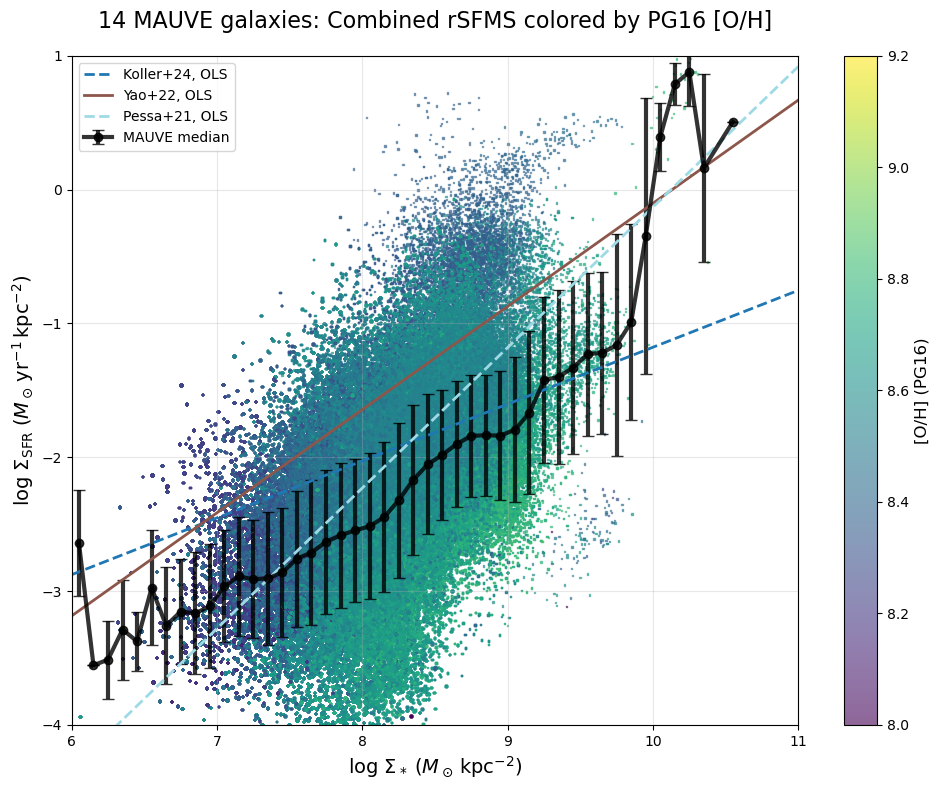

In [17]:
#
# COMBINED PLOT ONLY: rSFMS (Σ* vs ΣSFR) color-coded by [O/H] (PG16)
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from pathlib import Path
from astropy.io import fits
import itertools
import re  # Add this import for regex

# 0 · discover galaxies
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR_SF = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_pg16 = h['O_H_PG16_SF'].data
    return sigM, sigSFR_SF, oh_pg16

def _calc_median_stats(x, y, x_range=(6, 11), bin_width=0.1):
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    med, std, xc = [], [], []
    for i in range(len(x_bins) - 1):
        m = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if np.any(m):
            yb = y[m]
            med.append(np.median(yb))
            std.append(np.std(yb))
            xc.append(x_centers[i])
    return np.array(xc), np.array(med), np.array(std)

def plot_literature_sfms_fits(ax, show_legend=False):
    """Plot literature Star Formation Main Sequence fits on the given axis"""
    x = np.linspace(6, 11, 100)
    plot_data = [
        (0.425, -5.428, 'Koller+24, OLS', '--'),
        (0.771, -7.812, 'Yao+22, OLS', '-'),
        (1.05, -10.63, 'Pessa+21, OLS', '--'),
    ]
    literature_fits = []
    for slope, intercept, label, linestyle in plot_data:
        y_lit = slope * x + intercept
        literature_fits.append((y_lit, label, linestyle))
    plot_data = literature_fits
    colors = plt.cm.tab20(np.linspace(0, 1, len(plot_data)))
    for i, (y, label, linestyle) in enumerate(plot_data):
        if show_legend:
            ax.plot(x, y, label=label, linewidth=2, linestyle=linestyle, color=colors[i])
        else:
            ax.plot(x, y, linewidth=2, linestyle=linestyle, color=colors[i])

# Create figure
fig, ax = plt.subplots(1, 1, figsize=(10, 8))

# Collect all SF spaxels across galaxies
all_x, all_y, all_oh = [], [], []
for gal in galaxies:
    sigM, sigSFR_SF, oh = load_maps(gal)
    good = np.isfinite(sigM) & np.isfinite(sigSFR_SF) & np.isfinite(oh)
    if np.any(good):
        all_x.extend(sigM[good])
        all_y.extend(sigSFR_SF[good])
        all_oh.extend(oh[good])

all_x, all_y, all_oh = np.array(all_x), np.array(all_y), np.array(all_oh)

# Median trend
x_median, y_median, y_std = _calc_median_stats(all_x, all_y, x_range=(6, 11), bin_width=0.1)

# Scatter color-coded by [O/H] (PG16)
sc = ax.scatter(all_x, all_y, c=all_oh, s=1, alpha=0.6, marker=',',
                cmap='viridis', vmin=8.0, vmax=9.2)

# Plot median with error bars
ax.errorbar(x_median, y_median, yerr=y_std,
            fmt='ko-', linewidth=3, markersize=6, capsize=4, alpha=0.8,
            label='MAUVE median')

# Literature rSFMS fits
try:
    plot_literature_sfms_fits(ax, show_legend=True)
except NameError:
    pass

# Legend and colorbar
ax.legend(fontsize=10, loc='upper left')
cbar = plt.colorbar(sc, ax=ax)
cbar.set_label('[O/H] (PG16)', fontsize=12)

# Axes
ax.set_xlim(6, 11)
ax.set_ylim(-4, 1)
ax.grid(True, alpha=0.3)
ax.set_xlabel(r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', fontsize=14)
ax.set_ylabel(r'$\log\,\Sigma_{\mathrm{SFR}}\; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', fontsize=14)

# Title
plt.title(fr'{ngal} MAUVE galaxies: Combined rSFMS colored by PG16 [O/H]', fontsize=16, pad=20)

plt.tight_layout()
plt.savefig('mauve_14galaxies_rSFMS_PG16_combined.png', dpi=600, bbox_inches='tight')
plt.savefig('mauve_14galaxies_rSFMS_PG16_combined.pdf', bbox_inches='tight')
plt.show()


## 20250804

Hi Rongjun. This is very nice!  So, as hinted at the meeting on Wednesday, I was expecting 4383 to be "weird" but 4396 is a "surprise." It may be worth digging a bit more in the reasons for this offset. For example, is it physical or potentially due to the metallicity calibration (i.e., unusual radiation field so that we get O/H wrong). Adam W. started looking into this and I will forward to you some extracts of his analysis. The other point worth noting is that it appears to me the resolved MZ relation seems to depend less on global properties and more on local ones than the SFRs... which is interesting. I fully agree with your plan so feel free to push things along this direction. Lastly, one thing I forgot to "flag". When you compare with the literature keep an eye on the fact that some works correct values for inclination and some other do not. I suspect at the moment you are not and the question is whether at some point it may be worth considering this. This won't affect O/H but will affect stellar mass and SFR. 

Total spaxels collected: 1,246,932
SFR bins defined: 15 bins
  ≤ -3.0: 269,388 spaxels
  -3.00 to -3.00: 0 spaxels
  -3.00 to -2.75: 169,996 spaxels
  -2.75 to -2.50: 192,436 spaxels
  -2.50 to -2.25: 186,178 spaxels
  -2.25 to -2.00: 159,411 spaxels
  -2.00 to -1.75: 122,510 spaxels
  -1.75 to -1.50: 75,884 spaxels
  -1.50 to -1.25: 40,151 spaxels
  -1.25 to -1.00: 17,880 spaxels
  -1.00 to -0.75: 6,641 spaxels
  -0.75 to -0.50: 3,582 spaxels
  -0.50 to -0.25: 1,911 spaxels
  -0.25 to 0.00: 550 spaxels
  > 0.0: 414 spaxels
Skipping bin -3.00 to -3.00: no valid data points


/var/folders/rm/clp89v210v32vh5vjt2kx7b80000gr/T/ipykernel_65174/810683557.py:301: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])


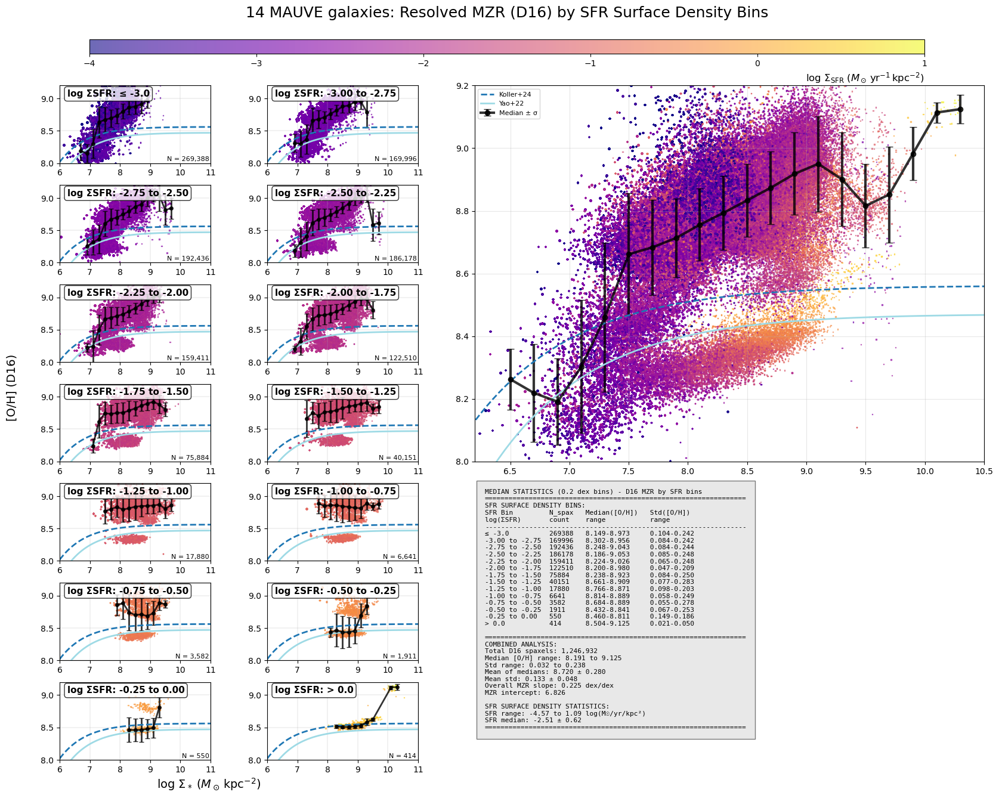

In [18]:
# ------------------------------------------------------------------
# COMPREHENSIVE LAYOUT: SFR-binned rMZR + Combined plot + Statistics (D16 MZR - SFR colored)
# 4-column layout: Cols 1-2 = SFR-binned MZR, Col 3 = Combined plot, Col 4 = Statistics
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from pathlib import Path
from astropy.io import fits
import itertools
import re  # Add this import for regex

# 0 · discover galaxies & colour palette
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)
assert ngal <= 14, "This layout assumes ≤ 14 galaxies."

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_d16 = h['O_H_D16_SF'].data
    return sigM, sigSFR, oh_d16

# Extraction functions for log files
def extract_total_stellar_mass(galaxy_name):
    """Extract total stellar mass from mass log file. Returns log10(M☉) value or None if not found."""
    log_file = Path(f'mass_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total stellar mass \(R\)\s*:\s*([\d.-]+)\s*log10\(M☉\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading mass log for {galaxy_name}: {e}")
        return None

def extract_total_sfr(galaxy_name):
    """Extract total SFR from SFR log file. Returns log10(M☉/yr) value or None if not found."""
    log_file = Path(f'sfr_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total Halpha SFR from SF region:.*?in log10 scale:\s*([\d.-]+)\s*log\(M☉/yr\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading SFR log for {galaxy_name}: {e}")
        return None

def calculate_median_statistics(x, y, x_range=(6, 11), bin_width=0.2):
    """Calculate median and std in binned intervals"""
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    
    medians = []
    stds = []
    x_valid = []
    
    for i in range(len(x_bins) - 1):
        mask = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if len(np.unique(x[mask])) >= 10:  # Need at least 10 distinct x values
            y_bin = y[mask]
            medians.append(np.median(y_bin))
            stds.append(np.std(y_bin))
            x_valid.append(x_centers[i])
    
    return np.array(x_valid), np.array(medians), np.array(stds)

def plot_literature_mzr_fits(ax, show_legend=False):
    """Plot literature MZR fits on the given axis"""
    # Define x range for plotting literature fits
    x = np.linspace(6, 11, 100)
    
    # Yao+22
    # 12 + log(O/H) = a + b(log Σ* - c)e^(-(x-c))
    # Coefficients: a = 8.47, b = 0.0002, c = 12.36
    a1, b1, c1 = 8.47, 0.0002, 12.36
    y_yao22 = a1 + b1 * (x - c1) * np.exp(-(x - c1))

    # Koller+24
    # 12 + log(O/H) = a + b(log Σ* - c)exp(-(log Σ* - c))
    # Coefficients: a = 8.561, b = 0.0001, c = 12.7
    a2, b2, c2 = 8.561, 0.0001, 12.7
    y_koller24 = a2 + b2 * (x - c2) * np.exp(-(x - c2))

    # MZR literature data
    plot_data = [
        (y_koller24, 'Koller+24', '--'),
        (y_yao22, 'Yao+22', '-'),
    ]
    
    # Plot all literature fits
    colors = plt.cm.tab20(np.linspace(0, 1, len(plot_data)))
    for i, (y, label, linestyle) in enumerate(plot_data):
        if show_legend:
            ax.plot(x, y, label=label, linewidth=2, linestyle=linestyle, color=colors[i])
        else:
            ax.plot(x, y, linewidth=2, linestyle=linestyle, color=colors[i])

# 1 · Collect all data from all galaxies first
print("Collecting data from all galaxies...")
all_x, all_y, all_sfr = [], [], []
for gal in galaxies:
    sigM, sigSFR, oh_d16 = load_maps(gal)
    good_d16 = np.isfinite(sigM) & np.isfinite(oh_d16) & np.isfinite(sigSFR)
    
    if np.any(good_d16):
        x_d16, y_d16, sfr_d16 = sigM[good_d16], oh_d16[good_d16], sigSFR[good_d16]
        all_x.extend(x_d16)
        all_y.extend(y_d16)
        all_sfr.extend(sfr_d16)

all_x, all_y, all_sfr = np.array(all_x), np.array(all_y), np.array(all_sfr)
print(f"Total spaxels collected: {len(all_x):,}")

# 2 · Define SFR surface density bins
# Bins: ≤-3, -3 to 0 (with 0.25 width), >0
sfr_bin_edges = [-np.inf, -3.0]
sfr_bin_edges.extend(np.arange(-3.0, 0.0 + 0.25, 0.25))
sfr_bin_edges.append(np.inf)

sfr_bin_labels = []
sfr_bin_labels.append('≤ -3.0')
for i in range(len(sfr_bin_edges) - 3):
    start = sfr_bin_edges[i + 1]
    end = sfr_bin_edges[i + 2]
    sfr_bin_labels.append(f'{start:.2f} to {end:.2f}')
sfr_bin_labels.append('> 0.0')

print(f"SFR bins defined: {len(sfr_bin_labels)} bins")
for i, label in enumerate(sfr_bin_labels):
    mask = (all_sfr >= sfr_bin_edges[i]) & (all_sfr < sfr_bin_edges[i + 1])
    print(f"  {label}: {np.sum(mask):,} spaxels")

# 3 · Create comprehensive figure with 4-column layout
fig = plt.figure(figsize=(20, 16))
gs = GridSpec(nrows=8, ncols=4, figure=fig,
              width_ratios=[1, 1, 1.5, 1.5],  # Cols 3&4 slightly wider
              height_ratios=[0.5, 1, 1, 1, 1, 1, 1, 1],  # Row 0 for colorbar
              wspace=0.3, hspace=0.3)

plot_idx = 0
scatter_for_cbar = None
bin_stats = []

# COLUMNS 1-2: SFR-binned MZR plots
max_plots = min(len(sfr_bin_labels), 14)  # Maximum 14 plots (7 rows × 2 cols)

for bin_idx in range(len(sfr_bin_labels)):  # Changed to iterate through all bins
    if plot_idx >= 14:  # Stop if we've filled all 14 subplot positions
        print(f"Maximum plots reached (14). Skipping remaining bins.")
        break
        
    # Create mask for this SFR bin
    mask = (all_sfr >= sfr_bin_edges[bin_idx]) & (all_sfr < sfr_bin_edges[bin_idx + 1])
    
    if not np.any(mask):
        print(f"Skipping bin {sfr_bin_labels[bin_idx]}: no valid data points")
        continue
    
    row = (plot_idx // 2) + 1  # Start from row 1 (row 0 for colorbar)
    col = plot_idx % 2
    plot_idx += 1

    axP = fig.add_subplot(gs[row, col])
    
    x_bin, y_bin, sfr_bin = all_x[mask], all_y[mask], all_sfr[mask]
    
    # Calculate median statistics for this bin
    x_median, y_median, y_std = calculate_median_statistics(x_bin, y_bin)
    bin_stats.append((sfr_bin_labels[bin_idx], x_median, y_median, y_std, len(x_bin)))
    
    # Scatter plot colored by SFR surface density
    scatter = axP.scatter(x_bin, y_bin, c=sfr_bin, s=1, alpha=0.6, marker=',', 
                         cmap='plasma', vmin=-4, vmax=1)
    
    # Plot median with error bars
    if len(x_median) > 0:
        axP.errorbar(x_median, y_median, yerr=y_std, fmt='ko-', linewidth=2, 
                    markersize=4, capsize=3, alpha=0.8)
    
    if scatter_for_cbar is None:
        scatter_for_cbar = scatter
    
    # Add literature fits to individual panels (no legend)
    plot_literature_mzr_fits(axP, show_legend=False)
    
    # Add bin label in top left corner
    axP.text(0.05, 0.95, f'log ΣSFR: {sfr_bin_labels[bin_idx]}', 
             transform=axP.transAxes, fontsize=11, fontweight='bold',
             va='top', ha='left', bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8, edgecolor='black'))
    
    # Bottom right: number of spaxels
    axP.text(0.99, 0.01, f'N = {len(x_bin):,}',
             transform=axP.transAxes, va='bottom', ha='right', fontsize=8,
             bbox=dict(facecolor='none', alpha=0.8, edgecolor='none', pad=2))
    
    axP.set_xlim(6, 11)
    axP.set_ylim(8.0, 9.2)
    axP.grid(True, lw=0.25)

# COLUMNS 3-4: Combined plot - Upper panel
ax_combined = fig.add_subplot(gs[1:5, 2:4])  # Spans rows 1-4, columns 2-3

# Calculate combined median statistics
x_median_combined, y_median_combined, y_std_combined = calculate_median_statistics(all_x, all_y)

# Scatter plot colored by SFR surface density for combined data
scatter_combined = ax_combined.scatter(all_x, all_y, c=all_sfr, s=1, alpha=0.6, marker=',', 
                                      cmap='plasma', vmin=-4, vmax=1)

# Plot combined median with error bars
if len(x_median_combined) > 0:
    ax_combined.errorbar(x_median_combined, y_median_combined, yerr=y_std_combined, 
                        fmt='ko-', linewidth=3, markersize=6, capsize=4, alpha=0.8, label='Median ± σ')

# Add literature fits to combined panel (with legend)
plot_literature_mzr_fits(ax_combined, show_legend=True)

# Add legend with small font
ax_combined.legend(fontsize=8, ncol=1, loc='upper left')

ax_combined.set_xlim(6.2, 10.5)
ax_combined.set_ylim(8.0, 9.2)
ax_combined.grid(True, alpha=0.3)

# COLUMNS 3-4: Statistics table - Lower panel
ax_stats = fig.add_subplot(gs[5:8, 2:4])  # Spans rows 5-7, columns 2-3
ax_stats.axis('off')

# Create comprehensive statistics text
stats_table = "MEDIAN STATISTICS (0.2 dex bins) - D16 MZR by SFR bins\n"
stats_table += "="*65 + "\n"
stats_table += "SFR SURFACE DENSITY BINS:\n"
stats_table += f"{'SFR Bin':<15} {'N_spax':<8} {'Median([O/H])':<15} {'Std([O/H])':<15}\n"
stats_table += f"{'log(ΣSFR)':<15} {'count':<8} {'range':<15} {'range':<15}\n"
stats_table += "-"*65 + "\n"

for bin_label, x_median, y_median, y_std, n_spax in bin_stats:
    if len(y_median) > 0:
        median_range = f"{y_median.min():.3f}-{y_median.max():.3f}"
        std_range = f"{y_std.min():.3f}-{y_std.max():.3f}"
    else:
        median_range = "N/A"
        std_range = "N/A"
    
    stats_table += f"{bin_label:<15} {n_spax:<8} {median_range:<15} {std_range:<15}\n"

stats_table += "\n" + "="*65 + "\n"
stats_table += "COMBINED ANALYSIS:\n"
stats_table += f"Total D16 spaxels: {len(all_x):,}\n"
if len(y_median_combined) > 0:
    stats_table += f"Median [O/H] range: {y_median_combined.min():.3f} to {y_median_combined.max():.3f}\n"
    stats_table += f"Std range: {y_std_combined.min():.3f} to {y_std_combined.max():.3f}\n"
    stats_table += f"Mean of medians: {np.mean(y_median_combined):.3f} ± {np.std(y_median_combined):.3f}\n"
    stats_table += f"Mean std: {np.mean(y_std_combined):.3f} ± {np.std(y_std_combined):.3f}\n"
    
    # Calculate overall metallicity gradient (slope)
    if len(x_median_combined) > 3:
        slope, intercept = np.polyfit(x_median_combined, y_median_combined, 1)
        stats_table += f"Overall MZR slope: {slope:.3f} dex/dex\n"
        stats_table += f"MZR intercept: {intercept:.3f}\n"

# Add SFR statistics
stats_table += f"\nSFR SURFACE DENSITY STATISTICS:\n"
stats_table += f"SFR range: {all_sfr.min():.2f} to {all_sfr.max():.2f} log(M☉/yr/kpc²)\n"
stats_table += f"SFR median: {np.median(all_sfr):.2f} ± {np.std(all_sfr):.2f}\n"
        
stats_table += "="*65

ax_stats.text(0.02, 0.98, stats_table, transform=ax_stats.transAxes, va='top', ha='left',
              fontsize=8, family='monospace',
              bbox=dict(facecolor='lightgray', alpha=0.5, edgecolor='black', pad=10))

# Add horizontal colorbar at the top
if scatter_for_cbar is not None:
    cbar_ax = fig.add_axes([0.15, 0.85, 0.7, 0.015])
    cbar = plt.colorbar(scatter_for_cbar, cax=cbar_ax, orientation='horizontal')
    cbar.set_label(r'$\log\,\Sigma_{\mathrm{SFR}} \; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', fontsize=12, loc='right')

# Global title and labels
fig.suptitle(fr'{ngal} MAUVE galaxies: Resolved MZR (D16) by SFR Surface Density Bins', 
             fontsize=18, y=0.90)

# Shared axis labels
fig.text(0.25, 0.08, r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', 
         ha='center', fontsize=14)
fig.text(0.08, 0.5, r'[O/H] (D16)', 
         va='center', rotation='vertical', fontsize=14)

plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])
plt.show()

Total spaxels collected: 1,249,620
SFR bins defined: 15 bins
  ≤ -3.0: 271,980 spaxels
  -3.00 to -3.00: 0 spaxels
  -3.00 to -2.75: 169,967 spaxels
  -2.75 to -2.50: 192,418 spaxels
  -2.50 to -2.25: 186,187 spaxels
  -2.25 to -2.00: 159,422 spaxels
  -2.00 to -1.75: 122,525 spaxels
  -1.75 to -1.50: 75,909 spaxels
  -1.50 to -1.25: 40,159 spaxels
  -1.25 to -1.00: 17,896 spaxels
  -1.00 to -0.75: 6,659 spaxels
  -0.75 to -0.50: 3,602 spaxels
  -0.50 to -0.25: 1,932 spaxels
  -0.25 to 0.00: 550 spaxels
  > 0.0: 414 spaxels
Skipping bin -3.00 to -3.00: no valid data points


/var/folders/rm/clp89v210v32vh5vjt2kx7b80000gr/T/ipykernel_65174/89049336.py:301: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])


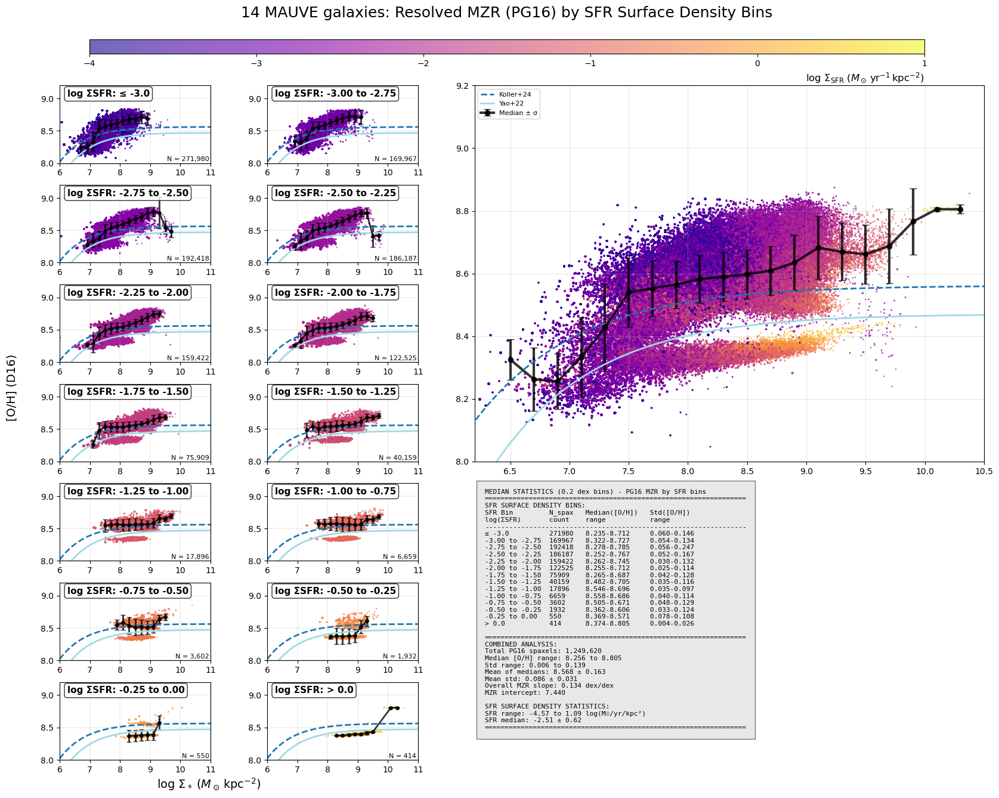

In [19]:
# ------------------------------------------------------------------
# COMPREHENSIVE LAYOUT: SFR-binned rMZR + Combined plot + Statistics (PG16 MZR - SFR colored)
# 4-column layout: Cols 1-2 = SFR-binned MZR, Col 3 = Combined plot, Col 4 = Statistics
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from pathlib import Path
from astropy.io import fits
import itertools
import re  # Add this import for regex

# 0 · discover galaxies & colour palette
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)
assert ngal <= 14, "This layout assumes ≤ 14 galaxies."

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_pg16 = h['O_H_PG16_SF'].data  # Changed from D16 to PG16
    return sigM, sigSFR, oh_pg16

# Extraction functions for log files
def extract_total_stellar_mass(galaxy_name):
    """Extract total stellar mass from mass log file. Returns log10(M☉) value or None if not found."""
    log_file = Path(f'mass_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total stellar mass \(R\)\s*:\s*([\d.-]+)\s*log10\(M☉\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading mass log for {galaxy_name}: {e}")
        return None

def extract_total_sfr(galaxy_name):
    """Extract total SFR from SFR log file. Returns log10(M☉/yr) value or None if not found."""
    log_file = Path(f'sfr_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total Halpha SFR from SF region:.*?in log10 scale:\s*([\d.-]+)\s*log\(M☉/yr\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading SFR log for {galaxy_name}: {e}")
        return None

def calculate_median_statistics(x, y, x_range=(6, 11), bin_width=0.2):
    """Calculate median and std in binned intervals"""
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    
    medians = []
    stds = []
    x_valid = []
    
    for i in range(len(x_bins) - 1):
        mask = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if len(np.unique(x[mask])) >= 10:  # Need at least 10 distinct x values
            y_bin = y[mask]
            medians.append(np.median(y_bin))
            stds.append(np.std(y_bin))
            x_valid.append(x_centers[i])
    
    return np.array(x_valid), np.array(medians), np.array(stds)

def plot_literature_mzr_fits(ax, show_legend=False):
    """Plot literature MZR fits on the given axis"""
    # Define x range for plotting literature fits
    x = np.linspace(6, 11, 100)
    
    # Yao+22
    # 12 + log(O/H) = a + b(log Σ* - c)e^(-(x-c))
    # Coefficients: a = 8.47, b = 0.0002, c = 12.36
    a1, b1, c1 = 8.47, 0.0002, 12.36
    y_yao22 = a1 + b1 * (x - c1) * np.exp(-(x - c1))

    # Koller+24
    # 12 + log(O/H) = a + b(log Σ* - c)exp(-(log Σ* - c))
    # Coefficients: a = 8.561, b = 0.0001, c = 12.7
    a2, b2, c2 = 8.561, 0.0001, 12.7
    y_koller24 = a2 + b2 * (x - c2) * np.exp(-(x - c2))

    # MZR literature data
    plot_data = [
        (y_koller24, 'Koller+24', '--'),
        (y_yao22, 'Yao+22', '-'),
    ]
    
    # Plot all literature fits
    colors = plt.cm.tab20(np.linspace(0, 1, len(plot_data)))
    for i, (y, label, linestyle) in enumerate(plot_data):
        if show_legend:
            ax.plot(x, y, label=label, linewidth=2, linestyle=linestyle, color=colors[i])
        else:
            ax.plot(x, y, linewidth=2, linestyle=linestyle, color=colors[i])

# 1 · Collect all data from all galaxies first
print("Collecting data from all galaxies...")
all_x, all_y, all_sfr = [], [], []
for gal in galaxies:
    sigM, sigSFR, oh_pg16 = load_maps(gal)  # Changed variable name
    good_pg16 = np.isfinite(sigM) & np.isfinite(oh_pg16) & np.isfinite(sigSFR)  # Changed variable name
    
    if np.any(good_pg16):
        x_pg16, y_pg16, sfr_pg16 = sigM[good_pg16], oh_pg16[good_pg16], sigSFR[good_pg16]  # Changed variable names
        all_x.extend(x_pg16)
        all_y.extend(y_pg16)
        all_sfr.extend(sfr_pg16)

all_x, all_y, all_sfr = np.array(all_x), np.array(all_y), np.array(all_sfr)
print(f"Total spaxels collected: {len(all_x):,}")

# 2 · Define SFR surface density bins
# Bins: ≤-3, -3 to 0 (with 0.25 width), >0
sfr_bin_edges = [-np.inf, -3.0]
sfr_bin_edges.extend(np.arange(-3.0, 0.0 + 0.25, 0.25))
sfr_bin_edges.append(np.inf)

sfr_bin_labels = []
sfr_bin_labels.append('≤ -3.0')
for i in range(len(sfr_bin_edges) - 3):
    start = sfr_bin_edges[i + 1]
    end = sfr_bin_edges[i + 2]
    sfr_bin_labels.append(f'{start:.2f} to {end:.2f}')
sfr_bin_labels.append('> 0.0')

print(f"SFR bins defined: {len(sfr_bin_labels)} bins")
for i, label in enumerate(sfr_bin_labels):
    mask = (all_sfr >= sfr_bin_edges[i]) & (all_sfr < sfr_bin_edges[i + 1])
    print(f"  {label}: {np.sum(mask):,} spaxels")

# 3 · Create comprehensive figure with 4-column layout
fig = plt.figure(figsize=(20, 16))
gs = GridSpec(nrows=8, ncols=4, figure=fig,
              width_ratios=[1, 1, 1.5, 1.5],  # Cols 3&4 slightly wider
              height_ratios=[0.5, 1, 1, 1, 1, 1, 1, 1],  # Row 0 for colorbar
              wspace=0.3, hspace=0.3)

plot_idx = 0
scatter_for_cbar = None
bin_stats = []

# COLUMNS 1-2: SFR-binned MZR plots
max_plots = min(len(sfr_bin_labels), 14)  # Maximum 14 plots (7 rows × 2 cols)

for bin_idx in range(len(sfr_bin_labels)):  # Changed to iterate through all bins
    if plot_idx >= 14:  # Stop if we've filled all 14 subplot positions
        print(f"Maximum plots reached (14). Skipping remaining bins.")
        break
        
    # Create mask for this SFR bin
    mask = (all_sfr >= sfr_bin_edges[bin_idx]) & (all_sfr < sfr_bin_edges[bin_idx + 1])
    
    if not np.any(mask):
        print(f"Skipping bin {sfr_bin_labels[bin_idx]}: no valid data points")
        continue
    
    row = (plot_idx // 2) + 1  # Start from row 1 (row 0 for colorbar)
    col = plot_idx % 2
    plot_idx += 1

    axP = fig.add_subplot(gs[row, col])
    
    x_bin, y_bin, sfr_bin = all_x[mask], all_y[mask], all_sfr[mask]
    
    # Calculate median statistics for this bin
    x_median, y_median, y_std = calculate_median_statistics(x_bin, y_bin)
    bin_stats.append((sfr_bin_labels[bin_idx], x_median, y_median, y_std, len(x_bin)))
    
    # Scatter plot colored by SFR surface density
    scatter = axP.scatter(x_bin, y_bin, c=sfr_bin, s=1, alpha=0.6, marker=',', 
                         cmap='plasma', vmin=-4, vmax=1)
    
    # Plot median with error bars
    if len(x_median) > 0:
        axP.errorbar(x_median, y_median, yerr=y_std, fmt='ko-', linewidth=2, 
                    markersize=4, capsize=3, alpha=0.8)
    
    if scatter_for_cbar is None:
        scatter_for_cbar = scatter
    
    # Add literature fits to individual panels (no legend)
    plot_literature_mzr_fits(axP, show_legend=False)
    
    # Add bin label in top left corner
    axP.text(0.05, 0.95, f'log ΣSFR: {sfr_bin_labels[bin_idx]}', 
             transform=axP.transAxes, fontsize=11, fontweight='bold',
             va='top', ha='left', bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8, edgecolor='black'))
    
    # Bottom right: number of spaxels
    axP.text(0.99, 0.01, f'N = {len(x_bin):,}',
             transform=axP.transAxes, va='bottom', ha='right', fontsize=8,
             bbox=dict(facecolor='none', alpha=0.8, edgecolor='none', pad=2))
    
    axP.set_xlim(6, 11)
    axP.set_ylim(8.0, 9.2)
    axP.grid(True, lw=0.25)

# COLUMNS 3-4: Combined plot - Upper panel
ax_combined = fig.add_subplot(gs[1:5, 2:4])  # Spans rows 1-4, columns 2-3

# Calculate combined median statistics
x_median_combined, y_median_combined, y_std_combined = calculate_median_statistics(all_x, all_y)

# Scatter plot colored by SFR surface density for combined data
scatter_combined = ax_combined.scatter(all_x, all_y, c=all_sfr, s=1, alpha=0.6, marker=',', 
                                      cmap='plasma', vmin=-4, vmax=1)

# Plot combined median with error bars
if len(x_median_combined) > 0:
    ax_combined.errorbar(x_median_combined, y_median_combined, yerr=y_std_combined, 
                        fmt='ko-', linewidth=3, markersize=6, capsize=4, alpha=0.8, label='Median ± σ')

# Add literature fits to combined panel (with legend)
plot_literature_mzr_fits(ax_combined, show_legend=True)

# Add legend with small font
ax_combined.legend(fontsize=8, ncol=1, loc='upper left')

ax_combined.set_xlim(6.2, 10.5)
ax_combined.set_ylim(8.0, 9.2)
ax_combined.grid(True, alpha=0.3)

# COLUMNS 3-4: Statistics table - Lower panel
ax_stats = fig.add_subplot(gs[5:8, 2:4])  # Spans rows 5-7, columns 2-3
ax_stats.axis('off')

# Create comprehensive statistics text
stats_table = "MEDIAN STATISTICS (0.2 dex bins) - PG16 MZR by SFR bins\n"  # Updated title
stats_table += "="*65 + "\n"
stats_table += "SFR SURFACE DENSITY BINS:\n"
stats_table += f"{'SFR Bin':<15} {'N_spax':<8} {'Median([O/H])':<15} {'Std([O/H])':<15}\n"
stats_table += f"{'log(ΣSFR)':<15} {'count':<8} {'range':<15} {'range':<15}\n"
stats_table += "-"*65 + "\n"

for bin_label, x_median, y_median, y_std, n_spax in bin_stats:
    if len(y_median) > 0:
        median_range = f"{y_median.min():.3f}-{y_median.max():.3f}"
        std_range = f"{y_std.min():.3f}-{y_std.max():.3f}"
    else:
        median_range = "N/A"
        std_range = "N/A"
    
    stats_table += f"{bin_label:<15} {n_spax:<8} {median_range:<15} {std_range:<15}\n"

stats_table += "\n" + "="*65 + "\n"
stats_table += "COMBINED ANALYSIS:\n"
stats_table += f"Total PG16 spaxels: {len(all_x):,}\n"  # Updated label
if len(y_median_combined) > 0:
    stats_table += f"Median [O/H] range: {y_median_combined.min():.3f} to {y_median_combined.max():.3f}\n"
    stats_table += f"Std range: {y_std_combined.min():.3f} to {y_std_combined.max():.3f}\n"
    stats_table += f"Mean of medians: {np.mean(y_median_combined):.3f} ± {np.std(y_median_combined):.3f}\n"
    stats_table += f"Mean std: {np.mean(y_std_combined):.3f} ± {np.std(y_std_combined):.3f}\n"
    
    # Calculate overall metallicity gradient (slope)
    if len(x_median_combined) > 3:
        slope, intercept = np.polyfit(x_median_combined, y_median_combined, 1)
        stats_table += f"Overall MZR slope: {slope:.3f} dex/dex\n"
        stats_table += f"MZR intercept: {intercept:.3f}\n"

# Add SFR statistics
stats_table += f"\nSFR SURFACE DENSITY STATISTICS:\n"
stats_table += f"SFR range: {all_sfr.min():.2f} to {all_sfr.max():.2f} log(M☉/yr/kpc²)\n"
stats_table += f"SFR median: {np.median(all_sfr):.2f} ± {np.std(all_sfr):.2f}\n"
        
stats_table += "="*65

ax_stats.text(0.02, 0.98, stats_table, transform=ax_stats.transAxes, va='top', ha='left',
              fontsize=8, family='monospace',
              bbox=dict(facecolor='lightgray', alpha=0.5, edgecolor='black', pad=10))

# Add horizontal colorbar at the top
if scatter_for_cbar is not None:
    cbar_ax = fig.add_axes([0.15, 0.85, 0.7, 0.015])
    cbar = plt.colorbar(scatter_for_cbar, cax=cbar_ax, orientation='horizontal')
    cbar.set_label(r'$\log\,\Sigma_{\mathrm{SFR}} \; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', fontsize=12, loc='right')

# Global title and labels
fig.suptitle(fr'{ngal} MAUVE galaxies: Resolved MZR (PG16) by SFR Surface Density Bins', 
             fontsize=18, y=0.90)

# Shared axis labels
fig.text(0.25, 0.08, r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', 
         ha='center', fontsize=14)
fig.text(0.08, 0.5, r'[O/H] (D16)', 
         va='center', rotation='vertical', fontsize=14)

plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])
plt.show()

Extracting total stellar masses and collecting data...
IC3392: log M* = 9.64
NGC4064: log M* = 9.92
NGC4192: log M* = 10.76
NGC4293: log M* = 10.43
NGC4298: log M* = 10.07
NGC4330: log M* = 9.54
NGC4383: log M* = 9.52
NGC4396: log M* = 9.40
NGC4419: log M* = 10.40
NGC4457: log M* = 10.46
NGC4501: log M* = 11.03
NGC4522: log M* = 9.30
NGC4694: log M* = 9.73
NGC4698: log M* = 10.60

Total stellar mass bins defined: 3 bins
  < 9.8 log(M☉): 265,064 spaxels from 6 galaxies
  9.8 - 10.6 log(M☉): 287,663 spaxels from 6 galaxies
  > 10.6 log(M☉): 694,205 spaxels from 2 galaxies
Total spaxels collected: 1,246,932


/var/folders/rm/clp89v210v32vh5vjt2kx7b80000gr/T/ipykernel_65174/1961144839.py:339: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])


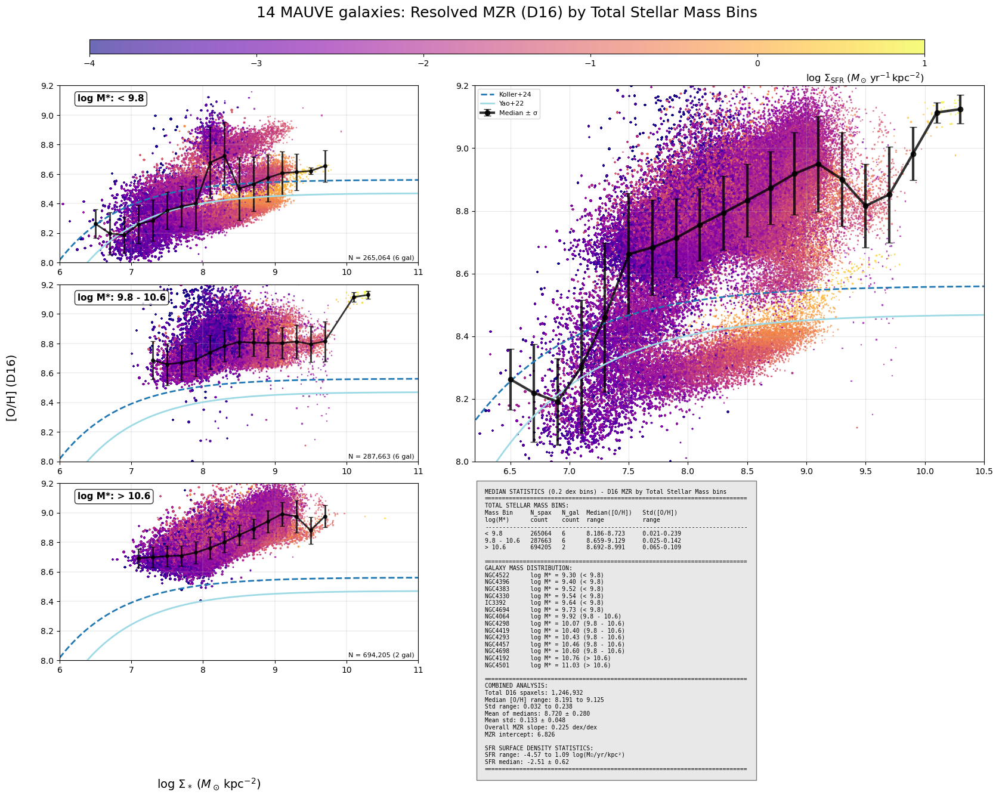

In [20]:
# ------------------------------------------------------------------
# COMPREHENSIVE LAYOUT: Mass-binned rMZR + Combined plot + Statistics (D16 MZR - SFR colored)
# 4-column layout: Cols 1-2 = Mass-binned MZR, Col 3 = Combined plot, Col 4 = Statistics
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from pathlib import Path
from astropy.io import fits
import itertools
import re  # Add this import for regex

# 0 · discover galaxies & colour palette
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)
assert ngal <= 14, "This layout assumes ≤ 14 galaxies."

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_d16 = h['O_H_D16_SF'].data
    return sigM, sigSFR, oh_d16

# Extraction functions for log files
def extract_total_stellar_mass(galaxy_name):
    """Extract total stellar mass from mass log file. Returns log10(M☉) value or None if not found."""
    log_file = Path(f'mass_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total stellar mass \(R\)\s*:\s*([\d.-]+)\s*log10\(M☉\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading mass log for {galaxy_name}: {e}")
        return None

def extract_total_sfr(galaxy_name):
    """Extract total SFR from SFR log file. Returns log10(M☉/yr) value or None if not found."""
    log_file = Path(f'sfr_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total Halpha SFR from SF region:.*?in log10 scale:\s*([\d.-]+)\s*log\(M☉/yr\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception:
        return None

def calculate_median_statistics(x, y, x_range=(6, 11), bin_width=0.2):
    """Calculate median and std in binned intervals"""
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    
    medians = []
    stds = []
    x_valid = []
    
    for i in range(len(x_bins) - 1):
        mask = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if len(np.unique(x[mask])) >= 10:  # Need at least 10 distinct x values
            y_bin = y[mask]
            medians.append(np.median(y_bin))
            stds.append(np.std(y_bin))
            x_valid.append(x_centers[i])
    
    return np.array(x_valid), np.array(medians), np.array(stds)

def plot_literature_mzr_fits(ax, show_legend=False):
    """Plot literature MZR fits on the given axis"""
    # Define x range for plotting literature fits
    x = np.linspace(6, 11, 100)
    
    # Yao+22
    # 12 + log(O/H) = a + b(log Σ* - c)e^(-(x-c))
    # Coefficients: a = 8.47, b = 0.0002, c = 12.36
    a1, b1, c1 = 8.47, 0.0002, 12.36
    y_yao22 = a1 + b1 * (x - c1) * np.exp(-(x - c1))

    # Koller+24
    # 12 + log(O/H) = a + b(log Σ* - c)exp(-(log Σ* - c))
    # Coefficients: a = 8.561, b = 0.0001, c = 12.7
    a2, b2, c2 = 8.561, 0.0001, 12.7
    y_koller24 = a2 + b2 * (x - c2) * np.exp(-(x - c2))

    # MZR literature data
    plot_data = [
        (y_koller24, 'Koller+24', '--'),
        (y_yao22, 'Yao+22', '-'),
    ]
    
    # Plot all literature fits
    colors = plt.cm.tab20(np.linspace(0, 1, len(plot_data)))
    for i, (y, label, linestyle) in enumerate(plot_data):
        if show_legend:
            ax.plot(x, y, label=label, linewidth=2, linestyle=linestyle, color=colors[i])
        else:
            ax.plot(x, y, linewidth=2, linestyle=linestyle, color=colors[i])

# 1 · Extract total stellar masses for each galaxy and collect data by mass bins
print("Extracting total stellar masses and collecting data...")
galaxy_masses = {}
for gal in galaxies:
    total_mass = extract_total_stellar_mass(gal)
    if total_mass is not None:
        galaxy_masses[gal] = total_mass
        print(f"{gal}: log M* = {total_mass:.2f}")
    else:
        print(f"{gal}: Could not extract total stellar mass")

# 2 · Define total stellar mass bins
mass_bin_edges = [-np.inf, 9.8, 10.6, np.inf]
mass_bin_labels = ['< 9.8', '9.8 - 10.6', '> 10.6']

print(f"\nTotal stellar mass bins defined: {len(mass_bin_labels)} bins")

# 3 · Collect data from galaxies in each mass bin
mass_binned_data = {i: {'x': [], 'y': [], 'sfr': [], 'galaxies': []} for i in range(len(mass_bin_labels))}

for gal in galaxies:
    if gal not in galaxy_masses:
        continue
    
    total_mass = galaxy_masses[gal]
    
    # Determine which mass bin this galaxy belongs to
    bin_idx = None
    for i in range(len(mass_bin_edges) - 1):
        if mass_bin_edges[i] < total_mass <= mass_bin_edges[i + 1]:
            bin_idx = i
            break
    
    if bin_idx is None:
        continue
    
    # Load data for this galaxy
    sigM, sigSFR, oh_d16 = load_maps(gal)
    good_d16 = np.isfinite(sigM) & np.isfinite(oh_d16) & np.isfinite(sigSFR)
    
    if np.any(good_d16):
        x_d16, y_d16, sfr_d16 = sigM[good_d16], oh_d16[good_d16], sigSFR[good_d16]
        mass_binned_data[bin_idx]['x'].extend(x_d16)
        mass_binned_data[bin_idx]['y'].extend(y_d16)
        mass_binned_data[bin_idx]['sfr'].extend(sfr_d16)
        mass_binned_data[bin_idx]['galaxies'].append(gal)

# Convert lists to arrays and print statistics
for i, label in enumerate(mass_bin_labels):
    mass_binned_data[i]['x'] = np.array(mass_binned_data[i]['x'])
    mass_binned_data[i]['y'] = np.array(mass_binned_data[i]['y'])
    mass_binned_data[i]['sfr'] = np.array(mass_binned_data[i]['sfr'])
    n_spax = len(mass_binned_data[i]['x'])
    n_gal = len(set(mass_binned_data[i]['galaxies']))
    print(f"  {label} log(M☉): {n_spax:,} spaxels from {n_gal} galaxies")

# Collect all data for combined plot
all_x = np.concatenate([mass_binned_data[i]['x'] for i in range(len(mass_bin_labels)) if len(mass_binned_data[i]['x']) > 0])
all_y = np.concatenate([mass_binned_data[i]['y'] for i in range(len(mass_bin_labels)) if len(mass_binned_data[i]['y']) > 0])
all_sfr = np.concatenate([mass_binned_data[i]['sfr'] for i in range(len(mass_bin_labels)) if len(mass_binned_data[i]['sfr']) > 0])

print(f"Total spaxels collected: {len(all_x):,}")

# 4 · Create comprehensive figure with 4-column layout
fig = plt.figure(figsize=(20, 16))
gs = GridSpec(nrows=8, ncols=4, figure=fig,
              width_ratios=[1, 1, 1.5, 1.5],  # Cols 3&4 slightly wider
              height_ratios=[0.5, 1, 1, 1, 1, 1, 1, 1],  # Row 0 for colorbar
              wspace=0.3, hspace=0.3)

scatter_for_cbar = None
bin_stats = []

# COLUMNS 1-2: Mass-binned MZR plots (each occupying 2x2 grid space)
subplot_positions = [
    (1, 3, 0, 2),    # bin 0: rows 1-2, cols 0-1
    (3, 5, 0, 2),    # bin 1: rows 3-4, cols 0-1  
    (5, 7, 0, 2)     # bin 2: rows 5-6, cols 0-1
]

for bin_idx in range(len(mass_bin_labels)):
    if len(mass_binned_data[bin_idx]['x']) == 0:
        print(f"Skipping bin {mass_bin_labels[bin_idx]}: no valid data points")
        continue
    
    if bin_idx >= len(subplot_positions):
        print(f"No subplot position defined for bin {bin_idx}")
        continue
    
    row_start, row_end, col_start, col_end = subplot_positions[bin_idx]
    axP = fig.add_subplot(gs[row_start:row_end, col_start:col_end])
    
    x_bin = mass_binned_data[bin_idx]['x']
    y_bin = mass_binned_data[bin_idx]['y']
    sfr_bin = mass_binned_data[bin_idx]['sfr']
    
    # Calculate median statistics for this bin
    x_median, y_median, y_std = calculate_median_statistics(x_bin, y_bin)
    bin_stats.append((mass_bin_labels[bin_idx], x_median, y_median, y_std, len(x_bin)))
    
    # Scatter plot colored by SFR surface density
    scatter = axP.scatter(x_bin, y_bin, c=sfr_bin, s=1, alpha=0.6, marker=',', 
                         cmap='plasma', vmin=-4, vmax=1)
    
    # Plot median with error bars
    if len(x_median) > 0:
        axP.errorbar(x_median, y_median, yerr=y_std, fmt='ko-', linewidth=2, 
                    markersize=4, capsize=3, alpha=0.8)
    
    if scatter_for_cbar is None:
        scatter_for_cbar = scatter
    
    # Add literature fits to individual panels (no legend)
    plot_literature_mzr_fits(axP, show_legend=False)
    
    # Add bin label in top left corner
    axP.text(0.05, 0.95, f'log M*: {mass_bin_labels[bin_idx]}', 
             transform=axP.transAxes, fontsize=11, fontweight='bold',
             va='top', ha='left', bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8, edgecolor='black'))
    
    # Bottom right: number of spaxels and galaxies
    n_gal = len(set(mass_binned_data[bin_idx]['galaxies']))
    axP.text(0.99, 0.01, f'N = {len(x_bin):,} ({n_gal} gal)',
             transform=axP.transAxes, va='bottom', ha='right', fontsize=8,
             bbox=dict(facecolor='none', alpha=0.8, edgecolor='none', pad=2))
    
    axP.set_xlim(6, 11)
    axP.set_ylim(8.0, 9.2)
    axP.grid(True, lw=0.25)

# COLUMNS 3-4: Combined plot - Upper panel
ax_combined = fig.add_subplot(gs[1:5, 2:4])  # Spans rows 1-4, columns 2-3

# Calculate combined median statistics
x_median_combined, y_median_combined, y_std_combined = calculate_median_statistics(all_x, all_y)

# Scatter plot colored by SFR surface density for combined data
scatter_combined = ax_combined.scatter(all_x, all_y, c=all_sfr, s=1, alpha=0.6, marker=',', 
                                      cmap='plasma', vmin=-4, vmax=1)

# Plot combined median with error bars
if len(x_median_combined) > 0:
    ax_combined.errorbar(x_median_combined, y_median_combined, yerr=y_std_combined, 
                        fmt='ko-', linewidth=3, markersize=6, capsize=4, alpha=0.8, label='Median ± σ')

# Add literature fits to combined panel (with legend)
plot_literature_mzr_fits(ax_combined, show_legend=True)

# Add legend with small font
ax_combined.legend(fontsize=8, ncol=1, loc='upper left')

ax_combined.set_xlim(6.2, 10.5)
ax_combined.set_ylim(8.0, 9.2)
ax_combined.grid(True, alpha=0.3)

# COLUMNS 3-4: Statistics table - Lower panel
ax_stats = fig.add_subplot(gs[5:8, 2:4])  # Spans rows 5-7, columns 2-3
ax_stats.axis('off')

# Create comprehensive statistics text
stats_table = "MEDIAN STATISTICS (0.2 dex bins) - D16 MZR by Total Stellar Mass bins\n"
stats_table += "="*75 + "\n"
stats_table += "TOTAL STELLAR MASS BINS:\n"
stats_table += f"{'Mass Bin':<12} {'N_spax':<8} {'N_gal':<6} {'Median([O/H])':<15} {'Std([O/H])':<15}\n"
stats_table += f"{'log(M*)':<12} {'count':<8} {'count':<6} {'range':<15} {'range':<15}\n"
stats_table += "-"*75 + "\n"

for i, (bin_label, x_median, y_median, y_std, n_spax) in enumerate(bin_stats):
    n_gal = len(set(mass_binned_data[i]['galaxies']))
    if len(y_median) > 0:
        median_range = f"{y_median.min():.3f}-{y_median.max():.3f}"
        std_range = f"{y_std.min():.3f}-{y_std.max():.3f}"
    else:
        median_range = "N/A"
        std_range = "N/A"
    
    stats_table += f"{bin_label:<12} {n_spax:<8} {n_gal:<6} {median_range:<15} {std_range:<15}\n"

stats_table += "\n" + "="*75 + "\n"
stats_table += "GALAXY MASS DISTRIBUTION:\n"
for gal, mass in sorted(galaxy_masses.items(), key=lambda x: x[1]):
    # Determine bin
    for i in range(len(mass_bin_edges) - 1):
        if mass_bin_edges[i] < mass <= mass_bin_edges[i + 1]:
            bin_label = mass_bin_labels[i]
            break
    stats_table += f"{gal:<12} log M* = {mass:.2f} ({bin_label})\n"

stats_table += "\n" + "="*75 + "\n"
stats_table += "COMBINED ANALYSIS:\n"
stats_table += f"Total D16 spaxels: {len(all_x):,}\n"
if len(y_median_combined) > 0:
    stats_table += f"Median [O/H] range: {y_median_combined.min():.3f} to {y_median_combined.max():.3f}\n"
    stats_table += f"Std range: {y_std_combined.min():.3f} to {y_std_combined.max():.3f}\n"
    stats_table += f"Mean of medians: {np.mean(y_median_combined):.3f} ± {np.std(y_median_combined):.3f}\n"
    stats_table += f"Mean std: {np.mean(y_std_combined):.3f} ± {np.std(y_std_combined):.3f}\n"
    
    # Calculate overall metallicity gradient (slope)
    if len(x_median_combined) > 3:
        slope, intercept = np.polyfit(x_median_combined, y_median_combined, 1)
        stats_table += f"Overall MZR slope: {slope:.3f} dex/dex\n"
        stats_table += f"MZR intercept: {intercept:.3f}\n"

# Add SFR statistics
stats_table += f"\nSFR SURFACE DENSITY STATISTICS:\n"
stats_table += f"SFR range: {all_sfr.min():.2f} to {all_sfr.max():.2f} log(M☉/yr/kpc²)\n"
stats_table += f"SFR median: {np.median(all_sfr):.2f} ± {np.std(all_sfr):.2f}\n"
        
stats_table += "="*75

ax_stats.text(0.02, 0.98, stats_table, transform=ax_stats.transAxes, va='top', ha='left',
              fontsize=7, family='monospace',
              bbox=dict(facecolor='lightgray', alpha=0.5, edgecolor='black', pad=10))

# Add horizontal colorbar at the top
if scatter_for_cbar is not None:
    cbar_ax = fig.add_axes([0.15, 0.85, 0.7, 0.015])
    cbar = plt.colorbar(scatter_for_cbar, cax=cbar_ax, orientation='horizontal')
    cbar.set_label(r'$\log\,\Sigma_{\mathrm{SFR}} \; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', fontsize=12, loc='right')

# Global title and labels
fig.suptitle(fr'{ngal} MAUVE galaxies: Resolved MZR (D16) by Total Stellar Mass Bins', 
             fontsize=18, y=0.90)

# Shared axis labels
fig.text(0.25, 0.08, r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', 
         ha='center', fontsize=14)
fig.text(0.08, 0.5, r'[O/H] (D16)', 
         va='center', rotation='vertical', fontsize=14)

plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])
plt.show()

Extracting total stellar masses and collecting data...
IC3392: log M* = 9.64
NGC4064: log M* = 9.92
NGC4192: log M* = 10.76
NGC4293: log M* = 10.43
NGC4298: log M* = 10.07
NGC4330: log M* = 9.54
NGC4383: log M* = 9.52
NGC4396: log M* = 9.40
NGC4419: log M* = 10.40
NGC4457: log M* = 10.46
NGC4501: log M* = 11.03
NGC4522: log M* = 9.30
NGC4694: log M* = 9.73
NGC4698: log M* = 10.60

Total stellar mass bins defined: 3 bins
  < 9.8 log(M☉): 264,761 spaxels from 6 galaxies
  9.8 - 10.6 log(M☉): 290,629 spaxels from 6 galaxies
  > 10.6 log(M☉): 694,230 spaxels from 2 galaxies
Total spaxels collected: 1,249,620


/var/folders/rm/clp89v210v32vh5vjt2kx7b80000gr/T/ipykernel_65174/2891331581.py:339: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])


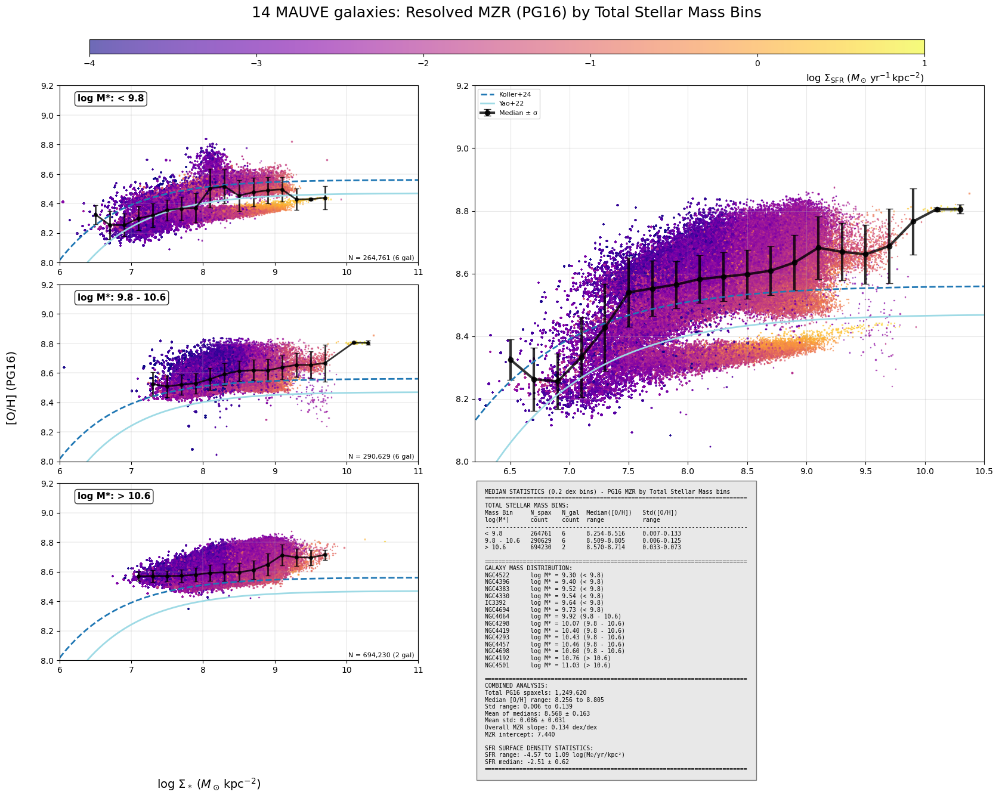

In [21]:
# ------------------------------------------------------------------
# COMPREHENSIVE LAYOUT: Mass-binned rMZR + Combined plot + Statistics (PG16 MZR - SFR colored)
# 4-column layout: Cols 1-2 = Mass-binned MZR, Col 3 = Combined plot, Col 4 = Statistics
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from pathlib import Path
from astropy.io import fits
import itertools
import re  # Add this import for regex

# 0 · discover galaxies & colour palette
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)
assert ngal <= 14, "This layout assumes ≤ 14 galaxies."

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_pg16 = h['O_H_PG16_SF'].data
    return sigM, sigSFR, oh_pg16

# Extraction functions for log files
def extract_total_stellar_mass(galaxy_name):
    """Extract total stellar mass from mass log file. Returns log10(M☉) value or None if not found."""
    log_file = Path(f'mass_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total stellar mass \(R\)\s*:\s*([\d.-]+)\s*log10\(M☉\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading mass log for {galaxy_name}: {e}")
        return None

def extract_total_sfr(galaxy_name):
    """Extract total SFR from SFR log file. Returns log10(M☉/yr) value or None if not found."""
    log_file = Path(f'sfr_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total Halpha SFR from SF region:.*?in log10 scale:\s*([\d.-]+)\s*log\(M☉/yr\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception:
        return None

def calculate_median_statistics(x, y, x_range=(6, 11), bin_width=0.2):
    """Calculate median and std in binned intervals"""
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    
    medians = []
    stds = []
    x_valid = []
    
    for i in range(len(x_bins) - 1):
        mask = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if len(np.unique(x[mask])) >= 10:  # Need at least 10 distinct x values
            y_bin = y[mask]
            medians.append(np.median(y_bin))
            stds.append(np.std(y_bin))
            x_valid.append(x_centers[i])
    
    return np.array(x_valid), np.array(medians), np.array(stds)

def plot_literature_mzr_fits(ax, show_legend=False):
    """Plot literature MZR fits on the given axis"""
    # Define x range for plotting literature fits
    x = np.linspace(6, 11, 100)
    
    # Yao+22
    # 12 + log(O/H) = a + b(log Σ* - c)e^(-(x-c))
    # Coefficients: a = 8.47, b = 0.0002, c = 12.36
    a1, b1, c1 = 8.47, 0.0002, 12.36
    y_yao22 = a1 + b1 * (x - c1) * np.exp(-(x - c1))

    # Koller+24
    # 12 + log(O/H) = a + b(log Σ* - c)exp(-(log Σ* - c))
    # Coefficients: a = 8.561, b = 0.0001, c = 12.7
    a2, b2, c2 = 8.561, 0.0001, 12.7
    y_koller24 = a2 + b2 * (x - c2) * np.exp(-(x - c2))

    # MZR literature data
    plot_data = [
        (y_koller24, 'Koller+24', '--'),
        (y_yao22, 'Yao+22', '-'),
    ]
    
    # Plot all literature fits
    colors = plt.cm.tab20(np.linspace(0, 1, len(plot_data)))
    for i, (y, label, linestyle) in enumerate(plot_data):
        if show_legend:
            ax.plot(x, y, label=label, linewidth=2, linestyle=linestyle, color=colors[i])
        else:
            ax.plot(x, y, linewidth=2, linestyle=linestyle, color=colors[i])

# 1 · Extract total stellar masses for each galaxy and collect data by mass bins
print("Extracting total stellar masses and collecting data...")
galaxy_masses = {}
for gal in galaxies:
    total_mass = extract_total_stellar_mass(gal)
    if total_mass is not None:
        galaxy_masses[gal] = total_mass
        print(f"{gal}: log M* = {total_mass:.2f}")
    else:
        print(f"{gal}: Could not extract total stellar mass")

# 2 · Define total stellar mass bins
mass_bin_edges = [-np.inf, 9.8, 10.6, np.inf]
mass_bin_labels = ['< 9.8', '9.8 - 10.6', '> 10.6']

print(f"\nTotal stellar mass bins defined: {len(mass_bin_labels)} bins")

# 3 · Collect data from galaxies in each mass bin
mass_binned_data = {i: {'x': [], 'y': [], 'sfr': [], 'galaxies': []} for i in range(len(mass_bin_labels))}

for gal in galaxies:
    if gal not in galaxy_masses:
        continue
    
    total_mass = galaxy_masses[gal]
    
    # Determine which mass bin this galaxy belongs to
    bin_idx = None
    for i in range(len(mass_bin_edges) - 1):
        if mass_bin_edges[i] < total_mass <= mass_bin_edges[i + 1]:
            bin_idx = i
            break
    
    if bin_idx is None:
        continue
    
    # Load data for this galaxy
    sigM, sigSFR, oh_pg16 = load_maps(gal)
    good_pg16 = np.isfinite(sigM) & np.isfinite(oh_pg16) & np.isfinite(sigSFR)
    
    if np.any(good_pg16):
        x_pg16, y_pg16, sfr_pg16 = sigM[good_pg16], oh_pg16[good_pg16], sigSFR[good_pg16]
        mass_binned_data[bin_idx]['x'].extend(x_pg16)
        mass_binned_data[bin_idx]['y'].extend(y_pg16)
        mass_binned_data[bin_idx]['sfr'].extend(sfr_pg16)
        mass_binned_data[bin_idx]['galaxies'].append(gal)

# Convert lists to arrays and print statistics
for i, label in enumerate(mass_bin_labels):
    mass_binned_data[i]['x'] = np.array(mass_binned_data[i]['x'])
    mass_binned_data[i]['y'] = np.array(mass_binned_data[i]['y'])
    mass_binned_data[i]['sfr'] = np.array(mass_binned_data[i]['sfr'])
    n_spax = len(mass_binned_data[i]['x'])
    n_gal = len(set(mass_binned_data[i]['galaxies']))
    print(f"  {label} log(M☉): {n_spax:,} spaxels from {n_gal} galaxies")

# Collect all data for combined plot
all_x = np.concatenate([mass_binned_data[i]['x'] for i in range(len(mass_bin_labels)) if len(mass_binned_data[i]['x']) > 0])
all_y = np.concatenate([mass_binned_data[i]['y'] for i in range(len(mass_bin_labels)) if len(mass_binned_data[i]['y']) > 0])
all_sfr = np.concatenate([mass_binned_data[i]['sfr'] for i in range(len(mass_bin_labels)) if len(mass_binned_data[i]['sfr']) > 0])

print(f"Total spaxels collected: {len(all_x):,}")

# 4 · Create comprehensive figure with 4-column layout
fig = plt.figure(figsize=(20, 16))
gs = GridSpec(nrows=8, ncols=4, figure=fig,
              width_ratios=[1, 1, 1.5, 1.5],  # Cols 3&4 slightly wider
              height_ratios=[0.5, 1, 1, 1, 1, 1, 1, 1],  # Row 0 for colorbar
              wspace=0.3, hspace=0.3)

scatter_for_cbar = None
bin_stats = []

# COLUMNS 1-2: Mass-binned MZR plots (each occupying 2x2 grid space)
subplot_positions = [
    (1, 3, 0, 2),    # bin 0: rows 1-2, cols 0-1
    (3, 5, 0, 2),    # bin 1: rows 3-4, cols 0-1  
    (5, 7, 0, 2)     # bin 2: rows 5-6, cols 0-1
]

for bin_idx in range(len(mass_bin_labels)):
    if len(mass_binned_data[bin_idx]['x']) == 0:
        print(f"Skipping bin {mass_bin_labels[bin_idx]}: no valid data points")
        continue
    
    if bin_idx >= len(subplot_positions):
        print(f"No subplot position defined for bin {bin_idx}")
        continue
    
    row_start, row_end, col_start, col_end = subplot_positions[bin_idx]
    axP = fig.add_subplot(gs[row_start:row_end, col_start:col_end])
    
    x_bin = mass_binned_data[bin_idx]['x']
    y_bin = mass_binned_data[bin_idx]['y']
    sfr_bin = mass_binned_data[bin_idx]['sfr']
    
    # Calculate median statistics for this bin
    x_median, y_median, y_std = calculate_median_statistics(x_bin, y_bin)
    bin_stats.append((mass_bin_labels[bin_idx], x_median, y_median, y_std, len(x_bin)))
    
    # Scatter plot colored by SFR surface density
    scatter = axP.scatter(x_bin, y_bin, c=sfr_bin, s=1, alpha=0.6, marker=',', 
                         cmap='plasma', vmin=-4, vmax=1)
    
    # Plot median with error bars
    if len(x_median) > 0:
        axP.errorbar(x_median, y_median, yerr=y_std, fmt='ko-', linewidth=2, 
                    markersize=4, capsize=3, alpha=0.8)
    
    if scatter_for_cbar is None:
        scatter_for_cbar = scatter
    
    # Add literature fits to individual panels (no legend)
    plot_literature_mzr_fits(axP, show_legend=False)
    
    # Add bin label in top left corner
    axP.text(0.05, 0.95, f'log M*: {mass_bin_labels[bin_idx]}', 
             transform=axP.transAxes, fontsize=11, fontweight='bold',
             va='top', ha='left', bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8, edgecolor='black'))
    
    # Bottom right: number of spaxels and galaxies
    n_gal = len(set(mass_binned_data[bin_idx]['galaxies']))
    axP.text(0.99, 0.01, f'N = {len(x_bin):,} ({n_gal} gal)',
             transform=axP.transAxes, va='bottom', ha='right', fontsize=8,
             bbox=dict(facecolor='none', alpha=0.8, edgecolor='none', pad=2))
    
    axP.set_xlim(6, 11)
    axP.set_ylim(8.0, 9.2)
    axP.grid(True, lw=0.25)

# COLUMNS 3-4: Combined plot - Upper panel
ax_combined = fig.add_subplot(gs[1:5, 2:4])  # Spans rows 1-4, columns 2-3

# Calculate combined median statistics
x_median_combined, y_median_combined, y_std_combined = calculate_median_statistics(all_x, all_y)

# Scatter plot colored by SFR surface density for combined data
scatter_combined = ax_combined.scatter(all_x, all_y, c=all_sfr, s=1, alpha=0.6, marker=',', 
                                      cmap='plasma', vmin=-4, vmax=1)

# Plot combined median with error bars
if len(x_median_combined) > 0:
    ax_combined.errorbar(x_median_combined, y_median_combined, yerr=y_std_combined, 
                        fmt='ko-', linewidth=3, markersize=6, capsize=4, alpha=0.8, label='Median ± σ')

# Add literature fits to combined panel (with legend)
plot_literature_mzr_fits(ax_combined, show_legend=True)

# Add legend with small font
ax_combined.legend(fontsize=8, ncol=1, loc='upper left')

ax_combined.set_xlim(6.2, 10.5)
ax_combined.set_ylim(8.0, 9.2)
ax_combined.grid(True, alpha=0.3)

# COLUMNS 3-4: Statistics table - Lower panel
ax_stats = fig.add_subplot(gs[5:8, 2:4])  # Spans rows 5-7, columns 2-3
ax_stats.axis('off')

# Create comprehensive statistics text
stats_table = "MEDIAN STATISTICS (0.2 dex bins) - PG16 MZR by Total Stellar Mass bins\n"
stats_table += "="*75 + "\n"
stats_table += "TOTAL STELLAR MASS BINS:\n"
stats_table += f"{'Mass Bin':<12} {'N_spax':<8} {'N_gal':<6} {'Median([O/H])':<15} {'Std([O/H])':<15}\n"
stats_table += f"{'log(M*)':<12} {'count':<8} {'count':<6} {'range':<15} {'range':<15}\n"
stats_table += "-"*75 + "\n"

for i, (bin_label, x_median, y_median, y_std, n_spax) in enumerate(bin_stats):
    n_gal = len(set(mass_binned_data[i]['galaxies']))
    if len(y_median) > 0:
        median_range = f"{y_median.min():.3f}-{y_median.max():.3f}"
        std_range = f"{y_std.min():.3f}-{y_std.max():.3f}"
    else:
        median_range = "N/A"
        std_range = "N/A"
    
    stats_table += f"{bin_label:<12} {n_spax:<8} {n_gal:<6} {median_range:<15} {std_range:<15}\n"

stats_table += "\n" + "="*75 + "\n"
stats_table += "GALAXY MASS DISTRIBUTION:\n"
for gal, mass in sorted(galaxy_masses.items(), key=lambda x: x[1]):
    # Determine bin
    for i in range(len(mass_bin_edges) - 1):
        if mass_bin_edges[i] < mass <= mass_bin_edges[i + 1]:
            bin_label = mass_bin_labels[i]
            break
    stats_table += f"{gal:<12} log M* = {mass:.2f} ({bin_label})\n"

stats_table += "\n" + "="*75 + "\n"
stats_table += "COMBINED ANALYSIS:\n"
stats_table += f"Total PG16 spaxels: {len(all_x):,}\n"
if len(y_median_combined) > 0:
    stats_table += f"Median [O/H] range: {y_median_combined.min():.3f} to {y_median_combined.max():.3f}\n"
    stats_table += f"Std range: {y_std_combined.min():.3f} to {y_std_combined.max():.3f}\n"
    stats_table += f"Mean of medians: {np.mean(y_median_combined):.3f} ± {np.std(y_median_combined):.3f}\n"
    stats_table += f"Mean std: {np.mean(y_std_combined):.3f} ± {np.std(y_std_combined):.3f}\n"
    
    # Calculate overall metallicity gradient (slope)
    if len(x_median_combined) > 3:
        slope, intercept = np.polyfit(x_median_combined, y_median_combined, 1)
        stats_table += f"Overall MZR slope: {slope:.3f} dex/dex\n"
        stats_table += f"MZR intercept: {intercept:.3f}\n"

# Add SFR statistics
stats_table += f"\nSFR SURFACE DENSITY STATISTICS:\n"
stats_table += f"SFR range: {all_sfr.min():.2f} to {all_sfr.max():.2f} log(M☉/yr/kpc²)\n"
stats_table += f"SFR median: {np.median(all_sfr):.2f} ± {np.std(all_sfr):.2f}\n"
        
stats_table += "="*75

ax_stats.text(0.02, 0.98, stats_table, transform=ax_stats.transAxes, va='top', ha='left',
              fontsize=7, family='monospace',
              bbox=dict(facecolor='lightgray', alpha=0.5, edgecolor='black', pad=10))

# Add horizontal colorbar at the top
if scatter_for_cbar is not None:
    cbar_ax = fig.add_axes([0.15, 0.85, 0.7, 0.015])
    cbar = plt.colorbar(scatter_for_cbar, cax=cbar_ax, orientation='horizontal')
    cbar.set_label(r'$\log\,\Sigma_{\mathrm{SFR}} \; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', fontsize=12, loc='right')

# Global title and labels
fig.suptitle(fr'{ngal} MAUVE galaxies: Resolved MZR (PG16) by Total Stellar Mass Bins', 
             fontsize=18, y=0.90)

# Shared axis labels
fig.text(0.25, 0.08, r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', 
         ha='center', fontsize=14)
fig.text(0.08, 0.5, r'[O/H] (PG16)', 
         va='center', rotation='vertical', fontsize=14)

plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])
plt.show()

Extracting total stellar masses and collecting data...
IC3392: log M* = 9.64
NGC4064: log M* = 9.92
NGC4192: log M* = 10.76
NGC4293: log M* = 10.43
NGC4298: log M* = 10.07
NGC4330: log M* = 9.54
NGC4383: log M* = 9.52
NGC4396: log M* = 9.40
NGC4419: log M* = 10.40
NGC4457: log M* = 10.46
NGC4501: log M* = 11.03
NGC4522: log M* = 9.30
NGC4694: log M* = 9.73
NGC4698: log M* = 10.60

Total stellar mass bins defined: 3 bins
  < 9.8 log(M☉): 265,064 spaxels from 6 galaxies
  9.8 - 10.6 log(M☉): 287,663 spaxels from 6 galaxies
  > 10.6 log(M☉): 694,205 spaxels from 2 galaxies
Total spaxels collected: 1,246,932


/var/folders/rm/clp89v210v32vh5vjt2kx7b80000gr/T/ipykernel_65174/842736797.py:369: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])


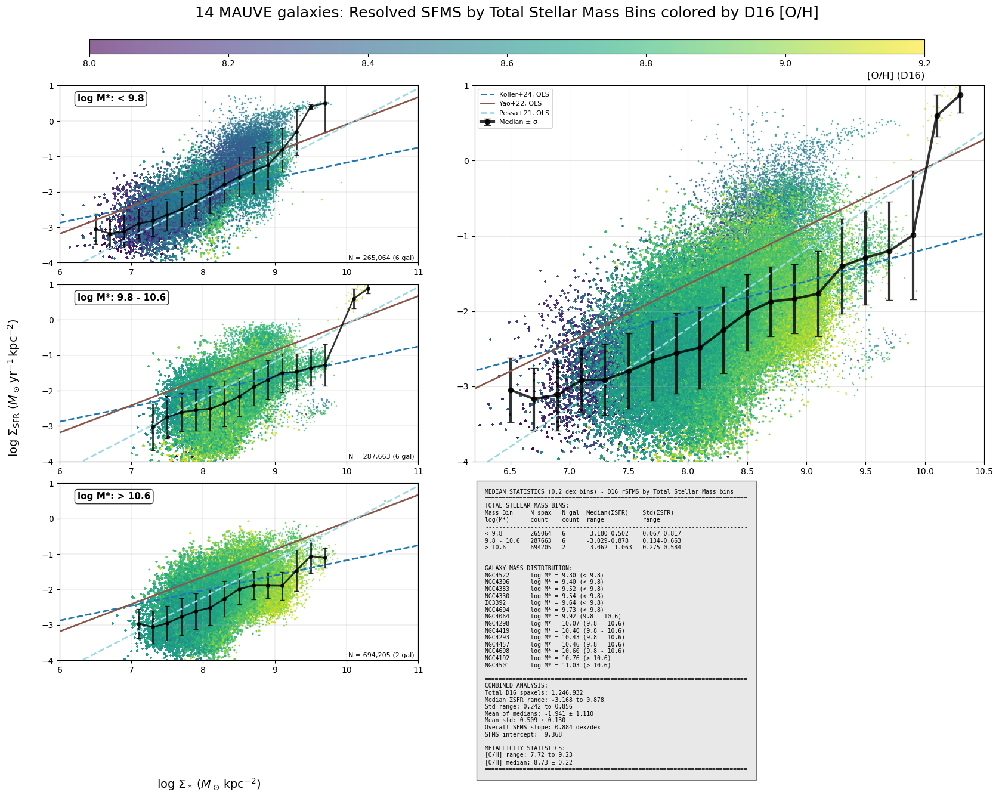

In [22]:
# ------------------------------------------------------------------
# COMPREHENSIVE LAYOUT: Mass-binned rSFMS + Combined plot + Statistics (D16 [O/H] colored)
# 4-column layout: Cols 1-2 = Mass-binned SFMS, Col 3 = Combined plot, Col 4 = Statistics
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from pathlib import Path
from astropy.io import fits
import itertools
import re  # Add this import for regex

# 0 · discover galaxies & colour palette
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)
assert ngal <= 14, "This layout assumes ≤ 14 galaxies."

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_d16 = h['O_H_D16_SF'].data
    return sigM, sigSFR, oh_d16

# Extraction functions for log files
def extract_total_stellar_mass(galaxy_name):
    """Extract total stellar mass from mass log file. Returns log10(M☉) value or None if not found."""
    log_file = Path(f'mass_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total stellar mass \(R\)\s*:\s*([\d.-]+)\s*log10\(M☉\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading mass log for {galaxy_name}: {e}")
        return None

def extract_total_sfr(galaxy_name):
    """Extract total SFR from SFR log file. Returns log10(M☉/yr) value or None if not found."""
    log_file = Path(f'sfr_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total Halpha SFR from SF region:.*?in log10 scale:\s*([\d.-]+)\s*log\(M☉/yr\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception:
        return None

def calculate_median_statistics(x, y, x_range=(6, 11), bin_width=0.2):
    """Calculate median and std in binned intervals"""
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    
    medians = []
    stds = []
    x_valid = []
    
    for i in range(len(x_bins) - 1):
        mask = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if len(np.unique(x[mask])) >= 10:  # Need at least 10 distinct x values
            y_bin = y[mask]
            medians.append(np.median(y_bin))
            stds.append(np.std(y_bin))
            x_valid.append(x_centers[i])
    
    return np.array(x_valid), np.array(medians), np.array(stds)

def plot_literature_sfms_fits(ax, show_legend=False):
    """Plot literature Star Formation Main Sequence fits on the given axis"""
    # Define x range for plotting literature fits
    x = np.linspace(6, 11, 100)
    
    # Kennicutt-Schmidt relation for resolved studies
    # log ΣSFR = α × log Σ* + β
    
    # Literature SFMS fits with slope and intercept parameters
    plot_data = [
        # Reference 1: This work (SF-spaxels), OLS
        (0.425, -5.428, 'Koller+24, OLS', '--'),
        # # Reference 1: This work (SF-spaxels), ODR  
        # (1.162, -11.014, 'Koller+24, ODR', '--'),
        # # # Reference 2: This work (spectral decomposition), OLS
        # # (0.401, -5.615, 'Koller+24, OLS (spectral)', '--'),
        # # # Reference 2: This work (spectral decomposition), ODR
        # # (2.562, -22.248, 'Koller+24, ODR (spectral)', '--'),
        # # Reference 3: Cano-Díaz et al. (2016)
        # (0.72, -7.95, 'Cano-Díaz+16', '-'),
        # # Reference 4: Hsieh et al. (2017), OLS
        # (0.715, -8.056, 'Hsieh+17, OLS', '-'),
        # # Reference 4: Hsieh et al. (2017), ODR
        # (1.005, -10.338, 'Hsieh+17, ODR', '-'),
        # Reference 5: Yao et al. (2022), OLS
        (0.771, -7.812, 'Yao+22, OLS', '-'),
        # # Reference 6: Mun et al. (2024), LTS
        # (0.918, -9.196, 'Mun+24, LTS', '--'),
        # # Reference 7: Jafariyazani et al. (2019), OLS
        # (0.43, -5.66, 'Jafariyazani+19, OLS', '-'),
        # # Reference 8: Wuyts et al. (2013)
        # (0.95, -8.4, 'Wuyts+13', '-'), 
        # # Vulcani et al. (2020) - stripping sample
        # (1.641, -14.79, 'Vulcani+20, PyStan (stripping)', '--'),
        # # Vulcani et al. (2020) - control sample
        # (1.659, -15.28, 'Vulcani+20, PyStan (control)', '--'),
        # Pessa et al. (2021) - OLS
        (1.05, -10.63, 'Pessa+21, OLS', '--'),
        # # Ellison et al. (2021) - OLS
        # (0.68, -7.38, 'Ellison+21, OLS', '--'),
        # # Ellison et al. (2021) - ODR
        # (1.37, -13.12, 'Ellison+21, ODR', '--')
    ]
    
    # Generate literature fits using the new format (slope, intercept, label, linestyle)
    literature_fits = []
    for slope, intercept, label, linestyle in plot_data:
        y_lit = slope * x + intercept
        literature_fits.append((y_lit, label, linestyle))
    
    plot_data = literature_fits
    
    # Plot all literature fits
    colors = plt.cm.tab20(np.linspace(0, 1, len(plot_data)))
    for i, (y, label, linestyle) in enumerate(plot_data):
        if show_legend:
            ax.plot(x, y, label=label, linewidth=2, linestyle=linestyle, color=colors[i])
        else:
            ax.plot(x, y, linewidth=2, linestyle=linestyle, color=colors[i])

# 1 · Extract total stellar masses for each galaxy and collect data by mass bins
print("Extracting total stellar masses and collecting data...")
galaxy_masses = {}
for gal in galaxies:
    total_mass = extract_total_stellar_mass(gal)
    if total_mass is not None:
        galaxy_masses[gal] = total_mass
        print(f"{gal}: log M* = {total_mass:.2f}")
    else:
        print(f"{gal}: Could not extract total stellar mass")

# 2 · Define total stellar mass bins
mass_bin_edges = [-np.inf, 9.8, 10.6, np.inf]
mass_bin_labels = ['< 9.8', '9.8 - 10.6', '> 10.6']

print(f"\nTotal stellar mass bins defined: {len(mass_bin_labels)} bins")

# 3 · Collect data from galaxies in each mass bin
mass_binned_data = {i: {'x': [], 'y': [], 'metallicity': [], 'galaxies': []} for i in range(len(mass_bin_labels))}

for gal in galaxies:
    if gal not in galaxy_masses:
        continue
    
    total_mass = galaxy_masses[gal]
    
    # Determine which mass bin this galaxy belongs to
    bin_idx = None
    for i in range(len(mass_bin_edges) - 1):
        if mass_bin_edges[i] < total_mass <= mass_bin_edges[i + 1]:
            bin_idx = i
            break
    
    if bin_idx is None:
        continue
    
    # Load data for this galaxy
    sigM, sigSFR, oh_d16 = load_maps(gal)
    good_d16 = np.isfinite(sigM) & np.isfinite(oh_d16) & np.isfinite(sigSFR)
    
    if np.any(good_d16):
        # For SFMS: x = stellar mass surface density, y = SFR surface density
        x_d16, y_d16, met_d16 = sigM[good_d16], sigSFR[good_d16], oh_d16[good_d16]
        mass_binned_data[bin_idx]['x'].extend(x_d16)
        mass_binned_data[bin_idx]['y'].extend(y_d16)
        mass_binned_data[bin_idx]['metallicity'].extend(met_d16)
        mass_binned_data[bin_idx]['galaxies'].append(gal)

# Convert lists to arrays and print statistics
for i, label in enumerate(mass_bin_labels):
    mass_binned_data[i]['x'] = np.array(mass_binned_data[i]['x'])
    mass_binned_data[i]['y'] = np.array(mass_binned_data[i]['y'])
    mass_binned_data[i]['metallicity'] = np.array(mass_binned_data[i]['metallicity'])
    n_spax = len(mass_binned_data[i]['x'])
    n_gal = len(set(mass_binned_data[i]['galaxies']))
    print(f"  {label} log(M☉): {n_spax:,} spaxels from {n_gal} galaxies")

# Collect all data for combined plot
all_x = np.concatenate([mass_binned_data[i]['x'] for i in range(len(mass_bin_labels)) if len(mass_binned_data[i]['x']) > 0])
all_y = np.concatenate([mass_binned_data[i]['y'] for i in range(len(mass_bin_labels)) if len(mass_binned_data[i]['y']) > 0])
all_metallicity = np.concatenate([mass_binned_data[i]['metallicity'] for i in range(len(mass_bin_labels)) if len(mass_binned_data[i]['metallicity']) > 0])

print(f"Total spaxels collected: {len(all_x):,}")

# 4 · Create comprehensive figure with 4-column layout
fig = plt.figure(figsize=(20, 16))
gs = GridSpec(nrows=8, ncols=4, figure=fig,
              width_ratios=[1, 1, 1.5, 1.5],  # Cols 3&4 slightly wider
              height_ratios=[0.5, 1, 1, 1, 1, 1, 1, 1],  # Row 0 for colorbar
              wspace=0.3, hspace=0.3)

scatter_for_cbar = None
bin_stats = []

# COLUMNS 1-2: Mass-binned SFMS plots (each occupying 2x2 grid space)
subplot_positions = [
    (1, 3, 0, 2),    # bin 0: rows 1-2, cols 0-1
    (3, 5, 0, 2),    # bin 1: rows 3-4, cols 0-1  
    (5, 7, 0, 2)     # bin 2: rows 5-6, cols 0-1
]

for bin_idx in range(len(mass_bin_labels)):
    if len(mass_binned_data[bin_idx]['x']) == 0:
        print(f"Skipping bin {mass_bin_labels[bin_idx]}: no valid data points")
        continue
    
    if bin_idx >= len(subplot_positions):
        print(f"No subplot position defined for bin {bin_idx}")
        continue
    
    row_start, row_end, col_start, col_end = subplot_positions[bin_idx]
    axP = fig.add_subplot(gs[row_start:row_end, col_start:col_end])
    
    x_bin = mass_binned_data[bin_idx]['x']
    y_bin = mass_binned_data[bin_idx]['y']
    met_bin = mass_binned_data[bin_idx]['metallicity']
    
    # Calculate median statistics for this bin
    x_median, y_median, y_std = calculate_median_statistics(x_bin, y_bin)
    bin_stats.append((mass_bin_labels[bin_idx], x_median, y_median, y_std, len(x_bin)))
    
    # Scatter plot colored by D16 metallicity
    scatter = axP.scatter(x_bin, y_bin, c=met_bin, s=1, alpha=0.6, marker=',', 
                         cmap='viridis', vmin=8.0, vmax=9.2)
    
    # Plot median with error bars
    if len(x_median) > 0:
        axP.errorbar(x_median, y_median, yerr=y_std, fmt='ko-', linewidth=2, 
                    markersize=4, capsize=3, alpha=0.8)
    
    if scatter_for_cbar is None:
        scatter_for_cbar = scatter
    
    # Add literature fits to individual panels (no legend)
    plot_literature_sfms_fits(axP, show_legend=False)
    
    # Add bin label in top left corner
    axP.text(0.05, 0.95, f'log M*: {mass_bin_labels[bin_idx]}', 
             transform=axP.transAxes, fontsize=11, fontweight='bold',
             va='top', ha='left', bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8, edgecolor='black'))
    
    # Bottom right: number of spaxels and galaxies
    n_gal = len(set(mass_binned_data[bin_idx]['galaxies']))
    axP.text(0.99, 0.01, f'N = {len(x_bin):,} ({n_gal} gal)',
             transform=axP.transAxes, va='bottom', ha='right', fontsize=8,
             bbox=dict(facecolor='none', alpha=0.8, edgecolor='none', pad=2))
    
    axP.set_xlim(6, 11)
    axP.set_ylim(-4, 1)  # Typical SFR surface density range
    axP.grid(True, lw=0.25)

# COLUMNS 3-4: Combined plot - Upper panel
ax_combined = fig.add_subplot(gs[1:5, 2:4])  # Spans rows 1-4, columns 2-3

# Calculate combined median statistics
x_median_combined, y_median_combined, y_std_combined = calculate_median_statistics(all_x, all_y)

# Scatter plot colored by D16 metallicity for combined data
scatter_combined = ax_combined.scatter(all_x, all_y, c=all_metallicity, s=1, alpha=0.6, marker=',', 
                                      cmap='viridis', vmin=8.0, vmax=9.2)

# Plot combined median with error bars
if len(x_median_combined) > 0:
    ax_combined.errorbar(x_median_combined, y_median_combined, yerr=y_std_combined, 
                        fmt='ko-', linewidth=3, markersize=6, capsize=4, alpha=0.8, label='Median ± σ')

# Add literature fits to combined panel (with legend)
plot_literature_sfms_fits(ax_combined, show_legend=True)

# Add legend with small font
ax_combined.legend(fontsize=8, ncol=1, loc='upper left')

ax_combined.set_xlim(6.2, 10.5)
ax_combined.set_ylim(-4, 1)
ax_combined.grid(True, alpha=0.3)

# COLUMNS 3-4: Statistics table - Lower panel
ax_stats = fig.add_subplot(gs[5:8, 2:4])  # Spans rows 5-7, columns 2-3
ax_stats.axis('off')

# Create comprehensive statistics text
stats_table = "MEDIAN STATISTICS (0.2 dex bins) - D16 rSFMS by Total Stellar Mass bins\n"
stats_table += "="*75 + "\n"
stats_table += "TOTAL STELLAR MASS BINS:\n"
stats_table += f"{'Mass Bin':<12} {'N_spax':<8} {'N_gal':<6} {'Median(ΣSFR)':<15} {'Std(ΣSFR)':<15}\n"
stats_table += f"{'log(M*)':<12} {'count':<8} {'count':<6} {'range':<15} {'range':<15}\n"
stats_table += "-"*75 + "\n"

for i, (bin_label, x_median, y_median, y_std, n_spax) in enumerate(bin_stats):
    n_gal = len(set(mass_binned_data[i]['galaxies']))
    if len(y_median) > 0:
        median_range = f"{y_median.min():.3f}-{y_median.max():.3f}"
        std_range = f"{y_std.min():.3f}-{y_std.max():.3f}"
    else:
        median_range = "N/A"
        std_range = "N/A"
    
    stats_table += f"{bin_label:<12} {n_spax:<8} {n_gal:<6} {median_range:<15} {std_range:<15}\n"

stats_table += "\n" + "="*75 + "\n"
stats_table += "GALAXY MASS DISTRIBUTION:\n"
for gal, mass in sorted(galaxy_masses.items(), key=lambda x: x[1]):
    # Determine bin
    for i in range(len(mass_bin_edges) - 1):
        if mass_bin_edges[i] < mass <= mass_bin_edges[i + 1]:
            bin_label = mass_bin_labels[i]
            break
    stats_table += f"{gal:<12} log M* = {mass:.2f} ({bin_label})\n"

stats_table += "\n" + "="*75 + "\n"
stats_table += "COMBINED ANALYSIS:\n"
stats_table += f"Total D16 spaxels: {len(all_x):,}\n"
if len(y_median_combined) > 0:
    stats_table += f"Median ΣSFR range: {y_median_combined.min():.3f} to {y_median_combined.max():.3f}\n"
    stats_table += f"Std range: {y_std_combined.min():.3f} to {y_std_combined.max():.3f}\n"
    stats_table += f"Mean of medians: {np.mean(y_median_combined):.3f} ± {np.std(y_median_combined):.3f}\n"
    stats_table += f"Mean std: {np.mean(y_std_combined):.3f} ± {np.std(y_std_combined):.3f}\n"
    
    # Calculate overall SFMS gradient (slope)
    if len(x_median_combined) > 3:
        slope, intercept = np.polyfit(x_median_combined, y_median_combined, 1)
        stats_table += f"Overall SFMS slope: {slope:.3f} dex/dex\n"
        stats_table += f"SFMS intercept: {intercept:.3f}\n"

# Add metallicity statistics
stats_table += f"\nMETALLICITY STATISTICS:\n"
stats_table += f"[O/H] range: {all_metallicity.min():.2f} to {all_metallicity.max():.2f}\n"
stats_table += f"[O/H] median: {np.median(all_metallicity):.2f} ± {np.std(all_metallicity):.2f}\n"
        
stats_table += "="*75

ax_stats.text(0.02, 0.98, stats_table, transform=ax_stats.transAxes, va='top', ha='left',
              fontsize=7, family='monospace',
              bbox=dict(facecolor='lightgray', alpha=0.5, edgecolor='black', pad=10))

# Add horizontal colorbar at the top
if scatter_for_cbar is not None:
    cbar_ax = fig.add_axes([0.15, 0.85, 0.7, 0.015])
    cbar = plt.colorbar(scatter_for_cbar, cax=cbar_ax, orientation='horizontal')
    cbar.set_label(r'[O/H] (D16)', fontsize=12, loc='right')

# Global title and labels
fig.suptitle(fr'{ngal} MAUVE galaxies: Resolved SFMS by Total Stellar Mass Bins colored by D16 [O/H]', 
             fontsize=18, y=0.90)

# Shared axis labels
fig.text(0.25, 0.08, r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', 
         ha='center', fontsize=14)
fig.text(0.08, 0.5, r'$\log\,\Sigma_{\mathrm{SFR}} \; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', 
         va='center', rotation='vertical', fontsize=14)

plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])
plt.show()

Extracting total stellar masses and collecting data...
IC3392: log M* = 9.64
NGC4064: log M* = 9.92
NGC4192: log M* = 10.76
NGC4293: log M* = 10.43
NGC4298: log M* = 10.07
NGC4330: log M* = 9.54
NGC4383: log M* = 9.52
NGC4396: log M* = 9.40
NGC4419: log M* = 10.40
NGC4457: log M* = 10.46
NGC4501: log M* = 11.03
NGC4522: log M* = 9.30
NGC4694: log M* = 9.73
NGC4698: log M* = 10.60

Total stellar mass bins defined: 3 bins
  < 9.8 log(M☉): 264,761 spaxels from 6 galaxies
  9.8 - 10.6 log(M☉): 290,629 spaxels from 6 galaxies
  > 10.6 log(M☉): 694,230 spaxels from 2 galaxies
Total spaxels collected: 1,249,620


/var/folders/rm/clp89v210v32vh5vjt2kx7b80000gr/T/ipykernel_65174/4010203847.py:369: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])


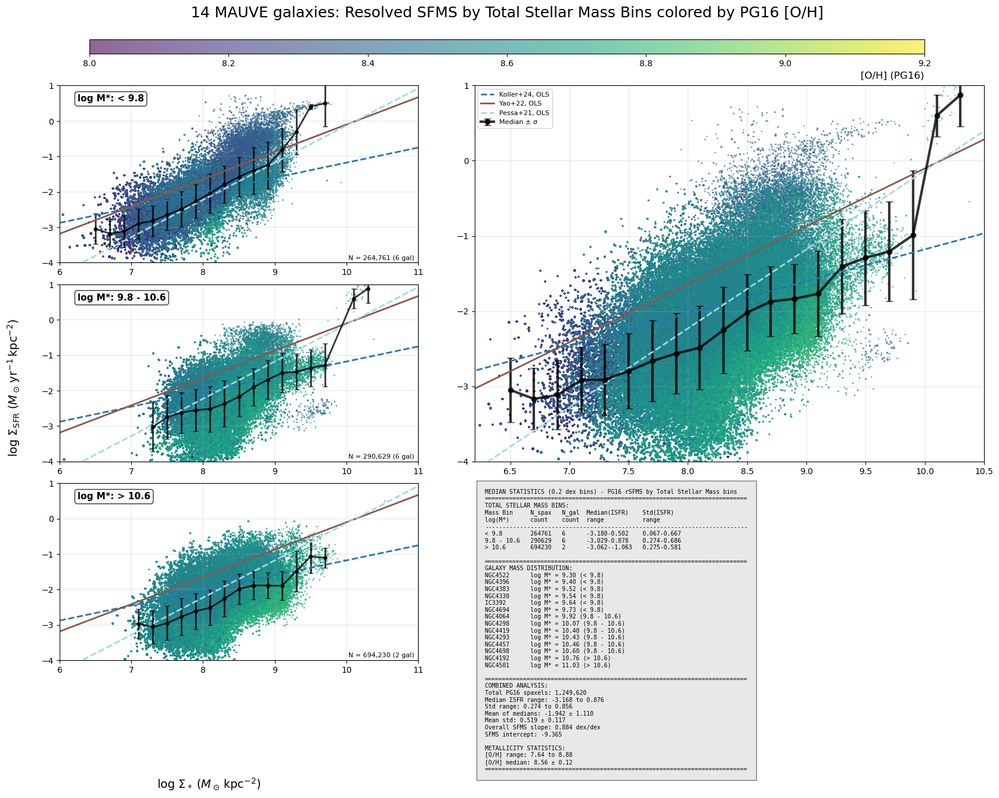

In [23]:
# ------------------------------------------------------------------
# COMPREHENSIVE LAYOUT: Mass-binned rSFMS + Combined plot + Statistics (PG16 [O/H] colored)
# 4-column layout: Cols 1-2 = Mass-binned SFMS, Col 3 = Combined plot, Col 4 = Statistics
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from pathlib import Path
from astropy.io import fits
import itertools
import re  # Add this import for regex

# 0 · discover galaxies & colour palette
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)
assert ngal <= 14, "This layout assumes ≤ 14 galaxies."

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_pg16 = h['O_H_PG16_SF'].data
    return sigM, sigSFR, oh_pg16

# Extraction functions for log files
def extract_total_stellar_mass(galaxy_name):
    """Extract total stellar mass from mass log file. Returns log10(M☉) value or None if not found."""
    log_file = Path(f'mass_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total stellar mass \(R\)\s*:\s*([\d.-]+)\s*log10\(M☉\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading mass log for {galaxy_name}: {e}")
        return None

def extract_total_sfr(galaxy_name):
    """Extract total SFR from SFR log file. Returns log10(M☉/yr) value or None if not found."""
    log_file = Path(f'sfr_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total Halpha SFR from SF region:.*?in log10 scale:\s*([\d.-]+)\s*log\(M☉/yr\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception:
        return None

def calculate_median_statistics(x, y, x_range=(6, 11), bin_width=0.2):
    """Calculate median and std in binned intervals"""
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    
    medians = []
    stds = []
    x_valid = []
    
    for i in range(len(x_bins) - 1):
        mask = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if len(np.unique(x[mask])) >= 10:  # Need at least 10 distinct x values
            y_bin = y[mask]
            medians.append(np.median(y_bin))
            stds.append(np.std(y_bin))
            x_valid.append(x_centers[i])
    
    return np.array(x_valid), np.array(medians), np.array(stds)

def plot_literature_sfms_fits(ax, show_legend=False):
    """Plot literature Star Formation Main Sequence fits on the given axis"""
    # Define x range for plotting literature fits
    x = np.linspace(6, 11, 100)
    
    # Kennicutt-Schmidt relation for resolved studies
    # log ΣSFR = α × log Σ* + β
    
    # Literature SFMS fits with slope and intercept parameters
    plot_data = [
        # Reference 1: This work (SF-spaxels), OLS
        (0.425, -5.428, 'Koller+24, OLS', '--'),
        # # Reference 1: This work (SF-spaxels), ODR  
        # (1.162, -11.014, 'Koller+24, ODR', '--'),
        # # # Reference 2: This work (spectral decomposition), OLS
        # # (0.401, -5.615, 'Koller+24, OLS (spectral)', '--'),
        # # # Reference 2: This work (spectral decomposition), ODR
        # # (2.562, -22.248, 'Koller+24, ODR (spectral)', '--'),
        # # Reference 3: Cano-Díaz et al. (2016)
        # (0.72, -7.95, 'Cano-Díaz+16', '-'),
        # # Reference 4: Hsieh et al. (2017), OLS
        # (0.715, -8.056, 'Hsieh+17, OLS', '-'),
        # # Reference 4: Hsieh et al. (2017), ODR
        # (1.005, -10.338, 'Hsieh+17, ODR', '-'),
        # Reference 5: Yao et al. (2022), OLS
        (0.771, -7.812, 'Yao+22, OLS', '-'),
        # # Reference 6: Mun et al. (2024), LTS
        # (0.918, -9.196, 'Mun+24, LTS', '--'),
        # # Reference 7: Jafariyazani et al. (2019), OLS
        # (0.43, -5.66, 'Jafariyazani+19, OLS', '-'),
        # # Reference 8: Wuyts et al. (2013)
        # (0.95, -8.4, 'Wuyts+13', '-'), 
        # # Vulcani et al. (2020) - stripping sample
        # (1.641, -14.79, 'Vulcani+20, PyStan (stripping)', '--'),
        # # Vulcani et al. (2020) - control sample
        # (1.659, -15.28, 'Vulcani+20, PyStan (control)', '--'),
        # Pessa et al. (2021) - OLS
        (1.05, -10.63, 'Pessa+21, OLS', '--'),
        # # Ellison et al. (2021) - OLS
        # (0.68, -7.38, 'Ellison+21, OLS', '--'),
        # # Ellison et al. (2021) - ODR
        # (1.37, -13.12, 'Ellison+21, ODR', '--')
    ]
    
    # Generate literature fits using the new format (slope, intercept, label, linestyle)
    literature_fits = []
    for slope, intercept, label, linestyle in plot_data:
        y_lit = slope * x + intercept
        literature_fits.append((y_lit, label, linestyle))
    
    plot_data = literature_fits
    
    # Plot all literature fits
    colors = plt.cm.tab20(np.linspace(0, 1, len(plot_data)))
    for i, (y, label, linestyle) in enumerate(plot_data):
        if show_legend:
            ax.plot(x, y, label=label, linewidth=2, linestyle=linestyle, color=colors[i])
        else:
            ax.plot(x, y, linewidth=2, linestyle=linestyle, color=colors[i])

# 1 · Extract total stellar masses for each galaxy and collect data by mass bins
print("Extracting total stellar masses and collecting data...")
galaxy_masses = {}
for gal in galaxies:
    total_mass = extract_total_stellar_mass(gal)
    if total_mass is not None:
        galaxy_masses[gal] = total_mass
        print(f"{gal}: log M* = {total_mass:.2f}")
    else:
        print(f"{gal}: Could not extract total stellar mass")

# 2 · Define total stellar mass bins
mass_bin_edges = [-np.inf, 9.8, 10.6, np.inf]
mass_bin_labels = ['< 9.8', '9.8 - 10.6', '> 10.6']

print(f"\nTotal stellar mass bins defined: {len(mass_bin_labels)} bins")

# 3 · Collect data from galaxies in each mass bin
mass_binned_data = {i: {'x': [], 'y': [], 'metallicity': [], 'galaxies': []} for i in range(len(mass_bin_labels))}

for gal in galaxies:
    if gal not in galaxy_masses:
        continue
    
    total_mass = galaxy_masses[gal]
    
    # Determine which mass bin this galaxy belongs to
    bin_idx = None
    for i in range(len(mass_bin_edges) - 1):
        if mass_bin_edges[i] < total_mass <= mass_bin_edges[i + 1]:
            bin_idx = i
            break
    
    if bin_idx is None:
        continue
    
    # Load data for this galaxy
    sigM, sigSFR, oh_pg16 = load_maps(gal)
    good_pg16 = np.isfinite(sigM) & np.isfinite(oh_pg16) & np.isfinite(sigSFR)
    
    if np.any(good_pg16):
        # For SFMS: x = stellar mass surface density, y = SFR surface density
        x_pg16, y_pg16, met_pg16 = sigM[good_pg16], sigSFR[good_pg16], oh_pg16[good_pg16]
        mass_binned_data[bin_idx]['x'].extend(x_pg16)
        mass_binned_data[bin_idx]['y'].extend(y_pg16)
        mass_binned_data[bin_idx]['metallicity'].extend(met_pg16)
        mass_binned_data[bin_idx]['galaxies'].append(gal)

# Convert lists to arrays and print statistics
for i, label in enumerate(mass_bin_labels):
    mass_binned_data[i]['x'] = np.array(mass_binned_data[i]['x'])
    mass_binned_data[i]['y'] = np.array(mass_binned_data[i]['y'])
    mass_binned_data[i]['metallicity'] = np.array(mass_binned_data[i]['metallicity'])
    n_spax = len(mass_binned_data[i]['x'])
    n_gal = len(set(mass_binned_data[i]['galaxies']))
    print(f"  {label} log(M☉): {n_spax:,} spaxels from {n_gal} galaxies")

# Collect all data for combined plot
all_x = np.concatenate([mass_binned_data[i]['x'] for i in range(len(mass_bin_labels)) if len(mass_binned_data[i]['x']) > 0])
all_y = np.concatenate([mass_binned_data[i]['y'] for i in range(len(mass_bin_labels)) if len(mass_binned_data[i]['y']) > 0])
all_metallicity = np.concatenate([mass_binned_data[i]['metallicity'] for i in range(len(mass_bin_labels)) if len(mass_binned_data[i]['metallicity']) > 0])

print(f"Total spaxels collected: {len(all_x):,}")

# 4 · Create comprehensive figure with 4-column layout
fig = plt.figure(figsize=(20, 16))
gs = GridSpec(nrows=8, ncols=4, figure=fig,
              width_ratios=[1, 1, 1.5, 1.5],  # Cols 3&4 slightly wider
              height_ratios=[0.5, 1, 1, 1, 1, 1, 1, 1],  # Row 0 for colorbar
              wspace=0.3, hspace=0.3)

scatter_for_cbar = None
bin_stats = []

# COLUMNS 1-2: Mass-binned SFMS plots (each occupying 2x2 grid space)
subplot_positions = [
    (1, 3, 0, 2),    # bin 0: rows 1-2, cols 0-1
    (3, 5, 0, 2),    # bin 1: rows 3-4, cols 0-1  
    (5, 7, 0, 2)     # bin 2: rows 5-6, cols 0-1
]

for bin_idx in range(len(mass_bin_labels)):
    if len(mass_binned_data[bin_idx]['x']) == 0:
        print(f"Skipping bin {mass_bin_labels[bin_idx]}: no valid data points")
        continue
    
    if bin_idx >= len(subplot_positions):
        print(f"No subplot position defined for bin {bin_idx}")
        continue
    
    row_start, row_end, col_start, col_end = subplot_positions[bin_idx]
    axP = fig.add_subplot(gs[row_start:row_end, col_start:col_end])
    
    x_bin = mass_binned_data[bin_idx]['x']
    y_bin = mass_binned_data[bin_idx]['y']
    met_bin = mass_binned_data[bin_idx]['metallicity']
    
    # Calculate median statistics for this bin
    x_median, y_median, y_std = calculate_median_statistics(x_bin, y_bin)
    bin_stats.append((mass_bin_labels[bin_idx], x_median, y_median, y_std, len(x_bin)))
    
    # Scatter plot colored by PG16 metallicity
    scatter = axP.scatter(x_bin, y_bin, c=met_bin, s=1, alpha=0.6, marker=',', 
                         cmap='viridis', vmin=8.0, vmax=9.2)
    
    # Plot median with error bars
    if len(x_median) > 0:
        axP.errorbar(x_median, y_median, yerr=y_std, fmt='ko-', linewidth=2, 
                    markersize=4, capsize=3, alpha=0.8)
    
    if scatter_for_cbar is None:
        scatter_for_cbar = scatter
    
    # Add literature fits to individual panels (no legend)
    plot_literature_sfms_fits(axP, show_legend=False)
    
    # Add bin label in top left corner
    axP.text(0.05, 0.95, f'log M*: {mass_bin_labels[bin_idx]}', 
             transform=axP.transAxes, fontsize=11, fontweight='bold',
             va='top', ha='left', bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8, edgecolor='black'))
    
    # Bottom right: number of spaxels and galaxies
    n_gal = len(set(mass_binned_data[bin_idx]['galaxies']))
    axP.text(0.99, 0.01, f'N = {len(x_bin):,} ({n_gal} gal)',
             transform=axP.transAxes, va='bottom', ha='right', fontsize=8,
             bbox=dict(facecolor='none', alpha=0.8, edgecolor='none', pad=2))
    
    axP.set_xlim(6, 11)
    axP.set_ylim(-4, 1)  # Typical SFR surface density range
    axP.grid(True, lw=0.25)

# COLUMNS 3-4: Combined plot - Upper panel
ax_combined = fig.add_subplot(gs[1:5, 2:4])  # Spans rows 1-4, columns 2-3

# Calculate combined median statistics
x_median_combined, y_median_combined, y_std_combined = calculate_median_statistics(all_x, all_y)

# Scatter plot colored by PG16 metallicity for combined data
scatter_combined = ax_combined.scatter(all_x, all_y, c=all_metallicity, s=1, alpha=0.6, marker=',', 
                                      cmap='viridis', vmin=8.0, vmax=9.2)

# Plot combined median with error bars
if len(x_median_combined) > 0:
    ax_combined.errorbar(x_median_combined, y_median_combined, yerr=y_std_combined, 
                        fmt='ko-', linewidth=3, markersize=6, capsize=4, alpha=0.8, label='Median ± σ')

# Add literature fits to combined panel (with legend)
plot_literature_sfms_fits(ax_combined, show_legend=True)

# Add legend with small font
ax_combined.legend(fontsize=8, ncol=1, loc='upper left')

ax_combined.set_xlim(6.2, 10.5)
ax_combined.set_ylim(-4, 1)
ax_combined.grid(True, alpha=0.3)

# COLUMNS 3-4: Statistics table - Lower panel
ax_stats = fig.add_subplot(gs[5:8, 2:4])  # Spans rows 5-7, columns 2-3
ax_stats.axis('off')

# Create comprehensive statistics text
stats_table = "MEDIAN STATISTICS (0.2 dex bins) - PG16 rSFMS by Total Stellar Mass bins\n"
stats_table += "="*75 + "\n"
stats_table += "TOTAL STELLAR MASS BINS:\n"
stats_table += f"{'Mass Bin':<12} {'N_spax':<8} {'N_gal':<6} {'Median(ΣSFR)':<15} {'Std(ΣSFR)':<15}\n"
stats_table += f"{'log(M*)':<12} {'count':<8} {'count':<6} {'range':<15} {'range':<15}\n"
stats_table += "-"*75 + "\n"

for i, (bin_label, x_median, y_median, y_std, n_spax) in enumerate(bin_stats):
    n_gal = len(set(mass_binned_data[i]['galaxies']))
    if len(y_median) > 0:
        median_range = f"{y_median.min():.3f}-{y_median.max():.3f}"
        std_range = f"{y_std.min():.3f}-{y_std.max():.3f}"
    else:
        median_range = "N/A"
        std_range = "N/A"
    
    stats_table += f"{bin_label:<12} {n_spax:<8} {n_gal:<6} {median_range:<15} {std_range:<15}\n"

stats_table += "\n" + "="*75 + "\n"
stats_table += "GALAXY MASS DISTRIBUTION:\n"
for gal, mass in sorted(galaxy_masses.items(), key=lambda x: x[1]):
    # Determine bin
    for i in range(len(mass_bin_edges) - 1):
        if mass_bin_edges[i] < mass <= mass_bin_edges[i + 1]:
            bin_label = mass_bin_labels[i]
            break
    stats_table += f"{gal:<12} log M* = {mass:.2f} ({bin_label})\n"

stats_table += "\n" + "="*75 + "\n"
stats_table += "COMBINED ANALYSIS:\n"
stats_table += f"Total PG16 spaxels: {len(all_x):,}\n"
if len(y_median_combined) > 0:
    stats_table += f"Median ΣSFR range: {y_median_combined.min():.3f} to {y_median_combined.max():.3f}\n"
    stats_table += f"Std range: {y_std_combined.min():.3f} to {y_std_combined.max():.3f}\n"
    stats_table += f"Mean of medians: {np.mean(y_median_combined):.3f} ± {np.std(y_median_combined):.3f}\n"
    stats_table += f"Mean std: {np.mean(y_std_combined):.3f} ± {np.std(y_std_combined):.3f}\n"
    
    # Calculate overall SFMS gradient (slope)
    if len(x_median_combined) > 3:
        slope, intercept = np.polyfit(x_median_combined, y_median_combined, 1)
        stats_table += f"Overall SFMS slope: {slope:.3f} dex/dex\n"
        stats_table += f"SFMS intercept: {intercept:.3f}\n"

# Add metallicity statistics
stats_table += f"\nMETALLICITY STATISTICS:\n"
stats_table += f"[O/H] range: {all_metallicity.min():.2f} to {all_metallicity.max():.2f}\n"
stats_table += f"[O/H] median: {np.median(all_metallicity):.2f} ± {np.std(all_metallicity):.2f}\n"
        
stats_table += "="*75

ax_stats.text(0.02, 0.98, stats_table, transform=ax_stats.transAxes, va='top', ha='left',
              fontsize=7, family='monospace',
              bbox=dict(facecolor='lightgray', alpha=0.5, edgecolor='black', pad=10))

# Add horizontal colorbar at the top
if scatter_for_cbar is not None:
    cbar_ax = fig.add_axes([0.15, 0.85, 0.7, 0.015])
    cbar = plt.colorbar(scatter_for_cbar, cax=cbar_ax, orientation='horizontal')
    cbar.set_label(r'[O/H] (PG16)', fontsize=12, loc='right')

# Global title and labels
fig.suptitle(fr'{ngal} MAUVE galaxies: Resolved SFMS by Total Stellar Mass Bins colored by PG16 [O/H]', 
             fontsize=18, y=0.90)

# Shared axis labels
fig.text(0.25, 0.08, r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', 
         ha='center', fontsize=14)
fig.text(0.08, 0.5, r'$\log\,\Sigma_{\mathrm{SFR}} \; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', 
         va='center', rotation='vertical', fontsize=14)

plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])
plt.show()

## PCC and arrow angle

Partial correlation coefficient (PCC), the strength of correlation between A and B while controlling for C, is given by 
$$
\rho_{\rm AB|C} = \frac{\rho_{\rm AB}-\rho_{\rm AC}\rho_{\rm BC}}{\sqrt{1-\rho_{\rm AC}^2}\sqrt{1-\rho_{\rm BC}^2}}, 
$$
where $\rho_{XY}$ is the spearman rank correlation coeffient between $X$ and $Y$. Here we set A (in z-axis) to be [O/H], B (in y-axis) to be $\Sigma_{\rm SFR}$ and C (in x-axis) to be $\Sigma_*$.

The interpretation of PCC analysis can be shown as an angle $\Theta$: 
$$
\tan{\Theta} = \frac{\rho_{\rm AB|C}}{\rho_{\rm AC|B}}, 
$$
which can be understanded as the angle that an arrow pointing toward the direction where, after statistically removing the covariance between B and C, A rises fastest on average. $\Theta$ is measured anticlockwise from the positive x-axis (3 o’clock). 

In [24]:
import numpy as np
from scipy.stats import spearmanr

def calculate_pcc_and_arrow_angle(A, B, C, n_bootstrap=100):
    """
    Calculate partial correlation coefficients and arrow angle for 3D correlation analysis.
    Includes bootstrap uncertainty estimation for the arrow angle.
    
    Parameters:
    -----------
    A : array-like
        Variable A (z-axis, typically [O/H])
    B : array-like  
        Variable B (y-axis, typically Σ_SFR)
    C : array-like
        Variable C (x-axis, typically Σ_*)
    n_bootstrap : int, optional
        Number of bootstrap samples for uncertainty estimation (default: 100)
    
    Returns:
    --------
    rho_AB_given_C : float
        Partial correlation coefficient between A and B given C (ρ_AB|C)
    rho_AC_given_B : float
        Partial correlation coefficient between A and C given B (ρ_AC|B)
    tan_theta : float
        Tangent of the arrow angle
    theta_rad : float
        Arrow angle in radians (measured anti-clockwise from horizontal)
    theta_deg : float
        Arrow angle in degrees
    theta_rad_std : float
        Standard deviation of arrow angle in radians from bootstrap sampling
    theta_deg_std : float
        Standard deviation of arrow angle in degrees from bootstrap sampling
    """
    
    # Convert to numpy arrays and remove NaN values
    A = np.array(A)
    B = np.array(B)
    C = np.array(C)
    
    # Create mask for valid (non-NaN) values
    valid_mask = ~(np.isnan(A) | np.isnan(B) | np.isnan(C))
    
    A_clean = A[valid_mask]
    B_clean = B[valid_mask]
    C_clean = C[valid_mask]
    
    n_samples = len(A_clean)
    
    # Calculate original values
    def calculate_angle(A_data, B_data, C_data):
        """Helper function to calculate angle from data"""
        rho_AB, _ = spearmanr(A_data, B_data)
        rho_AC, _ = spearmanr(A_data, C_data)
        rho_BC, _ = spearmanr(B_data, C_data)
        
        # Calculate partial correlation coefficients
        rho_AB_given_C = (rho_AB - rho_AC * rho_BC) / (np.sqrt(1 - rho_AC**2) * np.sqrt(1 - rho_BC**2))
        rho_AC_given_B = (rho_AC - rho_AB * rho_BC) / (np.sqrt(1 - rho_AB**2) * np.sqrt(1 - rho_BC**2))
        
        # Calculate arrow angle
        tan_theta = rho_AB_given_C / rho_AC_given_B
        theta_rad = np.arctan(tan_theta)
        theta_deg = np.degrees(theta_rad)
        
        return rho_AB_given_C, rho_AC_given_B, tan_theta, theta_rad, theta_deg
    
    # Calculate original values
    rho_AB_given_C, rho_AC_given_B, tan_theta, theta_rad, theta_deg = calculate_angle(A_clean, B_clean, C_clean)
    
    # Bootstrap sampling for uncertainty estimation
    np.random.seed(42)  # For reproducibility
    bootstrap_angles_rad = []
    bootstrap_angles_deg = []
    
    for i in range(n_bootstrap):
        # Random sampling with replacement
        bootstrap_indices = np.random.choice(n_samples, size=n_samples, replace=True)
        
        A_boot = A_clean[bootstrap_indices]
        B_boot = B_clean[bootstrap_indices]
        C_boot = C_clean[bootstrap_indices]
        
        try:
            _, _, _, theta_rad_boot, theta_deg_boot = calculate_angle(A_boot, B_boot, C_boot)
            bootstrap_angles_rad.append(theta_rad_boot)
            bootstrap_angles_deg.append(theta_deg_boot)
        except (ValueError, ZeroDivisionError):
            # Skip this bootstrap sample if calculation fails
            continue
    
    # Calculate standard deviations of bootstrap angles
    if len(bootstrap_angles_rad) > 0:
        theta_rad_std = np.std(bootstrap_angles_rad)
        theta_deg_std = np.std(bootstrap_angles_deg)
    else:
        theta_rad_std = np.nan
        theta_deg_std = np.nan
        print("Warning: All bootstrap samples failed. Uncertainty cannot be estimated.")
    
    return rho_AB_given_C, rho_AC_given_B, tan_theta, theta_rad, theta_deg, theta_rad_std, theta_deg_std

# Example usage and test
print("Enhanced PCC and Arrow Angle Function with Bootstrap Uncertainty")
print("Function signature: calculate_pcc_and_arrow_angle(A, B, C, n_bootstrap=100)")
print("Returns: rho_AB|C, rho_AC|B, tan(theta), theta_rad, theta_deg, theta_rad_std, theta_deg_std")
print("\nTo obtain angle uncertainties, we utilize bootstrap random sampling")
print("with 100 random samples of the data and compute their standard deviation.")
print("Both radian and degree uncertainties are provided.")

Enhanced PCC and Arrow Angle Function with Bootstrap Uncertainty
Function signature: calculate_pcc_and_arrow_angle(A, B, C, n_bootstrap=100)
Returns: rho_AB|C, rho_AC|B, tan(theta), theta_rad, theta_deg, theta_rad_std, theta_deg_std

To obtain angle uncertainties, we utilize bootstrap random sampling
with 100 random samples of the data and compute their standard deviation.
Both radian and degree uncertainties are provided.


Extracting total stellar masses and collecting data...
IC3392: log M* = 9.64
NGC4064: log M* = 9.92
NGC4192: log M* = 10.76
NGC4293: log M* = 10.43
NGC4298: log M* = 10.07
NGC4330: log M* = 9.54
NGC4383: log M* = 9.52
NGC4396: log M* = 9.40
NGC4419: log M* = 10.40
NGC4457: log M* = 10.46
NGC4501: log M* = 11.03
NGC4522: log M* = 9.30
NGC4694: log M* = 9.73
NGC4698: log M* = 10.60

Total stellar mass bins defined: 3 bins
  < 9.8 log(M☉): 265,064 spaxels from 6 galaxies
  9.8 - 10.6 log(M☉): 287,663 spaxels from 6 galaxies
  > 10.6 log(M☉): 694,205 spaxels from 2 galaxies
Total spaxels collected: 1,246,932


/var/folders/rm/clp89v210v32vh5vjt2kx7b80000gr/T/ipykernel_65174/2774130146.py:544: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])


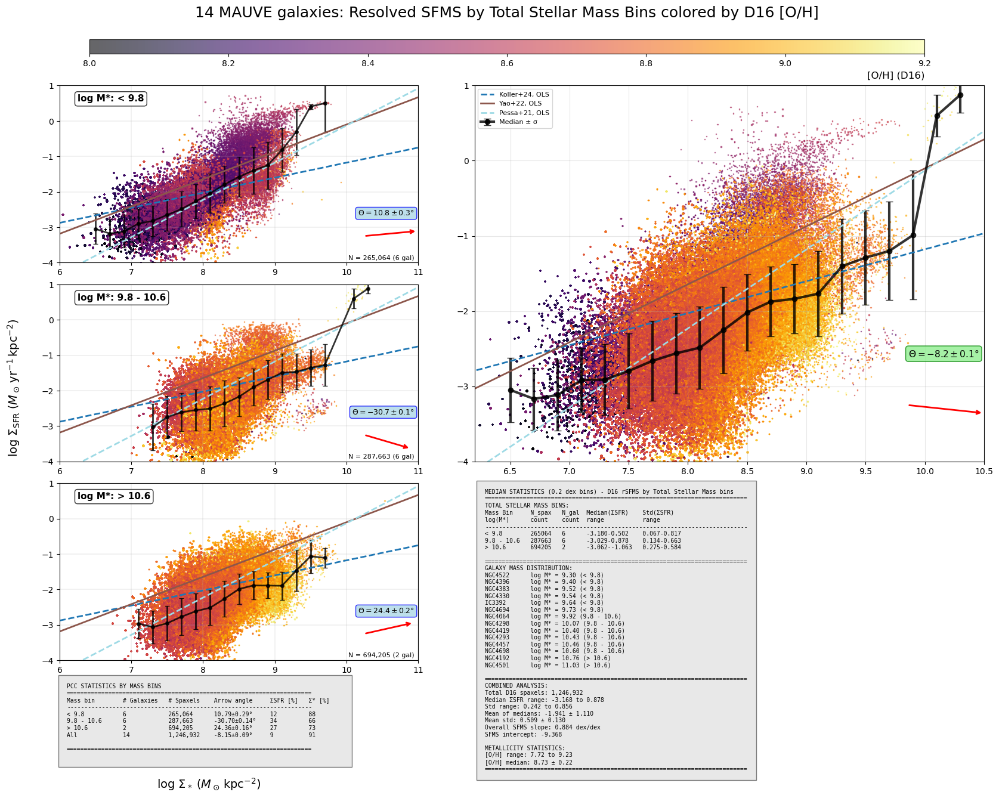

In [25]:
# ------------------------------------------------------------------
# COMPREHENSIVE LAYOUT: Mass-binned rSFMS + Combined plot + Statistics (D16 [O/H] colored)
# 4-column layout: Cols 1-2 = Mass-binned SFMS, Col 3 = Combined plot, Col 4 = Statistics
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from pathlib import Path
from astropy.io import fits
import itertools
import re  # Add this import for regex
from scipy.stats import spearmanr

# 0 · discover galaxies & colour palette
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)
assert ngal <= 14, "This layout assumes ≤ 14 galaxies."

def calculate_pcc_and_arrow_angle(A, B, C, n_bootstrap=100):
    """
    Calculate partial correlation coefficients and arrow angle for 3D correlation analysis.
    Includes bootstrap uncertainty estimation for the arrow angle.
    
    Parameters:
    -----------
    A : array-like
        Variable A (z-axis, typically [O/H])
    B : array-like  
        Variable B (y-axis, typically Σ_SFR)
    C : array-like
        Variable C (x-axis, typically Σ_*)
    n_bootstrap : int, optional
        Number of bootstrap samples for uncertainty estimation (default: 100)
    
    Returns:
    --------
    rho_AB_given_C : float
        Partial correlation coefficient between A and B given C (ρ_AB|C)
    rho_AC_given_B : float
        Partial correlation coefficient between A and C given B (ρ_AC|B)
    tan_theta : float
        Tangent of the arrow angle
    theta_rad : float
        Arrow angle in radians (measured anti-clockwise from horizontal)
    theta_deg : float
        Arrow angle in degrees
    theta_rad_std : float
        Standard deviation of arrow angle in radians from bootstrap sampling
    theta_deg_std : float
        Standard deviation of arrow angle in degrees from bootstrap sampling
    """
    
    # Convert to numpy arrays and remove NaN values
    A = np.array(A)
    B = np.array(B)
    C = np.array(C)
    
    # Create mask for valid (non-NaN) values
    valid_mask = ~(np.isnan(A) | np.isnan(B) | np.isnan(C))
    
    A_clean = A[valid_mask]
    B_clean = B[valid_mask]
    C_clean = C[valid_mask]
    
    n_samples = len(A_clean)
    
    # Calculate original values
    def calculate_angle(A_data, B_data, C_data):
        """Helper function to calculate angle from data"""
        rho_AB, _ = spearmanr(A_data, B_data)
        rho_AC, _ = spearmanr(A_data, C_data)
        rho_BC, _ = spearmanr(B_data, C_data)
        
        # Calculate partial correlation coefficients
        rho_AB_given_C = (rho_AB - rho_AC * rho_BC) / (np.sqrt(1 - rho_AC**2) * np.sqrt(1 - rho_BC**2))
        rho_AC_given_B = (rho_AC - rho_AB * rho_BC) / (np.sqrt(1 - rho_AB**2) * np.sqrt(1 - rho_BC**2))
        
        # Calculate arrow angle
        tan_theta = rho_AB_given_C / rho_AC_given_B
        theta_rad = np.arctan(tan_theta)
        theta_deg = np.degrees(theta_rad)
        
        return rho_AB_given_C, rho_AC_given_B, tan_theta, theta_rad, theta_deg
    
    # Calculate original values
    rho_AB_given_C, rho_AC_given_B, tan_theta, theta_rad, theta_deg = calculate_angle(A_clean, B_clean, C_clean)
    
    # Bootstrap sampling for uncertainty estimation
    np.random.seed(42)  # For reproducibility
    bootstrap_angles_rad = []
    bootstrap_angles_deg = []
    
    for i in range(n_bootstrap):
        # Random sampling with replacement
        bootstrap_indices = np.random.choice(n_samples, size=n_samples, replace=True)
        
        A_boot = A_clean[bootstrap_indices]
        B_boot = B_clean[bootstrap_indices]
        C_boot = C_clean[bootstrap_indices]
        
        try:
            _, _, _, theta_rad_boot, theta_deg_boot = calculate_angle(A_boot, B_boot, C_boot)
            bootstrap_angles_rad.append(theta_rad_boot)
            bootstrap_angles_deg.append(theta_deg_boot)
        except (ValueError, ZeroDivisionError):
            # Skip this bootstrap sample if calculation fails
            continue
    
    # Calculate standard deviations of bootstrap angles
    if len(bootstrap_angles_rad) > 0:
        theta_rad_std = np.std(bootstrap_angles_rad)
        theta_deg_std = np.std(bootstrap_angles_deg)
    else:
        theta_rad_std = np.nan
        theta_deg_std = np.nan
        print("Warning: All bootstrap samples failed. Uncertainty cannot be estimated.")
    
    return rho_AB_given_C, rho_AC_given_B, tan_theta, theta_rad, theta_deg, theta_rad_std, theta_deg_std

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_d16 = h['O_H_D16_SF'].data
    return sigM, sigSFR, oh_d16

# Extraction functions for log files
def extract_total_stellar_mass(galaxy_name):
    """Extract total stellar mass from mass log file. Returns log10(M☉) value or None if not found."""
    log_file = Path(f'mass_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total stellar mass \(R\)\s*:\s*([\d.-]+)\s*log10\(M☉\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading mass log for {galaxy_name}: {e}")
        return None

def extract_total_sfr(galaxy_name):
    """Extract total SFR from SFR log file. Returns log10(M☉/yr) value or None if not found."""
    log_file = Path(f'sfr_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total Halpha SFR from SF region:.*?in log10 scale:\s*([\d.-]+)\s*log\(M☉/yr\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception:
        return None

def calculate_median_statistics(x, y, x_range=(6, 11), bin_width=0.2):
    """Calculate median and std in binned intervals"""
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    
    medians = []
    stds = []
    x_valid = []
    
    for i in range(len(x_bins) - 1):
        mask = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if len(np.unique(x[mask])) >= 10:  # Need at least 10 distinct x values
            y_bin = y[mask]
            medians.append(np.median(y_bin))
            stds.append(np.std(y_bin))
            x_valid.append(x_centers[i])
    
    return np.array(x_valid), np.array(medians), np.array(stds)

def plot_literature_sfms_fits(ax, show_legend=False):
    """Plot literature Star Formation Main Sequence fits on the given axis"""
    # Define x range for plotting literature fits
    x = np.linspace(6, 11, 100)
    
    # Kennicutt-Schmidt relation for resolved studies
    # log ΣSFR = α × log Σ* + β
    
    # Literature SFMS fits with slope and intercept parameters
    plot_data = [
        # Reference 1: This work (SF-spaxels), OLS
        (0.425, -5.428, 'Koller+24, OLS', '--'),
        # Reference 5: Yao et al. (2022), OLS
        (0.771, -7.812, 'Yao+22, OLS', '-'),
        # Pessa et al. (2021) - OLS
        (1.05, -10.63, 'Pessa+21, OLS', '--'),
    ]
    
    # Generate literature fits using the new format (slope, intercept, label, linestyle)
    literature_fits = []
    for slope, intercept, label, linestyle in plot_data:
        y_lit = slope * x + intercept
        literature_fits.append((y_lit, label, linestyle))
    
    plot_data = literature_fits
    
    # Plot all literature fits
    colors = plt.cm.tab20(np.linspace(0, 1, len(plot_data)))
    for i, (y, label, linestyle) in enumerate(plot_data):
        if show_legend:
            ax.plot(x, y, label=label, linewidth=2, linestyle=linestyle, color=colors[i])
        else:
            ax.plot(x, y, linewidth=2, linestyle=linestyle, color=colors[i])

def draw_arrow_angle(ax, theta_deg, length=0.15):
    """Draw an arrow showing the direction of steepest gradient"""
    # Convert angle to radians
    theta_rad = np.radians(theta_deg)
    
    # Starting point (in axis coordinates)
    start_x, start_y = 0.85, 0.15
    
    # End point
    end_x = start_x + length * np.cos(theta_rad)
    end_y = start_y + length * np.sin(theta_rad)
    
    # Draw arrow
    ax.annotate('', xy=(end_x, end_y), xytext=(start_x, start_y),
                xycoords='axes fraction', textcoords='axes fraction',
                arrowprops=dict(arrowstyle='->', color='red', lw=2))

# 1 · Extract total stellar masses for each galaxy and collect data by mass bins
print("Extracting total stellar masses and collecting data...")
galaxy_masses = {}
for gal in galaxies:
    total_mass = extract_total_stellar_mass(gal)
    if total_mass is not None:
        galaxy_masses[gal] = total_mass
        print(f"{gal}: log M* = {total_mass:.2f}")
    else:
        print(f"{gal}: Could not extract total stellar mass")

# 2 · Define total stellar mass bins
mass_bin_edges = [-np.inf, 9.8, 10.6, np.inf]
mass_bin_labels = ['< 9.8', '9.8 - 10.6', '> 10.6']

print(f"\nTotal stellar mass bins defined: {len(mass_bin_labels)} bins")

# 3 · Collect data from galaxies in each mass bin
mass_binned_data = {i: {'x': [], 'y': [], 'metallicity': [], 'galaxies': []} for i in range(len(mass_bin_labels))}

for gal in galaxies:
    if gal not in galaxy_masses:
        continue
    
    total_mass = galaxy_masses[gal]
    
    # Determine which mass bin this galaxy belongs to
    bin_idx = None
    for i in range(len(mass_bin_edges) - 1):
        if mass_bin_edges[i] < total_mass <= mass_bin_edges[i + 1]:
            bin_idx = i
            break
    
    if bin_idx is None:
        continue
    
    # Load data for this galaxy
    sigM, sigSFR, oh_d16 = load_maps(gal)
    good_d16 = np.isfinite(sigM) & np.isfinite(oh_d16) & np.isfinite(sigSFR)
    
    if np.any(good_d16):
        # For SFMS: x = stellar mass surface density, y = SFR surface density
        x_d16, y_d16, met_d16 = sigM[good_d16], sigSFR[good_d16], oh_d16[good_d16]
        mass_binned_data[bin_idx]['x'].extend(x_d16)
        mass_binned_data[bin_idx]['y'].extend(y_d16)
        mass_binned_data[bin_idx]['metallicity'].extend(met_d16)
        mass_binned_data[bin_idx]['galaxies'].append(gal)

# Convert lists to arrays and print statistics
for i, label in enumerate(mass_bin_labels):
    mass_binned_data[i]['x'] = np.array(mass_binned_data[i]['x'])
    mass_binned_data[i]['y'] = np.array(mass_binned_data[i]['y'])
    mass_binned_data[i]['metallicity'] = np.array(mass_binned_data[i]['metallicity'])
    n_spax = len(mass_binned_data[i]['x'])
    n_gal = len(set(mass_binned_data[i]['galaxies']))
    print(f"  {label} log(M☉): {n_spax:,} spaxels from {n_gal} galaxies")

# Collect all data for combined plot
all_x = np.concatenate([mass_binned_data[i]['x'] for i in range(len(mass_bin_labels)) if len(mass_binned_data[i]['x']) > 0])
all_y = np.concatenate([mass_binned_data[i]['y'] for i in range(len(mass_bin_labels)) if len(mass_binned_data[i]['y']) > 0])
all_metallicity = np.concatenate([mass_binned_data[i]['metallicity'] for i in range(len(mass_bin_labels)) if len(mass_binned_data[i]['metallicity']) > 0])

print(f"Total spaxels collected: {len(all_x):,}")

# 4 · Create comprehensive figure with 4-column layout
fig = plt.figure(figsize=(20, 16))
gs = GridSpec(nrows=8, ncols=4, figure=fig,
              width_ratios=[1, 1, 1.5, 1.5],  # Cols 3&4 slightly wider
              height_ratios=[0.5, 1, 1, 1, 1, 1, 1, 1],  # Row 0 for colorbar
              wspace=0.3, hspace=0.3)

scatter_for_cbar = None
bin_stats = []
pcc_results = []

# COLUMNS 1-2: Mass-binned SFMS plots (each occupying 2x2 grid space)
subplot_positions = [
    (1, 3, 0, 2),    # bin 0: rows 1-2, cols 0-1
    (3, 5, 0, 2),    # bin 1: rows 3-4, cols 0-1  
    (5, 7, 0, 2)     # bin 2: rows 5-6, cols 0-1
]

for bin_idx in range(len(mass_bin_labels)):
    if len(mass_binned_data[bin_idx]['x']) == 0:
        print(f"Skipping bin {mass_bin_labels[bin_idx]}: no valid data points")
        continue
    
    if bin_idx >= len(subplot_positions):
        print(f"No subplot position defined for bin {bin_idx}")
        continue
    
    row_start, row_end, col_start, col_end = subplot_positions[bin_idx]
    axP = fig.add_subplot(gs[row_start:row_end, col_start:col_end])
    
    x_bin = mass_binned_data[bin_idx]['x']
    y_bin = mass_binned_data[bin_idx]['y']
    met_bin = mass_binned_data[bin_idx]['metallicity']
    
    # Calculate PCC and arrow angle for this bin
    # A = [O/H] (z-axis), B = Σ_SFR (y-axis), C = Σ_* (x-axis)
    rho_AB_given_C, rho_AC_given_B, tan_theta, theta_rad, theta_deg, theta_rad_std, theta_deg_std = calculate_pcc_and_arrow_angle(
        met_bin, y_bin, x_bin, n_bootstrap=100)
    pcc_results.append((mass_bin_labels[bin_idx], theta_deg, theta_deg_std, rho_AB_given_C, rho_AC_given_B))
    
    # Calculate median statistics for this bin
    x_median, y_median, y_std = calculate_median_statistics(x_bin, y_bin)
    bin_stats.append((mass_bin_labels[bin_idx], x_median, y_median, y_std, len(x_bin)))
    
    # Scatter plot colored by D16 metallicity (using inferno colormap)
    scatter = axP.scatter(x_bin, y_bin, c=met_bin, s=1, alpha=0.6, marker=',', 
                         cmap='inferno', vmin=8.0, vmax=9.2)
    
    # Plot median with error bars
    if len(x_median) > 0:
        axP.errorbar(x_median, y_median, yerr=y_std, fmt='ko-', linewidth=2, 
                    markersize=4, capsize=3, alpha=0.8)
    
    if scatter_for_cbar is None:
        scatter_for_cbar = scatter
    
    # Add literature fits to individual panels (no legend)
    plot_literature_sfms_fits(axP, show_legend=False)
    
    # Add bin label in top left corner
    axP.text(0.05, 0.95, f'log M*: {mass_bin_labels[bin_idx]}', 
             transform=axP.transAxes, fontsize=11, fontweight='bold',
             va='top', ha='left', bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8, edgecolor='black'))
    
    # Add arrow angle in top right corner  
    if not np.isnan(theta_deg) and not np.isnan(theta_deg_std):
        arrow_text = fr'$\Theta = {theta_deg:.1f} \pm {theta_deg_std:.1f}°$'
        # Change the positioning from (0.95, 0.95) to (0.99, 0.30) to place it above the arrow
        axP.text(0.99, 0.30, arrow_text, transform=axP.transAxes, fontsize=9,
                 va='top', ha='right', bbox=dict(boxstyle='round,pad=0.3', facecolor='lightblue', alpha=0.8, edgecolor='blue'))
        
        # Draw arrow showing the direction
        draw_arrow_angle(axP, theta_deg)
    
    # Bottom right: number of spaxels and galaxies
    n_gal = len(set(mass_binned_data[bin_idx]['galaxies']))
    axP.text(0.99, 0.01, f'N = {len(x_bin):,} ({n_gal} gal)',
             transform=axP.transAxes, va='bottom', ha='right', fontsize=8,
             bbox=dict(facecolor='none', alpha=0.8, edgecolor='none', pad=2))
    
    axP.set_xlim(6, 11)
    axP.set_ylim(-4, 1)  # Typical SFR surface density range
    axP.grid(True, lw=0.25)

# COLUMNS 3-4: Combined plot - Upper panel
ax_combined = fig.add_subplot(gs[1:5, 2:4])  # Spans rows 1-4, columns 2-3

# Calculate PCC and arrow angle for combined data
rho_AB_given_C_combined, rho_AC_given_B_combined, tan_theta_combined, theta_rad_combined, theta_deg_combined, theta_rad_std_combined, theta_deg_std_combined = calculate_pcc_and_arrow_angle(
    all_metallicity, all_y, all_x, n_bootstrap=100)

# Calculate combined median statistics
x_median_combined, y_median_combined, y_std_combined = calculate_median_statistics(all_x, all_y)

# Scatter plot colored by D16 metallicity for combined data (using inferno colormap)
scatter_combined = ax_combined.scatter(all_x, all_y, c=all_metallicity, s=1, alpha=0.6, marker=',', 
                                      cmap='inferno', vmin=8.0, vmax=9.2)

# Plot combined median with error bars
if len(x_median_combined) > 0:
    ax_combined.errorbar(x_median_combined, y_median_combined, yerr=y_std_combined, 
                        fmt='ko-', linewidth=3, markersize=6, capsize=4, alpha=0.8, label='Median ± σ')

# Add literature fits to combined panel (with legend)
plot_literature_sfms_fits(ax_combined, show_legend=True)

# Add arrow angle for combined data
if not np.isnan(theta_deg_combined) and not np.isnan(theta_deg_std_combined):
    arrow_text_combined = fr'$\Theta = {theta_deg_combined:.1f} \pm {theta_deg_std_combined:.1f}°$'
    # Change positioning from (0.95, 0.95) to (0.99, 0.30) for consistency
    ax_combined.text(0.99, 0.30, arrow_text_combined, transform=ax_combined.transAxes, fontsize=11,
                     va='top', ha='right', bbox=dict(boxstyle='round,pad=0.3', facecolor='lightgreen', alpha=0.8, edgecolor='green'))
    
    # Draw arrow showing the direction
    draw_arrow_angle(ax_combined, theta_deg_combined)

# Add legend with small font
ax_combined.legend(fontsize=8, ncol=1, loc='upper left')

ax_combined.set_xlim(6.2, 10.5)
ax_combined.set_ylim(-4, 1)
ax_combined.grid(True, alpha=0.3)

# COLUMNS 1-2: PCC Statistics table - Lower panel
ax_pcc_stats = fig.add_subplot(gs[7:8, 0:2])  # Row 7, columns 0-1
ax_pcc_stats.axis('off')

# Create PCC statistics table for columns 1-2
pcc_table = "PCC STATISTICS BY MASS BINS\n"
pcc_table += "="*70 + "\n"
pcc_table += f"{'Mass bin':<15} {'# Galaxies':<12} {'# Spaxels':<12} {'Arrow angle':<15} {'ΣSFR [%]':<10} {'Σ* [%]':<10}\n"
pcc_table += "-"*70 + "\n"

# Add data for each mass bin
for i, (bin_label, theta_deg, theta_deg_std, rho_AB_given_C, rho_AC_given_B) in enumerate(pcc_results):
    n_gal = len(set(mass_binned_data[i]['galaxies']))
    n_spax = len(mass_binned_data[i]['x'])
    
    if not np.isnan(theta_deg) and not np.isnan(theta_deg_std):
        angle_str = f"{theta_deg:.2f}±{theta_deg_std:.2f}°"
        # Calculate contributions: ΣSFR contribution = |angle|/90°, Σ* contribution = 1 - ΣSFR contribution
        sfr_contrib = abs(theta_deg) / 90.0 * 100
        stellar_contrib = 100 - sfr_contrib
        sfr_str = f"{sfr_contrib:.0f}"
        stellar_str = f"{stellar_contrib:.0f}"
    else:
        angle_str = "N/A"
        sfr_str = "N/A"
        stellar_str = "N/A"
    
    pcc_table += f"{bin_label:<15} {n_gal:<12} {n_spax:<12,} {angle_str:<15} {sfr_str:<10} {stellar_str:<10}\n"

# Add combined row
n_gal_combined = len(galaxies)
n_spax_combined = len(all_x)
if not np.isnan(theta_deg_combined) and not np.isnan(theta_deg_std_combined):
    combined_angle_str = f"{theta_deg_combined:.2f}±{theta_deg_std_combined:.2f}°"
    combined_sfr_contrib = abs(theta_deg_combined) / 90.0 * 100
    combined_stellar_contrib = 100 - combined_sfr_contrib
    combined_sfr_str = f"{combined_sfr_contrib:.0f}"
    combined_stellar_str = f"{combined_stellar_contrib:.0f}"
else:
    combined_angle_str = "N/A"
    combined_sfr_str = "N/A"
    combined_stellar_str = "N/A"

pcc_table += f"{'All':<15} {n_gal_combined:<12} {n_spax_combined:<12,} {combined_angle_str:<15} {combined_sfr_str:<10} {combined_stellar_str:<10}\n"

pcc_table += "\n" + "="*70 + "\n"

ax_pcc_stats.text(0.02, 0.98, pcc_table, transform=ax_pcc_stats.transAxes, va='top', ha='left',
                  fontsize=7, family='monospace',
                  bbox=dict(facecolor='lightgray', alpha=0.5, edgecolor='black', pad=10))

# COLUMNS 3-4: Statistics table - Lower panel
ax_stats = fig.add_subplot(gs[5:8, 2:4])  # Spans rows 5-7, columns 2-3
ax_stats.axis('off')

# Create comprehensive statistics text
stats_table = "MEDIAN STATISTICS (0.2 dex bins) - D16 rSFMS by Total Stellar Mass bins\n"
stats_table += "="*75 + "\n"
stats_table += "TOTAL STELLAR MASS BINS:\n"
stats_table += f"{'Mass Bin':<12} {'N_spax':<8} {'N_gal':<6} {'Median(ΣSFR)':<15} {'Std(ΣSFR)':<15}\n"
stats_table += f"{'log(M*)':<12} {'count':<8} {'count':<6} {'range':<15} {'range':<15}\n"
stats_table += "-"*75 + "\n"

for i, (bin_label, x_median, y_median, y_std, n_spax) in enumerate(bin_stats):
    n_gal = len(set(mass_binned_data[i]['galaxies']))
    if len(y_median) > 0:
        median_range = f"{y_median.min():.3f}-{y_median.max():.3f}"
        std_range = f"{y_std.min():.3f}-{y_std.max():.3f}"
    else:
        median_range = "N/A"
        std_range = "N/A"
    
    stats_table += f"{bin_label:<12} {n_spax:<8} {n_gal:<6} {median_range:<15} {std_range:<15}\n"

stats_table += "\n" + "="*75 + "\n"
stats_table += "GALAXY MASS DISTRIBUTION:\n"
for gal, mass in sorted(galaxy_masses.items(), key=lambda x: x[1]):
    # Determine bin
    for i in range(len(mass_bin_edges) - 1):
        if mass_bin_edges[i] < mass <= mass_bin_edges[i + 1]:
            bin_label = mass_bin_labels[i]
            break
    stats_table += f"{gal:<12} log M* = {mass:.2f} ({bin_label})\n"

stats_table += "\n" + "="*75 + "\n"
stats_table += "COMBINED ANALYSIS:\n"
stats_table += f"Total D16 spaxels: {len(all_x):,}\n"
if len(y_median_combined) > 0:
    stats_table += f"Median ΣSFR range: {y_median_combined.min():.3f} to {y_median_combined.max():.3f}\n"
    stats_table += f"Std range: {y_std_combined.min():.3f} to {y_std_combined.max():.3f}\n"
    stats_table += f"Mean of medians: {np.mean(y_median_combined):.3f} ± {np.std(y_median_combined):.3f}\n"
    stats_table += f"Mean std: {np.mean(y_std_combined):.3f} ± {np.std(y_std_combined):.3f}\n"
    
    # Calculate overall SFMS gradient (slope)
    if len(x_median_combined) > 3:
        slope, intercept = np.polyfit(x_median_combined, y_median_combined, 1)
        stats_table += f"Overall SFMS slope: {slope:.3f} dex/dex\n"
        stats_table += f"SFMS intercept: {intercept:.3f}\n"

# Add metallicity statistics
stats_table += f"\nMETALLICITY STATISTICS:\n"
stats_table += f"[O/H] range: {all_metallicity.min():.2f} to {all_metallicity.max():.2f}\n"
stats_table += f"[O/H] median: {np.median(all_metallicity):.2f} ± {np.std(all_metallicity):.2f}\n"
        
stats_table += "="*75

ax_stats.text(0.02, 0.98, stats_table, transform=ax_stats.transAxes, va='top', ha='left',
              fontsize=7, family='monospace',
              bbox=dict(facecolor='lightgray', alpha=0.5, edgecolor='black', pad=10))

# Add horizontal colorbar at the top
if scatter_for_cbar is not None:
    cbar_ax = fig.add_axes([0.15, 0.85, 0.7, 0.015])
    cbar = plt.colorbar(scatter_for_cbar, cax=cbar_ax, orientation='horizontal')
    cbar.set_label(r'[O/H] (D16)', fontsize=12, loc='right')

# Global title and labels
fig.suptitle(fr'{ngal} MAUVE galaxies: Resolved SFMS by Total Stellar Mass Bins colored by D16 [O/H]', 
             fontsize=18, y=0.90)

# Shared axis labels
fig.text(0.25, 0.08, r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', 
         ha='center', fontsize=14)
fig.text(0.08, 0.5, r'$\log\,\Sigma_{\mathrm{SFR}} \; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', 
         va='center', rotation='vertical', fontsize=14)

plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])
plt.show()

Extracting total stellar masses and collecting data...
IC3392: log M* = 9.64
NGC4064: log M* = 9.92
NGC4192: log M* = 10.76
NGC4293: log M* = 10.43
NGC4298: log M* = 10.07
NGC4330: log M* = 9.54
NGC4383: log M* = 9.52
NGC4396: log M* = 9.40
NGC4419: log M* = 10.40
NGC4457: log M* = 10.46
NGC4501: log M* = 11.03
NGC4522: log M* = 9.30
NGC4694: log M* = 9.73
NGC4698: log M* = 10.60

Total stellar mass bins defined: 3 bins
  < 9.8 log(M☉): 264,761 spaxels from 6 galaxies
  9.8 - 10.6 log(M☉): 290,629 spaxels from 6 galaxies
  > 10.6 log(M☉): 694,230 spaxels from 2 galaxies
Total spaxels collected: 1,249,620


/var/folders/rm/clp89v210v32vh5vjt2kx7b80000gr/T/ipykernel_65174/1221943199.py:544: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])


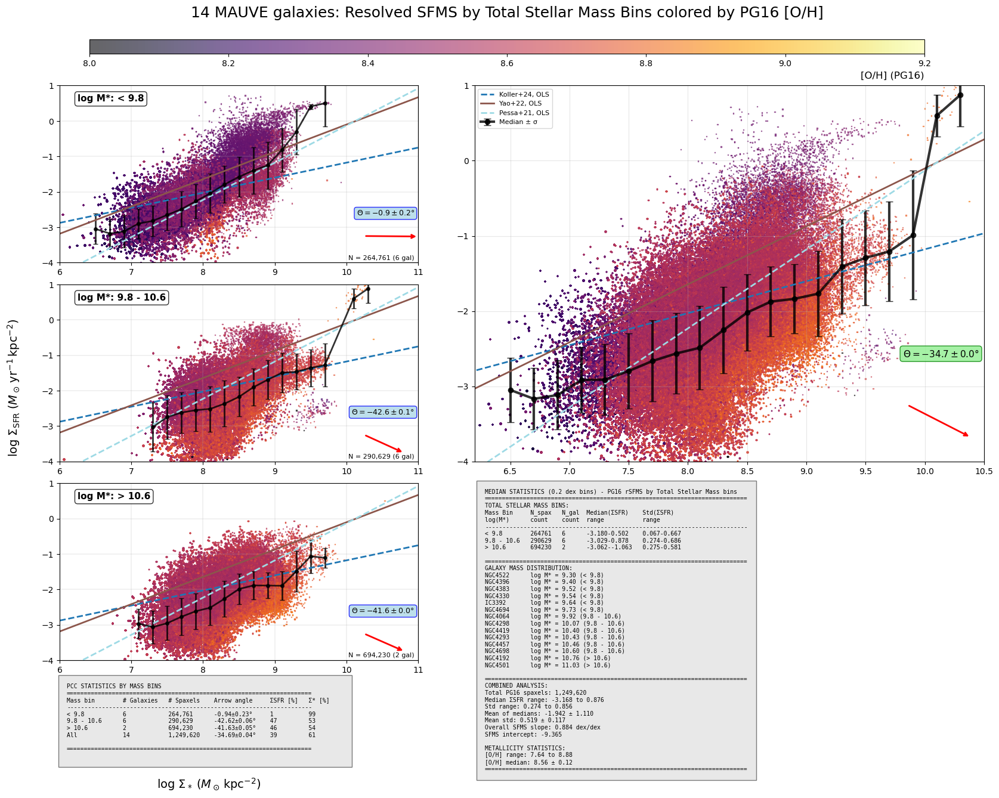

In [26]:
# ------------------------------------------------------------------
# COMPREHENSIVE LAYOUT: Mass-binned rSFMS + Combined plot + Statistics (PG16 [O/H] colored)
# 4-column layout: Cols 1-2 = Mass-binned SFMS, Col 3 = Combined plot, Col 4 = Statistics
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from pathlib import Path
from astropy.io import fits
import itertools
import re  # Add this import for regex
from scipy.stats import spearmanr

# 0 · discover galaxies & colour palette
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)
assert ngal <= 14, "This layout assumes ≤ 14 galaxies."

def calculate_pcc_and_arrow_angle(A, B, C, n_bootstrap=100):
    """
    Calculate partial correlation coefficients and arrow angle for 3D correlation analysis.
    Includes bootstrap uncertainty estimation for the arrow angle.
    
    Parameters:
    -----------
    A : array-like
        Variable A (z-axis, typically [O/H])
    B : array-like  
        Variable B (y-axis, typically Σ_SFR)
    C : array-like
        Variable C (x-axis, typically Σ_*)
    n_bootstrap : int, optional
        Number of bootstrap samples for uncertainty estimation (default: 100)
    
    Returns:
    --------
    rho_AB_given_C : float
        Partial correlation coefficient between A and B given C (ρ_AB|C)
    rho_AC_given_B : float
        Partial correlation coefficient between A and C given B (ρ_AC|B)
    tan_theta : float
        Tangent of the arrow angle
    theta_rad : float
        Arrow angle in radians (measured anti-clockwise from horizontal)
    theta_deg : float
        Arrow angle in degrees
    theta_rad_std : float
        Standard deviation of arrow angle in radians from bootstrap sampling
    theta_deg_std : float
        Standard deviation of arrow angle in degrees from bootstrap sampling
    """
    
    # Convert to numpy arrays and remove NaN values
    A = np.array(A)
    B = np.array(B)
    C = np.array(C)
    
    # Create mask for valid (non-NaN) values
    valid_mask = ~(np.isnan(A) | np.isnan(B) | np.isnan(C))
    
    A_clean = A[valid_mask]
    B_clean = B[valid_mask]
    C_clean = C[valid_mask]
    
    n_samples = len(A_clean)
    
    # Calculate original values
    def calculate_angle(A_data, B_data, C_data):
        """Helper function to calculate angle from data"""
        rho_AB, _ = spearmanr(A_data, B_data)
        rho_AC, _ = spearmanr(A_data, C_data)
        rho_BC, _ = spearmanr(B_data, C_data)
        
        # Calculate partial correlation coefficients
        rho_AB_given_C = (rho_AB - rho_AC * rho_BC) / (np.sqrt(1 - rho_AC**2) * np.sqrt(1 - rho_BC**2))
        rho_AC_given_B = (rho_AC - rho_AB * rho_BC) / (np.sqrt(1 - rho_AB**2) * np.sqrt(1 - rho_BC**2))
        
        # Calculate arrow angle
        tan_theta = rho_AB_given_C / rho_AC_given_B
        theta_rad = np.arctan(tan_theta)
        theta_deg = np.degrees(theta_rad)
        
        return rho_AB_given_C, rho_AC_given_B, tan_theta, theta_rad, theta_deg
    
    # Calculate original values
    rho_AB_given_C, rho_AC_given_B, tan_theta, theta_rad, theta_deg = calculate_angle(A_clean, B_clean, C_clean)
    
    # Bootstrap sampling for uncertainty estimation
    np.random.seed(42)  # For reproducibility
    bootstrap_angles_rad = []
    bootstrap_angles_deg = []
    
    for i in range(n_bootstrap):
        # Random sampling with replacement
        bootstrap_indices = np.random.choice(n_samples, size=n_samples, replace=True)
        
        A_boot = A_clean[bootstrap_indices]
        B_boot = B_clean[bootstrap_indices]
        C_boot = C_clean[bootstrap_indices]
        
        try:
            _, _, _, theta_rad_boot, theta_deg_boot = calculate_angle(A_boot, B_boot, C_boot)
            bootstrap_angles_rad.append(theta_rad_boot)
            bootstrap_angles_deg.append(theta_deg_boot)
        except (ValueError, ZeroDivisionError):
            # Skip this bootstrap sample if calculation fails
            continue
    
    # Calculate standard deviations of bootstrap angles
    if len(bootstrap_angles_rad) > 0:
        theta_rad_std = np.std(bootstrap_angles_rad)
        theta_deg_std = np.std(bootstrap_angles_deg)
    else:
        theta_rad_std = np.nan
        theta_deg_std = np.nan
        print("Warning: All bootstrap samples failed. Uncertainty cannot be estimated.")
    
    return rho_AB_given_C, rho_AC_given_B, tan_theta, theta_rad, theta_deg, theta_rad_std, theta_deg_std

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_pg16 = h['O_H_PG16_SF'].data
    return sigM, sigSFR, oh_pg16

# Extraction functions for log files
def extract_total_stellar_mass(galaxy_name):
    """Extract total stellar mass from mass log file. Returns log10(M☉) value or None if not found."""
    log_file = Path(f'mass_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total stellar mass \(R\)\s*:\s*([\d.-]+)\s*log10\(M☉\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading mass log for {galaxy_name}: {e}")
        return None

def extract_total_sfr(galaxy_name):
    """Extract total SFR from SFR log file. Returns log10(M☉/yr) value or None if not found."""
    log_file = Path(f'sfr_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total Halpha SFR from SF region:.*?in log10 scale:\s*([\d.-]+)\s*log\(M☉/yr\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception:
        return None

def calculate_median_statistics(x, y, x_range=(6, 11), bin_width=0.2):
    """Calculate median and std in binned intervals"""
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    
    medians = []
    stds = []
    x_valid = []
    
    for i in range(len(x_bins) - 1):
        mask = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if len(np.unique(x[mask])) >= 10:  # Need at least 10 distinct x values
            y_bin = y[mask]
            medians.append(np.median(y_bin))
            stds.append(np.std(y_bin))
            x_valid.append(x_centers[i])
    
    return np.array(x_valid), np.array(medians), np.array(stds)

def plot_literature_sfms_fits(ax, show_legend=False):
    """Plot literature Star Formation Main Sequence fits on the given axis"""
    # Define x range for plotting literature fits
    x = np.linspace(6, 11, 100)
    
    # Kennicutt-Schmidt relation for resolved studies
    # log ΣSFR = α × log Σ* + β
    
    # Literature SFMS fits with slope and intercept parameters
    plot_data = [
        # Reference 1: This work (SF-spaxels), OLS
        (0.425, -5.428, 'Koller+24, OLS', '--'),
        # Reference 5: Yao et al. (2022), OLS
        (0.771, -7.812, 'Yao+22, OLS', '-'),
        # Pessa et al. (2021) - OLS
        (1.05, -10.63, 'Pessa+21, OLS', '--'),
    ]
    
    # Generate literature fits using the new format (slope, intercept, label, linestyle)
    literature_fits = []
    for slope, intercept, label, linestyle in plot_data:
        y_lit = slope * x + intercept
        literature_fits.append((y_lit, label, linestyle))
    
    plot_data = literature_fits
    
    # Plot all literature fits
    colors = plt.cm.tab20(np.linspace(0, 1, len(plot_data)))
    for i, (y, label, linestyle) in enumerate(plot_data):
        if show_legend:
            ax.plot(x, y, label=label, linewidth=2, linestyle=linestyle, color=colors[i])
        else:
            ax.plot(x, y, linewidth=2, linestyle=linestyle, color=colors[i])

def draw_arrow_angle(ax, theta_deg, length=0.15):
    """Draw an arrow showing the direction of steepest gradient"""
    # Convert angle to radians
    theta_rad = np.radians(theta_deg)
    
    # Starting point (in axis coordinates)
    start_x, start_y = 0.85, 0.15
    
    # End point
    end_x = start_x + length * np.cos(theta_rad)
    end_y = start_y + length * np.sin(theta_rad)
    
    # Draw arrow
    ax.annotate('', xy=(end_x, end_y), xytext=(start_x, start_y),
                xycoords='axes fraction', textcoords='axes fraction',
                arrowprops=dict(arrowstyle='->', color='red', lw=2))

# 1 · Extract total stellar masses for each galaxy and collect data by mass bins
print("Extracting total stellar masses and collecting data...")
galaxy_masses = {}
for gal in galaxies:
    total_mass = extract_total_stellar_mass(gal)
    if total_mass is not None:
        galaxy_masses[gal] = total_mass
        print(f"{gal}: log M* = {total_mass:.2f}")
    else:
        print(f"{gal}: Could not extract total stellar mass")

# 2 · Define total stellar mass bins
mass_bin_edges = [-np.inf, 9.8, 10.6, np.inf]
mass_bin_labels = ['< 9.8', '9.8 - 10.6', '> 10.6']

print(f"\nTotal stellar mass bins defined: {len(mass_bin_labels)} bins")

# 3 · Collect data from galaxies in each mass bin
mass_binned_data = {i: {'x': [], 'y': [], 'metallicity': [], 'galaxies': []} for i in range(len(mass_bin_labels))}

for gal in galaxies:
    if gal not in galaxy_masses:
        continue
    
    total_mass = galaxy_masses[gal]
    
    # Determine which mass bin this galaxy belongs to
    bin_idx = None
    for i in range(len(mass_bin_edges) - 1):
        if mass_bin_edges[i] < total_mass <= mass_bin_edges[i + 1]:
            bin_idx = i
            break
    
    if bin_idx is None:
        continue
    
    # Load data for this galaxy
    sigM, sigSFR, oh_pg16 = load_maps(gal)
    good_pg16 = np.isfinite(sigM) & np.isfinite(oh_pg16) & np.isfinite(sigSFR)
    
    if np.any(good_pg16):
        # For SFMS: x = stellar mass surface density, y = SFR surface density
        x_pg16, y_pg16, met_pg16 = sigM[good_pg16], sigSFR[good_pg16], oh_pg16[good_pg16]
        mass_binned_data[bin_idx]['x'].extend(x_pg16)
        mass_binned_data[bin_idx]['y'].extend(y_pg16)
        mass_binned_data[bin_idx]['metallicity'].extend(met_pg16)
        mass_binned_data[bin_idx]['galaxies'].append(gal)

# Convert lists to arrays and print statistics
for i, label in enumerate(mass_bin_labels):
    mass_binned_data[i]['x'] = np.array(mass_binned_data[i]['x'])
    mass_binned_data[i]['y'] = np.array(mass_binned_data[i]['y'])
    mass_binned_data[i]['metallicity'] = np.array(mass_binned_data[i]['metallicity'])
    n_spax = len(mass_binned_data[i]['x'])
    n_gal = len(set(mass_binned_data[i]['galaxies']))
    print(f"  {label} log(M☉): {n_spax:,} spaxels from {n_gal} galaxies")

# Collect all data for combined plot
all_x = np.concatenate([mass_binned_data[i]['x'] for i in range(len(mass_bin_labels)) if len(mass_binned_data[i]['x']) > 0])
all_y = np.concatenate([mass_binned_data[i]['y'] for i in range(len(mass_bin_labels)) if len(mass_binned_data[i]['y']) > 0])
all_metallicity = np.concatenate([mass_binned_data[i]['metallicity'] for i in range(len(mass_bin_labels)) if len(mass_binned_data[i]['metallicity']) > 0])

print(f"Total spaxels collected: {len(all_x):,}")

# 4 · Create comprehensive figure with 4-column layout
fig = plt.figure(figsize=(20, 16))
gs = GridSpec(nrows=8, ncols=4, figure=fig,
              width_ratios=[1, 1, 1.5, 1.5],  # Cols 3&4 slightly wider
              height_ratios=[0.5, 1, 1, 1, 1, 1, 1, 1],  # Row 0 for colorbar
              wspace=0.3, hspace=0.3)

scatter_for_cbar = None
bin_stats = []
pcc_results = []

# COLUMNS 1-2: Mass-binned SFMS plots (each occupying 2x2 grid space)
subplot_positions = [
    (1, 3, 0, 2),    # bin 0: rows 1-2, cols 0-1
    (3, 5, 0, 2),    # bin 1: rows 3-4, cols 0-1  
    (5, 7, 0, 2)     # bin 2: rows 5-6, cols 0-1
]

for bin_idx in range(len(mass_bin_labels)):
    if len(mass_binned_data[bin_idx]['x']) == 0:
        print(f"Skipping bin {mass_bin_labels[bin_idx]}: no valid data points")
        continue
    
    if bin_idx >= len(subplot_positions):
        print(f"No subplot position defined for bin {bin_idx}")
        continue
    
    row_start, row_end, col_start, col_end = subplot_positions[bin_idx]
    axP = fig.add_subplot(gs[row_start:row_end, col_start:col_end])
    
    x_bin = mass_binned_data[bin_idx]['x']
    y_bin = mass_binned_data[bin_idx]['y']
    met_bin = mass_binned_data[bin_idx]['metallicity']
    
    # Calculate PCC and arrow angle for this bin
    # A = [O/H] (z-axis), B = Σ_SFR (y-axis), C = Σ_* (x-axis)
    rho_AB_given_C, rho_AC_given_B, tan_theta, theta_rad, theta_deg, theta_rad_std, theta_deg_std = calculate_pcc_and_arrow_angle(
        met_bin, y_bin, x_bin, n_bootstrap=100)
    pcc_results.append((mass_bin_labels[bin_idx], theta_deg, theta_deg_std, rho_AB_given_C, rho_AC_given_B))
    
    # Calculate median statistics for this bin
    x_median, y_median, y_std = calculate_median_statistics(x_bin, y_bin)
    bin_stats.append((mass_bin_labels[bin_idx], x_median, y_median, y_std, len(x_bin)))
    
    # Scatter plot colored by PG16 metallicity (using inferno colormap)
    scatter = axP.scatter(x_bin, y_bin, c=met_bin, s=1, alpha=0.6, marker=',', 
                         cmap='inferno', vmin=8.0, vmax=9.2)
    
    # Plot median with error bars
    if len(x_median) > 0:
        axP.errorbar(x_median, y_median, yerr=y_std, fmt='ko-', linewidth=2, 
                    markersize=4, capsize=3, alpha=0.8)
    
    if scatter_for_cbar is None:
        scatter_for_cbar = scatter
    
    # Add literature fits to individual panels (no legend)
    plot_literature_sfms_fits(axP, show_legend=False)
    
    # Add bin label in top left corner
    axP.text(0.05, 0.95, f'log M*: {mass_bin_labels[bin_idx]}', 
             transform=axP.transAxes, fontsize=11, fontweight='bold',
             va='top', ha='left', bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8, edgecolor='black'))
    
    # Add arrow angle in top right corner  
    if not np.isnan(theta_deg) and not np.isnan(theta_deg_std):
        arrow_text = fr'$\Theta = {theta_deg:.1f} \pm {theta_deg_std:.1f}°$'
        # Change the positioning from (0.95, 0.95) to (0.99, 0.30) to place it above the arrow
        axP.text(0.99, 0.30, arrow_text, transform=axP.transAxes, fontsize=9,
                 va='top', ha='right', bbox=dict(boxstyle='round,pad=0.3', facecolor='lightblue', alpha=0.8, edgecolor='blue'))
        
        # Draw arrow showing the direction
        draw_arrow_angle(axP, theta_deg)
    
    # Bottom right: number of spaxels and galaxies
    n_gal = len(set(mass_binned_data[bin_idx]['galaxies']))
    axP.text(0.99, 0.01, f'N = {len(x_bin):,} ({n_gal} gal)',
             transform=axP.transAxes, va='bottom', ha='right', fontsize=8,
             bbox=dict(facecolor='none', alpha=0.8, edgecolor='none', pad=2))
    
    axP.set_xlim(6, 11)
    axP.set_ylim(-4, 1)  # Typical SFR surface density range
    axP.grid(True, lw=0.25)

# COLUMNS 3-4: Combined plot - Upper panel
ax_combined = fig.add_subplot(gs[1:5, 2:4])  # Spans rows 1-4, columns 2-3

# Calculate PCC and arrow angle for combined data
rho_AB_given_C_combined, rho_AC_given_B_combined, tan_theta_combined, theta_rad_combined, theta_deg_combined, theta_rad_std_combined, theta_deg_std_combined = calculate_pcc_and_arrow_angle(
    all_metallicity, all_y, all_x, n_bootstrap=100)

# Calculate combined median statistics
x_median_combined, y_median_combined, y_std_combined = calculate_median_statistics(all_x, all_y)

# Scatter plot colored by PG16 metallicity for combined data (using inferno colormap)
scatter_combined = ax_combined.scatter(all_x, all_y, c=all_metallicity, s=1, alpha=0.6, marker=',', 
                                      cmap='inferno', vmin=8.0, vmax=9.2)

# Plot combined median with error bars
if len(x_median_combined) > 0:
    ax_combined.errorbar(x_median_combined, y_median_combined, yerr=y_std_combined, 
                        fmt='ko-', linewidth=3, markersize=6, capsize=4, alpha=0.8, label='Median ± σ')

# Add literature fits to combined panel (with legend)
plot_literature_sfms_fits(ax_combined, show_legend=True)

# Add arrow angle for combined data
if not np.isnan(theta_deg_combined) and not np.isnan(theta_deg_std_combined):
    arrow_text_combined = fr'$\Theta = {theta_deg_combined:.1f} \pm {theta_deg_std_combined:.1f}°$'
    # Change positioning from (0.95, 0.95) to (0.99, 0.30) for consistency
    ax_combined.text(0.99, 0.30, arrow_text_combined, transform=ax_combined.transAxes, fontsize=11,
                     va='top', ha='right', bbox=dict(boxstyle='round,pad=0.3', facecolor='lightgreen', alpha=0.8, edgecolor='green'))
    
    # Draw arrow showing the direction
    draw_arrow_angle(ax_combined, theta_deg_combined)

# Add legend with small font
ax_combined.legend(fontsize=8, ncol=1, loc='upper left')

ax_combined.set_xlim(6.2, 10.5)
ax_combined.set_ylim(-4, 1)
ax_combined.grid(True, alpha=0.3)

# COLUMNS 1-2: PCC Statistics table - Lower panel
ax_pcc_stats = fig.add_subplot(gs[7:8, 0:2])  # Row 7, columns 0-1
ax_pcc_stats.axis('off')

# Create PCC statistics table for columns 1-2
pcc_table = "PCC STATISTICS BY MASS BINS\n"
pcc_table += "="*70 + "\n"
pcc_table += f"{'Mass bin':<15} {'# Galaxies':<12} {'# Spaxels':<12} {'Arrow angle':<15} {'ΣSFR [%]':<10} {'Σ* [%]':<10}\n"
pcc_table += "-"*70 + "\n"

# Add data for each mass bin
for i, (bin_label, theta_deg, theta_deg_std, rho_AB_given_C, rho_AC_given_B) in enumerate(pcc_results):
    n_gal = len(set(mass_binned_data[i]['galaxies']))
    n_spax = len(mass_binned_data[i]['x'])
    
    if not np.isnan(theta_deg) and not np.isnan(theta_deg_std):
        angle_str = f"{theta_deg:.2f}±{theta_deg_std:.2f}°"
        # Calculate contributions: ΣSFR contribution = |angle|/90°, Σ* contribution = 1 - ΣSFR contribution
        sfr_contrib = abs(theta_deg) / 90.0 * 100
        stellar_contrib = 100 - sfr_contrib
        sfr_str = f"{sfr_contrib:.0f}"
        stellar_str = f"{stellar_contrib:.0f}"
    else:
        angle_str = "N/A"
        sfr_str = "N/A"
        stellar_str = "N/A"
    
    pcc_table += f"{bin_label:<15} {n_gal:<12} {n_spax:<12,} {angle_str:<15} {sfr_str:<10} {stellar_str:<10}\n"

# Add combined row
n_gal_combined = len(galaxies)
n_spax_combined = len(all_x)
if not np.isnan(theta_deg_combined) and not np.isnan(theta_deg_std_combined):
    combined_angle_str = f"{theta_deg_combined:.2f}±{theta_deg_std_combined:.2f}°"
    combined_sfr_contrib = abs(theta_deg_combined) / 90.0 * 100
    combined_stellar_contrib = 100 - combined_sfr_contrib
    combined_sfr_str = f"{combined_sfr_contrib:.0f}"
    combined_stellar_str = f"{combined_stellar_contrib:.0f}"
else:
    combined_angle_str = "N/A"
    combined_sfr_str = "N/A"
    combined_stellar_str = "N/A"

pcc_table += f"{'All':<15} {n_gal_combined:<12} {n_spax_combined:<12,} {combined_angle_str:<15} {combined_sfr_str:<10} {combined_stellar_str:<10}\n"

pcc_table += "\n" + "="*70 + "\n"

ax_pcc_stats.text(0.02, 0.98, pcc_table, transform=ax_pcc_stats.transAxes, va='top', ha='left',
                  fontsize=7, family='monospace',
                  bbox=dict(facecolor='lightgray', alpha=0.5, edgecolor='black', pad=10))

# COLUMNS 3-4: Statistics table - Lower panel
ax_stats = fig.add_subplot(gs[5:8, 2:4])  # Spans rows 5-7, columns 2-3
ax_stats.axis('off')

# Create comprehensive statistics text
stats_table = "MEDIAN STATISTICS (0.2 dex bins) - PG16 rSFMS by Total Stellar Mass bins\n"
stats_table += "="*75 + "\n"
stats_table += "TOTAL STELLAR MASS BINS:\n"
stats_table += f"{'Mass Bin':<12} {'N_spax':<8} {'N_gal':<6} {'Median(ΣSFR)':<15} {'Std(ΣSFR)':<15}\n"
stats_table += f"{'log(M*)':<12} {'count':<8} {'count':<6} {'range':<15} {'range':<15}\n"
stats_table += "-"*75 + "\n"

for i, (bin_label, x_median, y_median, y_std, n_spax) in enumerate(bin_stats):
    n_gal = len(set(mass_binned_data[i]['galaxies']))
    if len(y_median) > 0:
        median_range = f"{y_median.min():.3f}-{y_median.max():.3f}"
        std_range = f"{y_std.min():.3f}-{y_std.max():.3f}"
    else:
        median_range = "N/A"
        std_range = "N/A"
    
    stats_table += f"{bin_label:<12} {n_spax:<8} {n_gal:<6} {median_range:<15} {std_range:<15}\n"

stats_table += "\n" + "="*75 + "\n"
stats_table += "GALAXY MASS DISTRIBUTION:\n"
for gal, mass in sorted(galaxy_masses.items(), key=lambda x: x[1]):
    # Determine bin
    for i in range(len(mass_bin_edges) - 1):
        if mass_bin_edges[i] < mass <= mass_bin_edges[i + 1]:
            bin_label = mass_bin_labels[i]
            break
    stats_table += f"{gal:<12} log M* = {mass:.2f} ({bin_label})\n"

stats_table += "\n" + "="*75 + "\n"
stats_table += "COMBINED ANALYSIS:\n"
stats_table += f"Total PG16 spaxels: {len(all_x):,}\n"
if len(y_median_combined) > 0:
    stats_table += f"Median ΣSFR range: {y_median_combined.min():.3f} to {y_median_combined.max():.3f}\n"
    stats_table += f"Std range: {y_std_combined.min():.3f} to {y_std_combined.max():.3f}\n"
    stats_table += f"Mean of medians: {np.mean(y_median_combined):.3f} ± {np.std(y_median_combined):.3f}\n"
    stats_table += f"Mean std: {np.mean(y_std_combined):.3f} ± {np.std(y_std_combined):.3f}\n"
    
    # Calculate overall SFMS gradient (slope)
    if len(x_median_combined) > 3:
        slope, intercept = np.polyfit(x_median_combined, y_median_combined, 1)
        stats_table += f"Overall SFMS slope: {slope:.3f} dex/dex\n"
        stats_table += f"SFMS intercept: {intercept:.3f}\n"

# Add metallicity statistics
stats_table += f"\nMETALLICITY STATISTICS:\n"
stats_table += f"[O/H] range: {all_metallicity.min():.2f} to {all_metallicity.max():.2f}\n"
stats_table += f"[O/H] median: {np.median(all_metallicity):.2f} ± {np.std(all_metallicity):.2f}\n"
        
stats_table += "="*75

ax_stats.text(0.02, 0.98, stats_table, transform=ax_stats.transAxes, va='top', ha='left',
              fontsize=7, family='monospace',
              bbox=dict(facecolor='lightgray', alpha=0.5, edgecolor='black', pad=10))

# Add horizontal colorbar at the top
if scatter_for_cbar is not None:
    cbar_ax = fig.add_axes([0.15, 0.85, 0.7, 0.015])
    cbar = plt.colorbar(scatter_for_cbar, cax=cbar_ax, orientation='horizontal')
    cbar.set_label(r'[O/H] (PG16)', fontsize=12, loc='right')

# Global title and labels
fig.suptitle(fr'{ngal} MAUVE galaxies: Resolved SFMS by Total Stellar Mass Bins colored by PG16 [O/H]', 
             fontsize=18, y=0.90)

# Shared axis labels
fig.text(0.25, 0.08, r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', 
         ha='center', fontsize=14)
fig.text(0.08, 0.5, r'$\log\,\Sigma_{\mathrm{SFR}} \; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', 
         va='center', rotation='vertical', fontsize=14)

plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])
plt.show()

## Binning in [O/H]

Total spaxels collected: 1,246,932
Metallicity bins defined: 6 bins from 8.0 to 9.2

Calculating median trends for each metallicity bin:
  Bin 8.0-8.2: 64,009 spaxels
  Bin 8.2-8.4: 117,796 spaxels
  Bin 8.4-8.6: 81,435 spaxels
  Bin 8.6-8.8: 634,070 spaxels
  Bin 8.8-9.0: 320,231 spaxels
  Bin 9.0-9.2: 27,924 spaxels


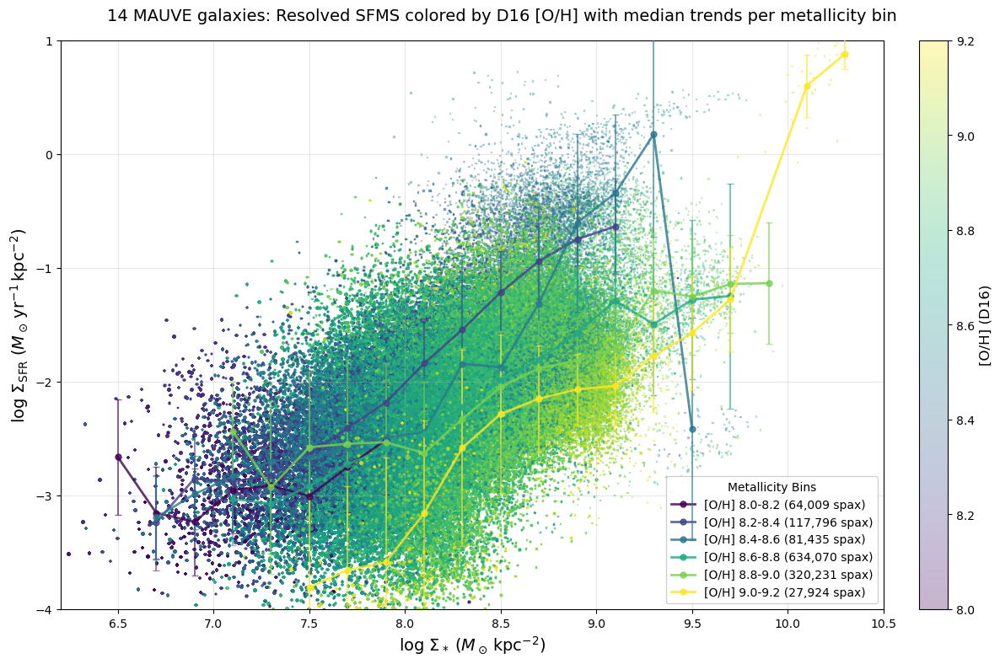


SUMMARY STATISTICS BY METALLICITY BINS
[O/H] Range     N_spax     Med_bins   ΣSFR_range           Slope     
--------------------------------------------------------------------------------
8.0-8.2         64,009     8          -3.23 to -2.51       0.226     
8.2-8.4         117,796    13         -3.24 to -0.64       1.140     
8.4-8.6         81,435     15         -3.20 to 0.17        0.918     
8.6-8.8         634,070    14         -3.07 to -1.25       0.803     
8.8-9.0         320,231    15         -2.93 to -1.14       0.649     
9.0-9.2         27,924     14         -3.81 to 0.88        1.536     


In [27]:
# ------------------------------------------------------------------
# Combined plot with metallicity binning - D16 rSFMS with median trends per [O/H] bin
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from astropy.io import fits

# 0 · discover galaxies
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_d16 = h['O_H_D16_SF'].data
    return sigM, sigSFR, oh_d16

def calculate_median_statistics(x, y, x_range=(6, 11), bin_width=0.2):
    """Calculate median and std in binned intervals"""
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    
    medians = []
    stds = []
    x_valid = []
    
    for i in range(len(x_bins) - 1):
        mask = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if len(np.unique(x[mask])) >= 10:  # Need at least 10 distinct x values
            y_bin = y[mask]
            medians.append(np.median(y_bin))
            stds.append(np.std(y_bin))
            x_valid.append(x_centers[i])
    
    return np.array(x_valid), np.array(medians), np.array(stds)

# 1 · Collect all data from all galaxies
print("Collecting data from all galaxies...")
all_x, all_y, all_metallicity = [], [], []

for gal in galaxies:
    sigM, sigSFR, oh_d16 = load_maps(gal)
    good_d16 = np.isfinite(sigM) & np.isfinite(oh_d16) & np.isfinite(sigSFR)
    
    if np.any(good_d16):
        # For SFMS: x = stellar mass surface density, y = SFR surface density
        x_d16, y_d16, met_d16 = sigM[good_d16], sigSFR[good_d16], oh_d16[good_d16]
        all_x.extend(x_d16)
        all_y.extend(y_d16)
        all_metallicity.extend(met_d16)

all_x, all_y, all_metallicity = np.array(all_x), np.array(all_y), np.array(all_metallicity)
print(f"Total spaxels collected: {len(all_x):,}")

# 2 · Define metallicity bins with 0.2 dex width
met_bin_edges = np.arange(8.0, 9.2 + 0.2, 0.2)  # 8.0 to 9.2 with 0.2 width
met_bin_centers = (met_bin_edges[:-1] + met_bin_edges[1:]) / 2
n_met_bins = len(met_bin_centers)

print(f"Metallicity bins defined: {n_met_bins} bins from {met_bin_edges[0]:.1f} to {met_bin_edges[-1]:.1f}")

# 3 · Create the combined plot
fig, ax = plt.subplots(figsize=(12, 8))

# Background scatter plot colored by D16 metallicity (with reduced alpha for background)
scatter = ax.scatter(all_x, all_y, c=all_metallicity, s=1, alpha=0.3, marker=',', 
                    cmap='viridis', vmin=8.0, vmax=9.2, zorder=1)

# 4 · Calculate and plot median trends for each metallicity bin
# Create colormap for the median trend lines
trend_colors = plt.cm.viridis(np.linspace(0, 1, n_met_bins))

print("\nCalculating median trends for each metallicity bin:")
for i, (met_min, met_max) in enumerate(zip(met_bin_edges[:-1], met_bin_edges[1:])):
    # Create mask for this metallicity bin
    met_mask = (all_metallicity >= met_min) & (all_metallicity < met_max)
    
    if not np.any(met_mask):
        print(f"  Bin {met_min:.1f}-{met_max:.1f}: no valid data points")
        continue
    
    x_bin = all_x[met_mask]
    y_bin = all_y[met_mask]
    n_spax = len(x_bin)
    
    print(f"  Bin {met_min:.1f}-{met_max:.1f}: {n_spax:,} spaxels")
    
    # Calculate median statistics for this metallicity bin
    x_median, y_median, y_std = calculate_median_statistics(x_bin, y_bin, x_range=(6, 11), bin_width=0.2)
    
    if len(x_median) > 0:
        # Plot median trend line with error bars
        color = trend_colors[i]
        label = f'[O/H] {met_min:.1f}-{met_max:.1f} ({n_spax:,} spax)'
        
        # Plot the median trend line
        ax.plot(x_median, y_median, 'o-', color=color, linewidth=2, 
               markersize=5, alpha=0.8, zorder=10, label=label)
        
        # Add error bars
        ax.errorbar(x_median, y_median, yerr=y_std, 
                   fmt='none', color=color, alpha=0.6, capsize=3, zorder=9)

# 5 · Formatting
ax.set_xlim(6.2, 10.5)
ax.set_ylim(-4, 1)
ax.grid(True, alpha=0.3)

# Add colorbar for the background scatter
cbar = plt.colorbar(scatter, ax=ax, fraction=0.046, pad=0.04)
cbar.set_label(r'[O/H] (D16)', fontsize=12)

# Add legend for metallicity trends
handles, labels = ax.get_legend_handles_labels()
if handles:  # Only if we have metallicity trends
    legend = ax.legend(handles, labels, fontsize=10, loc='lower right',
                      title='Metallicity Bins', framealpha=0.9, ncol=1)

# Global title and labels
fig.suptitle(fr'{ngal} MAUVE galaxies: Resolved SFMS colored by D16 [O/H] with median trends per metallicity bin', 
             fontsize=14)

# Axis labels
ax.set_xlabel(r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', fontsize=14)
ax.set_ylabel(r'$\log\,\Sigma_{\mathrm{SFR}} \; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', fontsize=14)

plt.tight_layout()
plt.show()

# 6 · Print summary statistics
print("\n" + "="*80)
print("SUMMARY STATISTICS BY METALLICITY BINS")
print("="*80)
print(f"{'[O/H] Range':<15} {'N_spax':<10} {'Med_bins':<10} {'ΣSFR_range':<20} {'Slope':<10}")
print("-"*80)

for i, (met_min, met_max) in enumerate(zip(met_bin_edges[:-1], met_bin_edges[1:])):
    met_mask = (all_metallicity >= met_min) & (all_metallicity < met_max)
    
    if not np.any(met_mask):
        continue
    
    x_bin = all_x[met_mask]
    y_bin = all_y[met_mask]
    n_spax = len(x_bin)
    
    x_median, y_median, y_std = calculate_median_statistics(x_bin, y_bin, x_range=(6, 11), bin_width=0.2)
    
    if len(x_median) > 2:
        # Calculate slope of the median trend
        slope, intercept = np.polyfit(x_median, y_median, 1)
        sfr_range = f"{y_median.min():.2f} to {y_median.max():.2f}"
        slope_str = f"{slope:.3f}"
    else:
        sfr_range = "N/A"
        slope_str = "N/A"
    
    bin_label = f"{met_min:.1f}-{met_max:.1f}"
    n_med_bins = len(x_median)
    
    print(f"{bin_label:<15} {n_spax:<10,} {n_med_bins:<10} {sfr_range:<20} {slope_str:<10}")

print("="*80)

Total spaxels collected: 1,249,620
Metallicity bins defined: 6 bins from 8.0 to 9.2

Calculating median trends for each metallicity bin:
  Bin 8.0-8.2: 14,033 spaxels
  Bin 8.2-8.4: 176,649 spaxels
  Bin 8.4-8.6: 674,821 spaxels
  Bin 8.6-8.8: 381,460 spaxels
  Bin 8.8-9.0: 2,644 spaxels
  Bin 9.0-9.2: no valid data points


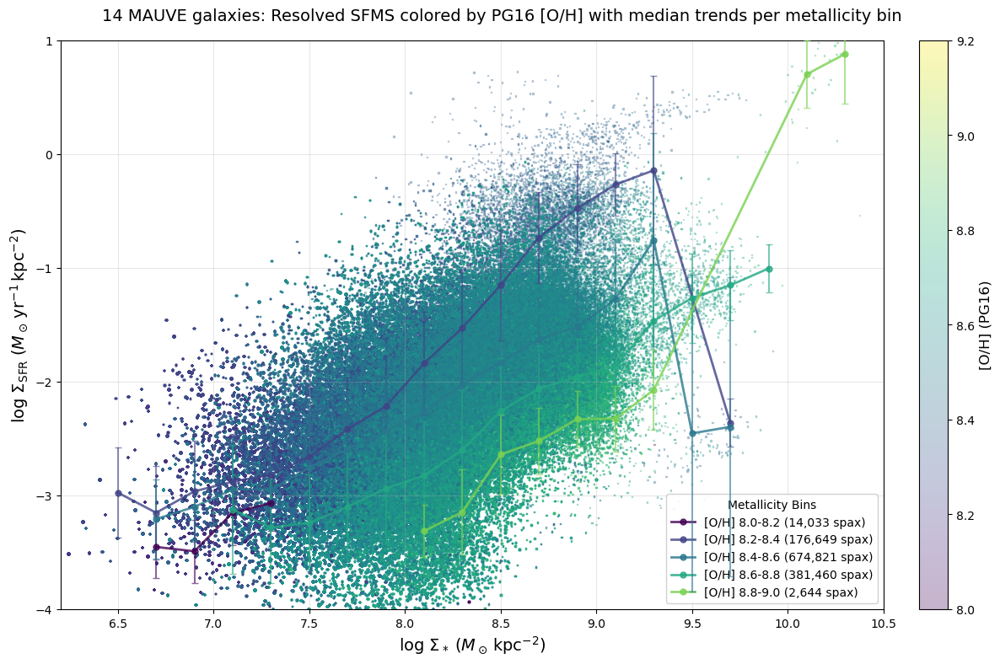


SUMMARY STATISTICS BY METALLICITY BINS
[O/H] Range     N_spax     Med_bins   ΣSFR_range           Slope     
--------------------------------------------------------------------------------
8.0-8.2         14,033     4          -3.49 to -3.07       0.746     
8.2-8.4         176,649    16         -3.15 to -0.14       0.870     
8.4-8.6         674,821    16         -3.21 to -0.76       0.553     
8.6-8.8         381,460    15         -3.28 to -1.01       0.884     
8.8-9.0         2,644      9          -3.31 to 0.88        1.964     


In [28]:
# ------------------------------------------------------------------
# Combined plot with metallicity binning - PG16 rSFMS with median trends per [O/H] bin
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from astropy.io import fits

# 0 · discover galaxies
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_pg16 = h['O_H_PG16_SF'].data
    return sigM, sigSFR, oh_pg16

def calculate_median_statistics(x, y, x_range=(6, 11), bin_width=0.2):
    """Calculate median and std in binned intervals"""
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    
    medians = []
    stds = []
    x_valid = []
    
    for i in range(len(x_bins) - 1):
        mask = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if len(np.unique(x[mask])) >= 10:  # Need at least 10 distinct x values
            y_bin = y[mask]
            medians.append(np.median(y_bin))
            stds.append(np.std(y_bin))
            x_valid.append(x_centers[i])
    
    return np.array(x_valid), np.array(medians), np.array(stds)

# 1 · Collect all data from all galaxies
print("Collecting data from all galaxies...")
all_x, all_y, all_metallicity = [], [], []

for gal in galaxies:
    sigM, sigSFR, oh_pg16 = load_maps(gal)
    good_pg16 = np.isfinite(sigM) & np.isfinite(oh_pg16) & np.isfinite(sigSFR)
    
    if np.any(good_pg16):
        # For SFMS: x = stellar mass surface density, y = SFR surface density
        x_pg16, y_pg16, met_pg16 = sigM[good_pg16], sigSFR[good_pg16], oh_pg16[good_pg16]
        all_x.extend(x_pg16)
        all_y.extend(y_pg16)
        all_metallicity.extend(met_pg16)

all_x, all_y, all_metallicity = np.array(all_x), np.array(all_y), np.array(all_metallicity)
print(f"Total spaxels collected: {len(all_x):,}")

# 2 · Define metallicity bins with 0.2 dex width
met_bin_edges = np.arange(8.0, 9.2 + 0.2, 0.2)  # 8.0 to 9.2 with 0.2 width
met_bin_centers = (met_bin_edges[:-1] + met_bin_edges[1:]) / 2
n_met_bins = len(met_bin_centers)

print(f"Metallicity bins defined: {n_met_bins} bins from {met_bin_edges[0]:.1f} to {met_bin_edges[-1]:.1f}")

# 3 · Create the combined plot
fig, ax = plt.subplots(figsize=(12, 8))

# Background scatter plot colored by PG16 metallicity (with reduced alpha for background)
scatter = ax.scatter(all_x, all_y, c=all_metallicity, s=1, alpha=0.3, marker=',', 
                    cmap='viridis', vmin=8.0, vmax=9.2, zorder=1)

# 4 · Calculate and plot median trends for each metallicity bin
# Create colormap for the median trend lines
trend_colors = plt.cm.viridis(np.linspace(0, 1, n_met_bins))

print("\nCalculating median trends for each metallicity bin:")
for i, (met_min, met_max) in enumerate(zip(met_bin_edges[:-1], met_bin_edges[1:])):
    # Create mask for this metallicity bin
    met_mask = (all_metallicity >= met_min) & (all_metallicity < met_max)
    
    if not np.any(met_mask):
        print(f"  Bin {met_min:.1f}-{met_max:.1f}: no valid data points")
        continue
    
    x_bin = all_x[met_mask]
    y_bin = all_y[met_mask]
    n_spax = len(x_bin)
    
    print(f"  Bin {met_min:.1f}-{met_max:.1f}: {n_spax:,} spaxels")
    
    # Calculate median statistics for this metallicity bin
    x_median, y_median, y_std = calculate_median_statistics(x_bin, y_bin, x_range=(6, 11), bin_width=0.2)
    
    if len(x_median) > 0:
        # Plot median trend line with error bars
        color = trend_colors[i]
        label = f'[O/H] {met_min:.1f}-{met_max:.1f} ({n_spax:,} spax)'
        
        # Plot the median trend line
        ax.plot(x_median, y_median, 'o-', color=color, linewidth=2, 
               markersize=5, alpha=0.8, zorder=10, label=label)
        
        # Add error bars
        ax.errorbar(x_median, y_median, yerr=y_std, 
                   fmt='none', color=color, alpha=0.6, capsize=3, zorder=9)

# 5 · Formatting
ax.set_xlim(6.2, 10.5)
ax.set_ylim(-4, 1)
ax.grid(True, alpha=0.3)

# Add colorbar for the background scatter
cbar = plt.colorbar(scatter, ax=ax, fraction=0.046, pad=0.04)
cbar.set_label(r'[O/H] (PG16)', fontsize=12)

# Add legend for metallicity trends
handles, labels = ax.get_legend_handles_labels()
if handles:  # Only if we have metallicity trends
    legend = ax.legend(handles, labels, fontsize=10, loc='lower right',
                      title='Metallicity Bins', framealpha=0.9, ncol=1)

# Global title and labels
fig.suptitle(fr'{ngal} MAUVE galaxies: Resolved SFMS colored by PG16 [O/H] with median trends per metallicity bin', 
             fontsize=14)

# Axis labels
ax.set_xlabel(r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', fontsize=14)
ax.set_ylabel(r'$\log\,\Sigma_{\mathrm{SFR}} \; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', fontsize=14)

plt.tight_layout()
plt.show()

# 6 · Print summary statistics
print("\n" + "="*80)
print("SUMMARY STATISTICS BY METALLICITY BINS")
print("="*80)
print(f"{'[O/H] Range':<15} {'N_spax':<10} {'Med_bins':<10} {'ΣSFR_range':<20} {'Slope':<10}")
print("-"*80)

for i, (met_min, met_max) in enumerate(zip(met_bin_edges[:-1], met_bin_edges[1:])):
    met_mask = (all_metallicity >= met_min) & (all_metallicity < met_max)
    
    if not np.any(met_mask):
        continue
    
    x_bin = all_x[met_mask]
    y_bin = all_y[met_mask]
    n_spax = len(x_bin)
    
    x_median, y_median, y_std = calculate_median_statistics(x_bin, y_bin, x_range=(6, 11), bin_width=0.2)
    
    if len(x_median) > 2:
        # Calculate slope of the median trend
        slope, intercept = np.polyfit(x_median, y_median, 1)
        sfr_range = f"{y_median.min():.2f} to {y_median.max():.2f}"
        slope_str = f"{slope:.3f}"
    else:
        sfr_range = "N/A"
        slope_str = "N/A"
    
    bin_label = f"{met_min:.1f}-{met_max:.1f}"
    n_med_bins = len(x_median)
    
    print(f"{bin_label:<15} {n_spax:<10,} {n_med_bins:<10} {sfr_range:<20} {slope_str:<10}")

print("="*80)

## Make PG16 adapt to Koller+2024

Total spaxels collected: 1,249,620


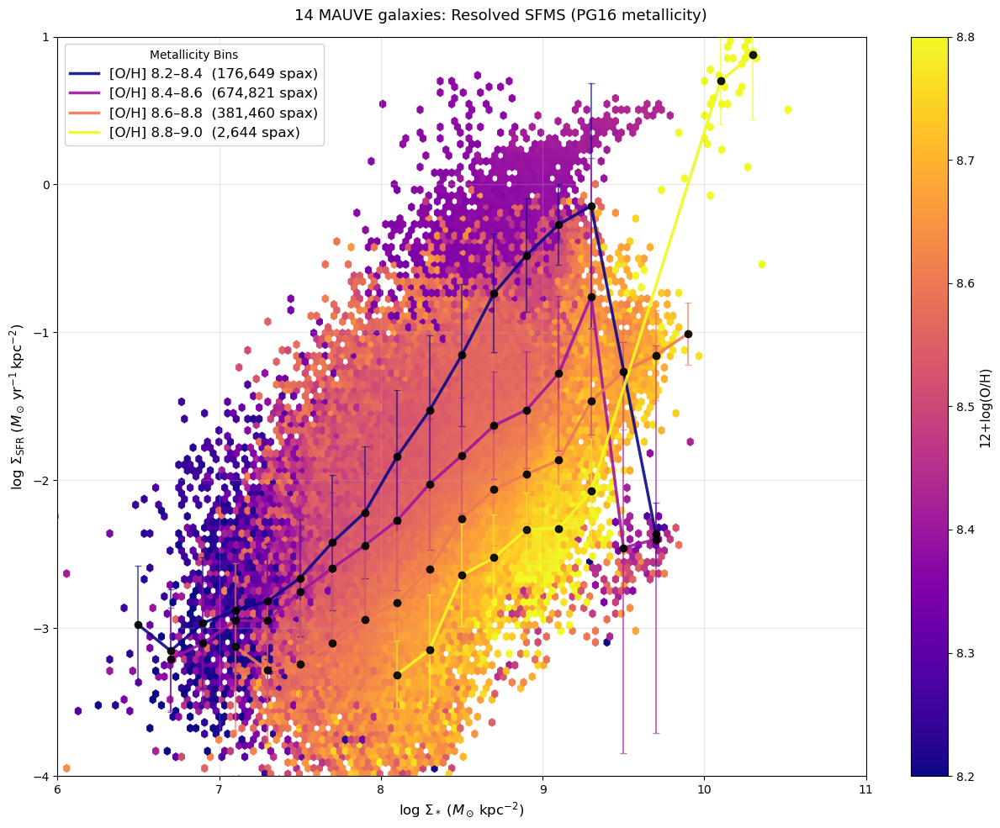

In [29]:
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from astropy.io import fits

# ------------------------------------------------------------
# 0 · Discover galaxies and set helper
# ------------------------------------------------------------
bins     = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal     = len(galaxies)

def load_maps(gal):
    """Return Σ*, Σ_SFR, and [O/H]_PG16 for one galaxy."""
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR   = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_pg16  = h['O_H_PG16_SF'].data
    return sigM, sigSFR, oh_pg16

# ------------------------------------------------------------
# 1 · Collect all spaxels
# ------------------------------------------------------------
print("Collecting data from all galaxies …")
all_x, all_y, all_metallicity = [], [], []

for gal in galaxies:
    sigM, sigSFR, oh_pg16 = load_maps(gal)
    mask = np.isfinite(sigM) & np.isfinite(sigSFR) & np.isfinite(oh_pg16)
    all_x.extend(sigM[mask])
    all_y.extend(sigSFR[mask])
    all_metallicity.extend(oh_pg16[mask])

all_x, all_y, all_metallicity = map(np.asarray, [all_x, all_y, all_metallicity])
print(f"Total spaxels collected: {len(all_x):,}")

# ------------------------------------------------------------
# 2 · Set metallicity bins (0.2-dex) for median trends
# ------------------------------------------------------------
met_bin_edges   = np.arange(8.2, 8.8 + 0.2, 0.2)
met_bin_centers = (met_bin_edges[:-1] + met_bin_edges[1:]) / 2
n_met_bins      = len(met_bin_centers)

# ------------------------------------------------------------
# 3 · Utilities
# ------------------------------------------------------------
def calculate_median_statistics(x, y, x_range=(6, 11), bin_width=0.2):
    """Calculate median and std in binned intervals"""
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    
    medians = []
    stds = []
    x_valid = []
    
    for i in range(len(x_bins) - 1):
        mask = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if len(np.unique(x[mask])) >= 10:  # Need at least 10 distinct x values
            y_bin = y[mask]
            medians.append(np.median(y_bin))
            stds.append(np.std(y_bin))
            x_valid.append(x_centers[i])
    
    return np.array(x_valid), np.array(medians), np.array(stds)

# ------------------------------------------------------------
# 4 · Make the figure
# ------------------------------------------------------------
fig, ax = plt.subplots(figsize=(12, 10))   # square like the thumbnail

# Background hexbin plot to avoid point occlusion
hexbin = ax.hexbin(
    all_x, all_y,
    C=all_metallicity,
    gridsize=128,
    cmap='plasma',
    vmin=8.2, vmax=8.8,
    reduce_C_function=np.median,
    alpha=1,
    zorder=1
)

# Trend colours drawn from the same colormap
trend_colors = plt.cm.plasma(np.linspace(0, 1, n_met_bins))

# Median trends per metallicity bin
for (met_min, met_max), col in zip(zip(met_bin_edges[:-1], met_bin_edges[1:]),
                                   trend_colors):
    sel = (all_metallicity >= met_min) & (all_metallicity < met_max)
    if not sel.any():
        continue
    x_med, y_med, y_sig = calculate_median_statistics(all_x[sel], all_y[sel])
    if x_med.size < 2:
        continue

    label = fr'[O/H] {met_min:.1f}–{met_max:.1f}  ({sel.sum():,} spax)'
    
    # Plot colored line connecting the points
    ax.plot(x_med, y_med, color=col, lw=2.5, alpha=0.9, label=label, zorder=10)
    
    # Plot black points to highlight the median values
    ax.plot(x_med, y_med, 'ko', ms=6, alpha=0.9, zorder=11)
    
    # Add error bars in the same color as the line but with lower alpha
    ax.errorbar(x_med, y_med, yerr=y_sig, fmt='none',
                ecolor=col, alpha=0.6, capsize=3, zorder=9)

# ------------------------------------------------------------
# 5 · Cosmetics (adapt to Koller+2024)
# ------------------------------------------------------------
ax.set_xlim(6, 11)
ax.set_ylim(-4, 1)
ax.set_xlabel(r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', fontsize=12)
ax.set_ylabel(r'$\log\,\Sigma_{\mathrm{SFR}} \; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', fontsize=12)
ax.grid(True, alpha=0.3)

cbar = fig.colorbar(hexbin, ax=ax, fraction=0.046)
cbar.set_label(r'12+log(O/H)', fontsize=11)

handles, labels = ax.get_legend_handles_labels()
if handles:
    ax.legend(handles, labels, fontsize=12, title='Metallicity Bins',
              framealpha=0.9, loc='upper left')

fig.suptitle(fr'{ngal} MAUVE galaxies: Resolved SFMS (PG16 metallicity)',
             fontsize=13)
plt.tight_layout()
plt.show()

## Check the [O/H] - $\Sigma_{\rm SFR}$ to see any dependence

/var/folders/rm/clp89v210v32vh5vjt2kx7b80000gr/T/ipykernel_65174/2670676398.py:256: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])


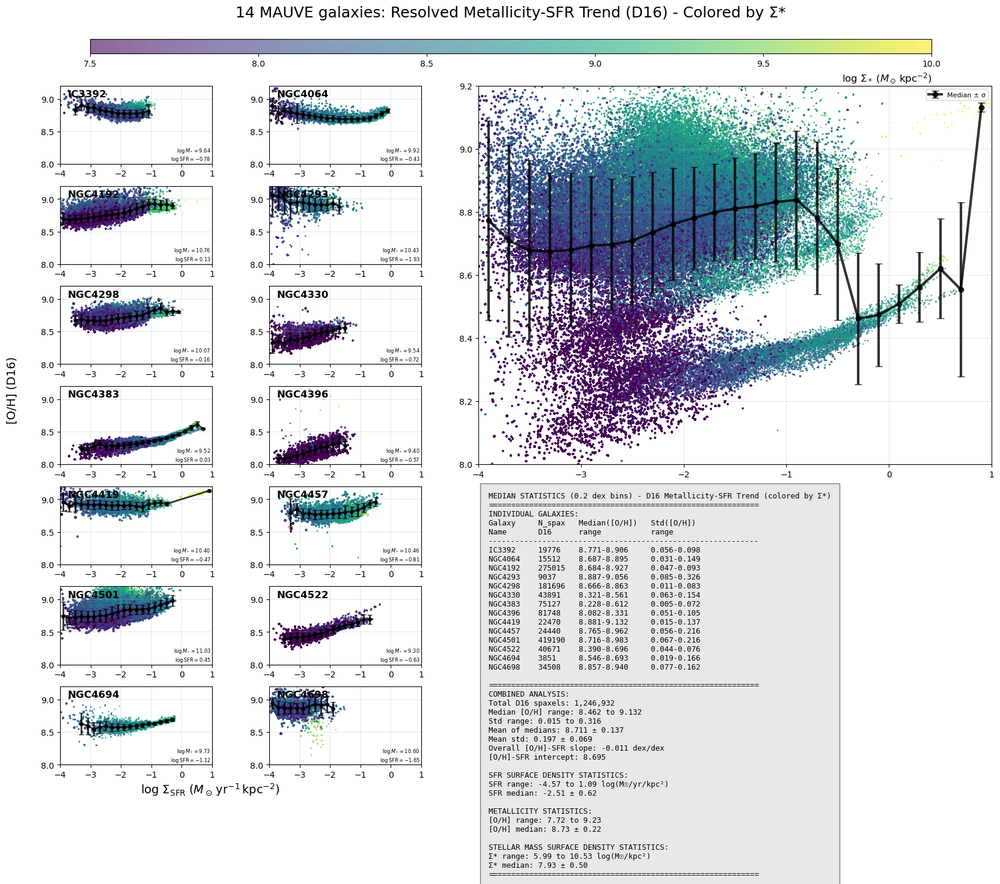

In [30]:
# ------------------------------------------------------------------
# COMPREHENSIVE LAYOUT: Individual galaxies + Combined plot + Statistics (D16 [O/H] vs SFR - colored by Σ_*)
# 4-column layout: Cols 1-2 = Individual galaxies, Col 3 = Combined plot, Col 4 = Statistics
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from pathlib import Path
from astropy.io import fits
import itertools
import re  # Add this import for regex

# 0 · discover galaxies & colour palette
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)
assert ngal <= 14, "This layout assumes ≤ 14 galaxies."

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_d16 = h['O_H_D16_SF'].data
    return sigM, sigSFR, oh_d16

# Extraction functions for log files
def extract_total_stellar_mass(galaxy_name):
    """Extract total stellar mass from mass log file. Returns log10(M☉) value or None if not found."""
    log_file = Path(f'mass_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total stellar mass \(R\)\s*:\s*([\d.-]+)\s*log10\(M☉\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading mass log for {galaxy_name}: {e}")
        return None

def extract_total_sfr(galaxy_name):
    """Extract total SFR from SFR log file. Returns log10(M☉/yr) value or None if not found."""
    log_file = Path(f'sfr_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total Halpha SFR from SF region:.*?in log10 scale:\s*([\d.-]+)\s*log\(M☉/yr\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading SFR log for {galaxy_name}: {e}")
        return None

def calculate_median_statistics(x, y, x_range=(-4, 1), bin_width=0.2):
    """Calculate median and std in binned intervals"""
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    
    medians = []
    stds = []
    x_valid = []
    
    for i in range(len(x_bins) - 1):
        mask = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if len(np.unique(x[mask])) >= 10:  # Need at least 10 distinct x values
            y_bin = y[mask]
            medians.append(np.median(y_bin))
            stds.append(np.std(y_bin))
            x_valid.append(x_centers[i])
    
    return np.array(x_valid), np.array(medians), np.array(stds)

# 1 · Create comprehensive figure with 4-column layout
fig = plt.figure(figsize=(20, 16))
gs = GridSpec(nrows=8, ncols=4, figure=fig,
              width_ratios=[1, 1, 1.5, 1.5],  # Cols 3&4 slightly wider
              height_ratios=[0.5, 1, 1, 1, 1, 1, 1, 1],  # Row 0 for colorbar
              wspace=0.3, hspace=0.3)

plot_idx = 0
scatter_for_cbar = None
individual_stats = []

# COLUMNS 1-2: Individual galaxy plots
for idx, gal in enumerate(galaxies):
    sigM, sigSFR, oh_d16 = load_maps(gal)
    
    good_d16 = np.isfinite(sigM) & np.isfinite(sigSFR) & np.isfinite(oh_d16)
    
    if not np.any(good_d16):
        print(f"Skipping {gal}: no valid data points")
        continue
    
    row = (plot_idx // 2) + 1  # Start from row 1 (row 0 for colorbar)
    col = plot_idx % 2
    plot_idx += 1

    axP = fig.add_subplot(gs[row, col])
    
    # For metallicity-SFR trend: x = SFR surface density, y = metallicity [O/H], color = stellar mass surface density
    x_d16, y_d16, color_d16 = sigSFR[good_d16], oh_d16[good_d16], sigM[good_d16]
    
    # Calculate median statistics
    x_median, y_median, y_std = calculate_median_statistics(x_d16, y_d16)
    individual_stats.append((gal, x_median, y_median, y_std, len(x_d16)))
    
    # Scatter plot colored by stellar mass surface density
    scatter = axP.scatter(x_d16, y_d16, c=color_d16, s=1, alpha=0.6, marker=',', 
                         cmap='viridis', vmin=7.5, vmax=10)
    
    # Plot median with error bars
    if len(x_median) > 0:
        axP.errorbar(x_median, y_median, yerr=y_std, fmt='ko-', linewidth=2, 
                    markersize=4, capsize=3, alpha=0.8)
    
    if scatter_for_cbar is None:
        scatter_for_cbar = scatter
    
    # Add galaxy name in top left corner
    axP.text(0.05, 0.95, gal, transform=axP.transAxes, fontsize=12, fontweight='bold',
             va='top', ha='left', bbox=dict(boxstyle='round,pad=0.3', facecolor='none', alpha=0.8, edgecolor='none'))
    
    # Bottom right: total stellar mass and SFR from log files
    total_mass = extract_total_stellar_mass(gal)
    total_sfr = extract_total_sfr(gal)
    
    if total_mass is not None and total_sfr is not None:
        log_text = fr'$\log M_* = {total_mass:.2f}$' '\n' fr'$\log \mathrm{{SFR}} = {total_sfr:.2f}$'
        axP.text(0.99, 0.01, log_text,
                 transform=axP.transAxes, va='bottom', ha='right', fontsize=6,
                 bbox=dict(facecolor='none', alpha=0.8, edgecolor='none', pad=2))
    
    axP.set_xlim(-4, 1)
    axP.set_ylim(8.0, 9.2)
    axP.grid(True, lw=0.25)

# COLUMNS 3-4: Combined plot - Upper panel
ax_combined = fig.add_subplot(gs[1:5, 2:4])  # Spans rows 1-4, columns 2-3

# Collect all data for combined analysis
all_x, all_y, all_color = [], [], []
galaxy_counts = {}

for gal in galaxies:
    sigM, sigSFR, oh_d16 = load_maps(gal)
    good_d16 = np.isfinite(sigM) & np.isfinite(sigSFR) & np.isfinite(oh_d16)
    
    if np.any(good_d16):
        x_d16, y_d16, color_d16 = sigSFR[good_d16], oh_d16[good_d16], sigM[good_d16]
        all_x.extend(x_d16)
        all_y.extend(y_d16)
        all_color.extend(color_d16)
        galaxy_counts[gal] = len(x_d16)
    else:
        galaxy_counts[gal] = 0

all_x, all_y, all_color = np.array(all_x), np.array(all_y), np.array(all_color)

# Calculate combined median statistics
x_median_combined, y_median_combined, y_std_combined = calculate_median_statistics(all_x, all_y)

# Scatter plot colored by stellar mass surface density for combined data
scatter_combined = ax_combined.scatter(all_x, all_y, c=all_color, s=1, alpha=0.6, marker=',', 
                                      cmap='viridis', vmin=7.5, vmax=10)

# Plot combined median with error bars
if len(x_median_combined) > 0:
    ax_combined.errorbar(x_median_combined, y_median_combined, yerr=y_std_combined, 
                        fmt='ko-', linewidth=3, markersize=6, capsize=4, alpha=0.8, label='Median ± σ')

# Add legend with small font
ax_combined.legend(fontsize=8, ncol=1, loc='upper right')

ax_combined.set_xlim(-4, 1)
ax_combined.set_ylim(8.0, 9.2)
ax_combined.grid(True, alpha=0.3)

# COLUMNS 3-4: Statistics table - Lower panel
ax_stats = fig.add_subplot(gs[5:8, 2:4])  # Spans rows 5-7, columns 2-3
ax_stats.axis('off')

# Create comprehensive statistics text
stats_table = "MEDIAN STATISTICS (0.2 dex bins) - D16 Metallicity-SFR Trend (colored by Σ*)\n"
stats_table += "="*60 + "\n"
stats_table += "INDIVIDUAL GALAXIES:\n"
stats_table += f"{'Galaxy':<10} {'N_spax':<8} {'Median([O/H])':<15} {'Std([O/H])':<15}\n"
stats_table += f"{'Name':<10} {'D16':<8} {'range':<15} {'range':<15}\n"
stats_table += "-"*60 + "\n"

for gal, x_median, y_median, y_std, n_spax in individual_stats:
    if len(y_median) > 0:
        median_range = f"{y_median.min():.3f}-{y_median.max():.3f}"
        std_range = f"{y_std.min():.3f}-{y_std.max():.3f}"
    else:
        median_range = "N/A"
        std_range = "N/A"
    
    stats_table += f"{gal:<10} {n_spax:<8} {median_range:<15} {std_range:<15}\n"

stats_table += "\n" + "="*60 + "\n"
stats_table += "COMBINED ANALYSIS:\n"
stats_table += f"Total D16 spaxels: {len(all_x):,}\n"
if len(y_median_combined) > 0:
    stats_table += f"Median [O/H] range: {y_median_combined.min():.3f} to {y_median_combined.max():.3f}\n"
    stats_table += f"Std range: {y_std_combined.min():.3f} to {y_std_combined.max():.3f}\n"
    stats_table += f"Mean of medians: {np.mean(y_median_combined):.3f} ± {np.std(y_median_combined):.3f}\n"
    stats_table += f"Mean std: {np.mean(y_std_combined):.3f} ± {np.std(y_std_combined):.3f}\n"
    
    # Calculate overall metallicity-SFR gradient (slope)
    if len(x_median_combined) > 3:
        slope, intercept = np.polyfit(x_median_combined, y_median_combined, 1)
        stats_table += f"Overall [O/H]-SFR slope: {slope:.3f} dex/dex\n"
        stats_table += f"[O/H]-SFR intercept: {intercept:.3f}\n"

# Add statistics
stats_table += f"\nSFR SURFACE DENSITY STATISTICS:\n"
stats_table += f"SFR range: {all_x.min():.2f} to {all_x.max():.2f} log(M☉/yr/kpc²)\n"
stats_table += f"SFR median: {np.median(all_x):.2f} ± {np.std(all_x):.2f}\n"

stats_table += f"\nMETALLICITY STATISTICS:\n"
stats_table += f"[O/H] range: {all_y.min():.2f} to {all_y.max():.2f}\n"
stats_table += f"[O/H] median: {np.median(all_y):.2f} ± {np.std(all_y):.2f}\n"

stats_table += f"\nSTELLAR MASS SURFACE DENSITY STATISTICS:\n"
stats_table += f"Σ* range: {all_color.min():.2f} to {all_color.max():.2f} log(M☉/kpc²)\n"
stats_table += f"Σ* median: {np.median(all_color):.2f} ± {np.std(all_color):.2f}\n"
        
stats_table += "="*60

ax_stats.text(0.02, 0.98, stats_table, transform=ax_stats.transAxes, va='top', ha='left',
              fontsize=9, family='monospace',
              bbox=dict(facecolor='lightgray', alpha=0.5, edgecolor='black', pad=10))

# Add horizontal colorbar at the top
if scatter_for_cbar is not None:
    cbar_ax = fig.add_axes([0.15, 0.85, 0.7, 0.015])
    cbar = plt.colorbar(scatter_for_cbar, cax=cbar_ax, orientation='horizontal')
    cbar.set_label(r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', fontsize=12, loc='right')

# Global title and labels
fig.suptitle(fr'{ngal} MAUVE galaxies: Resolved Metallicity-SFR Trend (D16) - Colored by Σ*', 
             fontsize=18, y=0.90)

# Shared axis labels
fig.text(0.25, 0.08, r'$\log\,\Sigma_{\mathrm{SFR}} \; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', 
         ha='center', fontsize=14)
fig.text(0.08, 0.5, r'[O/H] (D16)', 
         va='center', rotation='vertical', fontsize=14)

plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])
plt.show()

/var/folders/rm/clp89v210v32vh5vjt2kx7b80000gr/T/ipykernel_65174/1326016952.py:256: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])


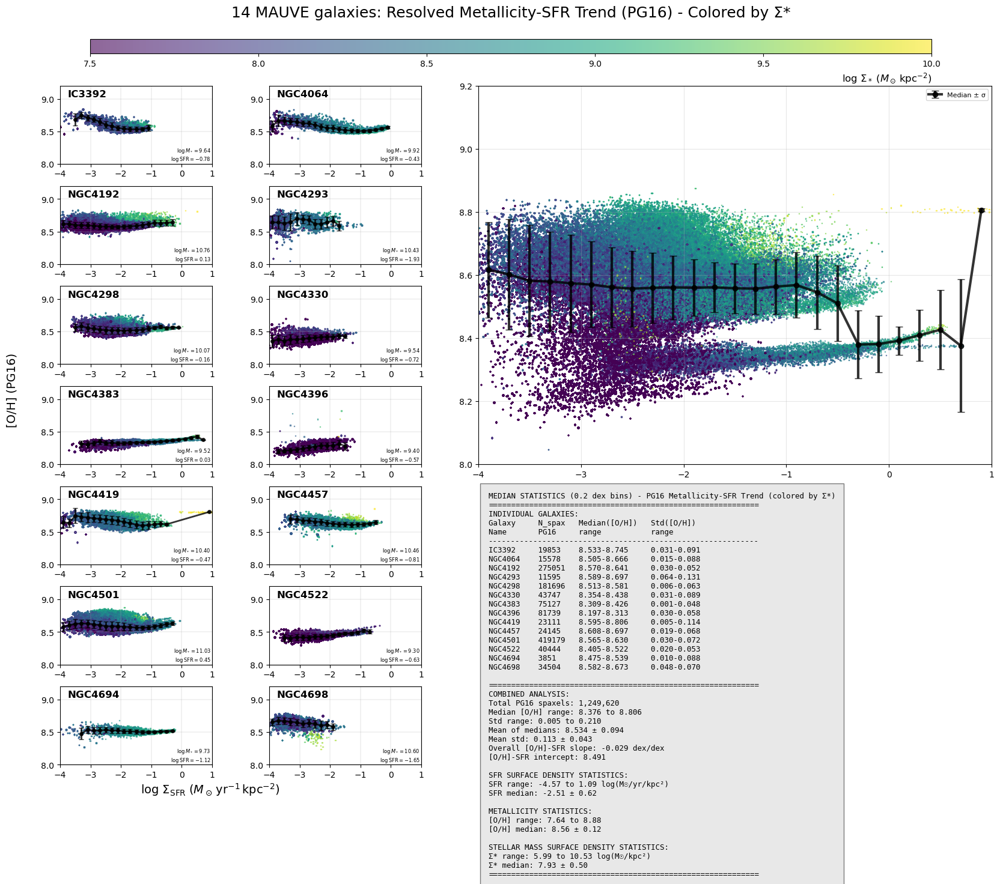

In [31]:
# ------------------------------------------------------------------
# COMPREHENSIVE LAYOUT: Individual galaxies + Combined plot + Statistics (PG16 [O/H] vs SFR - colored by Σ_*)
# 4-column layout: Cols 1-2 = Individual galaxies, Col 3 = Combined plot, Col 4 = Statistics
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from pathlib import Path
from astropy.io import fits
import itertools
import re  # Add this import for regex

# 0 · discover galaxies & colour palette
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)
assert ngal <= 14, "This layout assumes ≤ 14 galaxies."

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_pg16 = h['O_H_PG16_SF'].data
    return sigM, sigSFR, oh_pg16

# Extraction functions for log files
def extract_total_stellar_mass(galaxy_name):
    """Extract total stellar mass from mass log file. Returns log10(M☉) value or None if not found."""
    log_file = Path(f'mass_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total stellar mass \(R\)\s*:\s*([\d.-]+)\s*log10\(M☉\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading mass log for {galaxy_name}: {e}")
        return None

def extract_total_sfr(galaxy_name):
    """Extract total SFR from SFR log file. Returns log10(M☉/yr) value or None if not found."""
    log_file = Path(f'sfr_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total Halpha SFR from SF region:.*?in log10 scale:\s*([\d.-]+)\s*log\(M☉/yr\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading SFR log for {galaxy_name}: {e}")
        return None

def calculate_median_statistics(x, y, x_range=(-4, 1), bin_width=0.2):
    """Calculate median and std in binned intervals"""
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    
    medians = []
    stds = []
    x_valid = []
    
    for i in range(len(x_bins) - 1):
        mask = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if len(np.unique(x[mask])) >= 10:  # Need at least 10 distinct x values
            y_bin = y[mask]
            medians.append(np.median(y_bin))
            stds.append(np.std(y_bin))
            x_valid.append(x_centers[i])
    
    return np.array(x_valid), np.array(medians), np.array(stds)

# 1 · Create comprehensive figure with 4-column layout
fig = plt.figure(figsize=(20, 16))
gs = GridSpec(nrows=8, ncols=4, figure=fig,
              width_ratios=[1, 1, 1.5, 1.5],  # Cols 3&4 slightly wider
              height_ratios=[0.5, 1, 1, 1, 1, 1, 1, 1],  # Row 0 for colorbar
              wspace=0.3, hspace=0.3)

plot_idx = 0
scatter_for_cbar = None
individual_stats = []

# COLUMNS 1-2: Individual galaxy plots
for idx, gal in enumerate(galaxies):
    sigM, sigSFR, oh_pg16 = load_maps(gal)
    
    good_pg16 = np.isfinite(sigM) & np.isfinite(sigSFR) & np.isfinite(oh_pg16)
    
    if not np.any(good_pg16):
        print(f"Skipping {gal}: no valid data points")
        continue
    
    row = (plot_idx // 2) + 1  # Start from row 1 (row 0 for colorbar)
    col = plot_idx % 2
    plot_idx += 1

    axP = fig.add_subplot(gs[row, col])
    
    # For metallicity-SFR trend: x = SFR surface density, y = metallicity [O/H], color = stellar mass surface density
    x_pg16, y_pg16, color_pg16 = sigSFR[good_pg16], oh_pg16[good_pg16], sigM[good_pg16]
    
    # Calculate median statistics
    x_median, y_median, y_std = calculate_median_statistics(x_pg16, y_pg16)
    individual_stats.append((gal, x_median, y_median, y_std, len(x_pg16)))
    
    # Scatter plot colored by stellar mass surface density
    scatter = axP.scatter(x_pg16, y_pg16, c=color_pg16, s=1, alpha=0.6, marker=',', 
                         cmap='viridis', vmin=7.5, vmax=10)
    
    # Plot median with error bars
    if len(x_median) > 0:
        axP.errorbar(x_median, y_median, yerr=y_std, fmt='ko-', linewidth=2, 
                    markersize=4, capsize=3, alpha=0.8)
    
    if scatter_for_cbar is None:
        scatter_for_cbar = scatter
    
    # Add galaxy name in top left corner
    axP.text(0.05, 0.95, gal, transform=axP.transAxes, fontsize=12, fontweight='bold',
             va='top', ha='left', bbox=dict(boxstyle='round,pad=0.3', facecolor='none', alpha=0.8, edgecolor='none'))
    
    # Bottom right: total stellar mass and SFR from log files
    total_mass = extract_total_stellar_mass(gal)
    total_sfr = extract_total_sfr(gal)
    
    if total_mass is not None and total_sfr is not None:
        log_text = fr'$\log M_* = {total_mass:.2f}$' '\n' fr'$\log \mathrm{{SFR}} = {total_sfr:.2f}$'
        axP.text(0.99, 0.01, log_text,
                 transform=axP.transAxes, va='bottom', ha='right', fontsize=6,
                 bbox=dict(facecolor='none', alpha=0.8, edgecolor='none', pad=2))
    
    axP.set_xlim(-4, 1)
    axP.set_ylim(8.0, 9.2)
    axP.grid(True, lw=0.25)

# COLUMNS 3-4: Combined plot - Upper panel
ax_combined = fig.add_subplot(gs[1:5, 2:4])  # Spans rows 1-4, columns 2-3

# Collect all data for combined analysis
all_x, all_y, all_color = [], [], []
galaxy_counts = {}

for gal in galaxies:
    sigM, sigSFR, oh_pg16 = load_maps(gal)
    good_pg16 = np.isfinite(sigM) & np.isfinite(sigSFR) & np.isfinite(oh_pg16)
    
    if np.any(good_pg16):
        x_pg16, y_pg16, color_pg16 = sigSFR[good_pg16], oh_pg16[good_pg16], sigM[good_pg16]
        all_x.extend(x_pg16)
        all_y.extend(y_pg16)
        all_color.extend(color_pg16)
        galaxy_counts[gal] = len(x_pg16)
    else:
        galaxy_counts[gal] = 0

all_x, all_y, all_color = np.array(all_x), np.array(all_y), np.array(all_color)

# Calculate combined median statistics
x_median_combined, y_median_combined, y_std_combined = calculate_median_statistics(all_x, all_y)

# Scatter plot colored by stellar mass surface density for combined data
scatter_combined = ax_combined.scatter(all_x, all_y, c=all_color, s=1, alpha=0.6, marker=',', 
                                      cmap='viridis', vmin=7.5, vmax=10)

# Plot combined median with error bars
if len(x_median_combined) > 0:
    ax_combined.errorbar(x_median_combined, y_median_combined, yerr=y_std_combined, 
                        fmt='ko-', linewidth=3, markersize=6, capsize=4, alpha=0.8, label='Median ± σ')

# Add legend with small font
ax_combined.legend(fontsize=8, ncol=1, loc='upper right')

ax_combined.set_xlim(-4, 1)
ax_combined.set_ylim(8.0, 9.2)
ax_combined.grid(True, alpha=0.3)

# COLUMNS 3-4: Statistics table - Lower panel
ax_stats = fig.add_subplot(gs[5:8, 2:4])  # Spans rows 5-7, columns 2-3
ax_stats.axis('off')

# Create comprehensive statistics text
stats_table = "MEDIAN STATISTICS (0.2 dex bins) - PG16 Metallicity-SFR Trend (colored by Σ*)\n"
stats_table += "="*60 + "\n"
stats_table += "INDIVIDUAL GALAXIES:\n"
stats_table += f"{'Galaxy':<10} {'N_spax':<8} {'Median([O/H])':<15} {'Std([O/H])':<15}\n"
stats_table += f"{'Name':<10} {'PG16':<8} {'range':<15} {'range':<15}\n"
stats_table += "-"*60 + "\n"

for gal, x_median, y_median, y_std, n_spax in individual_stats:
    if len(y_median) > 0:
        median_range = f"{y_median.min():.3f}-{y_median.max():.3f}"
        std_range = f"{y_std.min():.3f}-{y_std.max():.3f}"
    else:
        median_range = "N/A"
        std_range = "N/A"
    
    stats_table += f"{gal:<10} {n_spax:<8} {median_range:<15} {std_range:<15}\n"

stats_table += "\n" + "="*60 + "\n"
stats_table += "COMBINED ANALYSIS:\n"
stats_table += f"Total PG16 spaxels: {len(all_x):,}\n"
if len(y_median_combined) > 0:
    stats_table += f"Median [O/H] range: {y_median_combined.min():.3f} to {y_median_combined.max():.3f}\n"
    stats_table += f"Std range: {y_std_combined.min():.3f} to {y_std_combined.max():.3f}\n"
    stats_table += f"Mean of medians: {np.mean(y_median_combined):.3f} ± {np.std(y_median_combined):.3f}\n"
    stats_table += f"Mean std: {np.mean(y_std_combined):.3f} ± {np.std(y_std_combined):.3f}\n"
    
    # Calculate overall metallicity-SFR gradient (slope)
    if len(x_median_combined) > 3:
        slope, intercept = np.polyfit(x_median_combined, y_median_combined, 1)
        stats_table += f"Overall [O/H]-SFR slope: {slope:.3f} dex/dex\n"
        stats_table += f"[O/H]-SFR intercept: {intercept:.3f}\n"

# Add statistics
stats_table += f"\nSFR SURFACE DENSITY STATISTICS:\n"
stats_table += f"SFR range: {all_x.min():.2f} to {all_x.max():.2f} log(M☉/yr/kpc²)\n"
stats_table += f"SFR median: {np.median(all_x):.2f} ± {np.std(all_x):.2f}\n"

stats_table += f"\nMETALLICITY STATISTICS:\n"
stats_table += f"[O/H] range: {all_y.min():.2f} to {all_y.max():.2f}\n"
stats_table += f"[O/H] median: {np.median(all_y):.2f} ± {np.std(all_y):.2f}\n"

stats_table += f"\nSTELLAR MASS SURFACE DENSITY STATISTICS:\n"
stats_table += f"Σ* range: {all_color.min():.2f} to {all_color.max():.2f} log(M☉/kpc²)\n"
stats_table += f"Σ* median: {np.median(all_color):.2f} ± {np.std(all_color):.2f}\n"
        
stats_table += "="*60

ax_stats.text(0.02, 0.98, stats_table, transform=ax_stats.transAxes, va='top', ha='left',
              fontsize=9, family='monospace',
              bbox=dict(facecolor='lightgray', alpha=0.5, edgecolor='black', pad=10))

# Add horizontal colorbar at the top
if scatter_for_cbar is not None:
    cbar_ax = fig.add_axes([0.15, 0.85, 0.7, 0.015])
    cbar = plt.colorbar(scatter_for_cbar, cax=cbar_ax, orientation='horizontal')
    cbar.set_label(r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', fontsize=12, loc='right')

# Global title and labels
fig.suptitle(fr'{ngal} MAUVE galaxies: Resolved Metallicity-SFR Trend (PG16) - Colored by Σ*', 
             fontsize=18, y=0.90)

# Shared axis labels
fig.text(0.25, 0.08, r'$\log\,\Sigma_{\mathrm{SFR}} \; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', 
         ha='center', fontsize=14)
fig.text(0.08, 0.5, r'[O/H] (PG16)', 
         va='center', rotation='vertical', fontsize=14)

plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])
plt.show()

/var/folders/rm/clp89v210v32vh5vjt2kx7b80000gr/T/ipykernel_65174/2407988717.py:318: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])


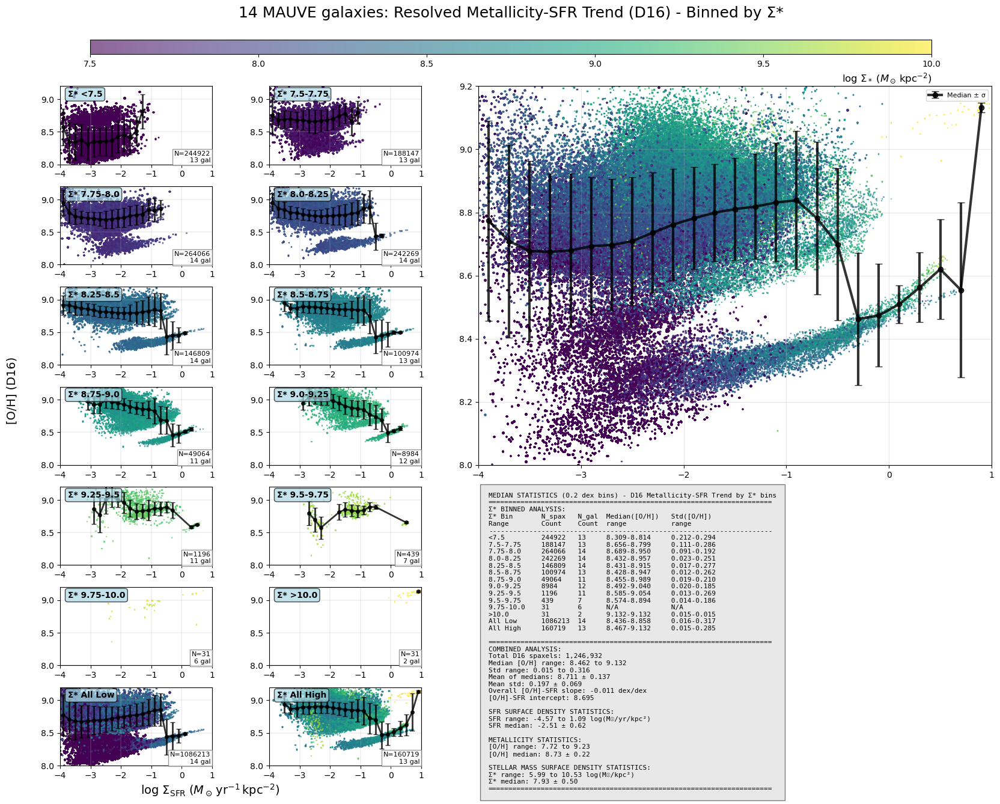

In [32]:
# ------------------------------------------------------------------
# COMPREHENSIVE LAYOUT: Σ* bins + Combined plot + Statistics (D16 [O/H] vs SFR - colored by Σ_*)
# 4-column layout: Cols 1-2 = Σ* bins, Col 3 = Combined plot, Col 4 = Statistics
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from pathlib import Path
from astropy.io import fits
import itertools
import re  # Add this import for regex

# 0 · discover galaxies & colour palette
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_d16 = h['O_H_D16_SF'].data
    return sigM, sigSFR, oh_d16

# Extraction functions for log files
def extract_total_stellar_mass(galaxy_name):
    """Extract total stellar mass from mass log file. Returns log10(M☉) value or None if not found."""
    log_file = Path(f'mass_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total stellar mass \(R\)\s*:\s*([\d.-]+)\s*log10\(M☉\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading mass log for {galaxy_name}: {e}")
        return None

def extract_total_sfr(galaxy_name):
    """Extract total SFR from SFR log file. Returns log10(M☉/yr) value or None if not found."""
    log_file = Path(f'sfr_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total Halpha SFR from SF region:.*?in log10 scale:\s*([\d.-]+)\s*log\(M☉/yr\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading SFR log for {galaxy_name}: {e}")
        return None

def calculate_median_statistics(x, y, x_range=(-4, 1), bin_width=0.2):
    """Calculate median and std in binned intervals"""
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    
    medians = []
    stds = []
    x_valid = []
    
    for i in range(len(x_bins) - 1):
        mask = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if len(np.unique(x[mask])) >= 10:  # Need at least 10 distinct x values
            y_bin = y[mask]
            medians.append(np.median(y_bin))
            stds.append(np.std(y_bin))
            x_valid.append(x_centers[i])
    
    return np.array(x_valid), np.array(medians), np.array(stds)

# Load all data first
all_data = {}
for gal in galaxies:
    sigM, sigSFR, oh_d16 = load_maps(gal)
    good_d16 = np.isfinite(sigM) & np.isfinite(sigSFR) & np.isfinite(oh_d16)
    
    if np.any(good_d16):
        all_data[gal] = {
            'sigSFR': sigSFR[good_d16],
            'oh_d16': oh_d16[good_d16], 
            'sigM': sigM[good_d16]
        }

# Define Σ* bins
sigma_star_bins = [
    ('<7.5', -np.inf, 7.5),
    ('7.5-7.75', 7.5, 7.75),
    ('7.75-8.0', 7.75, 8.0),
    ('8.0-8.25', 8.0, 8.25),
    ('8.25-8.5', 8.25, 8.5),
    ('8.5-8.75', 8.5, 8.75),
    ('8.75-9.0', 8.75, 9.0),
    ('9.0-9.25', 9.0, 9.25),
    ('9.25-9.5', 9.25, 9.5),
    ('9.5-9.75', 9.5, 9.75),
    ('9.75-10.0', 9.75, 10.0),
    ('>10.0', 10.0, np.inf),
    ('All Low', -np.inf, 8.0),  # Combined low mass
    ('All High', 8.0, np.inf)   # Combined high mass
]

# Group data by Σ* bins
binned_data = {}
for bin_name, min_val, max_val in sigma_star_bins:
    binned_data[bin_name] = {'sigSFR': [], 'oh_d16': [], 'sigM': [], 'galaxies': []}

# Populate binned data
for gal, data in all_data.items():
    for bin_name, min_val, max_val in sigma_star_bins:
        if bin_name in ['All Low', 'All High']:
            continue  # Handle these separately
        
        mask = (data['sigM'] >= min_val) & (data['sigM'] < max_val)
        if np.any(mask):
            binned_data[bin_name]['sigSFR'].extend(data['sigSFR'][mask])
            binned_data[bin_name]['oh_d16'].extend(data['oh_d16'][mask])
            binned_data[bin_name]['sigM'].extend(data['sigM'][mask])
            binned_data[bin_name]['galaxies'].append(gal)

# Handle combined bins
for gal, data in all_data.items():
    # All Low (< 8.5)
    mask_low = data['sigM'] < 8.5
    if np.any(mask_low):
        binned_data['All Low']['sigSFR'].extend(data['sigSFR'][mask_low])
        binned_data['All Low']['oh_d16'].extend(data['oh_d16'][mask_low])
        binned_data['All Low']['sigM'].extend(data['sigM'][mask_low])
        if gal not in binned_data['All Low']['galaxies']:
            binned_data['All Low']['galaxies'].append(gal)
    
    # All High (>= 8.5)
    mask_high = data['sigM'] >= 8.5
    if np.any(mask_high):
        binned_data['All High']['sigSFR'].extend(data['sigSFR'][mask_high])
        binned_data['All High']['oh_d16'].extend(data['oh_d16'][mask_high])
        binned_data['All High']['sigM'].extend(data['sigM'][mask_high])
        if gal not in binned_data['All High']['galaxies']:
            binned_data['All High']['galaxies'].append(gal)

# Convert lists to arrays
for bin_name in binned_data:
    for key in ['sigSFR', 'oh_d16', 'sigM']:
        binned_data[bin_name][key] = np.array(binned_data[bin_name][key])

# 1 · Create comprehensive figure with 4-column layout
fig = plt.figure(figsize=(20, 16))
gs = GridSpec(nrows=8, ncols=4, figure=fig,
              width_ratios=[1, 1, 1.5, 1.5],  # Cols 3&4 slightly wider
              height_ratios=[0.5, 1, 1, 1, 1, 1, 1, 1],  # Row 0 for colorbar
              wspace=0.3, hspace=0.3)

plot_idx = 0
scatter_for_cbar = None
bin_stats = []

# COLUMNS 1-2: Σ* binned plots
valid_bins = [bin_name for bin_name, _, _ in sigma_star_bins if len(binned_data[bin_name]['sigSFR']) > 0]

for bin_idx, bin_name in enumerate(valid_bins[:14]):  # Limit to 14 bins for layout
    data = binned_data[bin_name]
    
    if len(data['sigSFR']) == 0:
        continue
    
    row = (plot_idx // 2) + 1  # Start from row 1 (row 0 for colorbar)
    col = plot_idx % 2
    plot_idx += 1

    axP = fig.add_subplot(gs[row, col])
    
    x_d16, y_d16, color_d16 = data['sigSFR'], data['oh_d16'], data['sigM']
    
    # Calculate median statistics
    x_median, y_median, y_std = calculate_median_statistics(x_d16, y_d16)
    bin_stats.append((bin_name, x_median, y_median, y_std, len(x_d16), data['galaxies']))
    
    # Scatter plot colored by stellar mass surface density
    scatter = axP.scatter(x_d16, y_d16, c=color_d16, s=1, alpha=0.6, marker=',', 
                         cmap='viridis', vmin=7.5, vmax=10)
    
    # Plot median with error bars
    if len(x_median) > 0:
        axP.errorbar(x_median, y_median, yerr=y_std, fmt='ko-', linewidth=2, 
                    markersize=4, capsize=3, alpha=0.8)
    
    if scatter_for_cbar is None:
        scatter_for_cbar = scatter
    
    # Add bin name in top left corner
    axP.text(0.05, 0.95, f'Σ* {bin_name}', transform=axP.transAxes, fontsize=10, fontweight='bold',
             va='top', ha='left', bbox=dict(boxstyle='round,pad=0.3', facecolor='lightblue', alpha=0.7))
    
    # Bottom right: number of spaxels and galaxies
    n_gal = len(set(data['galaxies']))
    info_text = f'N={len(x_d16)}\n{n_gal} gal'
    axP.text(0.99, 0.01, info_text,
             transform=axP.transAxes, va='bottom', ha='right', fontsize=8,
             bbox=dict(facecolor='white', alpha=0.8, edgecolor='gray', pad=2))
    
    axP.set_xlim(-4, 1)
    axP.set_ylim(8.0, 9.2)
    axP.grid(True, lw=0.25)

# COLUMNS 3-4: Combined plot - Upper panel
ax_combined = fig.add_subplot(gs[1:5, 2:4])  # Spans rows 1-4, columns 2-3

# Collect all data for combined analysis
all_x, all_y, all_color = [], [], []
galaxy_counts = {}

for gal, data in all_data.items():
    all_x.extend(data['sigSFR'])
    all_y.extend(data['oh_d16'])
    all_color.extend(data['sigM'])
    galaxy_counts[gal] = len(data['sigSFR'])

all_x, all_y, all_color = np.array(all_x), np.array(all_y), np.array(all_color)

# Calculate combined median statistics
x_median_combined, y_median_combined, y_std_combined = calculate_median_statistics(all_x, all_y)

# Scatter plot colored by stellar mass surface density for combined data
scatter_combined = ax_combined.scatter(all_x, all_y, c=all_color, s=1, alpha=0.6, marker=',', 
                                      cmap='viridis', vmin=7.5, vmax=10)

# Plot combined median with error bars
if len(x_median_combined) > 0:
    ax_combined.errorbar(x_median_combined, y_median_combined, yerr=y_std_combined, 
                        fmt='ko-', linewidth=3, markersize=6, capsize=4, alpha=0.8, label='Median ± σ')

# Add legend with small font
ax_combined.legend(fontsize=8, ncol=1, loc='upper right')

ax_combined.set_xlim(-4, 1)
ax_combined.set_ylim(8.0, 9.2)
ax_combined.grid(True, alpha=0.3)

# COLUMNS 3-4: Statistics table - Lower panel
ax_stats = fig.add_subplot(gs[5:8, 2:4])  # Spans rows 5-7, columns 2-3
ax_stats.axis('off')

# Create comprehensive statistics text
stats_table = "MEDIAN STATISTICS (0.2 dex bins) - D16 Metallicity-SFR Trend by Σ* bins\n"
stats_table += "="*70 + "\n"
stats_table += "Σ* BINNED ANALYSIS:\n"
stats_table += f"{'Σ* Bin':<12} {'N_spax':<8} {'N_gal':<6} {'Median([O/H])':<15} {'Std([O/H])':<15}\n"
stats_table += f"{'Range':<12} {'Count':<8} {'Count':<6} {'range':<15} {'range':<15}\n"
stats_table += "-"*70 + "\n"

for bin_name, x_median, y_median, y_std, n_spax, galaxies in bin_stats:
    n_gal = len(set(galaxies))
    if len(y_median) > 0:
        median_range = f"{y_median.min():.3f}-{y_median.max():.3f}"
        std_range = f"{y_std.min():.3f}-{y_std.max():.3f}"
    else:
        median_range = "N/A"
        std_range = "N/A"
    
    stats_table += f"{bin_name:<12} {n_spax:<8} {n_gal:<6} {median_range:<15} {std_range:<15}\n"

stats_table += "\n" + "="*70 + "\n"
stats_table += "COMBINED ANALYSIS:\n"
stats_table += f"Total D16 spaxels: {len(all_x):,}\n"
if len(y_median_combined) > 0:
    stats_table += f"Median [O/H] range: {y_median_combined.min():.3f} to {y_median_combined.max():.3f}\n"
    stats_table += f"Std range: {y_std_combined.min():.3f} to {y_std_combined.max():.3f}\n"
    stats_table += f"Mean of medians: {np.mean(y_median_combined):.3f} ± {np.std(y_median_combined):.3f}\n"
    stats_table += f"Mean std: {np.mean(y_std_combined):.3f} ± {np.std(y_std_combined):.3f}\n"
    
    # Calculate overall metallicity-SFR gradient (slope)
    if len(x_median_combined) > 3:
        slope, intercept = np.polyfit(x_median_combined, y_median_combined, 1)
        stats_table += f"Overall [O/H]-SFR slope: {slope:.3f} dex/dex\n"
        stats_table += f"[O/H]-SFR intercept: {intercept:.3f}\n"

# Add statistics
stats_table += f"\nSFR SURFACE DENSITY STATISTICS:\n"
stats_table += f"SFR range: {all_x.min():.2f} to {all_x.max():.2f} log(M☉/yr/kpc²)\n"
stats_table += f"SFR median: {np.median(all_x):.2f} ± {np.std(all_x):.2f}\n"

stats_table += f"\nMETALLICITY STATISTICS:\n"
stats_table += f"[O/H] range: {all_y.min():.2f} to {all_y.max():.2f}\n"
stats_table += f"[O/H] median: {np.median(all_y):.2f} ± {np.std(all_y):.2f}\n"

stats_table += f"\nSTELLAR MASS SURFACE DENSITY STATISTICS:\n"
stats_table += f"Σ* range: {all_color.min():.2f} to {all_color.max():.2f} log(M☉/kpc²)\n"
stats_table += f"Σ* median: {np.median(all_color):.2f} ± {np.std(all_color):.2f}\n"
        
stats_table += "="*70

ax_stats.text(0.02, 0.98, stats_table, transform=ax_stats.transAxes, va='top', ha='left',
              fontsize=8, family='monospace',
              bbox=dict(facecolor='lightgray', alpha=0.5, edgecolor='black', pad=10))

# Add horizontal colorbar at the top
if scatter_for_cbar is not None:
    cbar_ax = fig.add_axes([0.15, 0.85, 0.7, 0.015])
    cbar = plt.colorbar(scatter_for_cbar, cax=cbar_ax, orientation='horizontal')
    cbar.set_label(r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', fontsize=12, loc='right')

# Global title and labels
fig.suptitle(fr'{ngal} MAUVE galaxies: Resolved Metallicity-SFR Trend (D16) - Binned by Σ*', 
             fontsize=18, y=0.90)

# Shared axis labels
fig.text(0.25, 0.08, r'$\log\,\Sigma_{\mathrm{SFR}} \; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', 
         ha='center', fontsize=14)
fig.text(0.08, 0.5, r'[O/H] (D16)', 
         va='center', rotation='vertical', fontsize=14)

plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])
plt.show()

/var/folders/rm/clp89v210v32vh5vjt2kx7b80000gr/T/ipykernel_65174/1488863886.py:318: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])


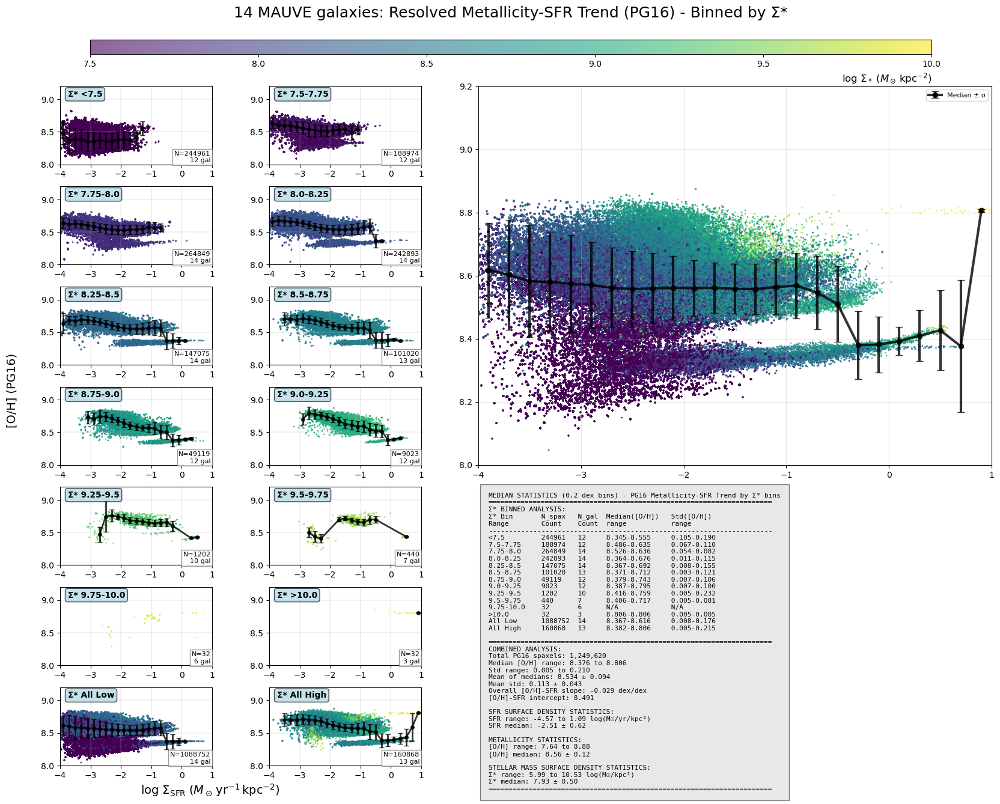

In [33]:
# ------------------------------------------------------------------
# COMPREHENSIVE LAYOUT: Σ* bins + Combined plot + Statistics (PG16 [O/H] vs SFR - colored by Σ_*)
# 4-column layout: Cols 1-2 = Σ* bins, Col 3 = Combined plot, Col 4 = Statistics
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from pathlib import Path
from astropy.io import fits
import itertools
import re  # Add this import for regex

# 0 · discover galaxies & colour palette
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_pg16 = h['O_H_PG16_SF'].data
    return sigM, sigSFR, oh_pg16

# Extraction functions for log files
def extract_total_stellar_mass(galaxy_name):
    """Extract total stellar mass from mass log file. Returns log10(M☉) value or None if not found."""
    log_file = Path(f'mass_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total stellar mass \(R\)\s*:\s*([\d.-]+)\s*log10\(M☉\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading mass log for {galaxy_name}: {e}")
        return None

def extract_total_sfr(galaxy_name):
    """Extract total SFR from SFR log file. Returns log10(M☉/yr) value or None if not found."""
    log_file = Path(f'sfr_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total Halpha SFR from SF region:.*?in log10 scale:\s*([\d.-]+)\s*log\(M☉/yr\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading SFR log for {galaxy_name}: {e}")
        return None

def calculate_median_statistics(x, y, x_range=(-4, 1), bin_width=0.2):
    """Calculate median and std in binned intervals"""
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    
    medians = []
    stds = []
    x_valid = []
    
    for i in range(len(x_bins) - 1):
        mask = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if len(np.unique(x[mask])) >= 10:  # Need at least 10 distinct x values
            y_bin = y[mask]
            medians.append(np.median(y_bin))
            stds.append(np.std(y_bin))
            x_valid.append(x_centers[i])
    
    return np.array(x_valid), np.array(medians), np.array(stds)

# Load all data first
all_data = {}
for gal in galaxies:
    sigM, sigSFR, oh_pg16 = load_maps(gal)
    good_pg16 = np.isfinite(sigM) & np.isfinite(sigSFR) & np.isfinite(oh_pg16)
    
    if np.any(good_pg16):
        all_data[gal] = {
            'sigSFR': sigSFR[good_pg16],
            'oh_pg16': oh_pg16[good_pg16], 
            'sigM': sigM[good_pg16]
        }

# Define Σ* bins
sigma_star_bins = [
    ('<7.5', -np.inf, 7.5),
    ('7.5-7.75', 7.5, 7.75),
    ('7.75-8.0', 7.75, 8.0),
    ('8.0-8.25', 8.0, 8.25),
    ('8.25-8.5', 8.25, 8.5),
    ('8.5-8.75', 8.5, 8.75),
    ('8.75-9.0', 8.75, 9.0),
    ('9.0-9.25', 9.0, 9.25),
    ('9.25-9.5', 9.25, 9.5),
    ('9.5-9.75', 9.5, 9.75),
    ('9.75-10.0', 9.75, 10.0),
    ('>10.0', 10.0, np.inf),
    ('All Low', -np.inf, 8.0),  # Combined low mass
    ('All High', 8.0, np.inf)   # Combined high mass
]

# Group data by Σ* bins
binned_data = {}
for bin_name, min_val, max_val in sigma_star_bins:
    binned_data[bin_name] = {'sigSFR': [], 'oh_pg16': [], 'sigM': [], 'galaxies': []}

# Populate binned data
for gal, data in all_data.items():
    for bin_name, min_val, max_val in sigma_star_bins:
        if bin_name in ['All Low', 'All High']:
            continue  # Handle these separately
        
        mask = (data['sigM'] >= min_val) & (data['sigM'] < max_val)
        if np.any(mask):
            binned_data[bin_name]['sigSFR'].extend(data['sigSFR'][mask])
            binned_data[bin_name]['oh_pg16'].extend(data['oh_pg16'][mask])
            binned_data[bin_name]['sigM'].extend(data['sigM'][mask])
            binned_data[bin_name]['galaxies'].append(gal)

# Handle combined bins
for gal, data in all_data.items():
    # All Low (< 8.5)
    mask_low = data['sigM'] < 8.5
    if np.any(mask_low):
        binned_data['All Low']['sigSFR'].extend(data['sigSFR'][mask_low])
        binned_data['All Low']['oh_pg16'].extend(data['oh_pg16'][mask_low])
        binned_data['All Low']['sigM'].extend(data['sigM'][mask_low])
        if gal not in binned_data['All Low']['galaxies']:
            binned_data['All Low']['galaxies'].append(gal)
    
    # All High (>= 8.5)
    mask_high = data['sigM'] >= 8.5
    if np.any(mask_high):
        binned_data['All High']['sigSFR'].extend(data['sigSFR'][mask_high])
        binned_data['All High']['oh_pg16'].extend(data['oh_pg16'][mask_high])
        binned_data['All High']['sigM'].extend(data['sigM'][mask_high])
        if gal not in binned_data['All High']['galaxies']:
            binned_data['All High']['galaxies'].append(gal)

# Convert lists to arrays
for bin_name in binned_data:
    for key in ['sigSFR', 'oh_pg16', 'sigM']:
        binned_data[bin_name][key] = np.array(binned_data[bin_name][key])

# 1 · Create comprehensive figure with 4-column layout
fig = plt.figure(figsize=(20, 16))
gs = GridSpec(nrows=8, ncols=4, figure=fig,
              width_ratios=[1, 1, 1.5, 1.5],  # Cols 3&4 slightly wider
              height_ratios=[0.5, 1, 1, 1, 1, 1, 1, 1],  # Row 0 for colorbar
              wspace=0.3, hspace=0.3)

plot_idx = 0
scatter_for_cbar = None
bin_stats = []

# COLUMNS 1-2: Σ* binned plots
valid_bins = [bin_name for bin_name, _, _ in sigma_star_bins if len(binned_data[bin_name]['sigSFR']) > 0]

for bin_idx, bin_name in enumerate(valid_bins[:14]):  # Limit to 14 bins for layout
    data = binned_data[bin_name]
    
    if len(data['sigSFR']) == 0:
        continue
    
    row = (plot_idx // 2) + 1  # Start from row 1 (row 0 for colorbar)
    col = plot_idx % 2
    plot_idx += 1

    axP = fig.add_subplot(gs[row, col])
    
    x_pg16, y_pg16, color_pg16 = data['sigSFR'], data['oh_pg16'], data['sigM']
    
    # Calculate median statistics
    x_median, y_median, y_std = calculate_median_statistics(x_pg16, y_pg16)
    bin_stats.append((bin_name, x_median, y_median, y_std, len(x_pg16), data['galaxies']))
    
    # Scatter plot colored by stellar mass surface density
    scatter = axP.scatter(x_pg16, y_pg16, c=color_pg16, s=1, alpha=0.6, marker=',', 
                         cmap='viridis', vmin=7.5, vmax=10)
    
    # Plot median with error bars
    if len(x_median) > 0:
        axP.errorbar(x_median, y_median, yerr=y_std, fmt='ko-', linewidth=2, 
                    markersize=4, capsize=3, alpha=0.8)
    
    if scatter_for_cbar is None:
        scatter_for_cbar = scatter
    
    # Add bin name in top left corner
    axP.text(0.05, 0.95, f'Σ* {bin_name}', transform=axP.transAxes, fontsize=10, fontweight='bold',
             va='top', ha='left', bbox=dict(boxstyle='round,pad=0.3', facecolor='lightblue', alpha=0.7))
    
    # Bottom right: number of spaxels and galaxies
    n_gal = len(set(data['galaxies']))
    info_text = f'N={len(x_pg16)}\n{n_gal} gal'
    axP.text(0.99, 0.01, info_text,
             transform=axP.transAxes, va='bottom', ha='right', fontsize=8,
             bbox=dict(facecolor='white', alpha=0.8, edgecolor='gray', pad=2))
    
    axP.set_xlim(-4, 1)
    axP.set_ylim(8.0, 9.2)
    axP.grid(True, lw=0.25)

# COLUMNS 3-4: Combined plot - Upper panel
ax_combined = fig.add_subplot(gs[1:5, 2:4])  # Spans rows 1-4, columns 2-3

# Collect all data for combined analysis
all_x, all_y, all_color = [], [], []
galaxy_counts = {}

for gal, data in all_data.items():
    all_x.extend(data['sigSFR'])
    all_y.extend(data['oh_pg16'])
    all_color.extend(data['sigM'])
    galaxy_counts[gal] = len(data['sigSFR'])

all_x, all_y, all_color = np.array(all_x), np.array(all_y), np.array(all_color)

# Calculate combined median statistics
x_median_combined, y_median_combined, y_std_combined = calculate_median_statistics(all_x, all_y)

# Scatter plot colored by stellar mass surface density for combined data
scatter_combined = ax_combined.scatter(all_x, all_y, c=all_color, s=1, alpha=0.6, marker=',', 
                                      cmap='viridis', vmin=7.5, vmax=10)

# Plot combined median with error bars
if len(x_median_combined) > 0:
    ax_combined.errorbar(x_median_combined, y_median_combined, yerr=y_std_combined, 
                        fmt='ko-', linewidth=3, markersize=6, capsize=4, alpha=0.8, label='Median ± σ')

# Add legend with small font
ax_combined.legend(fontsize=8, ncol=1, loc='upper right')

ax_combined.set_xlim(-4, 1)
ax_combined.set_ylim(8.0, 9.2)
ax_combined.grid(True, alpha=0.3)

# COLUMNS 3-4: Statistics table - Lower panel
ax_stats = fig.add_subplot(gs[5:8, 2:4])  # Spans rows 5-7, columns 2-3
ax_stats.axis('off')

# Create comprehensive statistics text
stats_table = "MEDIAN STATISTICS (0.2 dex bins) - PG16 Metallicity-SFR Trend by Σ* bins\n"
stats_table += "="*70 + "\n"
stats_table += "Σ* BINNED ANALYSIS:\n"
stats_table += f"{'Σ* Bin':<12} {'N_spax':<8} {'N_gal':<6} {'Median([O/H])':<15} {'Std([O/H])':<15}\n"
stats_table += f"{'Range':<12} {'Count':<8} {'Count':<6} {'range':<15} {'range':<15}\n"
stats_table += "-"*70 + "\n"

for bin_name, x_median, y_median, y_std, n_spax, galaxies in bin_stats:
    n_gal = len(set(galaxies))
    if len(y_median) > 0:
        median_range = f"{y_median.min():.3f}-{y_median.max():.3f}"
        std_range = f"{y_std.min():.3f}-{y_std.max():.3f}"
    else:
        median_range = "N/A"
        std_range = "N/A"
    
    stats_table += f"{bin_name:<12} {n_spax:<8} {n_gal:<6} {median_range:<15} {std_range:<15}\n"

stats_table += "\n" + "="*70 + "\n"
stats_table += "COMBINED ANALYSIS:\n"
stats_table += f"Total PG16 spaxels: {len(all_x):,}\n"
if len(y_median_combined) > 0:
    stats_table += f"Median [O/H] range: {y_median_combined.min():.3f} to {y_median_combined.max():.3f}\n"
    stats_table += f"Std range: {y_std_combined.min():.3f} to {y_std_combined.max():.3f}\n"
    stats_table += f"Mean of medians: {np.mean(y_median_combined):.3f} ± {np.std(y_median_combined):.3f}\n"
    stats_table += f"Mean std: {np.mean(y_std_combined):.3f} ± {np.std(y_std_combined):.3f}\n"
    
    # Calculate overall metallicity-SFR gradient (slope)
    if len(x_median_combined) > 3:
        slope, intercept = np.polyfit(x_median_combined, y_median_combined, 1)
        stats_table += f"Overall [O/H]-SFR slope: {slope:.3f} dex/dex\n"
        stats_table += f"[O/H]-SFR intercept: {intercept:.3f}\n"

# Add statistics
stats_table += f"\nSFR SURFACE DENSITY STATISTICS:\n"
stats_table += f"SFR range: {all_x.min():.2f} to {all_x.max():.2f} log(M☉/yr/kpc²)\n"
stats_table += f"SFR median: {np.median(all_x):.2f} ± {np.std(all_x):.2f}\n"

stats_table += f"\nMETALLICITY STATISTICS:\n"
stats_table += f"[O/H] range: {all_y.min():.2f} to {all_y.max():.2f}\n"
stats_table += f"[O/H] median: {np.median(all_y):.2f} ± {np.std(all_y):.2f}\n"

stats_table += f"\nSTELLAR MASS SURFACE DENSITY STATISTICS:\n"
stats_table += f"Σ* range: {all_color.min():.2f} to {all_color.max():.2f} log(M☉/kpc²)\n"
stats_table += f"Σ* median: {np.median(all_color):.2f} ± {np.std(all_color):.2f}\n"
        
stats_table += "="*70

ax_stats.text(0.02, 0.98, stats_table, transform=ax_stats.transAxes, va='top', ha='left',
              fontsize=8, family='monospace',
              bbox=dict(facecolor='lightgray', alpha=0.5, edgecolor='black', pad=10))

# Add horizontal colorbar at the top
if scatter_for_cbar is not None:
    cbar_ax = fig.add_axes([0.15, 0.85, 0.7, 0.015])
    cbar = plt.colorbar(scatter_for_cbar, cax=cbar_ax, orientation='horizontal')
    cbar.set_label(r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', fontsize=12, loc='right')

# Global title and labels
fig.suptitle(fr'{ngal} MAUVE galaxies: Resolved Metallicity-SFR Trend (PG16) - Binned by Σ*', 
             fontsize=18, y=0.90)

# Shared axis labels
fig.text(0.25, 0.08, r'$\log\,\Sigma_{\mathrm{SFR}} \; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', 
         ha='center', fontsize=14)
fig.text(0.08, 0.5, r'[O/H] (PG16)', 
         va='center', rotation='vertical', fontsize=14)

plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])
plt.show()

Extracting total stellar masses for each galaxy...
IC3392: log M* = 9.64
NGC4064: log M* = 9.92
NGC4192: log M* = 10.76
NGC4293: log M* = 10.43
NGC4298: log M* = 10.07
NGC4330: log M* = 9.54
NGC4383: log M* = 9.52
NGC4396: log M* = 9.40
NGC4419: log M* = 10.40
NGC4457: log M* = 10.46
NGC4501: log M* = 11.03
NGC4522: log M* = 9.30
NGC4694: log M* = 9.73
NGC4698: log M* = 10.60

Total stellar mass bin statistics:
  <9.8 log(M☉): 265,064 spaxels from 6 galaxies
    Galaxies: IC3392, NGC4330, NGC4383, NGC4396, NGC4522, NGC4694
  9.8-10.6 log(M☉): 287,663 spaxels from 6 galaxies
    Galaxies: NGC4064, NGC4293, NGC4298, NGC4419, NGC4457, NGC4698
  >10.6 log(M☉): 694,205 spaxels from 2 galaxies
    Galaxies: NGC4192, NGC4501


/var/folders/rm/clp89v210v32vh5vjt2kx7b80000gr/T/ipykernel_65174/2171462561.py:330: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])


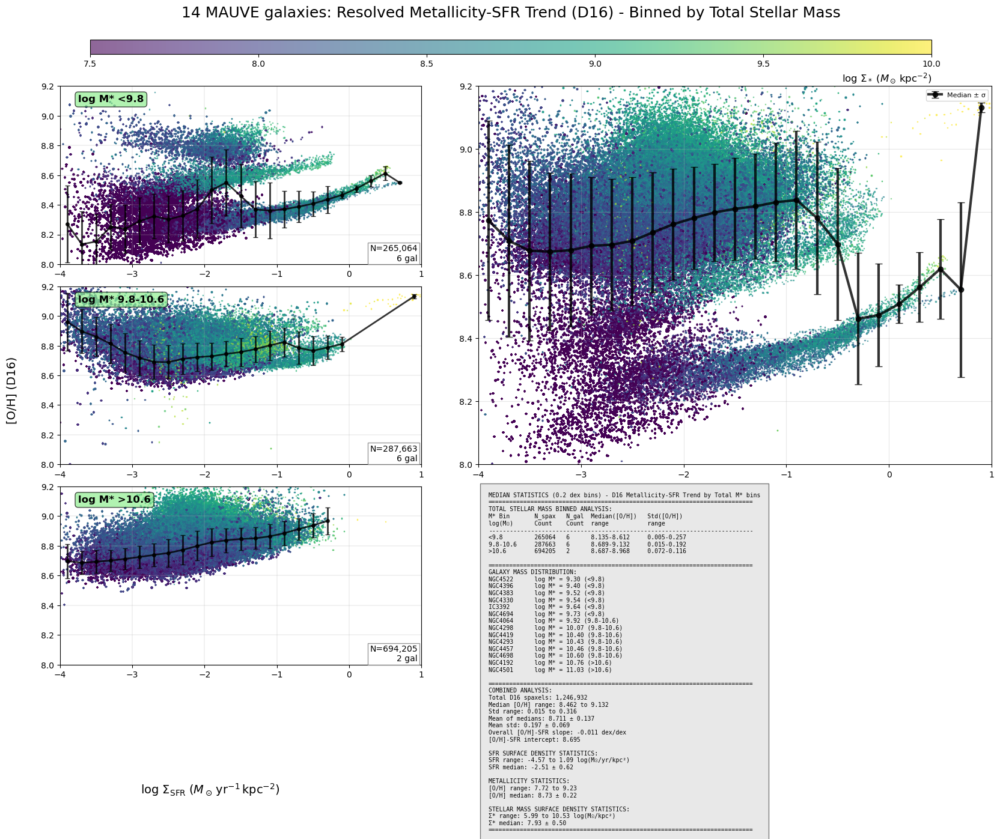

In [34]:
# ------------------------------------------------------------------
# COMPREHENSIVE LAYOUT: Total M* bins + Combined plot + Statistics (D16 [O/H] vs SFR - colored by Σ_*)
# 4-column layout: Cols 1-2 = Total M* bins (larger plots), Col 3 = Combined plot, Col 4 = Statistics
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from pathlib import Path
from astropy.io import fits
import itertools
import re  # Add this import for regex

# 0 · discover galaxies & colour palette
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_d16 = h['O_H_D16_SF'].data
    return sigM, sigSFR, oh_d16

# Extraction functions for log files
def extract_total_stellar_mass(galaxy_name):
    """Extract total stellar mass from mass log file. Returns log10(M☉) value or None if not found."""
    log_file = Path(f'mass_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total stellar mass \(R\)\s*:\s*([\d.-]+)\s*log10\(M☉\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading mass log for {galaxy_name}: {e}")
        return None

def extract_total_sfr(galaxy_name):
    """Extract total SFR from SFR log file. Returns log10(M☉/yr) value or None if not found."""
    log_file = Path(f'sfr_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total Halpha SFR from SF region:.*?in log10 scale:\s*([\d.-]+)\s*log\(M☉/yr\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading SFR log for {galaxy_name}: {e}")
        return None

def calculate_median_statistics(x, y, x_range=(-4, 1), bin_width=0.2):
    """Calculate median and std in binned intervals"""
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    
    medians = []
    stds = []
    x_valid = []
    
    for i in range(len(x_bins) - 1):
        mask = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if len(np.unique(x[mask])) >= 10:  # Need at least 10 distinct x values
            y_bin = y[mask]
            medians.append(np.median(y_bin))
            stds.append(np.std(y_bin))
            x_valid.append(x_centers[i])
    
    return np.array(x_valid), np.array(medians), np.array(stds)

# Extract total stellar masses for each galaxy
print("Extracting total stellar masses for each galaxy...")
galaxy_masses = {}
for gal in galaxies:
    total_mass = extract_total_stellar_mass(gal)
    if total_mass is not None:
        galaxy_masses[gal] = total_mass
        print(f"{gal}: log M* = {total_mass:.2f}")
    else:
        print(f"{gal}: Could not extract total stellar mass")

# Define total stellar mass bins
mass_bins = [
    ('<9.8', -np.inf, 9.8),
    ('9.8-10.6', 9.8, 10.6),
    ('>10.6', 10.6, np.inf)
]

# Load all data and organize by total stellar mass bins
all_data = {}
mass_binned_data = {}

# Initialize mass bins
for bin_name, min_val, max_val in mass_bins:
    mass_binned_data[bin_name] = {'sigSFR': [], 'oh_d16': [], 'sigM': [], 'galaxies': []}

# Load data and assign to mass bins
for gal in galaxies:
    if gal not in galaxy_masses:
        continue
        
    sigM, sigSFR, oh_d16 = load_maps(gal)
    good_d16 = np.isfinite(sigM) & np.isfinite(sigSFR) & np.isfinite(oh_d16)
    
    if np.any(good_d16):
        all_data[gal] = {
            'sigSFR': sigSFR[good_d16],
            'oh_d16': oh_d16[good_d16], 
            'sigM': sigM[good_d16],
            'total_mass': galaxy_masses[gal]
        }
        
        # Determine which mass bin this galaxy belongs to
        galaxy_mass = galaxy_masses[gal]
        for bin_name, min_val, max_val in mass_bins:
            if min_val < galaxy_mass <= max_val:
                mass_binned_data[bin_name]['sigSFR'].extend(sigSFR[good_d16])
                mass_binned_data[bin_name]['oh_d16'].extend(oh_d16[good_d16])
                mass_binned_data[bin_name]['sigM'].extend(sigM[good_d16])
                if gal not in mass_binned_data[bin_name]['galaxies']:
                    mass_binned_data[bin_name]['galaxies'].append(gal)
                break

# Convert lists to arrays
for bin_name in mass_binned_data:
    for key in ['sigSFR', 'oh_d16', 'sigM']:
        mass_binned_data[bin_name][key] = np.array(mass_binned_data[bin_name][key])

# Print mass bin statistics
print(f"\nTotal stellar mass bin statistics:")
for bin_name, min_val, max_val in mass_bins:
    data = mass_binned_data[bin_name]
    n_gal = len(data['galaxies'])
    n_spax = len(data['sigSFR'])
    print(f"  {bin_name} log(M☉): {n_spax:,} spaxels from {n_gal} galaxies")
    if n_gal > 0:
        print(f"    Galaxies: {', '.join(data['galaxies'])}")

# 1 · Create comprehensive figure with 4-column layout
fig = plt.figure(figsize=(20, 16))
gs = GridSpec(nrows=8, ncols=4, figure=fig,
              width_ratios=[1, 1, 1.5, 1.5],  # Cols 3&4 slightly wider
              height_ratios=[0.5, 1, 1, 1, 1, 1, 1, 1],  # Row 0 for colorbar
              wspace=0.3, hspace=0.3)

scatter_for_cbar = None
bin_stats = []

# COLUMNS 1-2: Total M* binned plots (each occupying 2x2 grid space)
valid_bins = [bin_name for bin_name, _, _ in mass_bins if len(mass_binned_data[bin_name]['sigSFR']) > 0]

# Define subplot positions for larger plots (2x2 each)
subplot_positions = [
    (1, 3, 0, 2),    # bin 0: rows 1-2, cols 0-1
    (3, 5, 0, 2),    # bin 1: rows 3-4, cols 0-1  
    (5, 7, 0, 2)     # bin 2: rows 5-6, cols 0-1
]

for bin_idx, bin_name in enumerate(valid_bins):
    data = mass_binned_data[bin_name]
    
    if len(data['sigSFR']) == 0:
        continue
    
    if bin_idx >= len(subplot_positions):
        print(f"No subplot position defined for bin {bin_idx}")
        continue
    
    # Get the subplot position for this bin
    row_start, row_end, col_start, col_end = subplot_positions[bin_idx]
    axP = fig.add_subplot(gs[row_start:row_end, col_start:col_end])
    
    x_d16, y_d16, color_d16 = data['sigSFR'], data['oh_d16'], data['sigM']
    
    # Calculate median statistics
    x_median, y_median, y_std = calculate_median_statistics(x_d16, y_d16)
    bin_stats.append((bin_name, x_median, y_median, y_std, len(x_d16), data['galaxies']))
    
    # Scatter plot colored by stellar mass surface density
    scatter = axP.scatter(x_d16, y_d16, c=color_d16, s=1, alpha=0.6, marker=',', 
                         cmap='viridis', vmin=7.5, vmax=10)
    
    # Plot median with error bars
    if len(x_median) > 0:
        axP.errorbar(x_median, y_median, yerr=y_std, fmt='ko-', linewidth=2, 
                    markersize=4, capsize=3, alpha=0.8)
    
    if scatter_for_cbar is None:
        scatter_for_cbar = scatter
    
    # Add bin name in top left corner
    axP.text(0.05, 0.95, f'log M* {bin_name}', transform=axP.transAxes, fontsize=12, fontweight='bold',
             va='top', ha='left', bbox=dict(boxstyle='round,pad=0.3', facecolor='lightgreen', alpha=0.7))
    
    # Bottom right: number of spaxels and galaxies
    n_gal = len(set(data['galaxies']))
    info_text = f'N={len(x_d16):,}\n{n_gal} gal'
    axP.text(0.99, 0.01, info_text,
             transform=axP.transAxes, va='bottom', ha='right', fontsize=10,
             bbox=dict(facecolor='white', alpha=0.8, edgecolor='gray', pad=2))
    
    axP.set_xlim(-4, 1)
    axP.set_ylim(8.0, 9.2)
    axP.grid(True, lw=0.25)

# COLUMNS 3-4: Combined plot - Upper panel
ax_combined = fig.add_subplot(gs[1:5, 2:4])  # Spans rows 1-4, columns 2-3

# Collect all data for combined analysis
all_x, all_y, all_color = [], [], []
galaxy_counts = {}

for gal, data in all_data.items():
    all_x.extend(data['sigSFR'])
    all_y.extend(data['oh_d16'])
    all_color.extend(data['sigM'])
    galaxy_counts[gal] = len(data['sigSFR'])

all_x, all_y, all_color = np.array(all_x), np.array(all_y), np.array(all_color)

# Calculate combined median statistics
x_median_combined, y_median_combined, y_std_combined = calculate_median_statistics(all_x, all_y)

# Scatter plot colored by stellar mass surface density for combined data
scatter_combined = ax_combined.scatter(all_x, all_y, c=all_color, s=1, alpha=0.6, marker=',', 
                                      cmap='viridis', vmin=7.5, vmax=10)

# Plot combined median with error bars
if len(x_median_combined) > 0:
    ax_combined.errorbar(x_median_combined, y_median_combined, yerr=y_std_combined, 
                        fmt='ko-', linewidth=3, markersize=6, capsize=4, alpha=0.8, label='Median ± σ')

# Add legend with small font
ax_combined.legend(fontsize=8, ncol=1, loc='upper right')

ax_combined.set_xlim(-4, 1)
ax_combined.set_ylim(8.0, 9.2)
ax_combined.grid(True, alpha=0.3)

# COLUMNS 3-4: Statistics table - Lower panel
ax_stats = fig.add_subplot(gs[5:8, 2:4])  # Spans rows 5-7, columns 2-3
ax_stats.axis('off')

# Create comprehensive statistics text
stats_table = "MEDIAN STATISTICS (0.2 dex bins) - D16 Metallicity-SFR Trend by Total M* bins\n"
stats_table += "="*75 + "\n"
stats_table += "TOTAL STELLAR MASS BINNED ANALYSIS:\n"
stats_table += f"{'M* Bin':<12} {'N_spax':<8} {'N_gal':<6} {'Median([O/H])':<15} {'Std([O/H])':<15}\n"
stats_table += f"{'log(M☉)':<12} {'Count':<8} {'Count':<6} {'range':<15} {'range':<15}\n"
stats_table += "-"*75 + "\n"

for bin_name, x_median, y_median, y_std, n_spax, galaxies in bin_stats:
    n_gal = len(set(galaxies))
    if len(y_median) > 0:
        median_range = f"{y_median.min():.3f}-{y_median.max():.3f}"
        std_range = f"{y_std.min():.3f}-{y_std.max():.3f}"
    else:
        median_range = "N/A"
        std_range = "N/A"
    
    stats_table += f"{bin_name:<12} {n_spax:<8} {n_gal:<6} {median_range:<15} {std_range:<15}\n"

stats_table += "\n" + "="*75 + "\n"
stats_table += "GALAXY MASS DISTRIBUTION:\n"
for gal, mass in sorted(galaxy_masses.items(), key=lambda x: x[1]):
    # Determine bin
    for bin_name, min_val, max_val in mass_bins:
        if min_val < mass <= max_val:
            bin_label = bin_name
            break
    stats_table += f"{gal:<12} log M* = {mass:.2f} ({bin_label})\n"

stats_table += "\n" + "="*75 + "\n"
stats_table += "COMBINED ANALYSIS:\n"
stats_table += f"Total D16 spaxels: {len(all_x):,}\n"
if len(y_median_combined) > 0:
    stats_table += f"Median [O/H] range: {y_median_combined.min():.3f} to {y_median_combined.max():.3f}\n"
    stats_table += f"Std range: {y_std_combined.min():.3f} to {y_std_combined.max():.3f}\n"
    stats_table += f"Mean of medians: {np.mean(y_median_combined):.3f} ± {np.std(y_median_combined):.3f}\n"
    stats_table += f"Mean std: {np.mean(y_std_combined):.3f} ± {np.std(y_std_combined):.3f}\n"
    
    # Calculate overall metallicity-SFR gradient (slope)
    if len(x_median_combined) > 3:
        slope, intercept = np.polyfit(x_median_combined, y_median_combined, 1)
        stats_table += f"Overall [O/H]-SFR slope: {slope:.3f} dex/dex\n"
        stats_table += f"[O/H]-SFR intercept: {intercept:.3f}\n"

# Add statistics
stats_table += f"\nSFR SURFACE DENSITY STATISTICS:\n"
stats_table += f"SFR range: {all_x.min():.2f} to {all_x.max():.2f} log(M☉/yr/kpc²)\n"
stats_table += f"SFR median: {np.median(all_x):.2f} ± {np.std(all_x):.2f}\n"

stats_table += f"\nMETALLICITY STATISTICS:\n"
stats_table += f"[O/H] range: {all_y.min():.2f} to {all_y.max():.2f}\n"
stats_table += f"[O/H] median: {np.median(all_y):.2f} ± {np.std(all_y):.2f}\n"

stats_table += f"\nSTELLAR MASS SURFACE DENSITY STATISTICS:\n"
stats_table += f"Σ* range: {all_color.min():.2f} to {all_color.max():.2f} log(M☉/kpc²)\n"
stats_table += f"Σ* median: {np.median(all_color):.2f} ± {np.std(all_color):.2f}\n"
        
stats_table += "="*75

ax_stats.text(0.02, 0.98, stats_table, transform=ax_stats.transAxes, va='top', ha='left',
              fontsize=7, family='monospace',
              bbox=dict(facecolor='lightgray', alpha=0.5, edgecolor='black', pad=10))

# Add horizontal colorbar at the top
if scatter_for_cbar is not None:
    cbar_ax = fig.add_axes([0.15, 0.85, 0.7, 0.015])
    cbar = plt.colorbar(scatter_for_cbar, cax=cbar_ax, orientation='horizontal')
    cbar.set_label(r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', fontsize=12, loc='right')

# Global title and labels
fig.suptitle(fr'{ngal} MAUVE galaxies: Resolved Metallicity-SFR Trend (D16) - Binned by Total Stellar Mass', 
             fontsize=18, y=0.90)

# Shared axis labels
fig.text(0.25, 0.08, r'$\log\,\Sigma_{\mathrm{SFR}} \; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', 
         ha='center', fontsize=14)
fig.text(0.08, 0.5, r'[O/H] (D16)', 
         va='center', rotation='vertical', fontsize=14)

plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])
plt.show()

Extracting total stellar masses for each galaxy...
IC3392: log M* = 9.64
NGC4064: log M* = 9.92
NGC4192: log M* = 10.76
NGC4293: log M* = 10.43
NGC4298: log M* = 10.07
NGC4330: log M* = 9.54
NGC4383: log M* = 9.52
NGC4396: log M* = 9.40
NGC4419: log M* = 10.40
NGC4457: log M* = 10.46
NGC4501: log M* = 11.03
NGC4522: log M* = 9.30
NGC4694: log M* = 9.73
NGC4698: log M* = 10.60

Total stellar mass bin statistics:
  <9.8 log(M☉): 264,761 spaxels from 6 galaxies
    Galaxies: IC3392, NGC4330, NGC4383, NGC4396, NGC4522, NGC4694
  9.8-10.6 log(M☉): 290,629 spaxels from 6 galaxies
    Galaxies: NGC4064, NGC4293, NGC4298, NGC4419, NGC4457, NGC4698
  >10.6 log(M☉): 694,230 spaxels from 2 galaxies
    Galaxies: NGC4192, NGC4501


/var/folders/rm/clp89v210v32vh5vjt2kx7b80000gr/T/ipykernel_65174/2500778398.py:330: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])


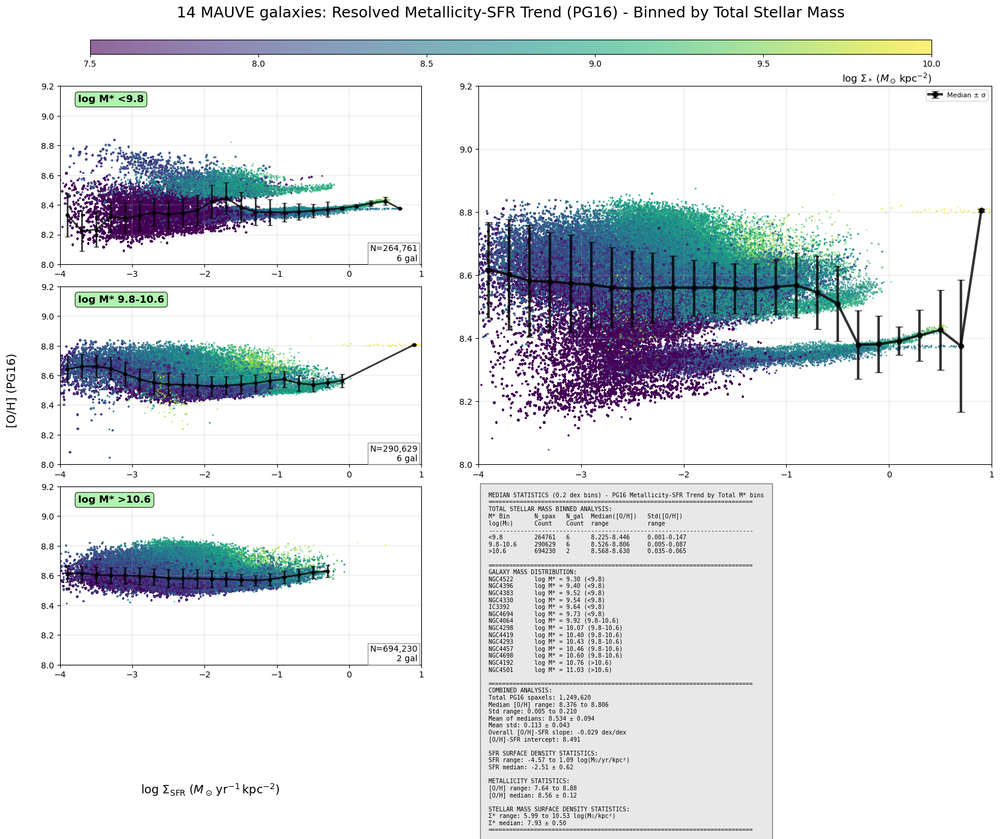

In [35]:
# ------------------------------------------------------------------
#
# 4-column layout: Cols 1-2 = Total M* bins (larger plots), Col 3 = Combined plot, Col 4 = Statistics
# ------------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from pathlib import Path
from astropy.io import fits
import itertools
import re  # Add this import for regex

# 0 · discover galaxies & colour palette
bins = sorted(Path('.').glob('*_SPATIAL_BINNING_maps_extended.fits'))
galaxies = [f.name.split('_')[0] for f in bins]
ngal = len(galaxies)

def load_maps(gal):
    with fits.open(f'{gal}_SPATIAL_BINNING_maps_extended.fits') as h:
        sigM = h['LOGMASS_SURFACE_DENSITY'].data
    with fits.open(f'{gal}_gas_BIN_maps_extended.fits') as h:
        sigSFR = h['LOGSFR_SURFACE_DENSITY_SF'].data
        oh_pg16 = h['O_H_PG16_SF'].data
    return sigM, sigSFR, oh_pg16

# Extraction functions for log files
def extract_total_stellar_mass(galaxy_name):
    """Extract total stellar mass from mass log file. Returns log10(M☉) value or None if not found."""
    log_file = Path(f'mass_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total stellar mass \(R\)\s*:\s*([\d.-]+)\s*log10\(M☉\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading mass log for {galaxy_name}: {e}")
        return None

def extract_total_sfr(galaxy_name):
    """Extract total SFR from SFR log file. Returns log10(M☉/yr) value or None if not found."""
    log_file = Path(f'sfr_logs/{galaxy_name}.log')
    if not log_file.exists():
        return None
    
    try:
        with open(log_file, 'r') as f:
            content = f.read()
        pattern = r'Total Halpha SFR from SF region:.*?in log10 scale:\s*([\d.-]+)\s*log\(M☉/yr\)'
        match = re.search(pattern, content)
        return float(match.group(1)) if match else None
    except Exception as e:
        print(f"Error reading SFR log for {galaxy_name}: {e}")
        return None

def calculate_median_statistics(x, y, x_range=(-4, 1), bin_width=0.2):
    """Calculate median and std in binned intervals"""
    x_bins = np.arange(x_range[0], x_range[1] + bin_width, bin_width)
    x_centers = (x_bins[:-1] + x_bins[1:]) / 2
    
    medians = []
    stds = []
    x_valid = []
    
    for i in range(len(x_bins) - 1):
        mask = (x >= x_bins[i]) & (x < x_bins[i + 1])
        if len(np.unique(x[mask])) >= 10:  # Need at least 10 distinct x values
            y_bin = y[mask]
            medians.append(np.median(y_bin))
            stds.append(np.std(y_bin))
            x_valid.append(x_centers[i])
    
    return np.array(x_valid), np.array(medians), np.array(stds)

# Extract total stellar masses for each galaxy
print("Extracting total stellar masses for each galaxy...")
galaxy_masses = {}
for gal in galaxies:
    total_mass = extract_total_stellar_mass(gal)
    if total_mass is not None:
        galaxy_masses[gal] = total_mass
        print(f"{gal}: log M* = {total_mass:.2f}")
    else:
        print(f"{gal}: Could not extract total stellar mass")

# Define total stellar mass bins
mass_bins = [
    ('<9.8', -np.inf, 9.8),
    ('9.8-10.6', 9.8, 10.6),
    ('>10.6', 10.6, np.inf)
]

# Load all data and organize by total stellar mass bins
all_data = {}
mass_binned_data = {}

# Initialize mass bins
for bin_name, min_val, max_val in mass_bins:
    mass_binned_data[bin_name] = {'sigSFR': [], 'oh_pg16': [], 'sigM': [], 'galaxies': []}

# Load data and assign to mass bins
for gal in galaxies:
    if gal not in galaxy_masses:
        continue
        
    sigM, sigSFR, oh_pg16 = load_maps(gal)
    good_pg16 = np.isfinite(sigM) & np.isfinite(sigSFR) & np.isfinite(oh_pg16)
    
    if np.any(good_pg16):
        all_data[gal] = {
            'sigSFR': sigSFR[good_pg16],
            'oh_pg16': oh_pg16[good_pg16], 
            'sigM': sigM[good_pg16],
            'total_mass': galaxy_masses[gal]
        }
        
        # Determine which mass bin this galaxy belongs to
        galaxy_mass = galaxy_masses[gal]
        for bin_name, min_val, max_val in mass_bins:
            if min_val < galaxy_mass <= max_val:
                mass_binned_data[bin_name]['sigSFR'].extend(sigSFR[good_pg16])
                mass_binned_data[bin_name]['oh_pg16'].extend(oh_pg16[good_pg16])
                mass_binned_data[bin_name]['sigM'].extend(sigM[good_pg16])
                if gal not in mass_binned_data[bin_name]['galaxies']:
                    mass_binned_data[bin_name]['galaxies'].append(gal)
                break

# Convert lists to arrays
for bin_name in mass_binned_data:
    for key in ['sigSFR', 'oh_pg16', 'sigM']:
        mass_binned_data[bin_name][key] = np.array(mass_binned_data[bin_name][key])

# Print mass bin statistics
print(f"\nTotal stellar mass bin statistics:")
for bin_name, min_val, max_val in mass_bins:
    data = mass_binned_data[bin_name]
    n_gal = len(data['galaxies'])
    n_spax = len(data['sigSFR'])
    print(f"  {bin_name} log(M☉): {n_spax:,} spaxels from {n_gal} galaxies")
    if n_gal > 0:
        print(f"    Galaxies: {', '.join(data['galaxies'])}")

# 1 · Create comprehensive figure with 4-column layout
fig = plt.figure(figsize=(20, 16))
gs = GridSpec(nrows=8, ncols=4, figure=fig,
              width_ratios=[1, 1, 1.5, 1.5],  # Cols 3&4 slightly wider
              height_ratios=[0.5, 1, 1, 1, 1, 1, 1, 1],  # Row 0 for colorbar
              wspace=0.3, hspace=0.3)

scatter_for_cbar = None
bin_stats = []

# COLUMNS 1-2: Total M* binned plots (each occupying 2x2 grid space)
valid_bins = [bin_name for bin_name, _, _ in mass_bins if len(mass_binned_data[bin_name]['sigSFR']) > 0]

# Define subplot positions for larger plots (2x2 each)
subplot_positions = [
    (1, 3, 0, 2),    # bin 0: rows 1-2, cols 0-1
    (3, 5, 0, 2),    # bin 1: rows 3-4, cols 0-1  
    (5, 7, 0, 2)     # bin 2: rows 5-6, cols 0-1
]

for bin_idx, bin_name in enumerate(valid_bins):
    data = mass_binned_data[bin_name]
    
    if len(data['sigSFR']) == 0:
        continue
    
    if bin_idx >= len(subplot_positions):
        print(f"No subplot position defined for bin {bin_idx}")
        continue
    
    # Get the subplot position for this bin
    row_start, row_end, col_start, col_end = subplot_positions[bin_idx]
    axP = fig.add_subplot(gs[row_start:row_end, col_start:col_end])
    
    x_pg16, y_pg16, color_pg16 = data['sigSFR'], data['oh_pg16'], data['sigM']
    
    # Calculate median statistics
    x_median, y_median, y_std = calculate_median_statistics(x_pg16, y_pg16)
    bin_stats.append((bin_name, x_median, y_median, y_std, len(x_pg16), data['galaxies']))
    
    # Scatter plot colored by stellar mass surface density
    scatter = axP.scatter(x_pg16, y_pg16, c=color_pg16, s=1, alpha=0.6, marker=',', 
                         cmap='viridis', vmin=7.5, vmax=10)
    
    # Plot median with error bars
    if len(x_median) > 0:
        axP.errorbar(x_median, y_median, yerr=y_std, fmt='ko-', linewidth=2, 
                    markersize=4, capsize=3, alpha=0.8)
    
    if scatter_for_cbar is None:
        scatter_for_cbar = scatter
    
    # Add bin name in top left corner
    axP.text(0.05, 0.95, f'log M* {bin_name}', transform=axP.transAxes, fontsize=12, fontweight='bold',
             va='top', ha='left', bbox=dict(boxstyle='round,pad=0.3', facecolor='lightgreen', alpha=0.7))
    
    # Bottom right: number of spaxels and galaxies
    n_gal = len(set(data['galaxies']))
    info_text = f'N={len(x_pg16):,}\n{n_gal} gal'
    axP.text(0.99, 0.01, info_text,
             transform=axP.transAxes, va='bottom', ha='right', fontsize=10,
             bbox=dict(facecolor='white', alpha=0.8, edgecolor='gray', pad=2))
    
    axP.set_xlim(-4, 1)
    axP.set_ylim(8.0, 9.2)
    axP.grid(True, lw=0.25)

# COLUMNS 3-4: Combined plot - Upper panel
ax_combined = fig.add_subplot(gs[1:5, 2:4])  # Spans rows 1-4, columns 2-3

# Collect all data for combined analysis
all_x, all_y, all_color = [], [], []
galaxy_counts = {}

for gal, data in all_data.items():
    all_x.extend(data['sigSFR'])
    all_y.extend(data['oh_pg16'])
    all_color.extend(data['sigM'])
    galaxy_counts[gal] = len(data['sigSFR'])

all_x, all_y, all_color = np.array(all_x), np.array(all_y), np.array(all_color)

# Calculate combined median statistics
x_median_combined, y_median_combined, y_std_combined = calculate_median_statistics(all_x, all_y)

# Scatter plot colored by stellar mass surface density for combined data
scatter_combined = ax_combined.scatter(all_x, all_y, c=all_color, s=1, alpha=0.6, marker=',', 
                                      cmap='viridis', vmin=7.5, vmax=10)

# Plot combined median with error bars
if len(x_median_combined) > 0:
    ax_combined.errorbar(x_median_combined, y_median_combined, yerr=y_std_combined, 
                        fmt='ko-', linewidth=3, markersize=6, capsize=4, alpha=0.8, label='Median ± σ')

# Add legend with small font
ax_combined.legend(fontsize=8, ncol=1, loc='upper right')

ax_combined.set_xlim(-4, 1)
ax_combined.set_ylim(8.0, 9.2)
ax_combined.grid(True, alpha=0.3)

# COLUMNS 3-4: Statistics table - Lower panel
ax_stats = fig.add_subplot(gs[5:8, 2:4])  # Spans rows 5-7, columns 2-3
ax_stats.axis('off')

# Create comprehensive statistics text
stats_table = "MEDIAN STATISTICS (0.2 dex bins) - PG16 Metallicity-SFR Trend by Total M* bins\n"
stats_table += "="*75 + "\n"
stats_table += "TOTAL STELLAR MASS BINNED ANALYSIS:\n"
stats_table += f"{'M* Bin':<12} {'N_spax':<8} {'N_gal':<6} {'Median([O/H])':<15} {'Std([O/H])':<15}\n"
stats_table += f"{'log(M☉)':<12} {'Count':<8} {'Count':<6} {'range':<15} {'range':<15}\n"
stats_table += "-"*75 + "\n"

for bin_name, x_median, y_median, y_std, n_spax, galaxies in bin_stats:
    n_gal = len(set(galaxies))
    if len(y_median) > 0:
        median_range = f"{y_median.min():.3f}-{y_median.max():.3f}"
        std_range = f"{y_std.min():.3f}-{y_std.max():.3f}"
    else:
        median_range = "N/A"
        std_range = "N/A"
    
    stats_table += f"{bin_name:<12} {n_spax:<8} {n_gal:<6} {median_range:<15} {std_range:<15}\n"

stats_table += "\n" + "="*75 + "\n"
stats_table += "GALAXY MASS DISTRIBUTION:\n"
for gal, mass in sorted(galaxy_masses.items(), key=lambda x: x[1]):
    # Determine bin
    for bin_name, min_val, max_val in mass_bins:
        if min_val < mass <= max_val:
            bin_label = bin_name
            break
    stats_table += f"{gal:<12} log M* = {mass:.2f} ({bin_label})\n"

stats_table += "\n" + "="*75 + "\n"
stats_table += "COMBINED ANALYSIS:\n"
stats_table += f"Total PG16 spaxels: {len(all_x):,}\n"
if len(y_median_combined) > 0:
    stats_table += f"Median [O/H] range: {y_median_combined.min():.3f} to {y_median_combined.max():.3f}\n"
    stats_table += f"Std range: {y_std_combined.min():.3f} to {y_std_combined.max():.3f}\n"
    stats_table += f"Mean of medians: {np.mean(y_median_combined):.3f} ± {np.std(y_median_combined):.3f}\n"
    stats_table += f"Mean std: {np.mean(y_std_combined):.3f} ± {np.std(y_std_combined):.3f}\n"
    
    # Calculate overall metallicity-SFR gradient (slope)
    if len(x_median_combined) > 3:
        slope, intercept = np.polyfit(x_median_combined, y_median_combined, 1)
        stats_table += f"Overall [O/H]-SFR slope: {slope:.3f} dex/dex\n"
        stats_table += f"[O/H]-SFR intercept: {intercept:.3f}\n"

# Add statistics
stats_table += f"\nSFR SURFACE DENSITY STATISTICS:\n"
stats_table += f"SFR range: {all_x.min():.2f} to {all_x.max():.2f} log(M☉/yr/kpc²)\n"
stats_table += f"SFR median: {np.median(all_x):.2f} ± {np.std(all_x):.2f}\n"

stats_table += f"\nMETALLICITY STATISTICS:\n"
stats_table += f"[O/H] range: {all_y.min():.2f} to {all_y.max():.2f}\n"
stats_table += f"[O/H] median: {np.median(all_y):.2f} ± {np.std(all_y):.2f}\n"

stats_table += f"\nSTELLAR MASS SURFACE DENSITY STATISTICS:\n"
stats_table += f"Σ* range: {all_color.min():.2f} to {all_color.max():.2f} log(M☉/kpc²)\n"
stats_table += f"Σ* median: {np.median(all_color):.2f} ± {np.std(all_color):.2f}\n"
        
stats_table += "="*75

ax_stats.text(0.02, 0.98, stats_table, transform=ax_stats.transAxes, va='top', ha='left',
              fontsize=7, family='monospace',
              bbox=dict(facecolor='lightgray', alpha=0.5, edgecolor='black', pad=10))

# Add horizontal colorbar at the top
if scatter_for_cbar is not None:
    cbar_ax = fig.add_axes([0.15, 0.85, 0.7, 0.015])
    cbar = plt.colorbar(scatter_for_cbar, cax=cbar_ax, orientation='horizontal')
    cbar.set_label(r'$\log\,\Sigma_* \; (M_\odot\,\mathrm{kpc}^{-2})$', fontsize=12, loc='right')

# Global title and labels
fig.suptitle(fr'{ngal} MAUVE galaxies: Resolved Metallicity-SFR Trend (PG16) - Binned by Total Stellar Mass', 
             fontsize=18, y=0.90)

# Shared axis labels
fig.text(0.25, 0.08, r'$\log\,\Sigma_{\mathrm{SFR}} \; (M_\odot\,\mathrm{yr}^{-1}\,\mathrm{kpc}^{-2})$', 
         ha='center', fontsize=14)
fig.text(0.08, 0.5, r'[O/H] (PG16)', 
         va='center', rotation='vertical', fontsize=14)

plt.tight_layout(rect=[0.05, 0.1, 0.95, 0.9])
plt.show()